In [130]:
library(patchwork)
library(purrr)
library(dplyr) 
library(tidyr)
library(cowplot)
library(singlecellmethods)
library(ggplot2)
library(ggbeeswarm)
library(stringr)
library(viridis)

source("/data/srlab/anathan/scripts/scseq_utils.R")

library(Matrix)
library(MASS)
library(future)
library(future.apply)
library(tidyverse)
library(pheatmap)
library(cividis)
library(writexl)
library("RColorBrewer")
library(googlesheets4)
gs4_deauth()
library(ggrepel)

In [5]:
#' Create a quantile-quantile plot with ggplot2.
#'
#' Assumptions:
#'   - Expected P values are uniformly distributed.
#'   - Confidence intervals assume independence between tests.
#'     We expect deviations past the confidence intervals if the tests are
#'     not independent.
#'     For example, in a genome-wide association study, the genotype at any
#'     position is correlated to nearby positions. Tests of nearby genotypes
#'     will result in similar test statistics.
#'
#' @param ps Vector of p-values.
#' @param ci Size of the confidence interval, 95% by default.
#' @return A ggplot2 plot.
#' @examples
#' library(ggplot2)
#' gg_qqplot(runif(1e2)) + theme_grey(base_size = 24)
gg_qqplot <- function(ps, ci = 0.95) {
  n  <- length(ps)
  df <- data.frame(
    observed = -log10(sort(ps)),
    expected = -log10(ppoints(n)),
    clower   = -log10(qbeta(p = (1 - ci) / 2, shape1 = 1:n, shape2 = n:1)),
    cupper   = -log10(qbeta(p = (1 + ci) / 2, shape1 = 1:n, shape2 = n:1))
  )
  log10Pe <- expression(paste("Expected -log"[10], plain(P)))
  log10Po <- expression(paste("Observed -log"[10], plain(P)))
  ggplot(df) +
    geom_ribbon(
      mapping = aes(x = expected, ymin = clower, ymax = cupper),
      alpha = 0.1
    ) +
    geom_point(aes(expected, observed), shape = 1, size = 3) +
    geom_abline(intercept = 0, slope = 1, alpha = 0.5) +
    # geom_line(aes(expected, cupper), linetype = 2, size = 0.5) +
    # geom_line(aes(expected, clower), linetype = 2, size = 0.5) +
    xlab(log10Pe) +
    ylab(log10Po)
}


In [6]:
labelfontsize = 20
tickfontsize = 16

figdir = '../../figures/components/'
outdir = '../../data/tissue/'

In [7]:
pseudobulk <- function(counts, groups) {
    colnames(counts) = groups
    
    # Convert group labels into a sparse indicator matrix
    group_levels <- unique(groups)
    group_matrix <- sparseMatrix(
      i = match(groups, group_levels), 
      j = seq_len(length(groups)), 
    )

    # Perform sparse matrix multiplication to sum within groups
    pseudo_raw <- group_matrix %*% (counts %>% t)

    # Assign row names to match groups
    rownames(pseudo_raw) <- group_levels

    pseudo_raw = pseudo_raw %>% t
    
    return(pseudo_raw)
    
}

In [8]:
immune_ctypes = c('T/NK', 'B/Plasma', 'Myeloid')

In [76]:
raw_tissue_fn = '/data/srlab2/qxiao/AMP-SLE/sc_nuc_data/2022-08-09_ScNuc_cell_QCed_RawCounts.rds'
qcd_raw_tissue = readRDS(raw_tissue_fn)

In [10]:
parallel::detectCores()
plan(multisession, workers = 20)

[1] 96

In [77]:
parallel::detectCores()
plan(multicore, workers = 20)

[1] 96

In [78]:
# ndonor_thresh = round(nrow(sample_meta)*.9) #round(nrow(sample_meta)/2)
genecount_thresh = 1
pseudocount = 0

In [79]:
celltypes = c('T/NK', 'B/Plasma', 'Myeloid', 'Glomerular', 'Interstitial/Stromal', 'Loop of Henle',
             'Distal Nephron', 'Proximal Tubule')

ctype_list = list()

meta_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/qcd/T_NK_clusterQCd_meta_harmonizedPCUMAPclusters_annotations02062024.rds'
meta_cr_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/cna_new/t_nk/chronicity/sc_meta.csv'
raw_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/qcd/T_NK_clusterQCd_rawcounts_03062023.rds'
raw_fn_pbmc = '/data/srlab/ssg34/SLE_pbmc_analysis/data/gene_expression/t_nk_qcd_seurat_sc_analysis_08252023.rds'
meta_fn_pbmc = '/data/srlab/ssg34/SLE_kidney_v2/data/pbmc/SLE_t_nk_pbmc_metadata_filtered_V0_cases_controls_07182024.rds'
tsm_fn = '/data/srlab/ssg34/SLE_kidney_v2/sugiarto_scripts/Resources/TNK_TSMs.csv'
name = 'tnk'
ctype_list[['T/NK']] = c(meta_fn, raw_fn, name, meta_cr_fn, raw_fn_pbmc, meta_fn_pbmc, tsm_fn)

meta_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/qcd/BP_clusterQCd_cellstate_meta_annotations_09232022.rds'
meta_cr_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/cna_new/b_plasma/chronicity/sc_meta.csv'
raw_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/qcd/B_Plasma_clusterQCd_rawcounts_03102023.rds'
raw_fn_pbmc = '/data/srlab/ssg34/SLE_pbmc_analysis/data/gene_expression/b_cell_qcd_seurat_sc_analysis_08252023.rds'
meta_fn_pbmc = '/data/srlab/ssg34/SLE_kidney_v2/data/pbmc/SLE_b_cell_pbmc_metadata_filtered_V0_cases_controls_07182024.rds'
tsm_fn = '/data/srlab/ssg34/SLE_kidney_v2/sugiarto_scripts/Resources/B_TSMs.csv'
name = 'bp'
ctype_list[['B/Plasma']] = c(meta_fn, raw_fn, name, meta_cr_fn, raw_fn_pbmc, meta_fn_pbmc, tsm_fn)

meta_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/qcd/Myeloid_clusterQCd_meta_harmonizedPCUMAPCellStateClusters_10042022.rds'
meta_cr_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/cna_new/myeloid/chronicity/sc_meta.csv'
raw_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/qcd/Myeloid_clusterQCd_rawcounts_03102023.rds'
raw_fn_pbmc = '/data/srlab/ssg34/SLE_pbmc_analysis/data/gene_expression/mono_dc_qcd_seurat_sc_analysis_08252023.rds'
meta_fn_pbmc = '/data/srlab/ssg34/SLE_kidney_v2/data/pbmc/SLE_mono_dc_pbmc_metadata_filtered_V0_cases_controls_07182024.rds'
tsm_fn = '/data/srlab/ssg34/SLE_kidney_v2/sugiarto_scripts/Resources/Myeloid_TSMs.csv'
name = 'myeloid'
ctype_list[['Myeloid']] = c(meta_fn, raw_fn, name, meta_cr_fn, raw_fn_pbmc, meta_fn_pbmc, tsm_fn)

meta_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/tissue/glom_meta_qcd_harmony_umap_clusternames_11302023.rds'
meta_cr_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/cna_new/GLOM/chronicity/sc_meta.csv'
raw_fn = '/data/srlab2/qxiao/AMP-SLE/sc_nuc_data/2022-08-09_ScNuc_cell_QCed_RawCounts.rds'
name = 'glom'
ctype_list[['Glomerular']] = c(meta_fn, raw_fn, name, meta_cr_fn)

meta_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/tissue/intl_meta_qcd_harmony_umap_clusternames_11302023.rds'
meta_cr_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/cna_new/INTL/chronicity/sc_meta.csv'
raw_fn = '/data/srlab2/qxiao/AMP-SLE/sc_nuc_data/2022-08-09_ScNuc_cell_QCed_RawCounts.rds'
name = 'intl'
ctype_list[['Interstitial/Stromal']] = c(meta_fn, raw_fn, name, meta_cr_fn)

meta_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/tissue/loh_meta_qcd_harmony_umap_clusternames_11302023.rds'
meta_cr_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/cna_new/LOH/chronicity/sc_meta.csv'
raw_fn = '/data/srlab2/qxiao/AMP-SLE/sc_nuc_data/2022-08-09_ScNuc_cell_QCed_RawCounts.rds'
name = 'loh'
ctype_list[['Loop of Henle']] = c(meta_fn, raw_fn, name, meta_cr_fn)

meta_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/tissue/dn_meta_qcd_harmony_umap_clusternames_11302023.rds'
meta_cr_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/cna_new/DN/chronicity/sc_meta.csv'
raw_fn = '/data/srlab2/qxiao/AMP-SLE/sc_nuc_data/2022-08-09_ScNuc_cell_QCed_RawCounts.rds'
name = 'dn'
ctype_list[['Distal Nephron']] = c(meta_fn, raw_fn, name, meta_cr_fn)

meta_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/tissue/pt_meta_qcd_harmony_umap_clusternames_11302023.rds'
meta_cr_fn = '/data/srlab/ssg34/SLE_kidney_v2/data/cna_new/PT/chronicity/sc_meta.csv'
raw_fn = '/data/srlab2/qxiao/AMP-SLE/sc_nuc_data/2022-08-09_ScNuc_cell_QCed_RawCounts.rds'
name = 'pt'
ctype_list[['Proximal Tubule']] = c(meta_fn, raw_fn, name, meta_cr_fn)

# Case-control, by cell type

## Run differential expression

In [11]:
for (ctype in celltypes){
    print(ctype)
    qcd_meta = readRDS(ctype_list[[ctype]][1])
    if (ctype %in% immune_ctypes){
        qcd_raw = readRDS(ctype_list[[ctype]][2])
        qcd_raw <- qcd_raw[, qcd_meta$cell]
    } else {
        qcd_raw = qcd_raw_tissue[, qcd_meta$cell]
    }
    
    pseudo_raw = pseudobulk(qcd_raw, qcd_meta$sample)
    rm(qcd_raw)
    gc()
    
    ncounts = colSums(pseudo_raw)
    sample_meta = qcd_meta[!duplicated(qcd_meta$sample), ]
    rownames(sample_meta) = sample_meta$sample
    sample_meta$ncounts = ncounts
    
    ndonor_thresh = round(nrow(sample_meta)*.9)
    print(ndonor_thresh)
    genes = rownames(pseudo_raw)[rowSums(pseudo_raw >= genecount_thresh) > ndonor_thresh]
    print(length(genes))
    
    pseudo_raw = pseudo_raw[genes, rownames(sample_meta)]
    gc()
    pseudo_raw = pseudo_raw + pseudocount

    system.time(
    suppressMessages({
    suppressWarnings({
        res_list = future_lapply(genes, future.seed = TRUE, function(gene){
        res = data.frame()

        genße_expr = pseudo_raw[gene, ]

        null = glm.nb(gene_expr ~ offset(log(ncounts)), data = sample_meta)
        full = glm.nb(gene_expr ~ Type + offset(log(ncounts)), data = sample_meta)
        z =summary(full)$coefficients['TypeLN', "z value"]
        se = summary(full)$coefficients['TypeLN', "Std. Error"]
        b = summary(full)$coefficients['TypeLN', "Estimate"] #full$coefficients[['TypeLN']]
        pval = anova(full, null)[2, 'Pr(Chi)']
        res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se, 'z-score' = z, 'p' = pval))       
        return(res)
        })})})
    )

    res = do.call("rbind", res_list)
    res['celltype'] = ctype
    res$padj = p.adjust(res$p, method = "bonferroni")

    name = ctype_list[[ctype]][3]
    # saveRDS(res, paste0(outdir, name, '_case_control_differential_expression_20250303.rds'))
    # saveRDS(res, paste0(outdir, name, '_case_control_differential_expression_20250310_pseudo.rds'))
    saveRDS(res, paste0(outdir, name, '_case_control_differential_expression_20250529.rds'))
    flush.console()
}

[1] "T/NK"
[1] 204
[1] 3771
[1] "B/Plasma"
[1] 184
[1] 229
[1] "Myeloid"
[1] 206
[1] 5559
[1] "Glomerular"
[1] 210
[1] 7458
[1] "Interstitial/Stromal"
[1] 211
[1] 10671
[1] "Loop of Henle"
[1] 212
[1] 14726
[1] "Distal Nephron"
[1] 212
[1] 15696
[1] "Proximal Tubule"
[1] 212
[1] 13657


In [ ]:
# Control for ISG

In [17]:
tissue = 'tissue'

In [31]:
isg_fn = paste0('../../misc/', ctype_list[[ctype]][3], '_', tissue, '_ISGscoreseurat.rds')
print(isg_fn)
isg_scores = readRDS(isg_fn)

[1] "../../misc/tnk_tissue_ISGscoreseurat.rds"


In [119]:
tissue = 'tissue'
for (ctype in celltypes[6:length(celltypes)]){
    print(ctype)
    qcd_meta = readRDS(ctype_list[[ctype]][1])
    isg_fn = paste0('../../misc/', ctype_list[[ctype]][3], '_', tissue, '_ISGscoreseurat.rds')
    print(isg_fn)
    isg_scores = readRDS(isg_fn)
    qcd_meta = merge(qcd_meta, isg_scores,  by.x = 'cell', by.y = 'row.names')
    
    if (ctype %in% immune_ctypes){
        qcd_raw = readRDS(ctype_list[[ctype]][2])
        qcd_raw <- qcd_raw[, qcd_meta$cell]
    } else {
        qcd_raw = qcd_raw_tissue[, qcd_meta$cell]
    }
    
    pseudo_raw = pseudobulk(qcd_raw, qcd_meta$sample)
    rm(qcd_raw)
    gc()
    
    ncounts = colSums(pseudo_raw)
    sample_meta = qcd_meta %>% group_by(sample) %>% summarise(ISG = mean(ISG))
    sample_meta = merge(qcd_meta[!duplicated(qcd_meta$sample), ] %>% dplyr::select(-ISG), sample_meta, by = 'sample') %>% as.data.frame
    rownames(sample_meta) = sample_meta$sample
    sample_meta$ncounts = ncounts[rownames(sample_meta)]
    
    ndonor_thresh = round(nrow(sample_meta)*.9)
    print(ndonor_thresh)
    genes = rownames(pseudo_raw)[rowSums(pseudo_raw >= genecount_thresh) > ndonor_thresh]
    print(length(genes))
    
    pseudo_raw = pseudo_raw[genes, rownames(sample_meta)]
    gc()
    pseudo_raw = pseudo_raw + pseudocount

    system.time(
    suppressMessages({
    suppressWarnings({
        res_list = future_lapply(genes, future.seed = TRUE, function(gene){
            
            tryCatch({
            res = data.frame()

            gene_expr = pseudo_raw[gene, ]

            null = glm.nb(gene_expr ~ ISG + offset(log(ncounts)), data = sample_meta)
            full = glm.nb(gene_expr ~ Type + ISG + offset(log(ncounts)), data = sample_meta)
            z =summary(full)$coefficients['TypeLN', "z value"]
            se = summary(full)$coefficients['TypeLN', "Std. Error"]
            b = summary(full)$coefficients['TypeLN', "Estimate"] #full$coefficients[['TypeLN']]
            pval = anova(full, null)[2, 'Pr(Chi)']
            res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se, 'z-score' = z, 'p' = pval))       
            return(res)
            }, error = function(e) {
            message(paste("Error for gene:", gene))
            message("Error message:", e$message)
            return(NULL)  # Return NULL if there's an error to avoid stopping the loop
          })
                     
                                
        })})})
    )

    res = do.call("rbind", res_list)
    res['celltype'] = ctype
    res$padj = p.adjust(res$p, method = "bonferroni")

    name = ctype_list[[ctype]][3]
    saveRDS(res, paste0(outdir, name, '_case_control_differential_expression_ISGcontrolled_20250310_pseudo.rds'))
    flush.console()
}

[1] "Loop of Henle"
[1] "../../misc/loh_tissue_ISGscoreseurat.rds"
[1] 212
[1] 14726
[1] "Distal Nephron"
[1] "../../misc/dn_tissue_ISGscoreseurat.rds"
[1] 212
[1] 15696
[1] "Proximal Tubule"
[1] "../../misc/pt_tissue_ISGscoreseurat.rds"
[1] 212
[1] 13657


In [98]:
tissue = 'tissue'
for (ctype in celltypes[3:length(celltypes)]){
    print(ctype)
    qcd_meta = readRDS(ctype_list[[ctype]][1])
    isg_fn = paste0('../../misc/', ctype_list[[ctype]][3], '_', tissue, '_ISGscore_AvgExprSample.rds')
    print(isg_fn)
    isg_scores = readRDS(isg_fn) %>% as.data.frame
    colnames(isg_scores) = c('ISG')
    
    # qcd_meta = merge(qcd_meta, isg_scores,  by.x = 'cell', by.y = 'row.names')
    
    if (ctype %in% immune_ctypes){
        qcd_raw = readRDS(ctype_list[[ctype]][2])
        qcd_raw <- qcd_raw[, qcd_meta$cell]
    } else {
        qcd_raw = qcd_raw_tissue[, qcd_meta$cell]
    }
    
    pseudo_raw = pseudobulk(qcd_raw, qcd_meta$sample)
    rm(qcd_raw)
    gc()
    
    ncounts = colSums(pseudo_raw)
    sample_meta = merge(qcd_meta[!duplicated(qcd_meta$sample), ], isg_scores, by.x = 'sample',
                       by.y = 'row.names') %>% as.data.frame
    rownames(sample_meta) = sample_meta$sample
    sample_meta$ncounts = ncounts[rownames(sample_meta)]
    
    ndonor_thresh = round(nrow(sample_meta)*.9)
    print(ndonor_thresh)
    genes = rownames(pseudo_raw)[rowSums(pseudo_raw >= genecount_thresh) > ndonor_thresh]
    print(length(genes))
    
    pseudo_raw = pseudo_raw[genes, rownames(sample_meta)]
    gc()
    pseudo_raw = pseudo_raw + pseudocount

    system.time(
    suppressMessages({
    suppressWarnings({
        res_list = future_lapply(genes, future.seed = TRUE, function(gene){
            
        tryCatch({

            res = data.frame()

            gene_expr = pseudo_raw[gene, ]

            null = glm.nb(gene_expr ~ ISG + offset(log(ncounts)), data = sample_meta)
            full = glm.nb(gene_expr ~ Type + ISG + offset(log(ncounts)), data = sample_meta)
            z =summary(full)$coefficients['TypeLN', "z value"]
            se = summary(full)$coefficients['TypeLN', "Std. Error"]
            b = summary(full)$coefficients['TypeLN', "Estimate"] #full$coefficients[['TypeLN']]
            pval = anova(full, null)[2, 'Pr(Chi)']
            res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se, 'z-score' = z, 'p' = pval))       
            return(res)
            
        }, error = function(e) {
            message(paste("Error for gene:", gene))
            message("Error message:", e$message)
            return(NULL)  # Return NULL if there's an error to avoid stopping the loop
          })
     
            
        
        })})})
    )

    res = do.call("rbind", res_list)
    res['celltype'] = ctype
    res$padj = p.adjust(res$p, method = "bonferroni")

    name = ctype_list[[ctype]][3]
    saveRDS(res, paste0(outdir, name, '_case_control_differential_expression_ISGcontrolled_20250611_pseudo.rds'))
    flush.console()
}

[1] "Myeloid"
[1] "../../misc/myeloid_tissue_ISGscore_AvgExprSample.rds"
[1] 206
[1] 5559
[1] "Glomerular"
[1] "../../misc/glom_tissue_ISGscore_AvgExprSample.rds"
[1] 210
[1] 7458
[1] "Interstitial/Stromal"
[1] "../../misc/intl_tissue_ISGscore_AvgExprSample.rds"
[1] 211
[1] 10671
[1] "Loop of Henle"
[1] "../../misc/loh_tissue_ISGscore_AvgExprSample.rds"
[1] 212
[1] 14726
[1] "Distal Nephron"
[1] "../../misc/dn_tissue_ISGscore_AvgExprSample.rds"
[1] 212
[1] 15696
[1] "Proximal Tubule"
[1] "../../misc/pt_tissue_ISGscore_AvgExprSample.rds"
[1] 212
[1] 13657


In [154]:
tissue = 'tissue'
for (ctype in celltypes){
    print(ctype)
    qcd_meta = readRDS(ctype_list[[ctype]][1])
    isg_fn = paste0('../../misc/', ctype_list[[ctype]][3], '_', tissue, '_ISGscore_AvgExprSample_hallmark.rds')
    print(isg_fn)
    isg_scores = readRDS(isg_fn) %>% as.data.frame
    colnames(isg_scores) = c('ISG')
    
    # qcd_meta = merge(qcd_meta, isg_scores,  by.x = 'cell', by.y = 'row.names')
    
    if (ctype %in% immune_ctypes){
        qcd_raw = readRDS(ctype_list[[ctype]][2])
        qcd_raw <- qcd_raw[, qcd_meta$cell]
    } else {
        qcd_raw = qcd_raw_tissue[, qcd_meta$cell]
    }
    
    pseudo_raw = pseudobulk(qcd_raw, qcd_meta$sample)
    rm(qcd_raw)
    gc()
    
    ncounts = colSums(pseudo_raw)
    sample_meta = merge(qcd_meta[!duplicated(qcd_meta$sample), ], isg_scores, by.x = 'sample',
                       by.y = 'row.names') %>% as.data.frame
    rownames(sample_meta) = sample_meta$sample
    sample_meta$ncounts = ncounts[rownames(sample_meta)]
    
    ndonor_thresh = round(nrow(sample_meta)*.9)
    print(ndonor_thresh)
    genes = rownames(pseudo_raw)[rowSums(pseudo_raw >= genecount_thresh) > ndonor_thresh]
    print(length(genes))
    
    pseudo_raw = pseudo_raw[genes, rownames(sample_meta)]
    gc()
    pseudo_raw = pseudo_raw + pseudocount

    system.time(
    suppressMessages({
    suppressWarnings({
        res_list = future_lapply(genes, future.seed = TRUE, function(gene){
            
        tryCatch({

            res = data.frame()

            gene_expr = pseudo_raw[gene, ]

            null = glm.nb(gene_expr ~ ISG + offset(log(ncounts)), data = sample_meta)
            full = glm.nb(gene_expr ~ Type + ISG + offset(log(ncounts)), data = sample_meta)
            z =summary(full)$coefficients['TypeLN', "z value"]
            se = summary(full)$coefficients['TypeLN', "Std. Error"]
            b = summary(full)$coefficients['TypeLN', "Estimate"] #full$coefficients[['TypeLN']]
            pval = anova(full, null)[2, 'Pr(Chi)']
            res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se, 'z-score' = z, 'p' = pval))       
            return(res)
            
        }, error = function(e) {
            message(paste("Error for gene:", gene))
            message("Error message:", e$message)
            return(NULL)  # Return NULL if there's an error to avoid stopping the loop
          })
     
            
        
        })})})
    )

    res = do.call("rbind", res_list)
    res['celltype'] = ctype
    res$padj = p.adjust(res$p, method = "bonferroni")

    name = ctype_list[[ctype]][3]
    saveRDS(res, paste0(outdir, name, '_case_control_differential_expression_ISGcontrolled_AvgExprSample_hallmark_20250612_pseudo.rds'))
    flush.console()
}

[1] "T/NK"
[1] "../../misc/tnk_tissue_ISGscore_AvgExprSample_hallmark.rds"
[1] 204
[1] 3771
[1] "B/Plasma"
[1] "../../misc/bp_tissue_ISGscore_AvgExprSample_hallmark.rds"
[1] 184
[1] 229
[1] "Myeloid"
[1] "../../misc/myeloid_tissue_ISGscore_AvgExprSample_hallmark.rds"
[1] 206
[1] 5559
[1] "Glomerular"
[1] "../../misc/glom_tissue_ISGscore_AvgExprSample_hallmark.rds"
[1] 210
[1] 7458
[1] "Interstitial/Stromal"
[1] "../../misc/intl_tissue_ISGscore_AvgExprSample_hallmark.rds"
[1] 211
[1] 10671
[1] "Loop of Henle"
[1] "../../misc/loh_tissue_ISGscore_AvgExprSample_hallmark.rds"
[1] 212
[1] 14726
[1] "Distal Nephron"
[1] "../../misc/dn_tissue_ISGscore_AvgExprSample_hallmark.rds"
[1] 212
[1] 15696
[1] "Proximal Tubule"
[1] "../../misc/pt_tissue_ISGscore_AvgExprSample_hallmark.rds"
[1] 212
[1] 13657


## Load results

In [12]:
export_res = list()

In [163]:
res_list = list()
res_all = data.frame()

for (ctype in celltypes){
    
    name = ctype_list[[ctype]][3]
    de_fn = paste0(outdir, name, '_case_control_differential_expression_20250529.rds')
    res = readRDS(de_fn)
    
    res_all = rbind(res_all, res)
    res_list[[ctype]] = res
    rownames(res_list[[ctype]]) = res$gene
}

In [11]:
name = 'Case-Control in Tissue'
export_res[[name]] = res_all %>% mutate(variable = 'case-ctrl tissue')

In [57]:
res_all_wide = res_all %>% pivot_wider(id_cols = gene, names_from = celltype, values_from = c(beta,stderr, z.score, p, padj)) %>% as.data.frame
rownames(res_all_wide) = res_all_wide$gene

In [13]:
for (ctype in celltypes){
    print(ctype)
    print(res_list[[ctype]] %>% filter(padj < 0.05) %>% arrange(desc(beta)) %>% head(20))
    print(res_list[[ctype]] %>% filter(padj < 0.05) %>% arrange(beta) %>% head(20))

}

[1] "T/NK"
             gene      beta    stderr  z.score            p celltype
PHACTR2   PHACTR2 1.5694557 0.2484694 6.316495 7.960219e-08     T/NK
IFI44L     IFI44L 1.4974766 0.2335911 6.410674 1.503617e-08     T/NK
EPSTI1     EPSTI1 1.4447388 0.1949103 7.412326 3.755907e-11     T/NK
P2RY8       P2RY8 1.3307050 0.2554940 5.208362 2.491046e-06     T/NK
SPP1         SPP1 1.2648053 0.2019562 6.262770 1.338331e-08     T/NK
MX1           MX1 1.2136479 0.2039202 5.951582 4.916921e-08     T/NK
RASA3       RASA3 1.1687012 0.2301644 5.077680 4.745669e-06     T/NK
SH2D3C     SH2D3C 1.1089836 0.2035529 5.448135 7.430198e-08     T/NK
STAT1       STAT1 1.0963042 0.1537540 7.130246 3.827749e-11     T/NK
IFI6         IFI6 1.0893956 0.2024919 5.379946 6.291629e-07     T/NK
LTB           LTB 1.0293959 0.1543447 6.669462 1.979883e-09     T/NK
ISG15       ISG15 1.0000317 0.1997687 5.005948 3.885615e-06     T/NK
XAF1         XAF1 0.9888117 0.1708981 5.785972 1.538302e-07     T/NK
SPTLC2     SPTLC2 0.982

In [19]:
(res_all %>% filter(padj < 0.05))$celltype %>% table

.
            B/Plasma       Distal Nephron           Glomerular 
                   4                 2369                  440 
Interstitial/Stromal        Loop of Henle              Myeloid 
                 841                 1916                  421 
     Proximal Tubule                 T/NK 
                 747                  153 

In [21]:
res_all_wide %>% head(2)

,gene,beta_T/NK,beta_B/Plasma,beta_Myeloid,beta_Glomerular,beta_Interstitial/Stromal,beta_Loop of Henle,beta_Distal Nephron,beta_Proximal Tubule,stderr_T/NK,⋯,p_Distal Nephron,p_Proximal Tubule,padj_T/NK,padj_B/Plasma,padj_Myeloid,padj_Glomerular,padj_Interstitial/Stromal,padj_Loop of Henle,padj_Distal Nephron,padj_Proximal Tubule
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ISG15,ISG15,1.0000317,NA,1.0030662,NA,1.3003897,1.3117526,1.1864976,1.1076002,0.19976869,⋯,4.360855e-05,0.0001601781,0.01465265,NA,0.5771116,NA,0.006114918,0.8076323,0.6844798,1
SDF4,SDF4,0.1009904,NA,0.1457858,0.4077582,0.2630893,0.1854813,0.2101019,0.1544902,0.09473574,⋯,2.968570e-02,0.0952238762,1.00000000,NA,1.0000000,1,1.000000000,1.0000000,1.0000000,1


In [120]:
res_list_isg = list()
res_all_isg = data.frame()

for (ctype in celltypes){
    
    name = ctype_list[[ctype]][3]
    de_fn = paste0(outdir, name, '_case_control_differential_expression_ISGcontrolled_20250310_pseudo.rds')
    res = readRDS(de_fn)
    
    res_all_isg = rbind(res_all_isg, res)
    res_list_isg[[ctype]] = res
    rownames(res_list_isg[[ctype]]) = res$gene
}

In [121]:
res_all_wide_isg = res_all_isg %>% pivot_wider(id_cols = gene, names_from = celltype, 
                                               values_from = c(beta,stderr, z.score, p, padj)) %>% as.data.frame
rownames(res_all_wide_isg) = res_all_wide_isg$gene

In [58]:
res_all_wide %>% head(2)

,gene,beta_T/NK,beta_B/Plasma,beta_Myeloid,beta_Glomerular,beta_Interstitial/Stromal,beta_Loop of Henle,beta_Distal Nephron,beta_Proximal Tubule,stderr_T/NK,⋯,p_Distal Nephron,p_Proximal Tubule,padj_T/NK,padj_B/Plasma,padj_Myeloid,padj_Glomerular,padj_Interstitial/Stromal,padj_Loop of Henle,padj_Distal Nephron,padj_Proximal Tubule
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ISG15,ISG15,1.0000317,NA,1.0030662,NA,1.3003897,1.3117526,1.1864976,1.1076002,0.19976869,⋯,4.360855e-05,0.0001601781,0.01465265,NA,0.5771116,NA,0.006114918,0.8076323,0.6844798,1
SDF4,SDF4,0.1009904,NA,0.1457858,0.4077582,0.2630893,0.1854813,0.2101019,0.1544902,0.09473574,⋯,2.968570e-02,0.0952238762,1.00000000,NA,1.0000000,1,1.000000000,1.0000000,1.0000000,1


In [60]:
res_all_wide_isg %>% head()

,gene,beta_T/NK,beta_B/Plasma,beta_Myeloid,beta_Glomerular,beta_Interstitial/Stromal,beta_Loop of Henle,beta_Distal Nephron,beta_Proximal Tubule,stderr_T/NK,⋯,p_Distal Nephron,p_Proximal Tubule,padj_T/NK,padj_B/Plasma,padj_Myeloid,padj_Glomerular,padj_Interstitial/Stromal,padj_Loop of Henle,padj_Distal Nephron,padj_Proximal Tubule
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ISG15,ISG15,0.11088838,NA,-0.313874162,NA,-0.237125780,1.31040985,1.18638242,1.10342268,0.10577631,⋯,4.258682e-05,0.0001537235,1,NA,1,NA,1,0.7341865,0.6684427,1
SDF4,SDF4,-0.01992437,NA,0.083313474,0.16088027,-0.003309878,0.18507355,0.21027755,0.15178547,0.09122664,⋯,2.937531e-02,0.1007383282,1,NA,1,1,1,1.0000000,1.0000000,1
UBE2J2,UBE2J2,0.08801247,NA,0.009399539,0.05673721,0.079661919,0.02232376,-0.04853340,-0.04551603,0.09705516,⋯,4.489044e-02,0.1845474064,1,NA,1,1,1,1.0000000,1.0000000,1
INTS11,INTS11,-0.13962581,NA,-0.039205793,-0.08169441,-0.136289309,-0.04935437,0.05417846,-0.10719866,0.09912209,⋯,1.876495e-01,0.0425386693,1,NA,1,1,1,1.0000000,1.0000000,1
AURKAIP1,AURKAIP1,-0.03548007,NA,-0.165686728,-0.19965193,-0.346410941,-0.06721377,-0.04602386,0.09828563,0.09356381,⋯,0.000000e+00,0.5499355840,1,NA,1,1,1,0.0000000,0.0000000,1
CCNL2,CCNL2,-0.06014614,NA,0.091880921,-0.05983426,-0.058327687,-0.14423761,-0.13961918,-0.26525164,0.10128929,⋯,8.462277e-04,0.0004166083,1,NA,1,1,1,1.0000000,1.0000000,1


In [99]:
res_list_isgavg = list()
res_all_isgavg = data.frame()

for (ctype in celltypes){
    
    name = ctype_list[[ctype]][3]
    de_fn = paste0(outdir, name, '_case_control_differential_expression_ISGcontrolled_20250611_pseudo.rds')
    res = readRDS(de_fn)
    
    res_all_isgavg = rbind(res_all_isgavg, res)
    res_list_isgavg[[ctype]] = res
    rownames(res_list_isgavg[[ctype]]) = res$gene
}

In [155]:
res_list_isgavg_hall = list()
res_all_isgavg_hall = data.frame()

for (ctype in celltypes){
    
    name = ctype_list[[ctype]][3]
    de_fn = paste0(outdir, name, '_case_control_differential_expression_ISGcontrolled_AvgExprSample_hallmark_20250612_pseudo.rds')
    res = readRDS(de_fn)
    
    res_all_isgavg_hall = rbind(res_all_isgavg_hall, res)
    res_list_isgavg_hall[[ctype]] = res
    rownames(res_list_isgavg_hall[[ctype]]) = res$gene
}

## Run GSEA

In [14]:
library(msigdbr)
library(fgsea)

In [15]:
category = 'H'
hsig_df = msigdbr(species = "human", category = category)

category = 'C5'
gosig_df = msigdbr(species = "human", category = category)

genesig_df = rbind(hsig_df, gosig_df)
pathways = split(x = genesig_df$gene_symbol, f = genesig_df$gs_name)

In [28]:
parallel::detectCores()
plan(multicore, workers = 20)

[1] 96

In [17]:
pathways %>% length

[1] 15523

In [ ]:
betas = res_all_wide %>% dplyr::select(starts_with('beta'))
ses = res_all_wide %>% dplyr::select(starts_with('stderr'))
vars = ses^2
weights = 1/ vars
weighted_average <- rowSums(weights * betas, na.rm = TRUE) / rowSums(weights, na.rm = TRUE) 
weighted_se <- sqrt(1 / rowSums(weights, na.rm = TRUE))
z_scores <- weighted_average / weighted_se

z_scores = z_scores %>% sort
z_scores_all = z_scores

In [ ]:
# # Filter z-scores that include just 1 celltype
# single_genes = rownames(res_all_wide[rowSums(!is.na(res_all_wide %>% dplyr::select(starts_with('beta'))))==1, ])
# z_scores_filt = z_scores[setdiff(names(z_scores), single_genes)]
# z_scores_filt = z_scores_filt %>% sort

# z_scores_filt %>% length

# # Filter z-scores to include only genes significant in at least 1 celltype
# z_scores_filt = z_scores_filt[rowSums((res_all_wide[names(z_scores_filt), 
#                             ] %>% dplyr::select(starts_with('padj')))< 0.05, na.rm = TRUE) > 0]

# z_scores_filt %>% length

# z_scores_all = z_scores_filt

In [ ]:
ranks = sort(z_scores)
ranks %>% length

In [20]:
(z_scores > 0 )%>% sum
(z_scores < 0 )%>% sum

[1] 9783

[1] 7253

In [ ]:
system.time(
suppressMessages({
suppressWarnings({
    gsea_list = future_lapply(names(pathways), future.seed = TRUE, function(pathname){
    gsea_res = fgsea(pathways = pathways[pathname],
                  stats    = ranks,
                  minSize  = 15,
                  maxSize  = 500) %>% as.data.frame
    return(gsea_res)
    })})})
)

gsea_res = do.call("rbind", gsea_list)
gsea_res['celltype'] = 'all'
gsea_res$padj = p.adjust(gsea_res$pval, method = "bonferroni")

In [ ]:
rownames(gsea_res) = gsea_res$pathway

In [ ]:
saveRDS(gsea_res, paste0(outdir, 'allctype', '_case_control_gsea_20250529.rds'))


In [ ]:
gsea_res_filt = gsea_res %>% filter(padj < 0.05) %>% dplyr::select(pathway, pval, padj, log2err, ES, NES, celltype)

In [90]:
for (ctype in celltypes){
    print(ctype)
    name = ctype_list[[ctype]][3]
    
    z_scores = setNames((res_list[[ctype]])[['z.score']], 
                rownames((res_list[[ctype]])))
    z_scores = sort(z_scores)
    ranks = z_scores
    print(length(ranks))
    
    
    system.time(
    suppressMessages({
    suppressWarnings({
        gsea_list = future_lapply(names(pathways), future.seed = TRUE, function(pathname){
        gsea_res = fgsea(pathways = pathways[pathname],
                      stats    = ranks,
                      minSize  = 15,
                      maxSize  = 500) %>% as.data.frame
        return(gsea_res)
        })})})
    )

    gsea_res = do.call("rbind", gsea_list)
    gsea_res['celltype'] = name
    gsea_res$padj = p.adjust(gsea_res$pval, method = "bonferroni")

    saveRDS(gsea_res, paste0(outdir, name, '_case_control_gsea_20250529.rds'))
    flush.console()
}

[1] "T/NK"
[1] 3771
[1] "B/Plasma"
[1] 229


In [ ]:
for (ctype in celltypes){
    print(ctype)
    name = ctype_list[[ctype]][3]
    
    z_scores = setNames((res_list[[ctype]])[['z.score']], 
                rownames((res_list[[ctype]])))
    z_scores = sort(z_scores)

    
    overlap = intersect(names(z_scores_all), names(z_scores))
    model = lm(z_scores[overlap] ~ z_scores_all[overlap])
    resid = residuals(model)
    ranks = sort(resid)
    print(length(ranks))
    
    system.time(
    suppressMessages({
    suppressWarnings({
        gsea_list = future_lapply(names(pathways), future.seed = TRUE, function(pathname){
        gsea_res = fgsea(pathways = pathways[pathname],
                      stats    = ranks,
                      minSize  = 15,
                      maxSize  = 500) %>% as.data.frame
        return(gsea_res)
        })})})
    )

    gsea_res = do.call("rbind", gsea_list)
    gsea_res['celltype'] = paste0('resid_', name)
    gsea_res$padj = p.adjust(gsea_res$pval, method = "bonferroni")

    saveRDS(gsea_res, paste0(outdir, 'resid_', name, '_case_control_gsea_20250529.rds'))
    flush.console()
}

### Load GSEA

In [44]:
export_res_gsea = list()

In [45]:
gsea_list = list()
gsea_all = data.frame()
for (ctype in celltypes){
    name = ctype_list[[ctype]][3]
    gsea_res = readRDS(paste0(outdir, name, '_case_control_gsea_20250529.rds'))
    gsea_res['celltype_rename'] = ctype
    gsea_list[[ctype]] = gsea_res
    gsea_all = rbind(gsea_all, gsea_res)
    
    print(ctype)
    gsea_res_filt = gsea_res %>% filter(padj < 0.05) %>% dplyr::select(pathway, pval, padj, log2err, ES, NES, celltype)
    print(gsea_res_filt %>% arrange(desc(NES)))
}
gsea_res = readRDS(paste0(outdir, 'allctype', '_case_control_gsea_20250529.rds'))
gsea_res['celltype_rename'] = 'All'
gsea_list[['all']] = gsea_res
gsea_all = rbind(gsea_all, gsea_res)

[1] "T/NK"
                                             pathway         pval         padj
1                 HALLMARK_INTERFERON_ALPHA_RESPONSE 1.126699e-08 4.407648e-05
2                 GOBP_RESPONSE_TO_TYPE_I_INTERFERON 1.636243e-07 6.400983e-04
3                 HALLMARK_INTERFERON_GAMMA_RESPONSE 9.789575e-10 3.829682e-06
4                    HP_ABNORMAL_ARTERIAL_PHYSIOLOGY 4.621845e-06 1.808066e-02
5                                 HP_AORTIC_ANEURYSM 5.326803e-07 2.083845e-03
6                                       HP_PES_CAVUS 9.049131e-06 3.540020e-02
7                  GOBP_DEFENSE_RESPONSE_TO_SYMBIONT 1.131461e-05 4.426274e-02
8                                HP_VENTRICULOMEGALY 2.457243e-07 9.612735e-04
9          HP_ABNORMAL_CEREBRAL_VENTRICLE_MORPHOLOGY 2.039934e-07 7.980221e-04
10              GOCC_PERINUCLEAR_REGION_OF_CYTOPLASM 4.780461e-07 1.870116e-03
11                 GOBP_LOCALIZATION_WITHIN_MEMBRANE 1.099586e-05 4.301580e-02
12                            HP_LANGUAGE

In [46]:
gsea_list_resid = list()
gsea_all_resid = data.frame()
for (ctype in celltypes){
    name = ctype_list[[ctype]][3]
    gsea_res = readRDS(paste0(outdir, 'resid_', name, '_case_control_gsea_20250529.rds'))
    gsea_res['celltype_rename'] = ctype
    gsea_list_resid[[ctype]] = gsea_res
    gsea_all_resid = rbind(gsea_all_resid, gsea_res)
    
    print(ctype)
    gsea_res_filt = gsea_res %>% filter(padj < 0.05) %>% dplyr::select(pathway, pval, padj, log2err, ES, NES, celltype)
    print(gsea_res_filt %>% arrange(desc(NES)))
}

[1] "T/NK"
                                             pathway         pval         padj
1                 HALLMARK_INTERFERON_ALPHA_RESPONSE 4.309050e-08 1.685700e-04
2                 HALLMARK_INTERFERON_GAMMA_RESPONSE 5.369321e-08 2.100479e-04
3                 GOBP_RESPONSE_TO_TYPE_I_INTERFERON 1.104035e-05 4.318985e-02
4                                 HP_AORTIC_ANEURYSM 3.809316e-06 1.490204e-02
5                                HP_VENTRICULOMEGALY 3.941101e-08 1.541759e-04
6                             HP_AGGRESSIVE_BEHAVIOR 6.954818e-06 2.720725e-02
7          HP_ABNORMAL_CEREBRAL_VENTRICLE_MORPHOLOGY 1.915848e-08 7.494798e-05
8                    GOBP_CELL_JUNCTION_ORGANIZATION 1.154144e-05 4.515012e-02
9               GOCC_PERINUCLEAR_REGION_OF_CYTOPLASM 7.535447e-06 2.947867e-02
10    HP_ATROPHY_DEGENERATION_AFFECTING_THE_CEREBRUM 1.064575e-05 4.164618e-02
11            HP_ABNORMAL_CEREBRAL_CORTEX_MORPHOLOGY 7.223345e-06 2.825772e-02
12          HP_ABNORMALITY_OF_THE_CEREBRA

In [49]:
name = 'Case-Control in Tissue'
export_res_gsea[[name]] = gsea_all %>% dplyr::select(-leadingEdge) %>% mutate(variable = 'case-ctrl tissue')

In [50]:
name = 'Case-Control Resid in Tissue'
export_res_gsea[[name]] = gsea_all_resid %>% dplyr::select(-leadingEdge) %>% mutate(variable = 'case-ctrl resid tissue')

## Visualize results

[1] "T/NK"

FALSE  TRUE 
 3618   153 

     FALSE       TRUE 
0.95942721 0.04057279 
[1] "B/Plasma"

FALSE  TRUE 
  225     4 

     FALSE       TRUE 
0.98253275 0.01746725 


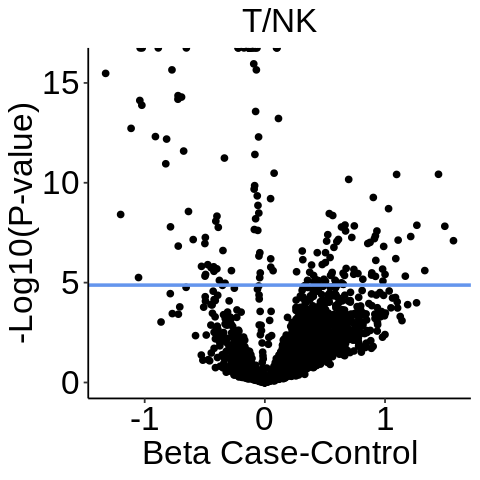

[1] "Myeloid"

FALSE  TRUE 
 5138   421 

     FALSE       TRUE 
0.92426695 0.07573305 


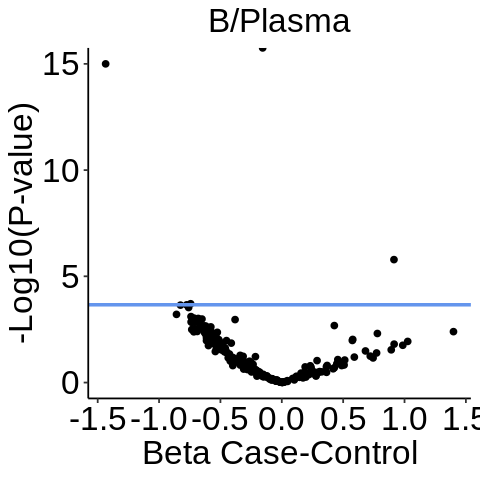

[1] "Glomerular"

FALSE  TRUE 
 7018   440 

     FALSE       TRUE 
0.94100295 0.05899705 


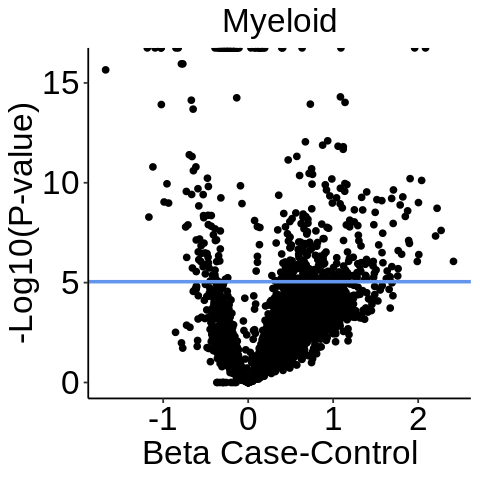

[1] "Interstitial/Stromal"

FALSE  TRUE 
 9830   841 

     FALSE       TRUE 
0.92118827 0.07881173 


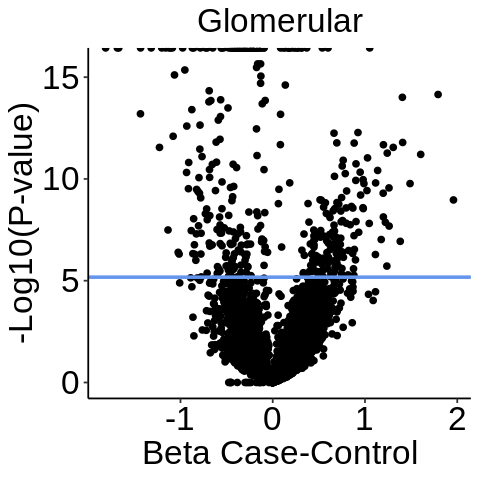

[1] "Loop of Henle"

FALSE  TRUE 
12810  1916 

  FALSE    TRUE 
0.86989 0.13011 


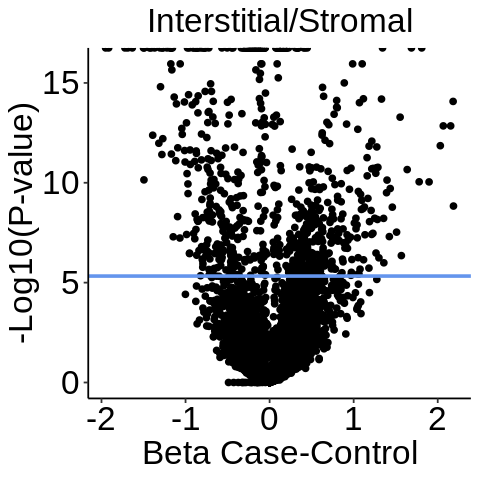

[1] "Distal Nephron"

FALSE  TRUE 
13327  2369 

    FALSE      TRUE 
0.8490698 0.1509302 


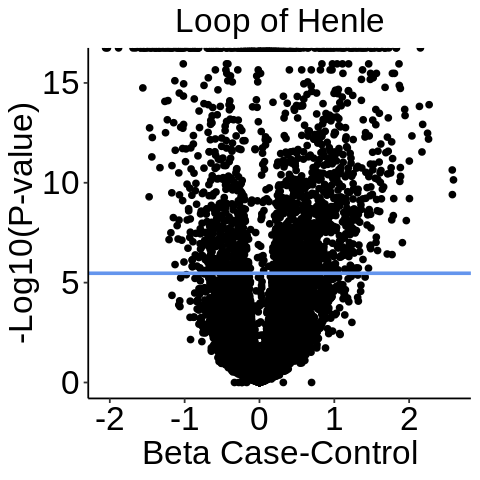

[1] "Proximal Tubule"

FALSE  TRUE 
12910   747 

     FALSE       TRUE 
0.94530278 0.05469722 


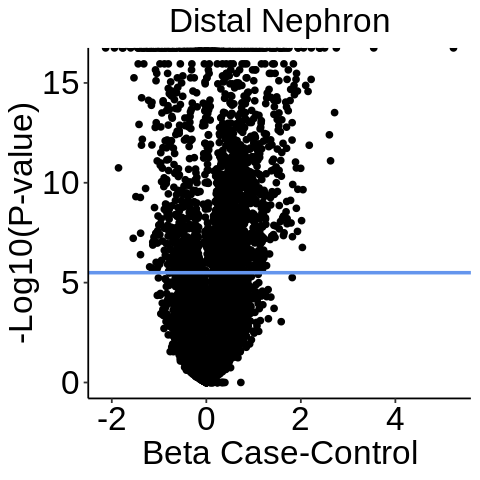

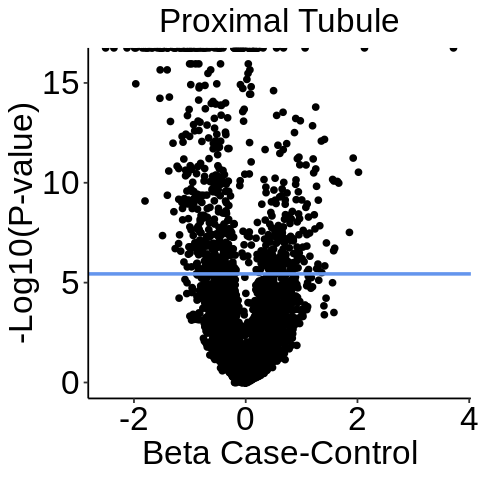

In [75]:
for (ctype in celltypes){
    res = res_list[[ctype]]
        
    print(ctype)
    print(table(res[['padj']]<0.05))
    print(prop.table(table(res[['padj']]<0.05)))
        
    fig.size(4, 4)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'cornflowerblue', linewidth = 1)+
        labs(x = 'Beta Case-Control', y = '-Log10(P-value)', title = ctype)
    print(p)
}

In [180]:
nctypes = 4

genelist = ((res_all %>% filter(padj < 0.05, beta > 0))$gene %>% table)
genelist = genelist[genelist > nctypes] %>% names

sig_up_all = genelist

sig_up_all

genelist = ((res_all %>% filter(padj < 0.05, beta < 0))$gene %>% table)
genelist = genelist[genelist > nctypes] %>% names

sig_down_all = genelist

sig_down_all

[1] "ABCA1"     "ADAR"      "BTN3A2"    "DDX58"     "DDX60"     "DDX60L"   
 [7] "DTX3L"     "EIF2AK2"   "EPSTI1"    "FTH1"      "FTL"       "GAPDH"    
[13] "HERC6"     "HIST1H2AC" "IFI44"     "IFI44L"    "IFI6"      "IFIH1"    
[19] "IFIT1"     "MVP"       "MX1"       "NOP10"     "OAS1"      "OAS3"     
[25] "PARP14"    "PARP9"     "RNF213"    "SAMD9L"    "SERF2"     "SH3BGRL3" 
[31] "SPATS2L"   "SPP1"      "STAT1"     "TAPBP"     "TNFSF10"   "TRIM25"   
[37] "TXNDC17"   "UQCR10"    "XAF1"

[1] "BAIAP2"  "BTF3"    "CHCHD2"  "CPM"     "EIF1"    "ERRFI1"  "FAU"    
 [8] "FBXO21"  "FKBP5"   "KLF9"    "LONRF1"  "MT-ND5"  "NACA"    "NFKBIA" 
[15] "PDK4"    "PER1"    "PPP1R10" "RPL10"   "RPL10A"  "RPL11"   "RPL13"  
[22] "RPL14"   "RPL15"   "RPL17"   "RPL18"   "RPL18A"  "RPL21"   "RPL22"  
[29] "RPL23"   "RPL23A"  "RPL24"   "RPL26"   "RPL27"   "RPL27A"  "RPL30"  
[36] "RPL32"   "RPL34"   "RPL35"   "RPL35A"  "RPL36A"  "RPL37"   "RPL37A" 
[43] "RPL38"   "RPL39"   "RPL41"   "RPL6"    "RPL7"    "RPL7A"   "RPL9"   
[50] "RPS11"   "RPS12"   "RPS13"   "RPS14"   "RPS15"   "RPS15A"  "RPS18"  
[57] "RPS21"   "RPS23"   "RPS24"   "RPS25"   "RPS27"   "RPS27A"  "RPS28"  
[64] "RPS29"   "RPS3"    "RPS3A"   "RPS4X"   "RPS5"    "RPS6"    "RPS7"   
[71] "RPS8"    "TACC1"   "TOB2"    "TPT1"    "TSC22D3" "UBA52"   "UQCRB"  
[78] "ZBTB16"  "ZFAND5"

In [282]:
dat = res_all_wide %>% dplyr::select(starts_with('beta'))
dat = dat[c(sig_up_all, sig_down_all), ]
# dat = dat[!(rowSums(is.na(dat)) > 2), ]
dat %>% dim

[1] 118   8

In [181]:
genes_show = (res_all_wide %>% filter(gene %in% c(sig_up_all, sig_down_all))) %>% 
    dplyr::select(starts_with('beta')) %>% rowMeans(na.rm = TRUE) %>% sort %>% rev %>% names

dat = res_all %>% filter(gene %in% c(sig_up_all, sig_down_all))
# dat = dat[!(rowSums(is.na(dat)) > 2), ]
dat %>% dim

dat$gene = factor(dat$gene, levels = genes_show)

[1] 865   7

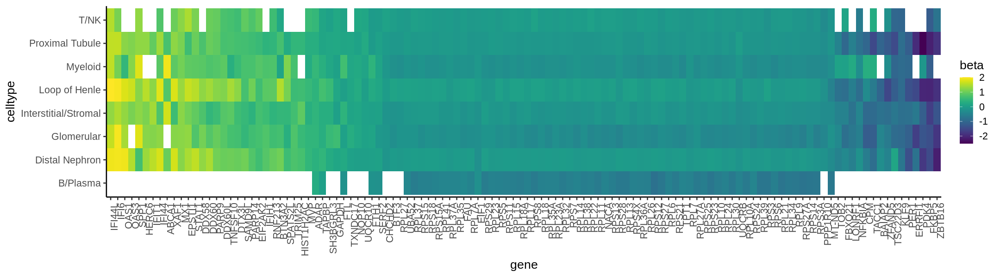

In [40]:
fig.size(5, 18)
ggplot(dat)+
    geom_tile(aes(x = gene, y = celltype, fill = beta))+
    scale_fill_viridis()+
    theme_classic(base_size = tickfontsize)+
    theme(axis.text.x = element_text(angle = 90, hjust = 1))

In [41]:
c(genes_show[1:10], genes_show[(length(genes_show)-10):length(genes_show)]) 

[1] "IFI44L"  "IFI6"    "OAS1"    "OAS3"    "SPP1"    "HERC6"   "IFIT1"  
 [8] "IFI44"   "ABCA1"   "XAF1"    "CPM"     "TACC1"   "BAIAP2"  "ZFAND5" 
[15] "TSC22D3" "KLF9"    "PER1"    "ERRFI1"  "PDK4"    "FKBP5"   "ZBTB16"

In [182]:
genes_show_filt = c(genes_show[1:10], genes_show[(length(genes_show)-10):length(genes_show)])

dat_filt = dat %>% filter(gene %in% genes_show_filt)
dat_filt[['gene']] = factor(dat_filt$gene, levels = genes_show_filt)

dat_filt %>% dim
vmax = (dat_filt$beta %>% abs %>% quantile(.99))[[1]] %>% round(2)
vmax

dat_filt =dat_filt %>% complete(gene, celltype)
dat_filt %>% dim

[1] 130   7

[1] 2.13

[1] 147   7

In [294]:
genes_label = list()

genes_label[['T/NK']] = c('TIGIT', 'IL27RA', 'CX3CR1')
genes_label[['Myeloid']] = c('LGMN', 'CTSD',  'PCCA', 'NRP1')
genes_label[['Glomerular']] = c('S100A4', 'SERPINH1', 'HBEGF', 'TIMP2')
genes_label[['Interstitial/Stromal']] = c('COL1A1', 'PCOLCE','CDH11', 'MIOX')
genes_label[['Loop of Henle']] = c('S100A4', 'SERPINH1', 'HBEGF')
genes_label[['Distal Nephron']] = c('SLPI', 'LCN2', 'NT5E', c('HLA-DRB1', 'HLA-DMB'),
                                    'MMP7', 'TIMP1')
genes_label[['Proximal Tubule']] = c('TGM2', 'RARRES1', 'CRIP3')


In [281]:
(res_all[grepl('HLA', res_all$gene), ] %>% filter(padj < 0.05))$gene %>% table %>% sort

.
   HLA-C HLA-DRB5    HLA-A  HLA-DMA HLA-DPA1 HLA-DPB1 HLA-DQA1 HLA-DQB1 
       1        1        2        2        2        2        2        2 
 HLA-DRA    HLA-B  HLA-DMB HLA-DRB1    HLA-E    HLA-F 
       2        3        3        3        3        3 

In [268]:
c('HLA-DRB1', 'HLA-DMB')

[1] "HLA-DRB1" "HLA-DMB"

In [295]:
genes_show_filt = c(genes_show[1:10], c('STAT1', 'MX1'), 
                    genes_show[(length(genes_show)-10):length(genes_show)],
                   genes_label %>% unlist %>% unname %>% rev) %>% unique

dat_filt = res_all %>% filter(gene %in% genes_show_filt)
dat_filt[['gene']] = factor(dat_filt$gene, levels = genes_show_filt)

dat_filt %>% dim
vmax = (dat_filt$beta %>% abs %>% quantile(.99))[[1]] %>% round(2)
vmax

dat_filt =dat_filt %>% complete(gene, celltype)
dat_filt %>% dim

[1] 253   7

[1] 2.54

[1] 384   7

In [296]:
dat_filt = dat_filt %>% filter(celltype != 'B/Plasma')

dat_filt$celltype = factor(dat_filt$celltype, levels = names(genes_label))

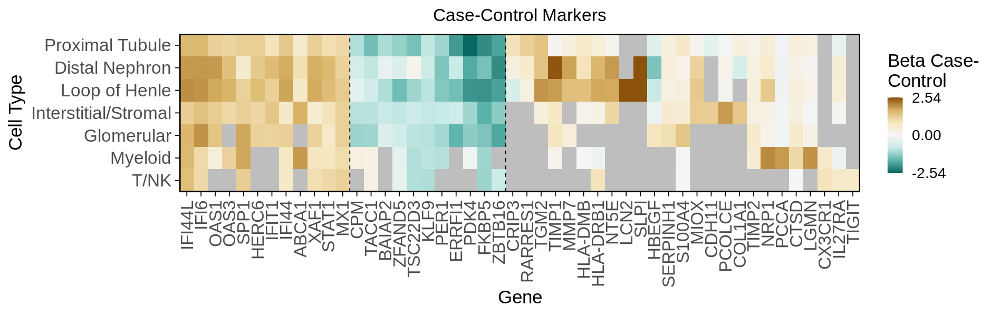

In [313]:
de_plot = ggplot(dat_filt)+
    geom_tile(aes(x = gene, y = celltype, fill = beta))+
    scale_fill_gradientn(colours=rev(brewer.pal(7,"BrBG")), breaks = c(-vmax, 0, vmax),
                        limits = c(-vmax, vmax), oob=scales::squish, na.value = 'grey')+
    theme_classic(base_size = tickfontsize+5)+
    theme(text = element_text(family = "Arial"),
          axis.text.x = element_text(angle = 90, hjust = 1,  vjust = 0.5),
          axis.text = element_text(size = labelfontsize),
          axis.line = element_line(color = "black", size = 0.5),  # Ensuring axis lines are black and visible
          axis.ticks = element_line(color = "black", size = 0.5),  # Adding ticks to the axes
          panel.border = element_rect(color = "black", fill = NA, size = 1), 
          plot.title = element_text(size = labelfontsize, hjust = 0.5)) +  # Border around the panel
    labs(x = 'Gene', y = 'Cell Type', fill = 'Beta Case-\nControl', title = 'Case-Control Markers')+
    geom_vline(xintercept = 12.5, linetype = 'dashed')+
    geom_vline(xintercept = 23.5, linetype = 'dashed')+
  scale_x_discrete(expand = c(0, 0)) +
  scale_y_discrete(expand = c(0, 0))


height = 5
width = 15.8

fig.size(height, width)
outplot = de_plot
outplot

ggsave(paste0(figdir, 'de_gene_heatmap_casectrl.png'), plot = outplot,  
       height = height, width = width, dpi = 500)
ggsave(paste0(figdir, 'de_gene_heatmap_casectrl.pdf'), plot = outplot,  
       height = height, width = width, dpi = 500, device = cairo_pdf)



In [320]:
paths_plot = rbind(gsea_list[['all']] %>% filter(padj < 0.05) %>% 
                   arrange(desc(NES)) %>% dplyr::select(pathway, NES) %>% head(4), 
                   gsea_list[['all']] %>% filter(padj < 0.05) %>% 
                   arrange(desc(NES)) %>% dplyr::select(pathway, NES) %>% tail(4))
paths_plot = paths_plot$pathway

In [321]:
dat = gsea_all %>% filter(pathway %in% paths_plot)# %>% pivot_wider(names_from = celltype, values_from = NES, id_cols = pathway)%>% as.data.frame
# rownames(dat) = dat$pathway
dat$pathway = factor(dat$pathway, levels = rev(paths_plot))


In [322]:
map = c(setNames('All', 'all'))
for (ctype in celltypes){
    name = ctype_list[[ctype]][3]
    map = c(map, setNames(ctype, name))
}

In [323]:
dat$celltype_rename = map[dat$celltype]

In [324]:
paths_plot_short = c('H_IFN_ALPHA', 'H_IFN_GAMMA', 
                    'GOMF_CALCIUM_PB', 'GOBP_NEGREG_VIR',
                     'GOCC_MITOPROT_COMP', 'GOCC_INNERMITOMEM',
                     'GOMF_ELECTRANS', 'GOBP_ENERGY_OXIDORGAN')

                     
                     # 'GOBP_TRMEM_TRANS',
                     # 'HP_ABVASC_MORPH', 'GOBP_ORG_INNERMEM', 
                     # 'GOCC_TRANS_COMP', 

In [326]:
dat = dat %>% mutate(label = ifelse(padj < 0.05, '﹡', ''))

In [328]:
dat_complete = dat %>%
      complete(celltype_rename, pathway)

In [ ]:
# vmax = (dat_filt$beta %>% abs %>% quantile(.99))[[1]] %>% round(2)


Warning message in geom_text(aes(x = celltype_rename, y = pathway, label = label), :
“Ignoring unknown parameters: `fill`”
Warning message:
“Removed 5 rows containing missing values or values outside the scale range
(`geom_text()`).”
Warning message:
“Removed 5 rows containing missing values or values outside the scale range
(`geom_text()`).”
Warning message:
“Removed 5 rows containing missing values or values outside the scale range
(`geom_text()`).”


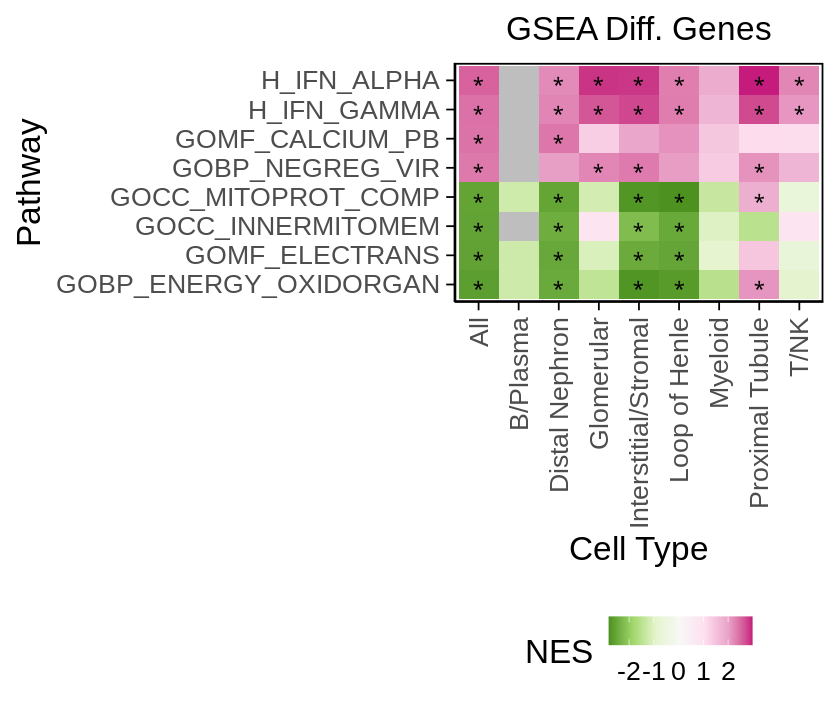

In [331]:
hmap = ggplot(dat_complete)+
    geom_tile(aes(x = celltype_rename, y =pathway, fill = NES))+
    geom_text(aes(x = celltype_rename, y =pathway, label = label), fill = 'black', color = "black", size = 7) +
    scale_fill_gradientn(colours=rev(brewer.pal(7,"PiYG")), 
                         # breaks = c(-vmax, 0, vmax),limits = c(-vmax, vmax), oob=scales::squish, 
                         na.value = 'grey')+
    # scale_fill_viridis(option = 'plasma', na.value = 'grey')+
    theme_classic(base_size = labelfontsize)+
    theme(text = element_text(family = "Arial"), 
          plot.title = element_text(hjust = 0.5, size = labelfontsize),
          axis.text.x = element_text(angle = 90, hjust = 1,  vjust = 0.5),
          axis.text = element_text(size = tickfontsize),
          axis.line = element_line(color = "black", size = 0.5),  # Ensuring axis lines are black and visible
          axis.ticks = element_line(color = "black", size = 0.5),  # Adding ticks to the axes
          panel.border = element_rect(color = "black", fill = NA, size = 1),
         legend.position = 'bottom') + 
    scale_y_discrete(labels = rev(paths_plot_short))+# Border around the panel
    labs(x = 'Cell Type', y = 'Pathway', fill = 'NES', title = 'GSEA Diff. Genes')
    # scale_fill_gradient2(low = 'blue', mid = 'lightgray', high = 'red', na.value = 'white')

height = 6
width = 7
fig.size(height, width)
outplot = hmap
outplot

ggsave(paste0(figdir, 'gsea_heatmap_casectrl.png'), plot = outplot,  
       height = height, width = width, dpi = 500)
ggsave(paste0(figdir, 'gsea_heatmap_casectrl.pdf'), plot = outplot,  
       height = height, width = width, dpi = 500, device = cairo_pdf)


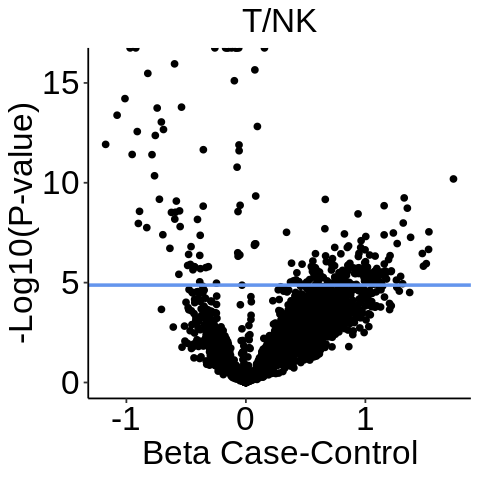

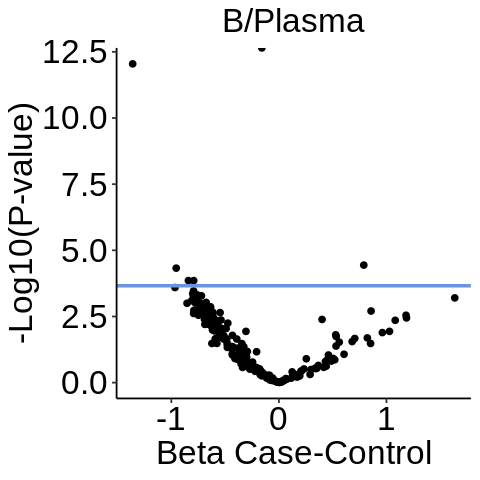

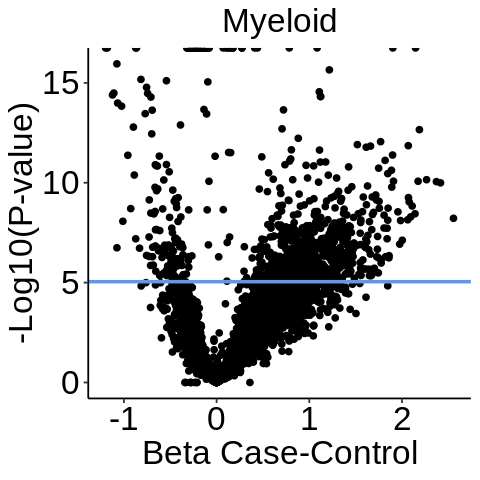

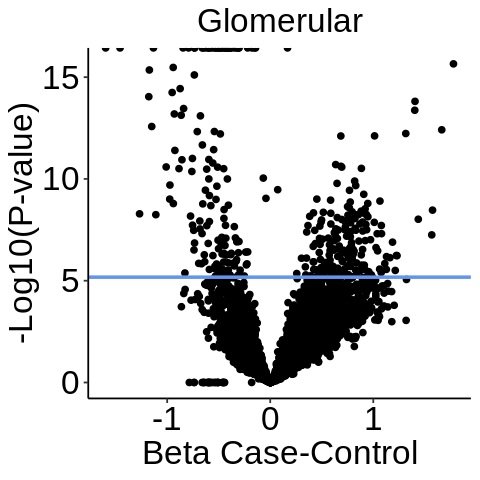

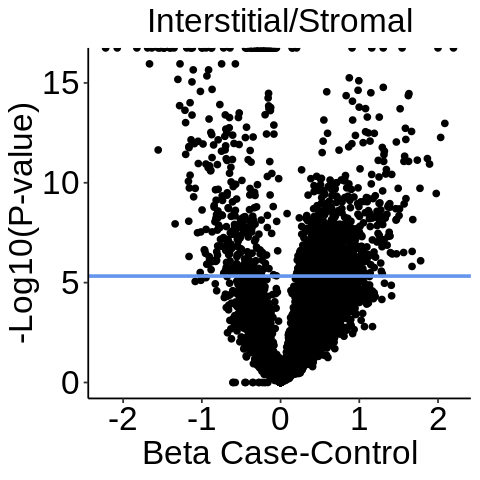

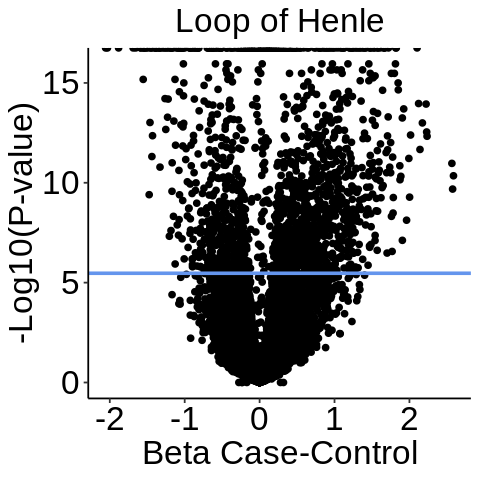

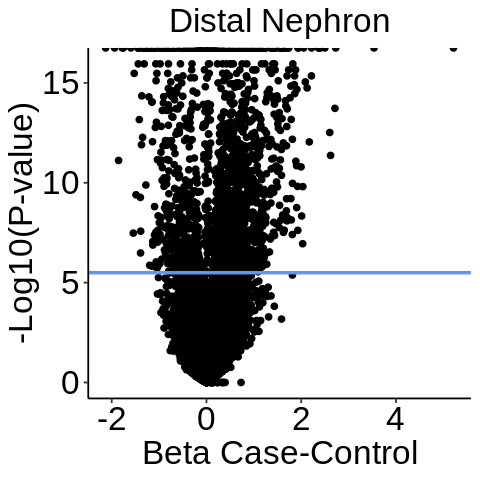

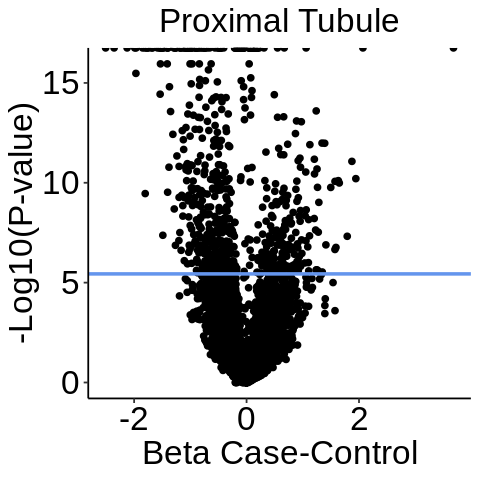

In [17]:
# ISG score comparisons
for (ctype in celltypes){
    res = res_list_isg[[ctype]]
        
    fig.size(4, 4)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'cornflowerblue', linewidth = 1)+
        labs(x = 'Beta Case-Control', y = '-Log10(P-value)', title = ctype)
    print(p)
}

In [64]:
celltypes[1:55:1][]_res_listfor (ctype in celltypes){
    res = res_list_isg[[ctype]]
}

In [20]:
ctype = 'T/NK'

In [ ]:
res_list_isg

In [136]:
isg_genes_regex = res_all$gene[grep("^IF|^IS", res_all$gene)]

In [149]:
isg_genes = readRDS('/data/srlab/ssg34/SLE_kidney_v2/data/pseudobulk_de/isg_genes.rds')

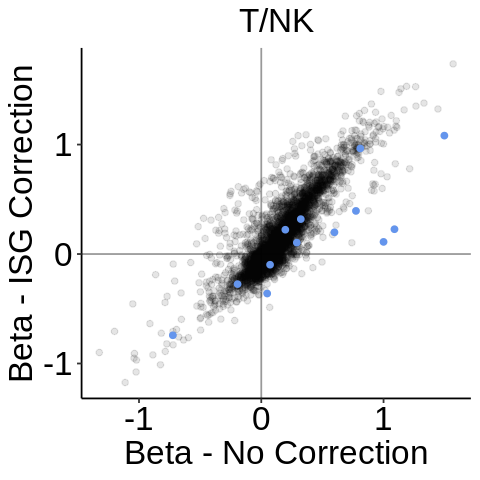

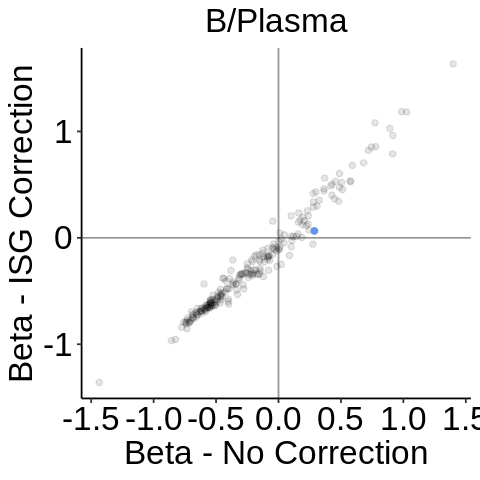

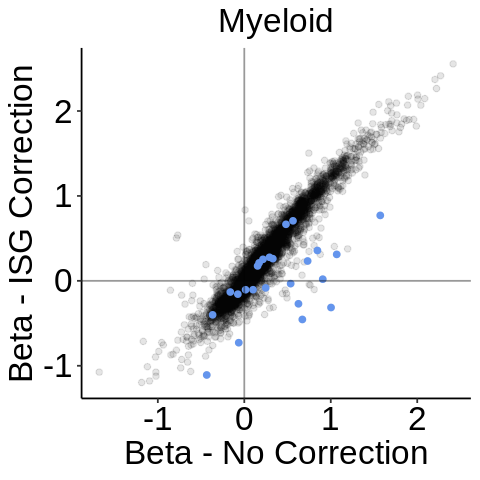

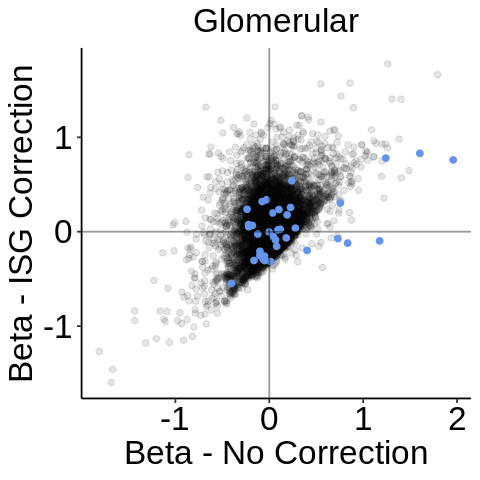

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


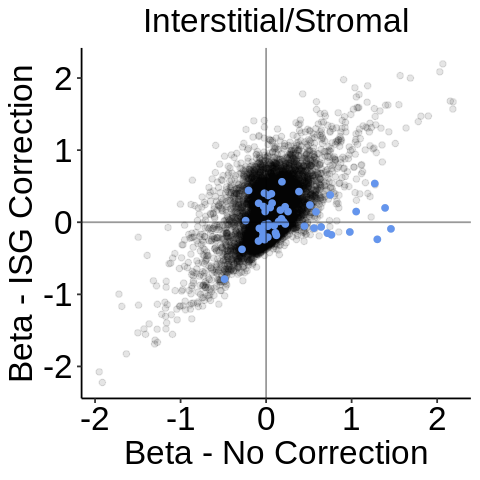

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


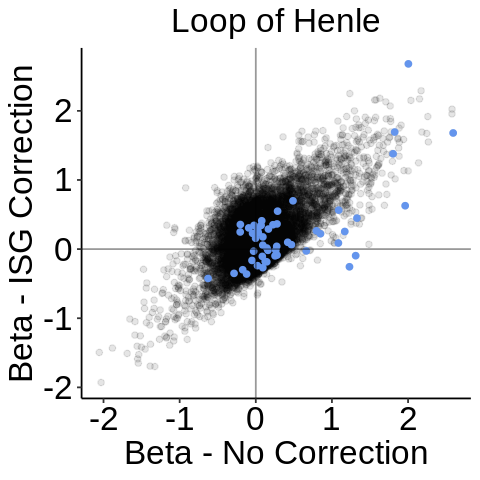

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


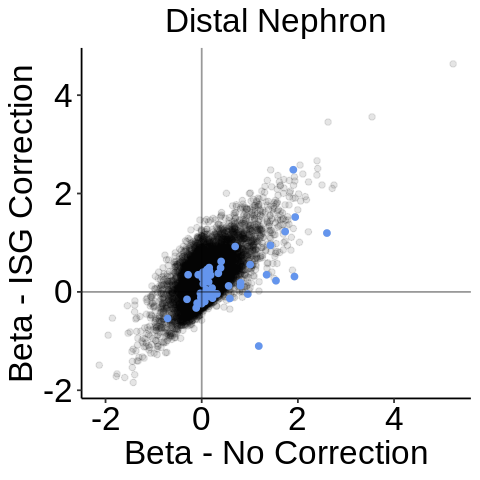

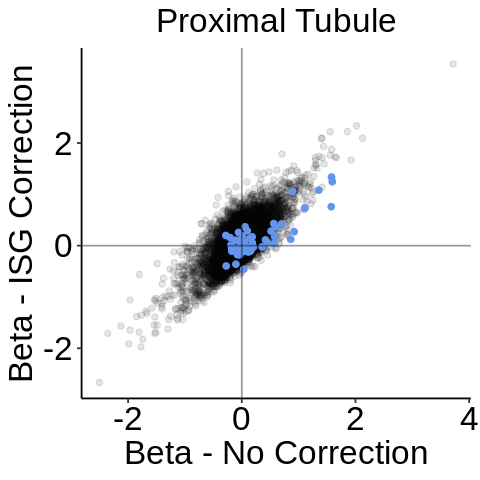

In [144]:
for (ctype in celltypes){

    res = res_list[[ctype]] 
    res_isg = res_list_isg[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISG-Correction'
    res = rbind(res, res_isg)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = beta)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISG-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISG-Correction`), color = 'cornflowerblue',
               data = res %>% filter(gene %in% isg_genes_regex))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = 'Beta - No Correction', y = 'Beta - ISG Correction')
    print(p)
    
}

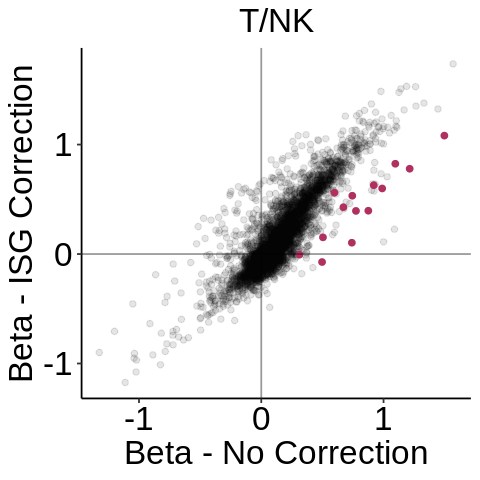

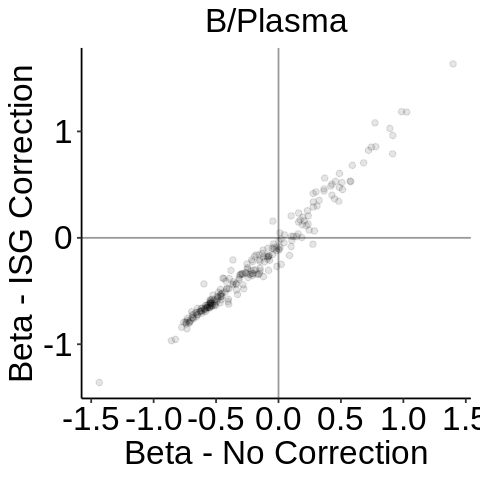

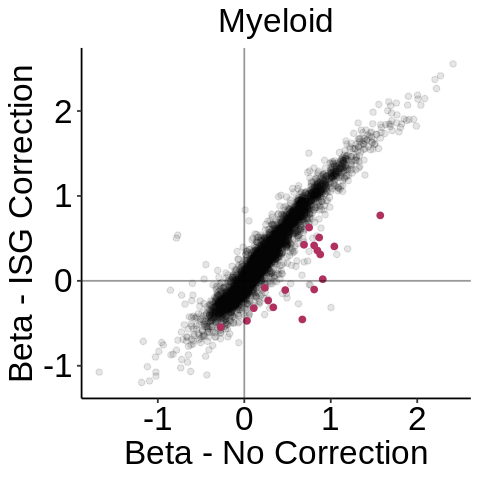

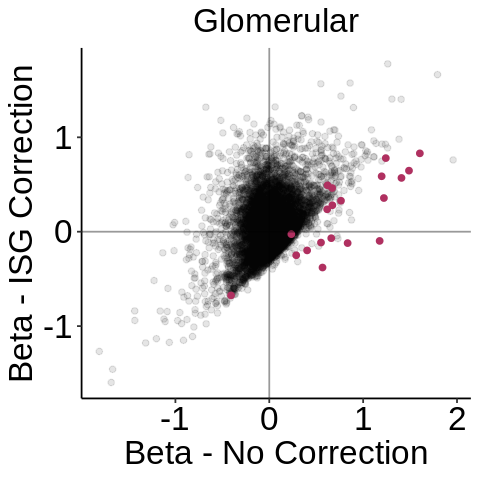

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


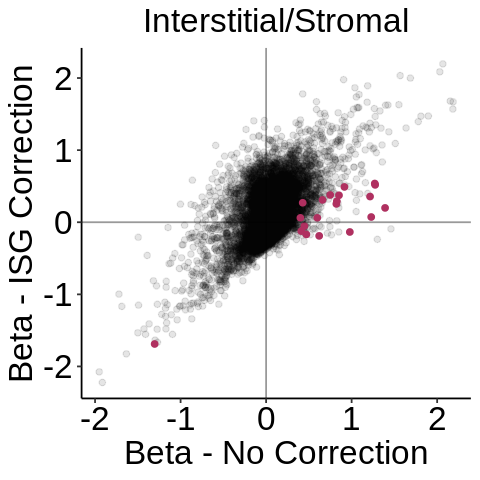

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


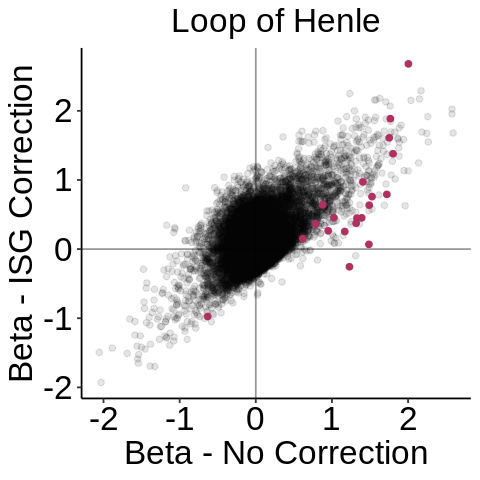

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


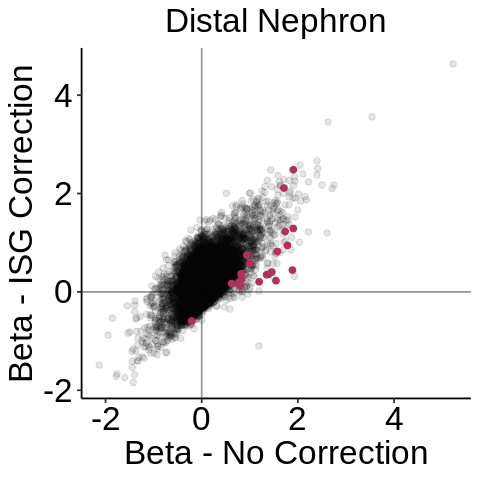

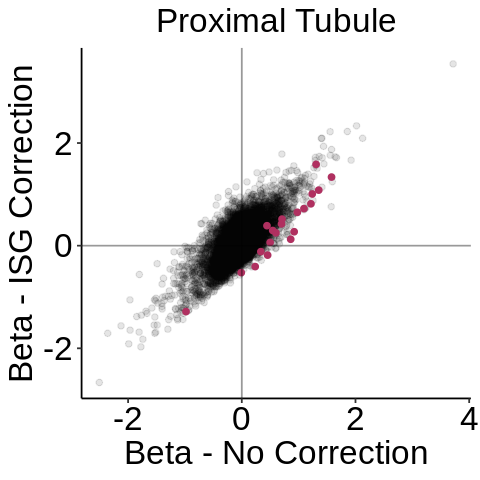

In [150]:
for (ctype in celltypes){

    res = res_list[[ctype]] 
    res_isg = res_list_isg[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISG-Correction'
    res = rbind(res, res_isg)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = beta)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISG-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISG-Correction`), color = 'maroon',
               data = res %>% filter(gene %in% isg_genes))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = 'Beta - No Correction', y = 'Beta - ISG Correction')
    print(p)
    
}

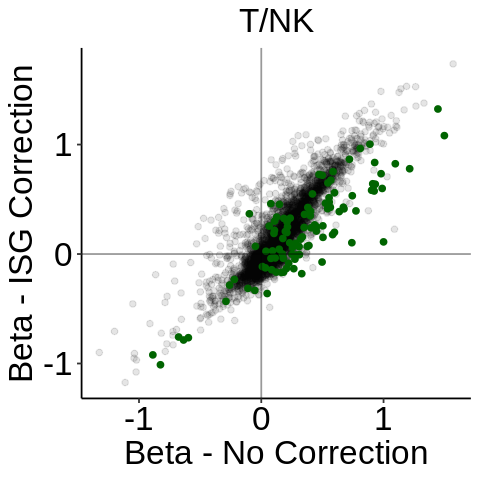

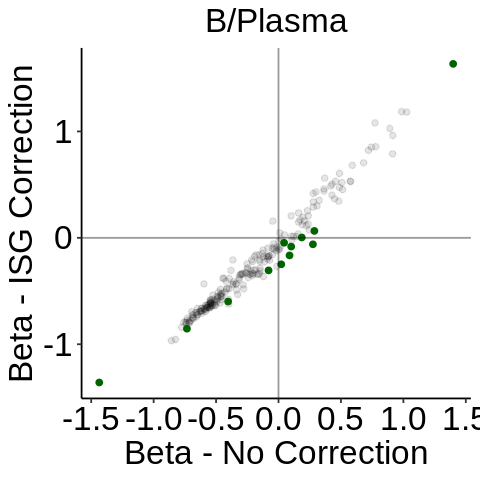

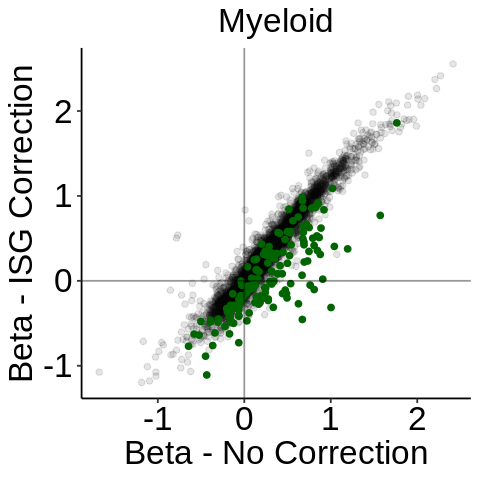

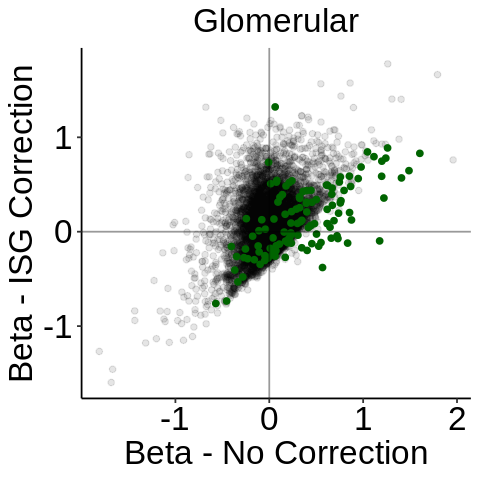

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


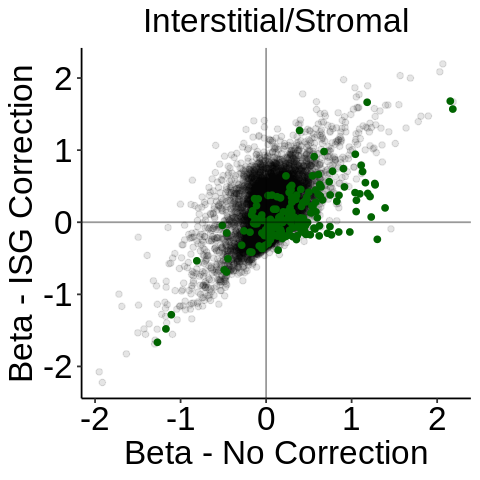

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


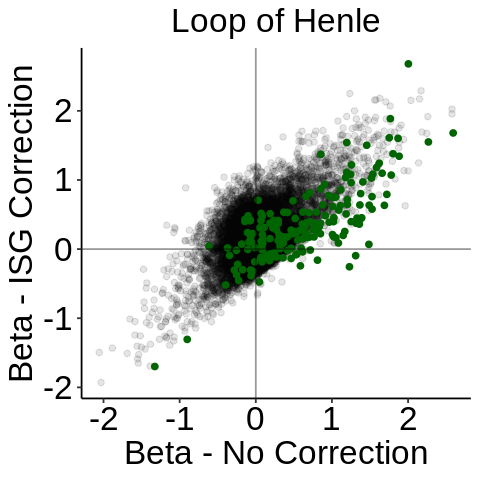

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


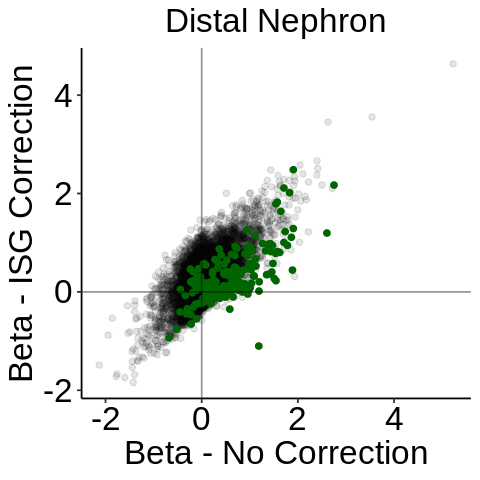

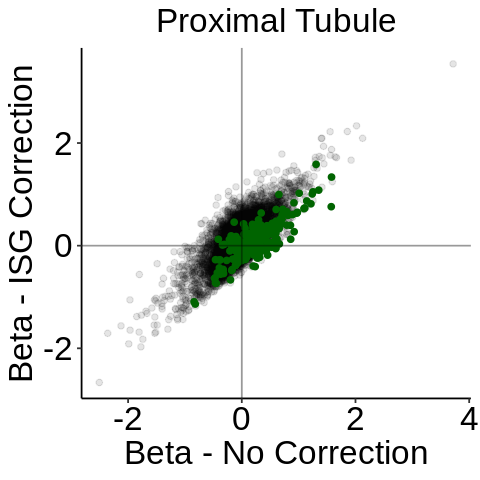

In [177]:
for (ctype in celltypes){

    res = res_list[[ctype]] 
    res_isg = res_list_isg[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISG-Correction'
    res = rbind(res, res_isg)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = beta)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISG-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISG-Correction`), color = 'darkgreen',
               data = res %>% filter(gene %in% isg_genes_hall))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = 'Beta - No Correction', y = 'Beta - ISG Correction')
    print(p)
    
}

In [131]:
isg_genes

ERROR: Error in eval(expr, envir, enclos): object 'isg_genes' not found


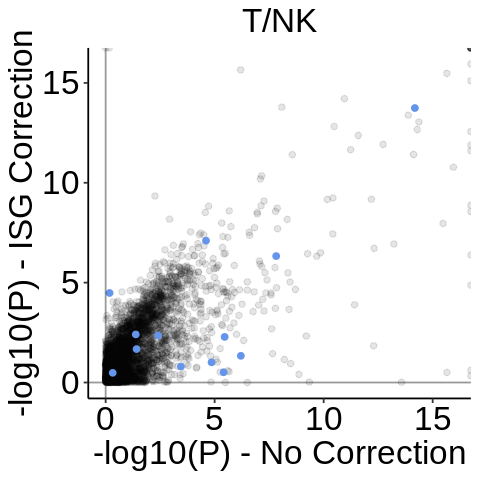

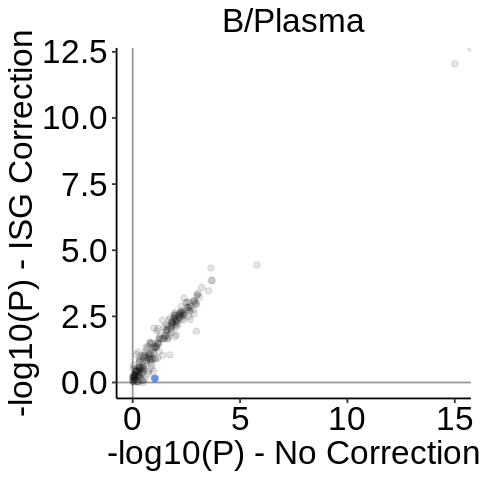

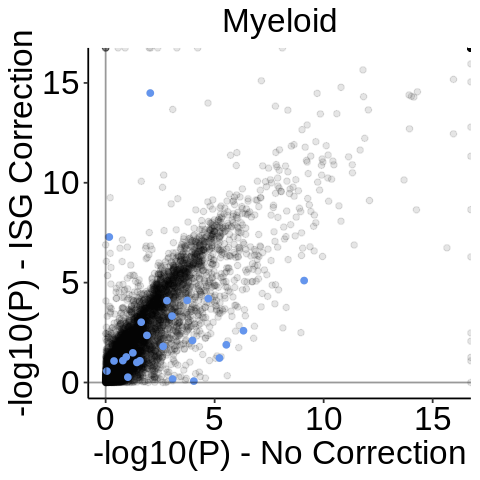

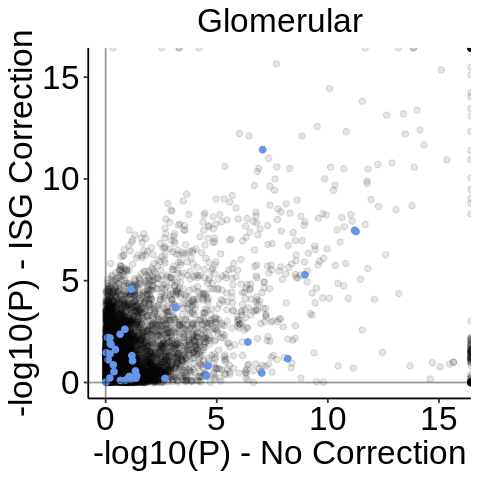

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


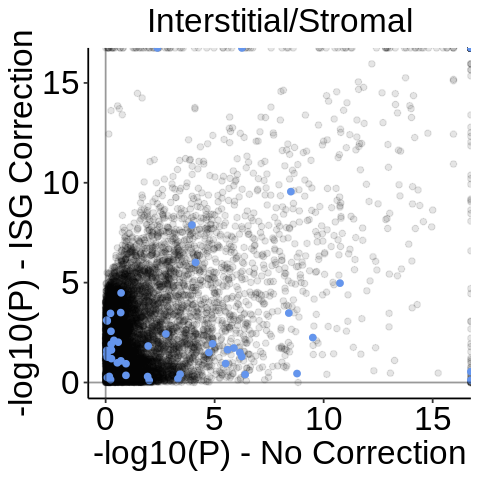

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


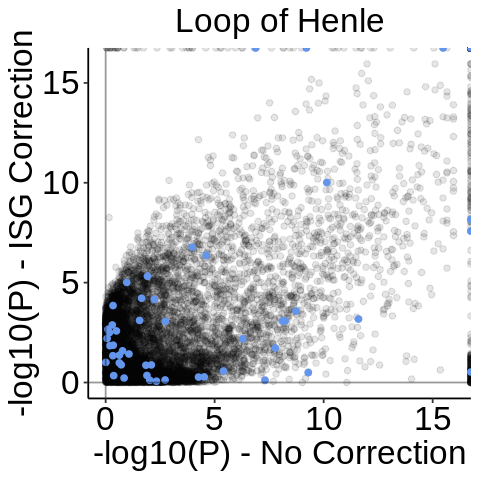

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


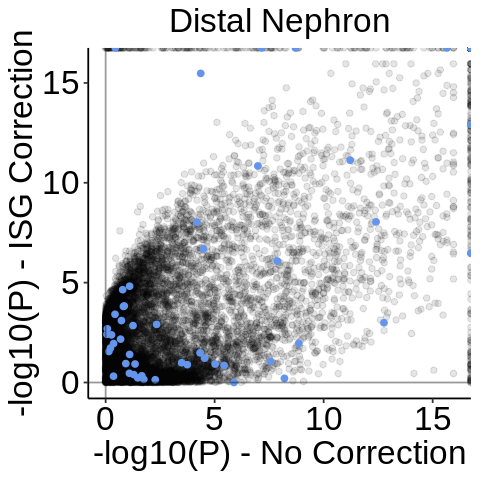

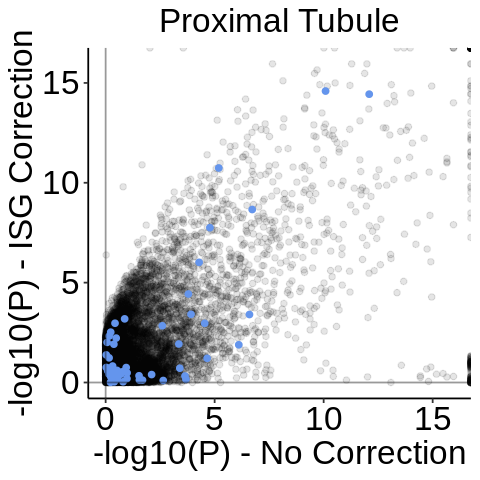

In [145]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isg[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISG-Correction'
    res = rbind(res, res_isg)
    res$p = -log10(res$p)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = p)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISG-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISG-Correction`), color = 'cornflowerblue',
               data = res %>% filter(gene %in% isg_genes_regex))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = '-log10(P) - No Correction', y = '-log10(P) - ISG Correction')
    print(p)
    
}

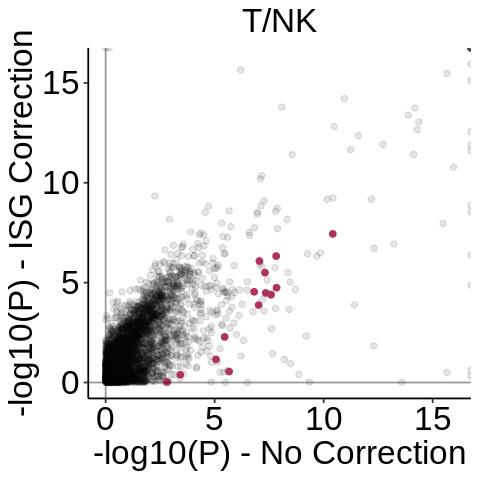

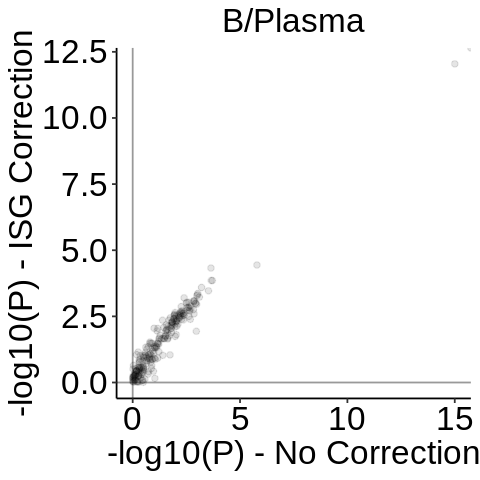

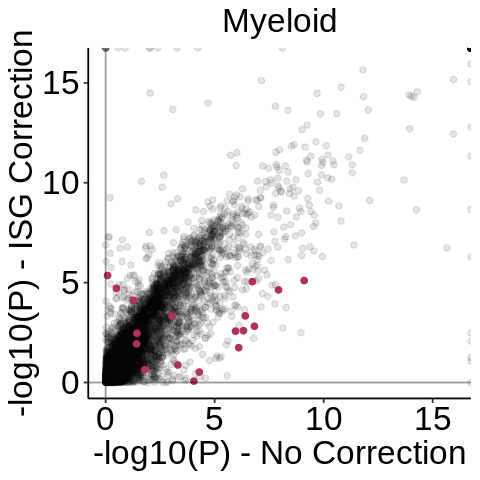

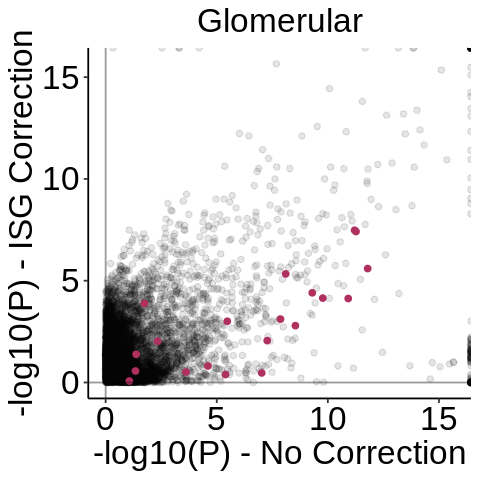

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


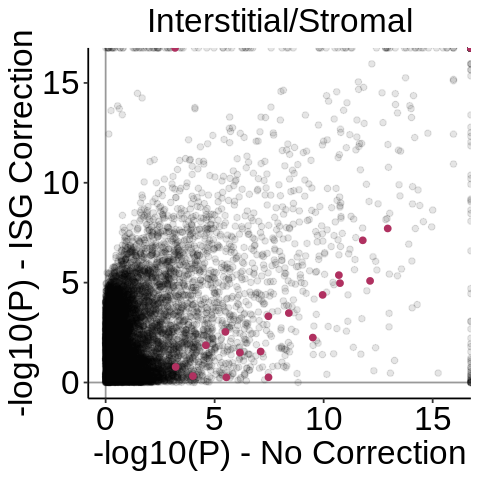

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


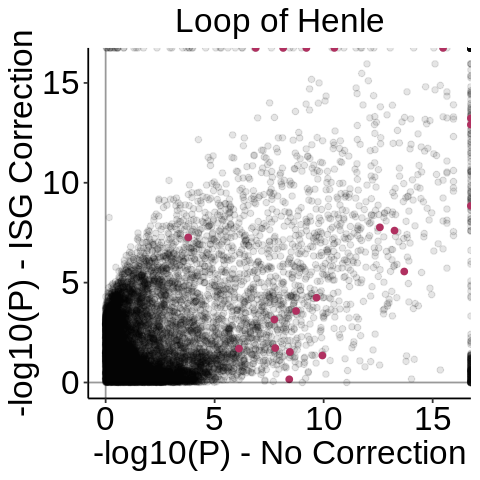

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


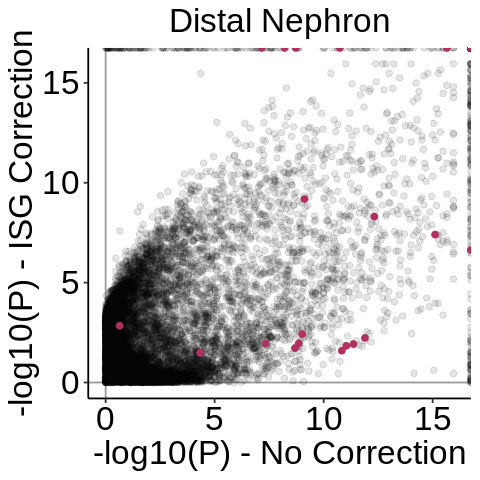

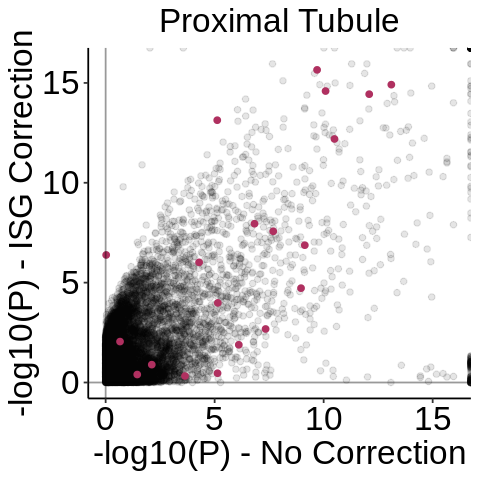

In [151]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isg[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISG-Correction'
    res = rbind(res, res_isg)
    res$p = -log10(res$p)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = p)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISG-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISG-Correction`), color = 'maroon',
               data = res %>% filter(gene %in% isg_genes))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = '-log10(P) - No Correction', y = '-log10(P) - ISG Correction')
    print(p)
    
}

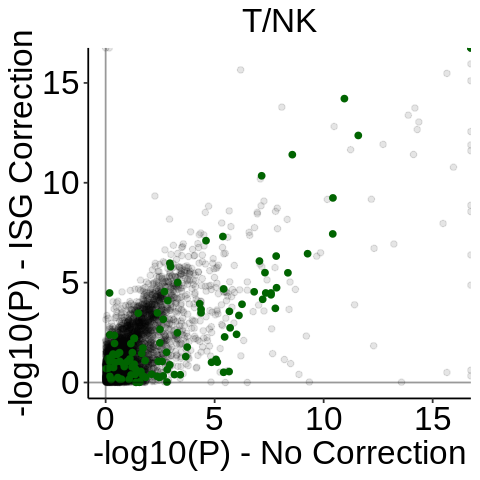

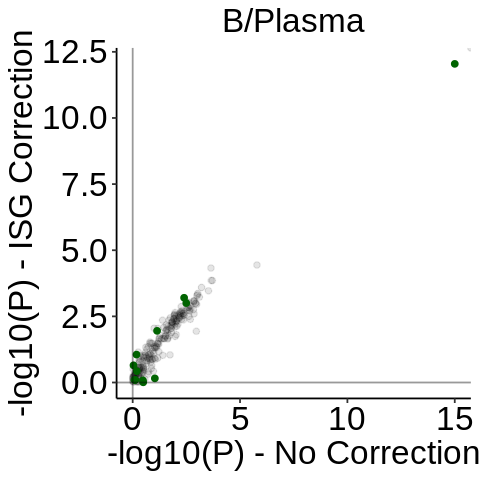

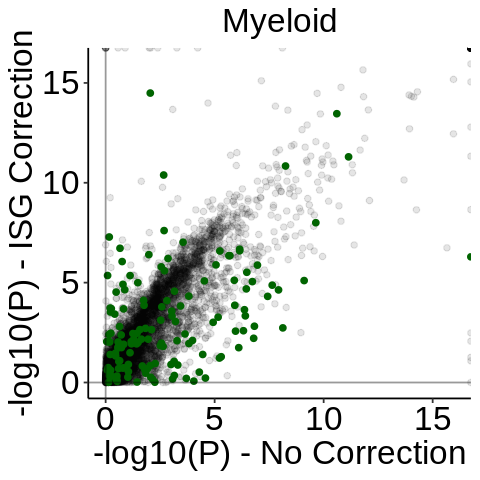

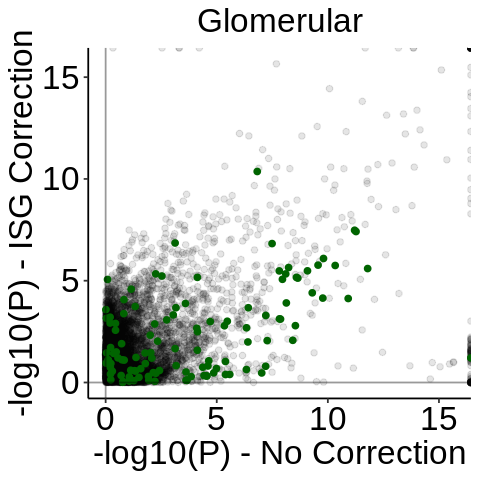

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


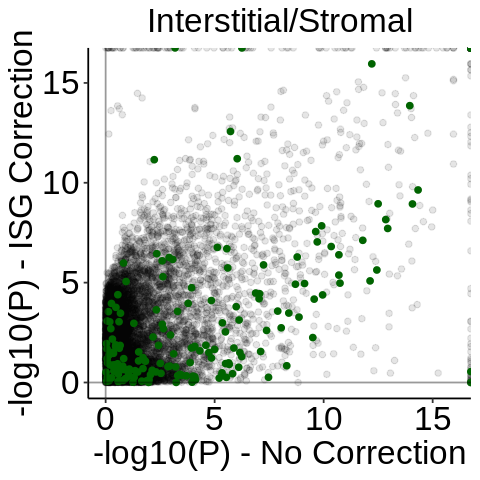

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


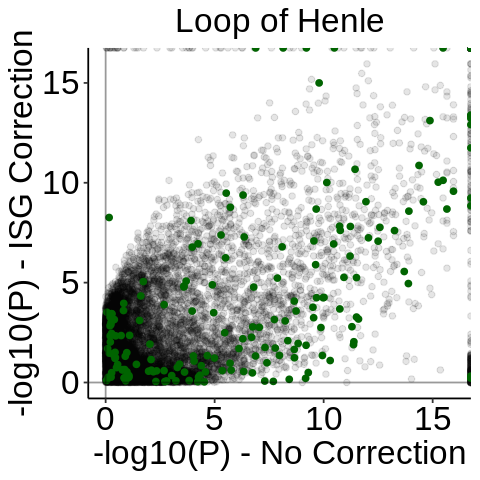

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


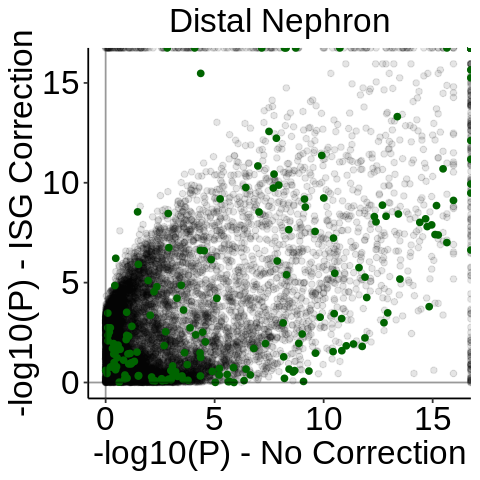

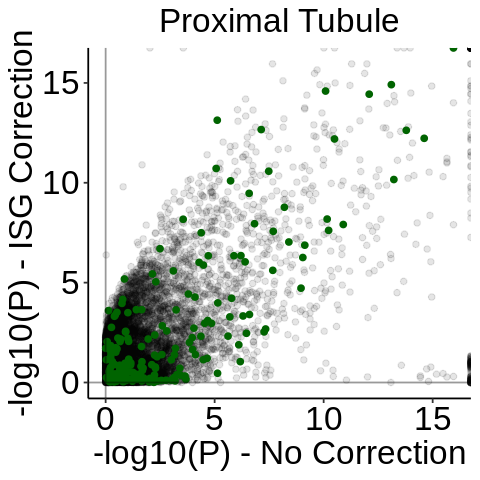

In [176]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isg[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISG-Correction'
    res = rbind(res, res_isg)
    res$p = -log10(res$p)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = p)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISG-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISG-Correction`), color = 'darkgreen',
               data = res %>% filter(gene %in% isg_genes_hall))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = '-log10(P) - No Correction', y = '-log10(P) - ISG Correction')
    print(p)
    
}

In [179]:
for (ctype in celltypes){
    print(ctype)
    print('Enriched')
   print(res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('Depleted')
    print(res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('')

}

[1] "T/NK"
[1] "Enriched"
 [1] "PHACTR2"  "IFI44L"   "EPSTI1"   "P2RY8"    "SPP1"     "MX1"     
 [7] "RASA3"    "SH2D3C"   "STAT1"    "IFI6"     "LTB"      "ISG15"   
[13] "XAF1"     "SPTLC2"   "DDX60"    "PARP9"    "MX2"      "CX3CR1"  
[19] "EIF2AK2"  "HLA-DRB1" "SAMD9L"   "LYST"     "NFKB1"    "TYMP"    
[25] "POU2F2"   "PTPN11"   "IFI44"    "PARP14"   "LY6E"     "CLSTN1"  
[31] "TIGIT"    "IL27RA"   "GBP4"     "TNFSF10"  "LASP1"    "DDHD1"   
[37] "SPEN"     "MAL"      "TPP2"     "HDAC7"    "CD74"     "RPS6KA1" 
[43] "RNF213"   "IGFBP7"   "PSME2"    "GBP5"     "PTPN6"    "RAB29"   
[49] "MVP"      "PSD4"    
[1] "Depleted"
 [1] "SYTL3"      "FKBP5"      "CXCR4"      "APBA2"      "KLF9"      
 [6] "IL7R"       "TSC22D3"    "PRDM1"      "CRYBG1"     "TXNIP"     
[11] "SOCS1"      "PIK3IP1"    "CXCR6"      "GPR171"     "IFNGR1"    
[16] "GABPB1-IT1" "DDIT4"      "ZFP36L2"    "BTG1"       "CYTIP"     
[21] "NFKBIA"     "CD69"       "DHRS3"      "TUBA4A"     "SMAP2"     
[26] "GPR65"  

In [128]:
for (ctype in celltypes){
    print(ctype)
    print('Enriched')
   print(res_list_isg[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('Depleted')
    print(res_list_isg[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('')

}

[1] "T/NK"
[1] "Enriched"
 [1] "PHACTR2" "PRKCA"   "UMAD1"   "DLEU2"   "ANK3"    "NSMCE2"  "P2RY8"  
 [8] "SPP1"    "EPSTI1"  "RASA3"   "RUNX1"   "STK39"   "PIK3CD"  "KLF12"  
[15] "MKLN1"   "ZEB1"    "SMAD3"   "RASSF3"  "LRRC8C"  "TNIK"    "R3HDM1" 
[22] "PVT1"    "SPPL3"   "IKZF2"   "SEL1L3"  "SH2D3C"  "MBD5"    "SLCO3A1"
[29] "PTBP2"   "CDK19"   "TCF20"   "DYRK1A"  "ARID2"   "IFI44L"  "RELCH"  
[36] "NCOA1"   "NFATC2"  "GLCCI1"  "LPP"     "FAM53B"  "PPP3CA"  "DLG1"   
[43] "CDK6"    "ARIH1"   "SPTLC2"  "PPP3R1"  "FBXO34"  "TRRAP"   "NFKB1"  
[50] "HERC4"  
[1] "Depleted"
 [1] "CXCR4"      "TSC22D3"    "SOCS1"      "PRDM1"      "KLF9"      
 [6] "TXNIP"      "IL7R"       "SYTL3"      "CXCR6"      "DDIT4"     
[11] "GPR171"     "NFKBIA"     "CD69"       "BTG1"       "IFNGR1"    
[16] "PIK3IP1"    "GABPB1-IT1" "ZFP36"      "ZFP36L2"    "CRYBG1"    
[21] "H1FX"       "CYTIP"      "SRGN"       "TUBA4A"     "GPR65"     
[26] "LINC01871"  "FKBP11"     "TMEM173"    "DYNLT1"     "PTGER4"    

In [73]:
res_all_isg[grep("^IF|^IS", res_all_isg$gene), ] %>% filter(padj < 0.05)

gene,beta,stderr,z.score,p,celltype,padj
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>
IFI44L,1.08167965,0.198999007,5.435603,4.682151e-07,T/NK,1.765639e-03
IFNGR1,-0.74229953,0.092368160,-8.036314,1.809664e-14,T/NK,6.824241e-11
IFNAR2,0.96435588,0.172226091,5.599360,7.931336e-08,T/NK,2.990907e-04
IFI44L,0.77067590,0.162300445,4.748452,7.885845e-06,Myeloid,4.383741e-02
IFITM2,-0.72806010,0.134327076,-5.420055,5.191716e-08,Myeloid,2.886075e-04
ISG20,-1.10818574,0.137672717,-8.049422,3.219647e-15,Myeloid,1.789802e-11
IFI6,0.76063429,0.153176819,4.965727,5.088861e-06,Glomerular,3.795272e-02
IFI44L,0.83020060,0.138525342,5.993132,3.319410e-08,Glomerular,2.475616e-04
IFI44,0.77967516,0.134995755,5.775553,3.841526e-08,Glomerular,2.865010e-04


In [74]:
res_all[grep("^IF|^IS", res_all$gene), ] %>% filter(padj < 0.05)

gene,beta,stderr,z.score,p,celltype,padj
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>
ISG15,1.0000317,0.199768694,5.005948,3.885615e-06,T/NK,1.465265e-02
IFI6,1.0893956,0.202491917,5.379946,6.291629e-07,T/NK,2.372573e-03
IFI44L,1.4974766,0.233591119,6.410674,1.503617e-08,T/NK,5.670142e-05
IFI44,0.7743206,0.159157044,4.865136,3.482688e-06,T/NK,1.313322e-02
IFNGR1,-0.7232411,0.089128862,-8.114555,6.550316e-15,T/NK,2.470124e-11
IFI6,1.0688648,0.205200137,5.208889,2.915453e-06,Myeloid,1.620701e-02
IFI44L,1.5725831,0.215981152,7.281112,7.853683e-10,Myeloid,4.365863e-06
IFI44,0.8453767,0.148557585,5.690565,4.782306e-07,Myeloid,2.658484e-03
IFIH1,0.7323263,0.157993100,4.635179,6.011608e-06,Myeloid,3.341853e-02


In [ ]:
res_list_isg

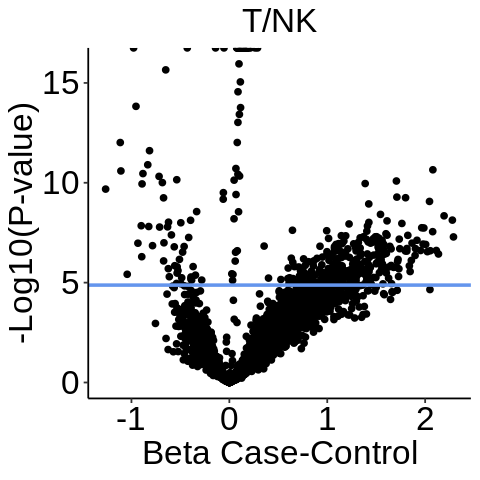

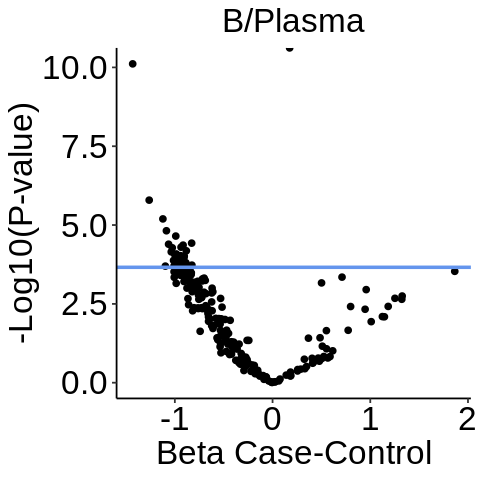

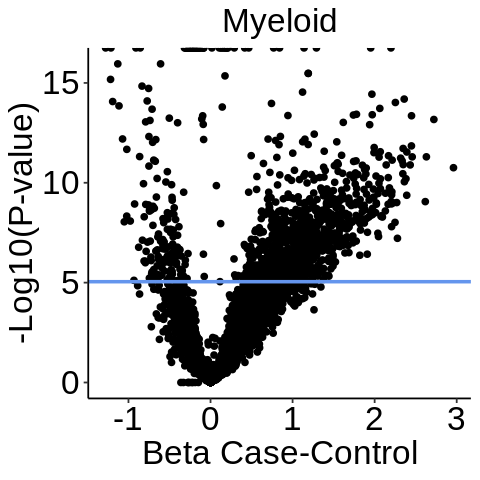

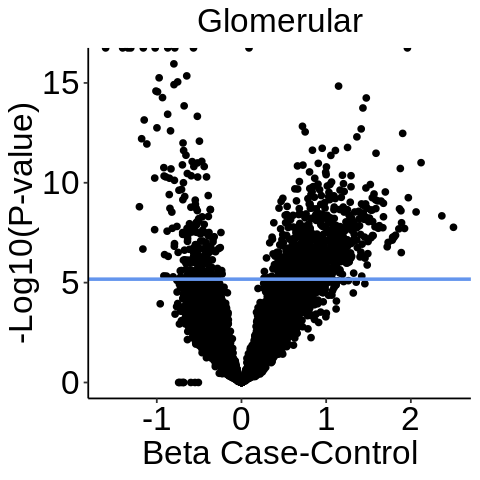

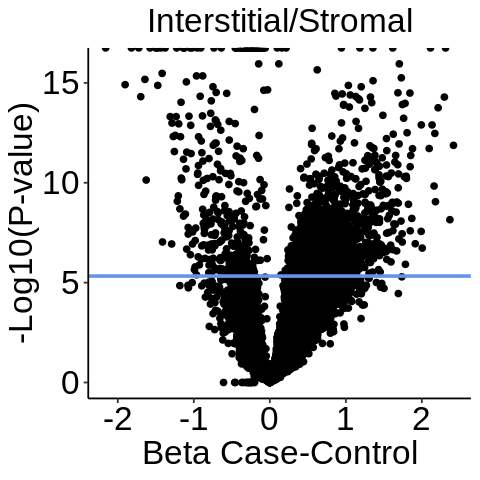

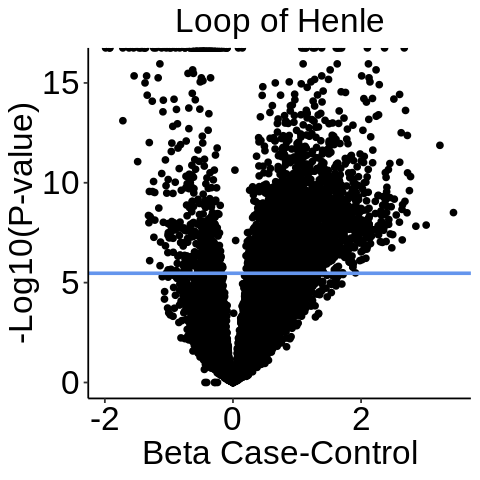

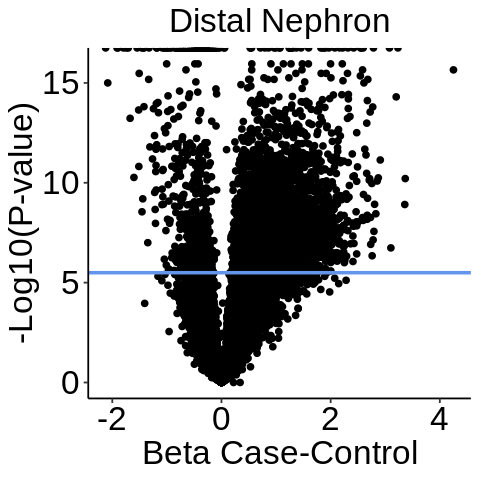

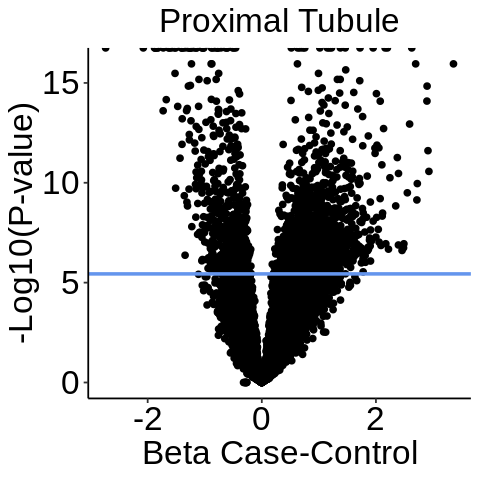

In [101]:
for (ctype in celltypes){
    res = res_list_isgavg[[ctype]]
        
    fig.size(4, 4)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'cornflowerblue', linewidth = 1)+
        labs(x = 'Beta Case-Control', y = '-Log10(P-value)', title = ctype)
    print(p)
}

In [102]:
for (ctype in celltypes){
    print(ctype)
    print('Enriched')
   print(res_list_isgavg[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('Depleted')
    print(res_list_isgavg[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('')

}

[1] "T/NK"
[1] "Enriched"
 [1] "ZFAND3"   "ANK3"     "DLEU2"    "SPIDR"    "FBXL17"   "PHACTR2" 
 [7] "RUNX1"    "JAZF1"    "PRKCA"    "NCALD"    "DPYD"     "NSMCE2"  
[13] "PPP1R16B" "UMAD1"    "VTI1A"    "KLF12"    "PTPRJ"    "TOX"     
[19] "ARHGAP15" "MAML2"    "TBC1D22A" "FAF1"     "STK39"    "SIPA1L1" 
[25] "LRBA"     "P2RY8"    "ATXN1"    "EIF4G3"   "STAG1"    "ST6GAL1" 
[31] "EXOC4"    "SFMBT2"   "RABGAP1L" "RNF38"    "PIK3CD"   "RASA3"   
[37] "SNX29"    "COG5"     "SIK3"     "CLASP1"   "ZBTB20"   "TNIK"    
[43] "ZEB1"     "CARD11"   "FNDC3B"   "RASSF3"   "SPPL3"    "SMAD3"   
[49] "STIM1"    "NCOA1"   
[1] "Depleted"
 [1] "CXCR4"      "SOCS1"      "TSC22D3"    "CCL4"       "TXNIP"     
 [6] "PRDM1"      "DDIT4"      "KLF9"       "CXCR6"      "CD69"      
[11] "NFKBIA"     "BTG1"       "IL7R"       "GPR171"     "ZFP36"     
[16] "IFNGR1"     "SRGN"       "GABPB1-IT1" "ZFP36L2"    "PIK3IP1"   
[21] "H1FX"       "DYNLT1"     "ISG20"      "IFI6"       "GPR65"     
[26] "UBC"    

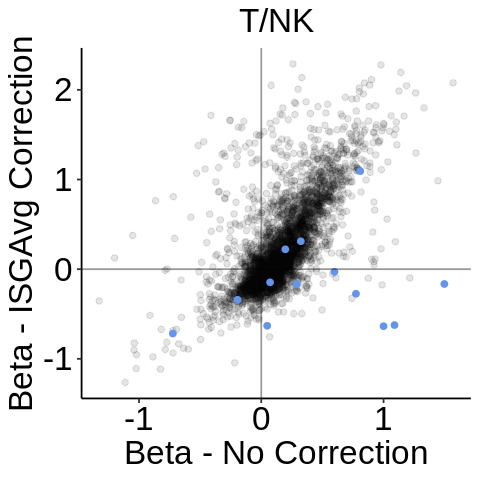

Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


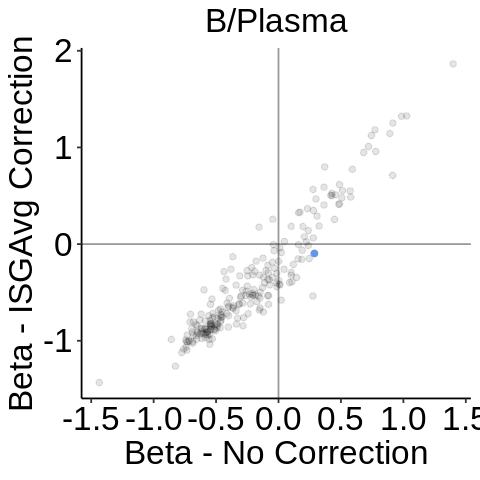

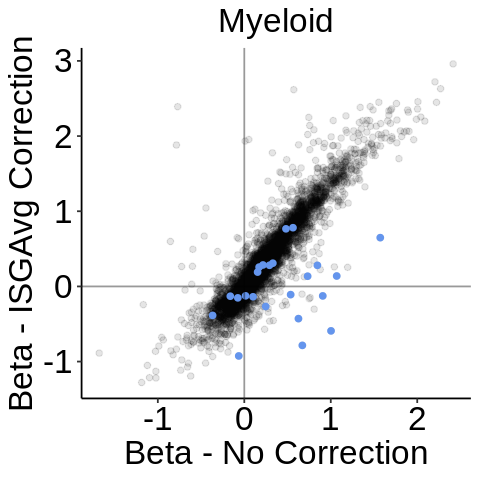

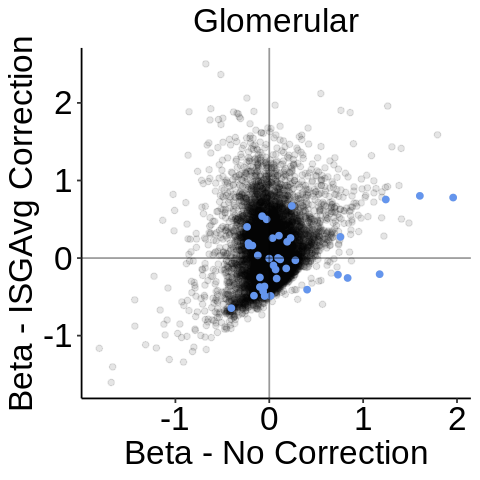

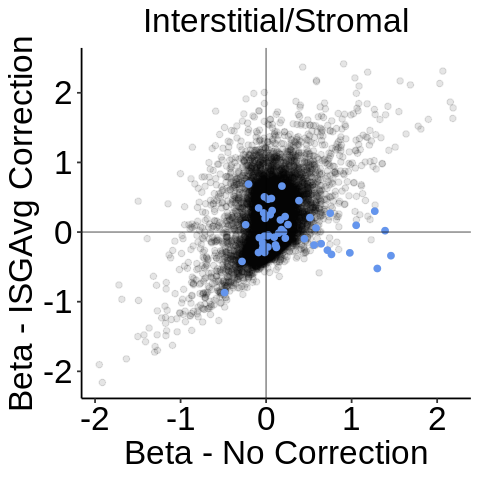

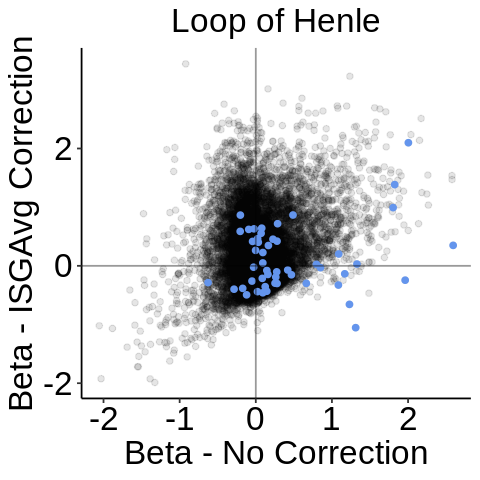

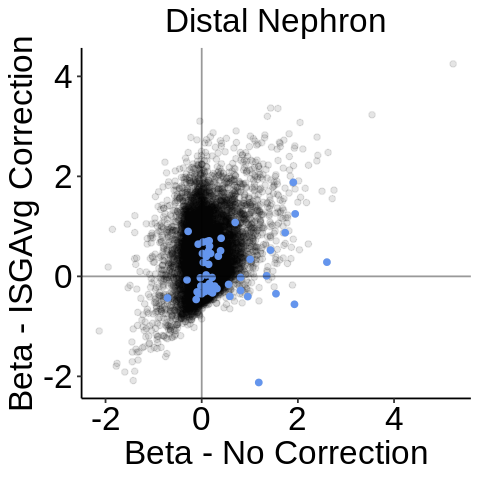

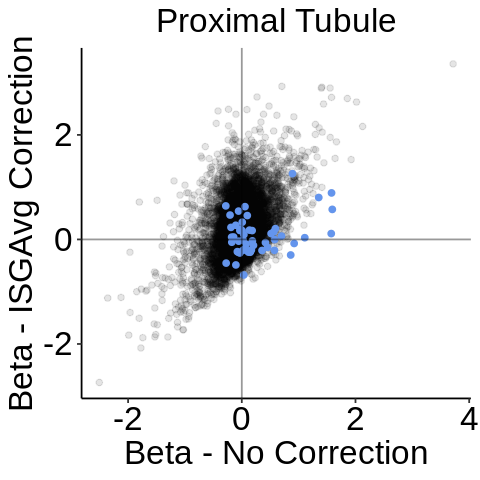

In [147]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isgavg[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISGAvg-Correction'
    res = rbind(res, res_isg)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = beta)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISGAvg-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISGAvg-Correction`), color = 'cornflowerblue',
               data = res %>% filter(gene %in% isg_genes_regex))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = 'Beta - No Correction', y = 'Beta - ISGAvg Correction')
    print(p)
    
}

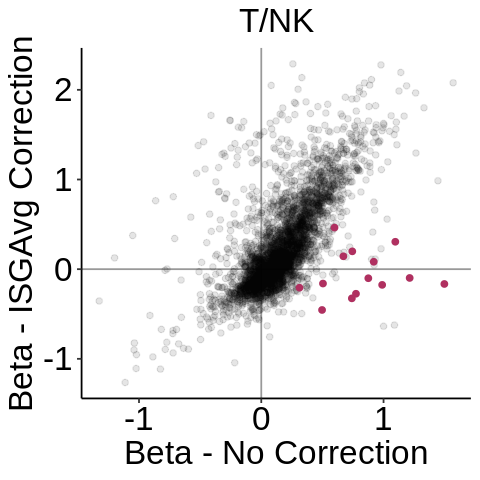

Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”


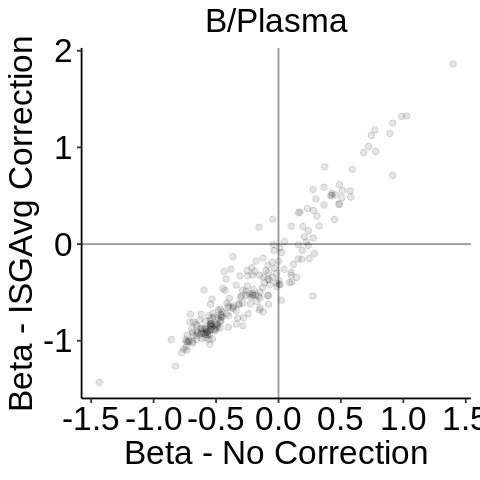

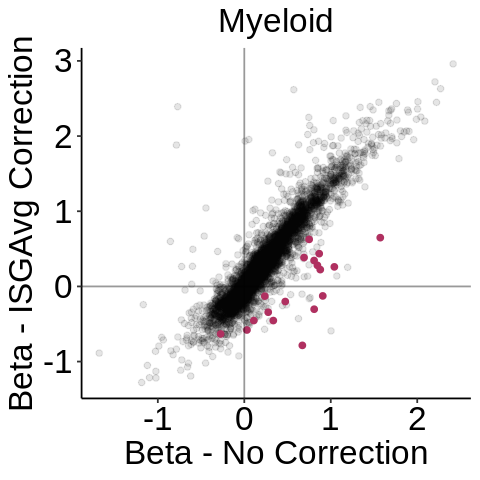

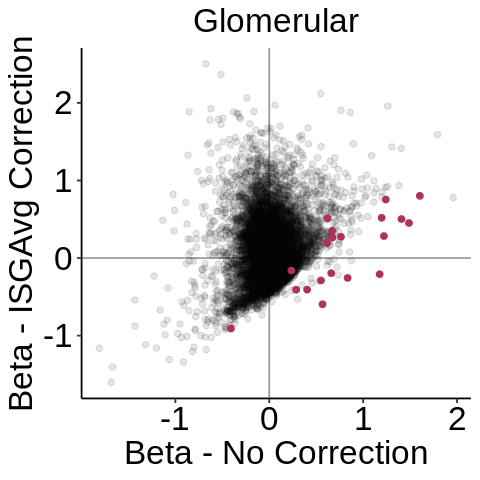

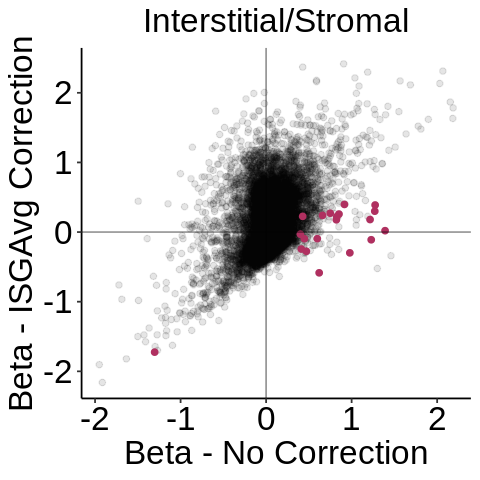

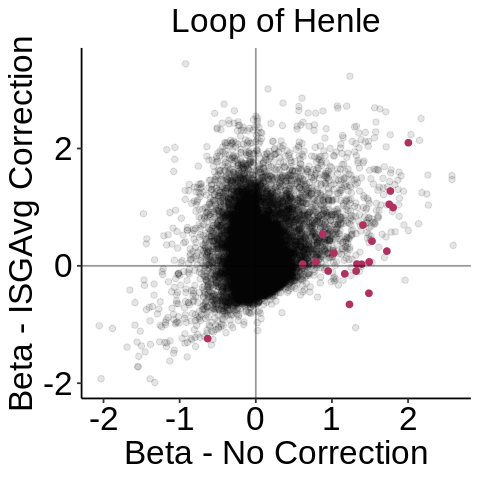

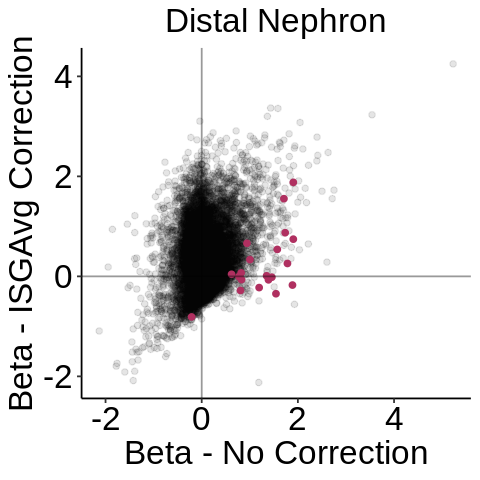

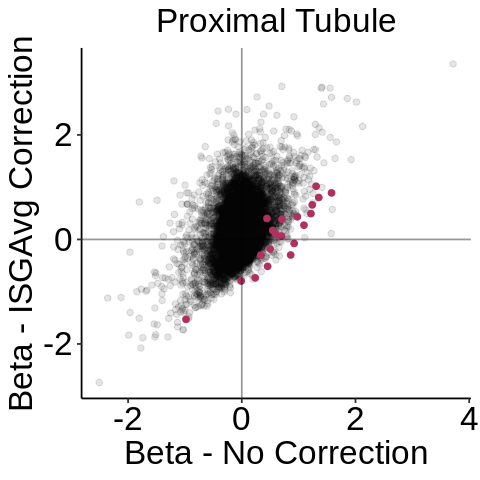

In [152]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isgavg[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISGAvg-Correction'
    res = rbind(res, res_isg)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = beta)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISGAvg-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISGAvg-Correction`), color = 'maroon',
               data = res %>% filter(gene %in% isg_genes))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = 'Beta - No Correction', y = 'Beta - ISGAvg Correction')
    print(p)
    
}

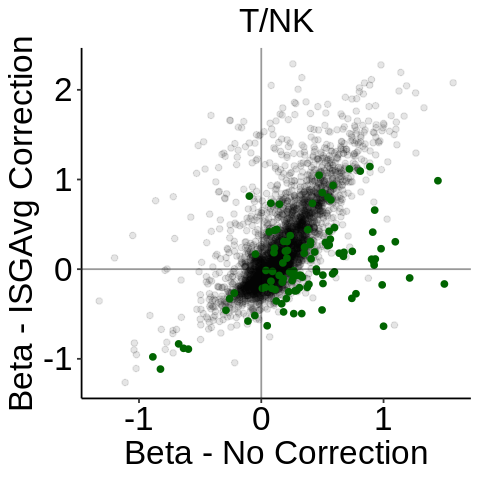

Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”


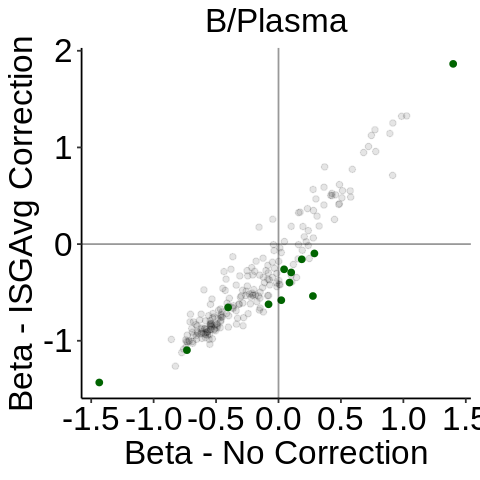

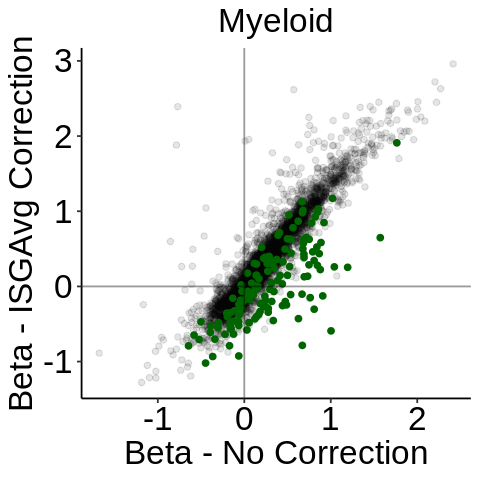

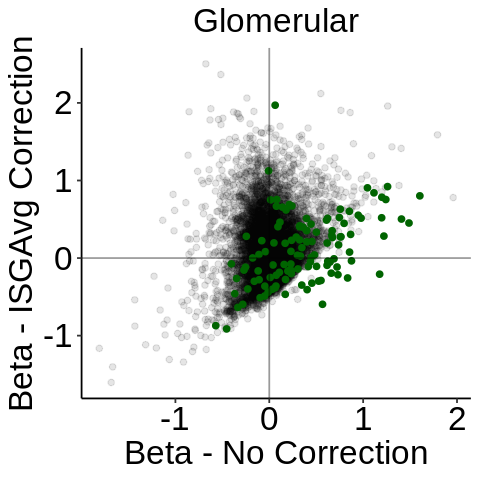

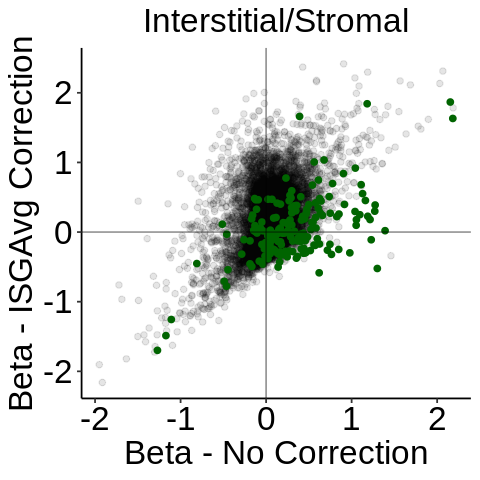

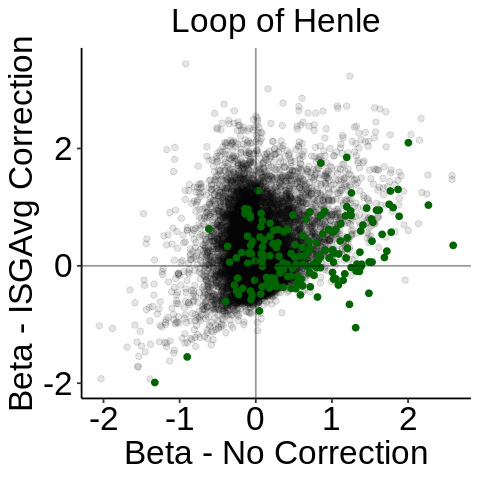

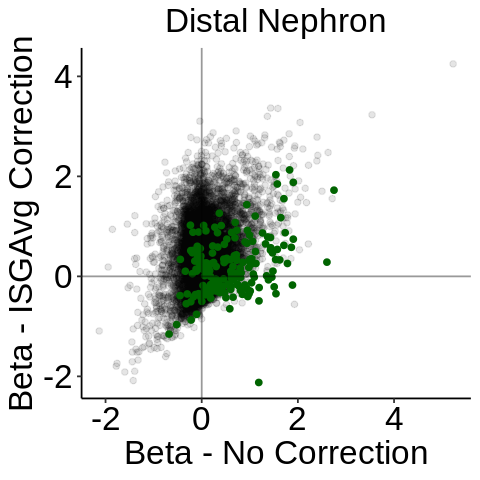

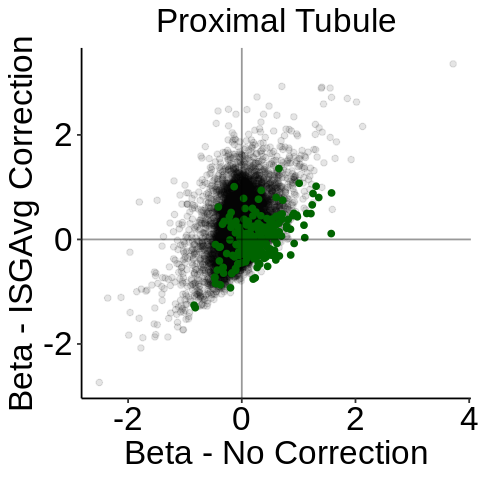

In [175]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isgavg[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISGAvg-Correction'
    res = rbind(res, res_isg)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = beta)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISGAvg-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISGAvg-Correction`), color = 'darkgreen',
               data = res %>% filter(gene %in% isg_genes_hall))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = 'Beta - No Correction', y = 'Beta - ISGAvg Correction')
    print(p)
    
}

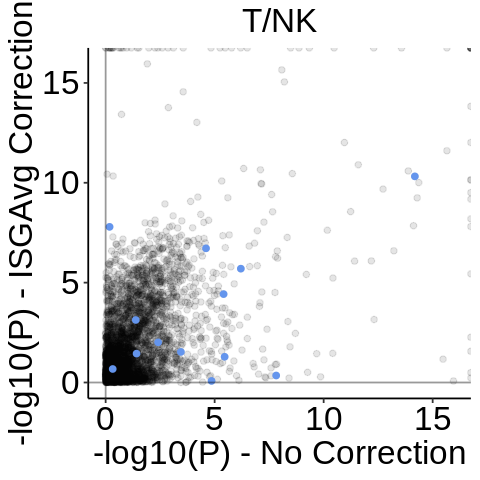

Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


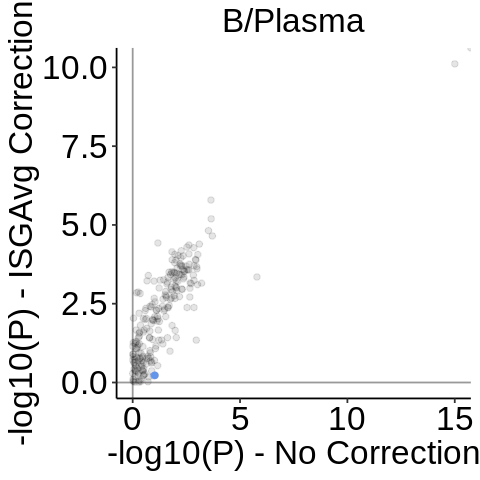

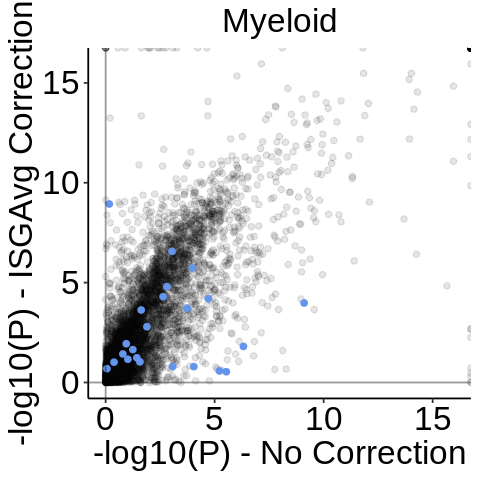

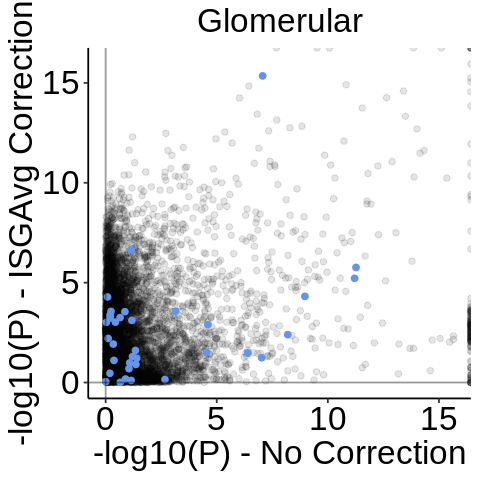

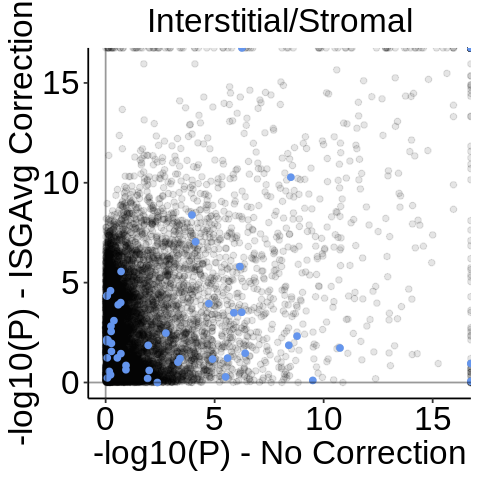

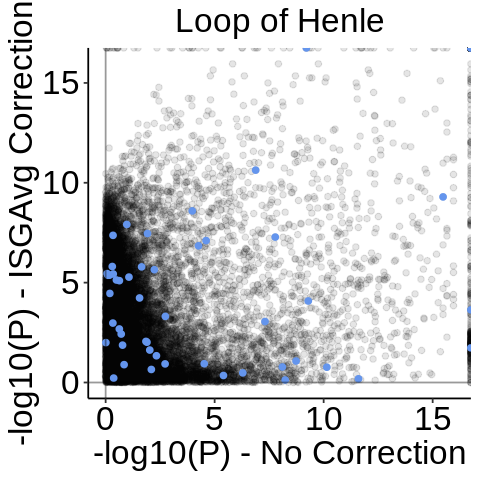

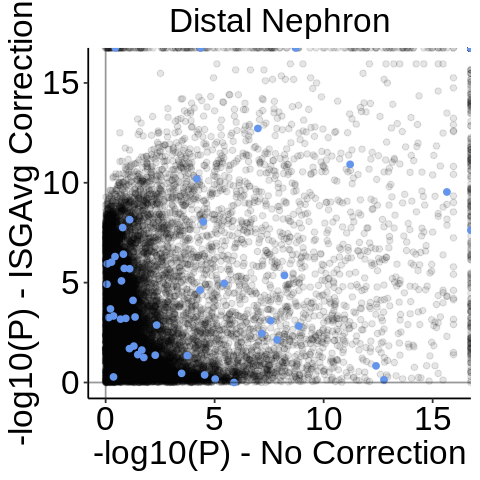

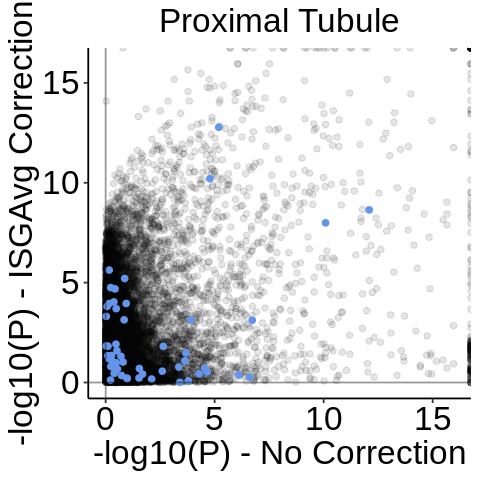

In [148]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isgavg[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISGAvg-Correction'
    res = rbind(res, res_isg)
    res$p = -log10(res$p)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = p)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISGAvg-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISGAvg-Correction`), color = 'cornflowerblue',
               data = res %>% filter(gene %in% isg_genes_regex))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = '-log10(P) - No Correction', y = '-log10(P) - ISGAvg Correction')
    print(p)
    
}

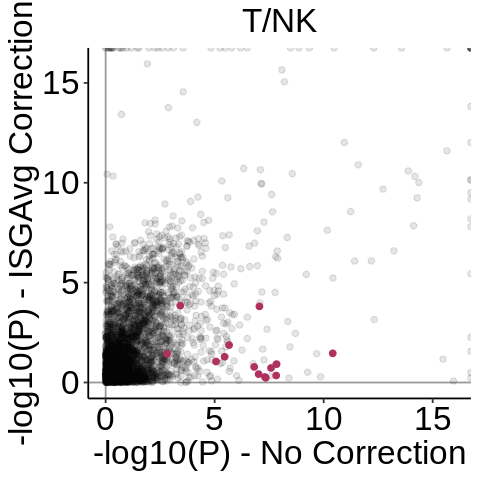

Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”


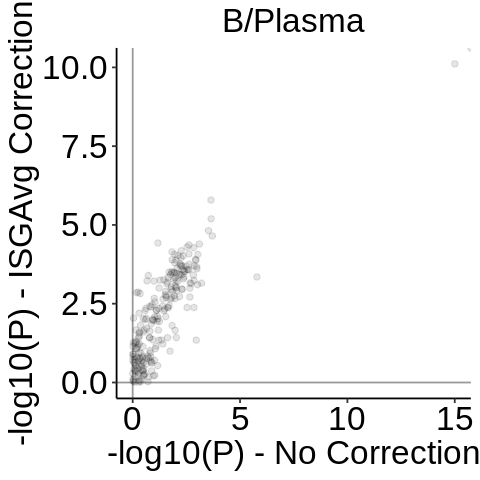

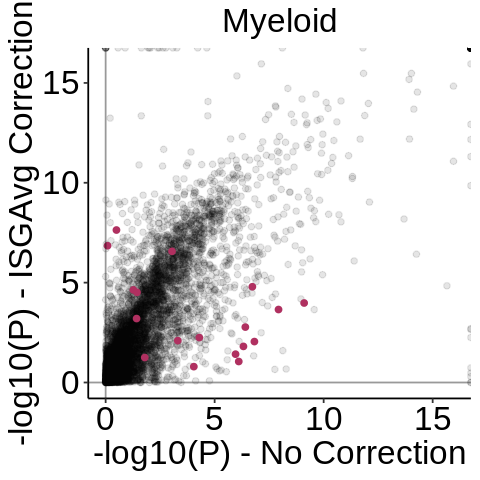

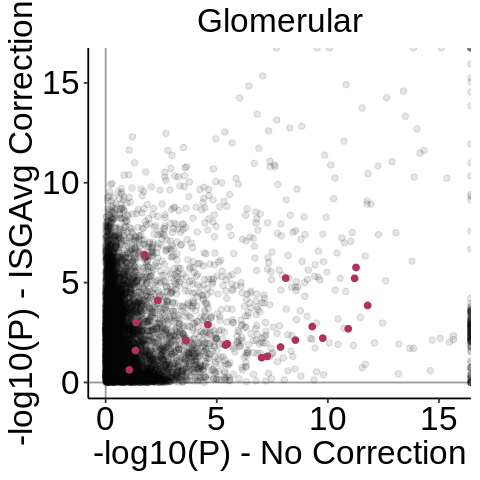

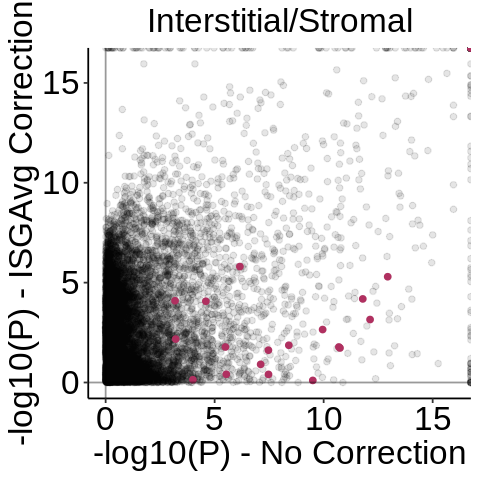

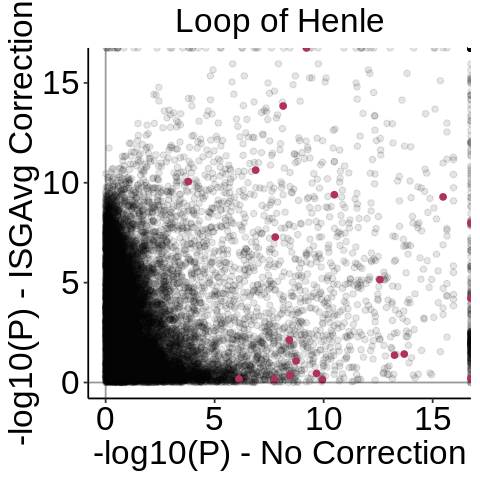

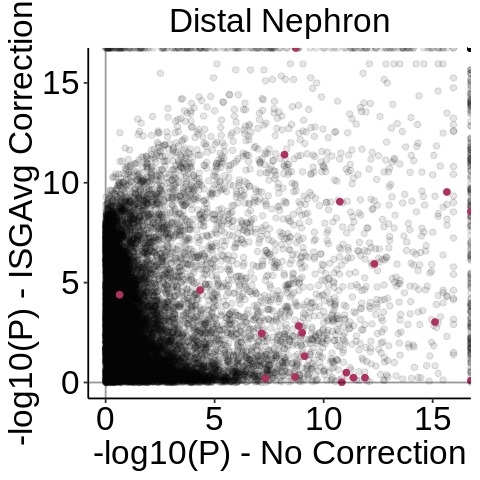

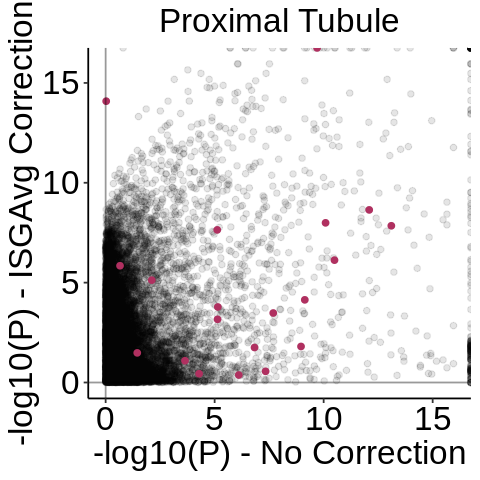

In [153]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isgavg[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISGAvg-Correction'
    res = rbind(res, res_isg)
    res$p = -log10(res$p)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = p)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISGAvg-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISGAvg-Correction`), color = 'maroon',
               data = res %>% filter(gene %in% isg_genes))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = '-log10(P) - No Correction', y = '-log10(P) - ISGAvg Correction')
    print(p)
    
}

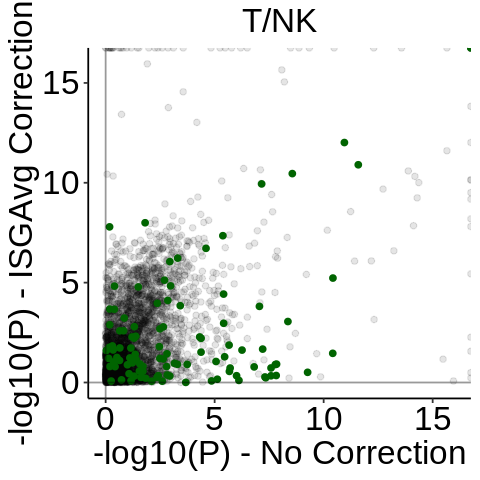

Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”


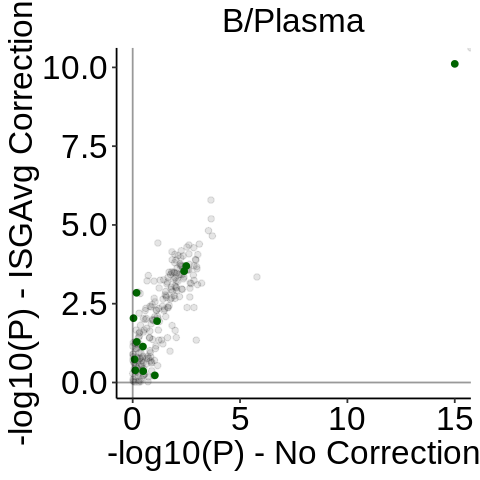

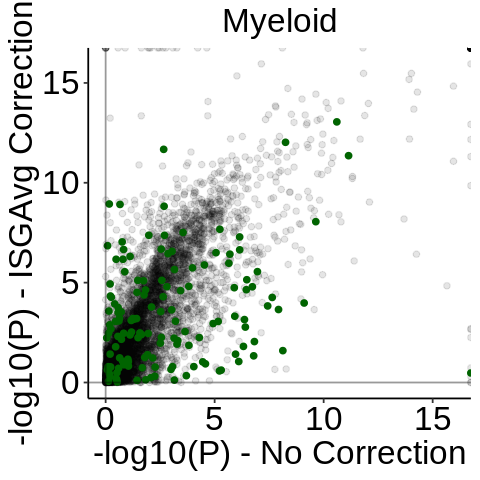

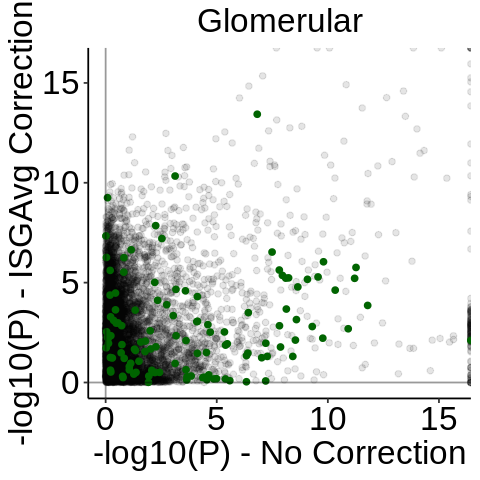

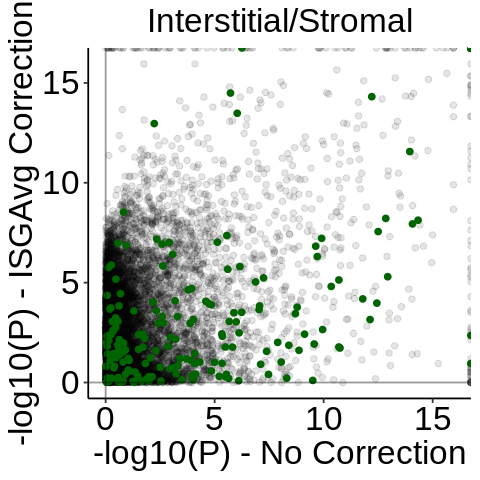

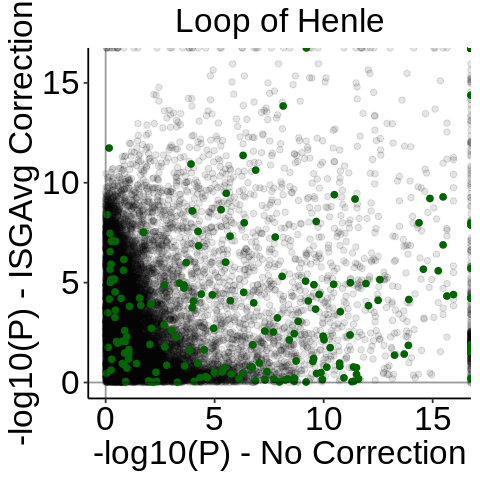

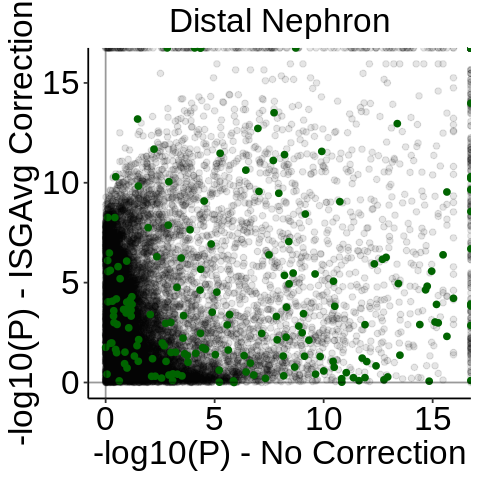

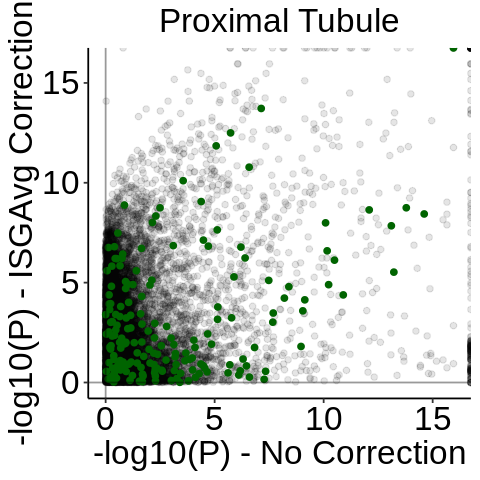

In [174]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isgavg[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISGAvg-Correction'
    res = rbind(res, res_isg)
    res$p = -log10(res$p)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = p)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISGAvg-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISGAvg-Correction`), color = 'darkgreen',
               data = res %>% filter(gene %in% isg_genes_hall))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = '-log10(P) - No Correction', y = '-log10(P) - ISGAvg Correction')
    print(p)
    
}

In [113]:
res

gene,None,ISGAvg-Correction
<chr>,<dbl>,<dbl>
AL627309.5,0.5558120,1.00651247
LINC01409,2.2099496,1.02648784
LINC01128,6.4720427,7.36931379
LINC00115,0.6772813,0.36846780
FAM41C,0.1251498,1.37811464
NOC2L,0.2350232,2.75915434
KLHL17,0.5588063,0.41074511
HES4,4.8414931,12.41853662
ISG15,3.7953969,0.08078264


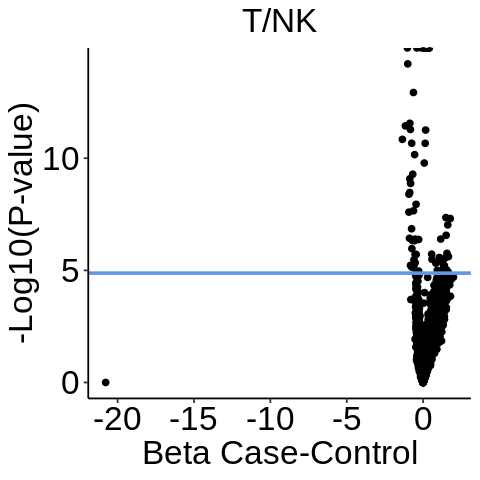

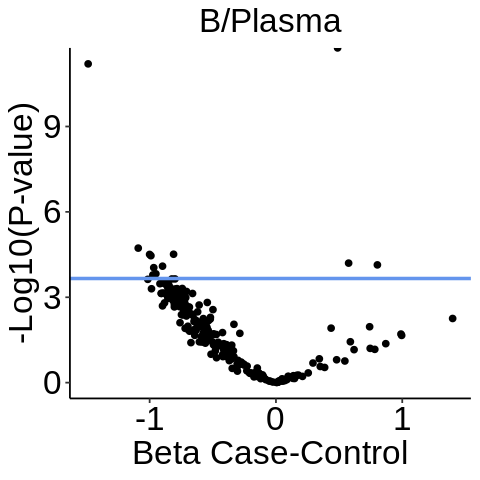

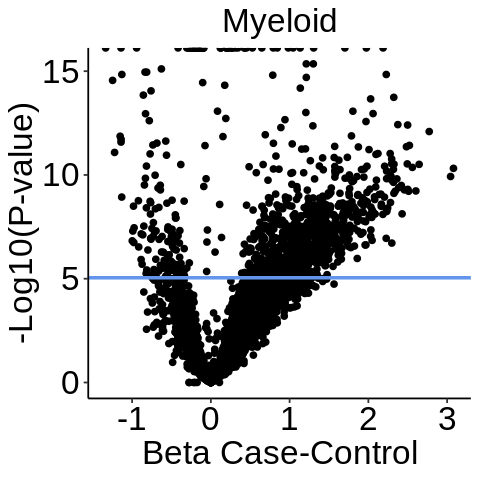

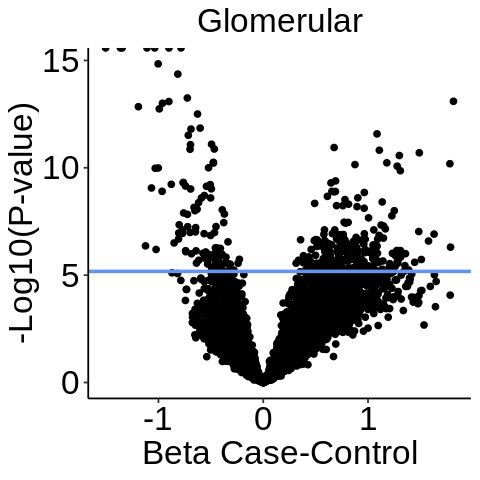

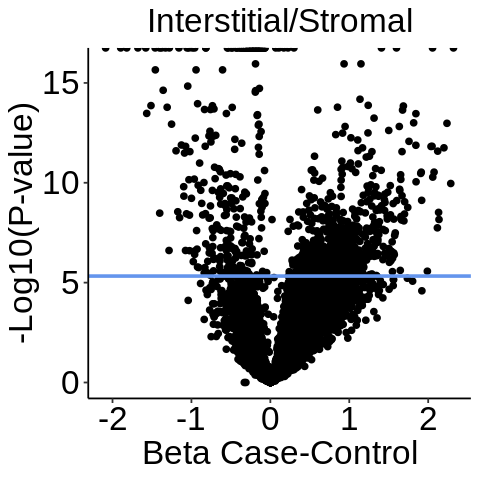

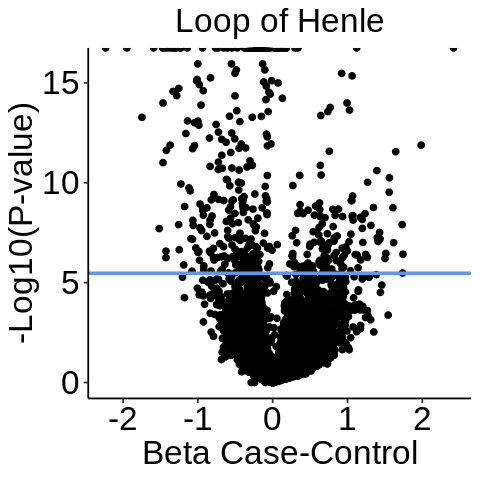

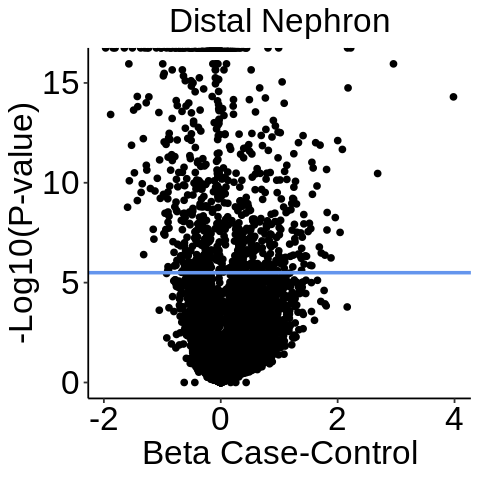

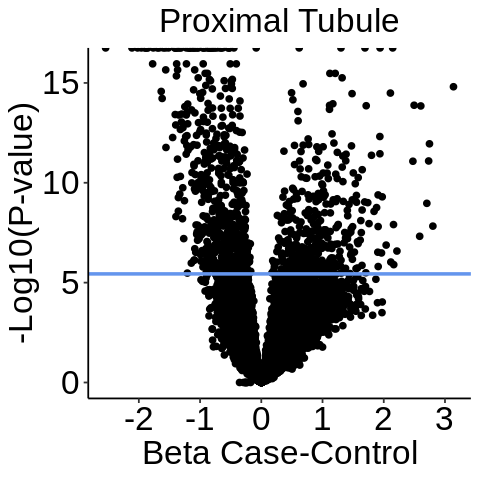

In [156]:
for (ctype in celltypes){
    res = res_list_isgavg_hall[[ctype]]
        
    fig.size(4, 4)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'cornflowerblue', linewidth = 1)+
        labs(x = 'Beta Case-Control', y = '-Log10(P-value)', title = ctype)
    print(p)
}

In [157]:
for (ctype in celltypes){
    print(ctype)
    print('Enriched')
   print(res_list_isgavg_hall[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('Depleted')
    print(res_list_isgavg_hall[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('')

}

[1] "T/NK"
[1] "Enriched"
 [1] "PHACTR2" "PRKCA"   "NSMCE2"  "P2RY8"   "EIF4G3"  "STK39"   "ST6GAL1"
 [8] "PIK3CD"  "RASA3"   "TGFBR3"  "NCOA1"   "SLCO3A1" "RASSF3"  "DENND1B"
[15] "RIPOR2"  "SH2D3C"  "EPSTI1"  "IGF2R"   "SAMD3"   "FLT3LG"  "IL27RA" 
[22] "RPS8"    "RPS10"   "MT-CO1"  "EEF1B2"  "MT-ND4"  "RPS16"   "RPS6"   
[29] "TPT1"    "RPS13"   "RPL22"   "RPS9"    "MT-CYB"  "RPL8"    "RPL37"  
[36] "RPL3"    "RPL13"   "EEF1A1"  "RPS23"   "RPL5"    "RPL34"   "RPS3A"  
[43] "RPL21"   "RPS18"   "RPL18A"  "RPL29"   "RPL32"   "RPS4X"   "RPL18"  
[50] "RPS2"   
[1] "Depleted"
 [1] "CXCR4"      "TSC22D3"    "TXNIP"      "PRDM1"      "KLF9"      
 [6] "SOCS1"      "DDIT4"      "IL7R"       "CD69"       "BTG1"      
[11] "GPR171"     "CXCR6"      "NFKBIA"     "PIK3IP1"    "ZFP36L2"   
[16] "CRYBG1"     "ZFP36"      "ZBP1"       "GABPB1-IT1" "DYNLT1"    
[21] "IFNGR1"     "SRGN"       "H1FX"       "SYAP1"      "CYTIP"     
[26] "GPR65"      "TRIM22"     "SH2D2A"     "HNRNPL"     "SAT1"      

Warning message:
“Removed 16 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


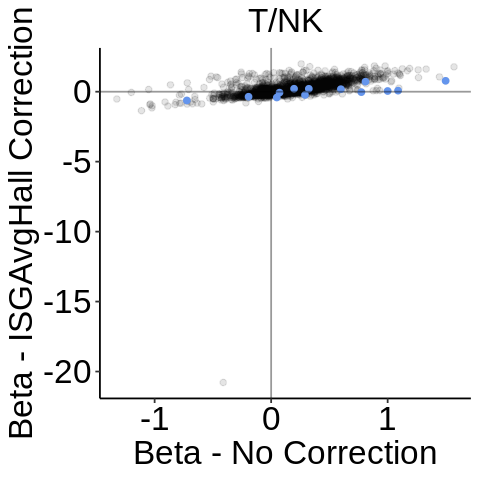

Warning message:
“Removed 14 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”


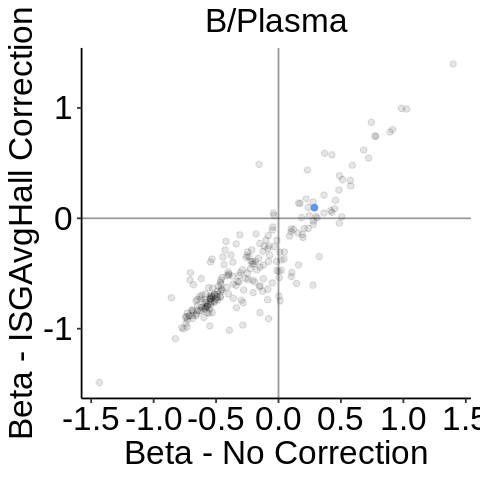

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


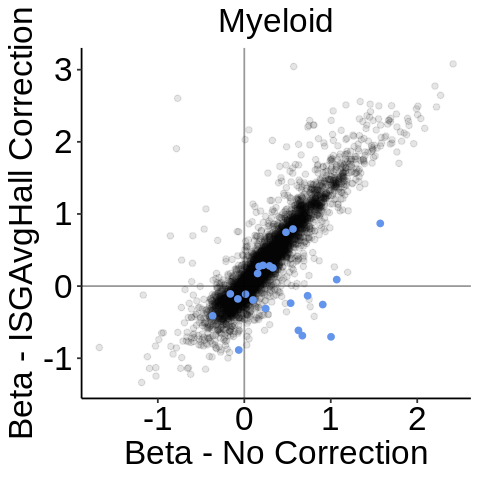

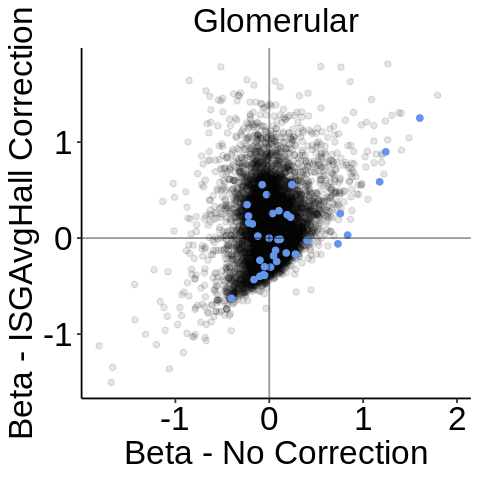

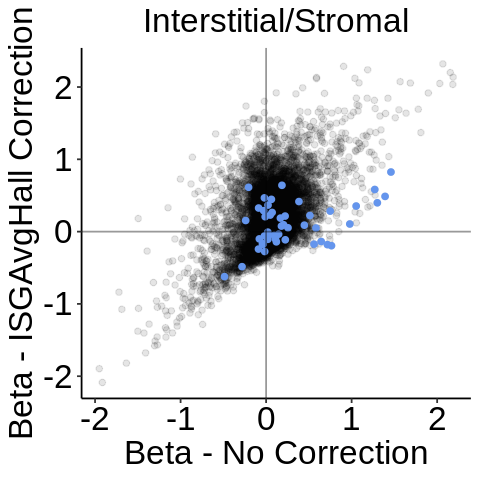

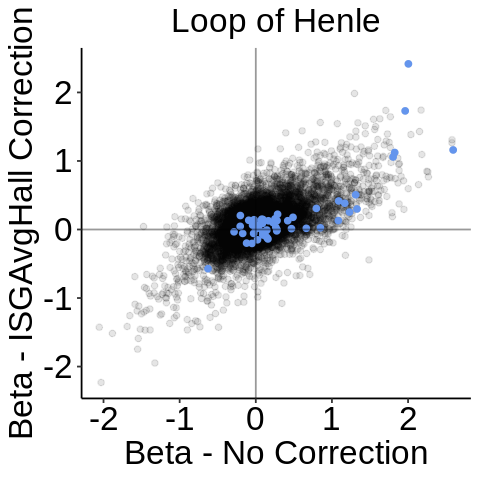

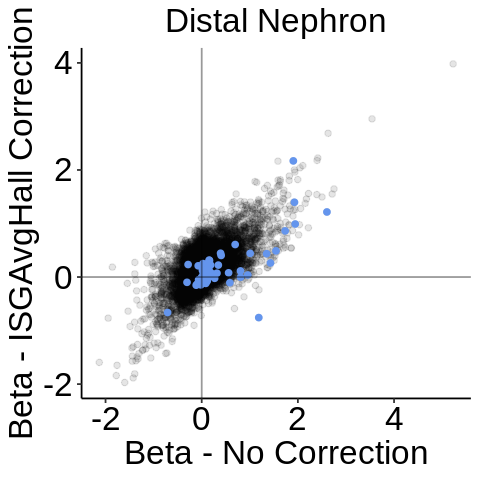

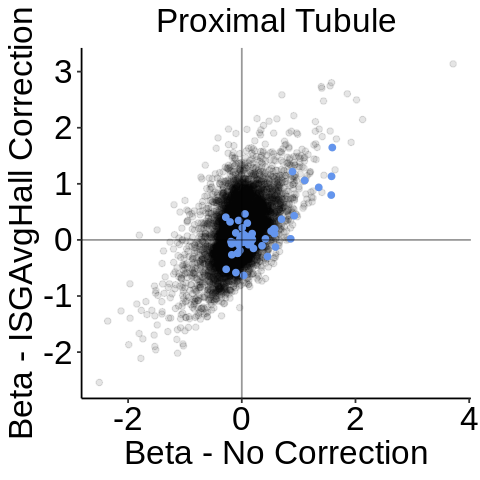

In [164]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isgavg_hall[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISGAvgHall-Correction'
    res = rbind(res, res_isg)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = beta)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISGAvgHall-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISGAvgHall-Correction`), color = 'cornflowerblue',
               data = res %>% filter(gene %in% isg_genes_regex))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = 'Beta - No Correction', y = 'Beta - ISGAvgHall Correction')
    print(p)
    
}

Warning message:
“Removed 16 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 3 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


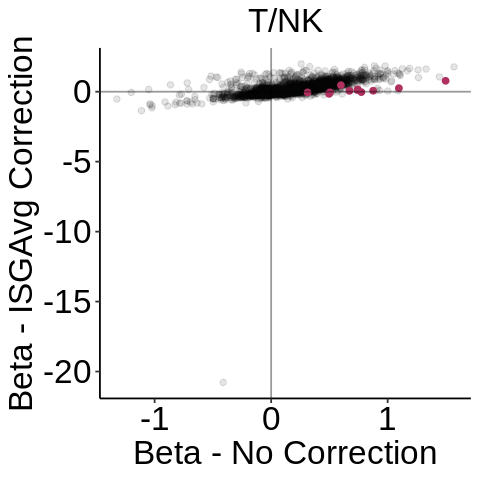

Warning message:
“Removed 14 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 3 rows containing missing values or values outside the scale range
(`geom_point()`).”


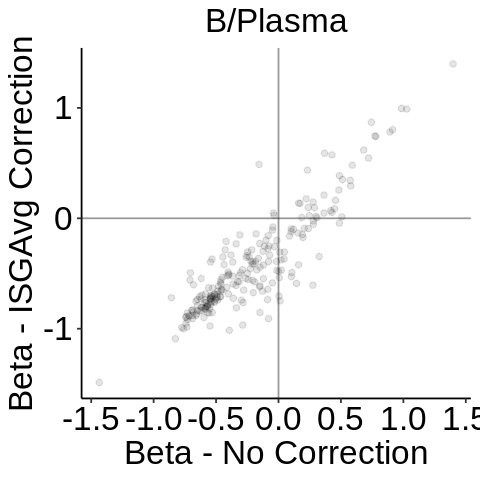

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


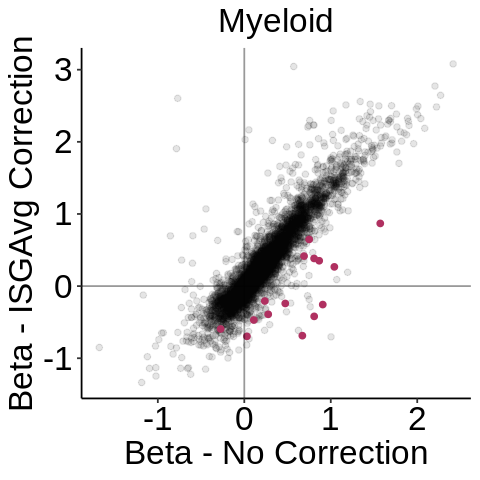

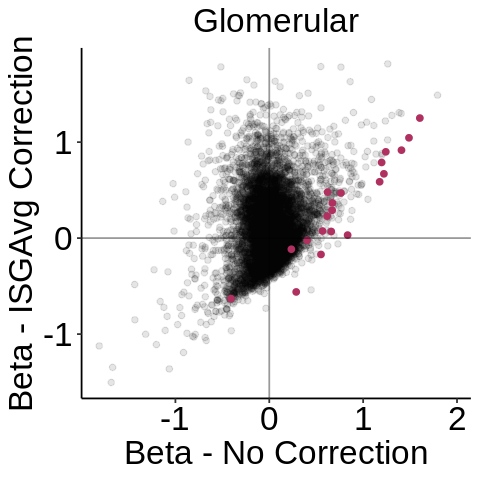

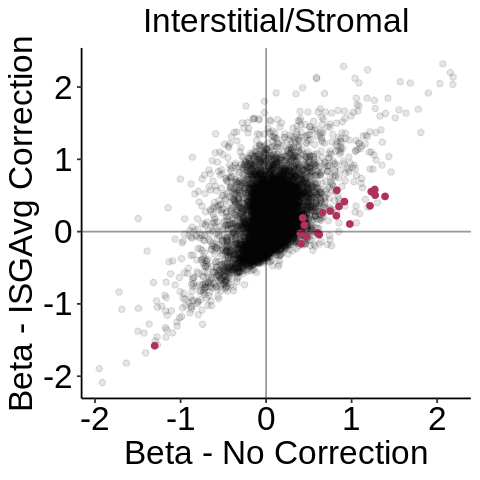

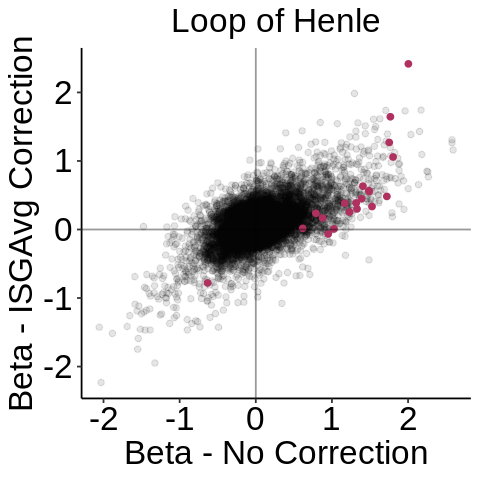

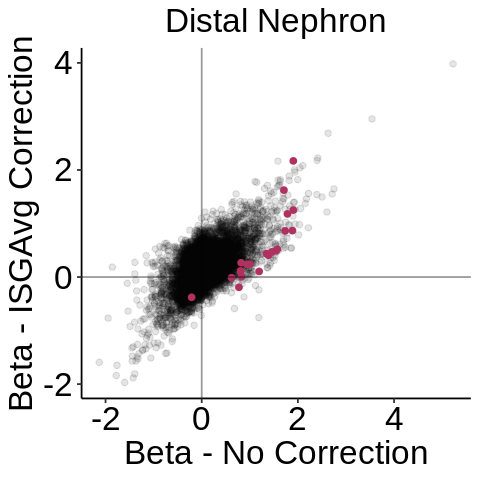

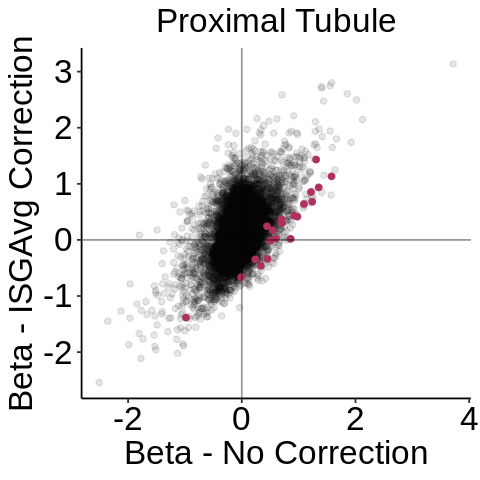

In [165]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isgavg_hall[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISGAvgHall-Correction'
    res = rbind(res, res_isg)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = beta)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISGAvgHall-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISGAvgHall-Correction`), color = 'maroon',
               data = res %>% filter(gene %in% isg_genes))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = 'Beta - No Correction', y = 'Beta - ISGAvg Correction')
    print(p)
    
}

In [166]:
library(msigdbr)
library(fgsea)

In [167]:
category = 'H'
hsig_df = msigdbr(species = "human", category = category)

In [168]:
pathways = split(x = hsig_df$gene_symbol, f = hsig_df$gs_name)

In [169]:
isg_genes_hall = c(pathways[['HALLMARK_INTERFERON_GAMMA_RESPONSE']],
             pathways[['HALLMARK_INTERFERON_ALPHA_RESPONSE']]) %>% unique %>% sort

Warning message:
“Removed 16 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 6 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


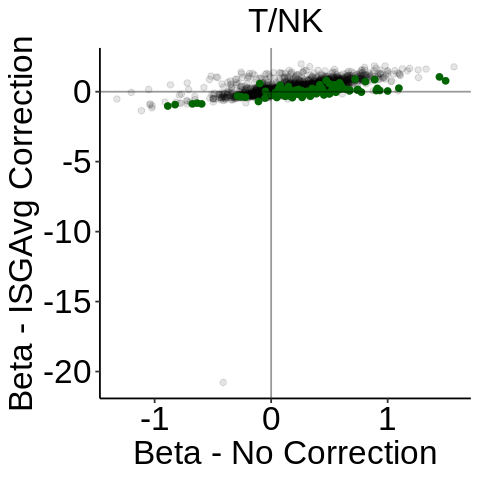

Warning message:
“Removed 14 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 11 rows containing missing values or values outside the scale range
(`geom_point()`).”


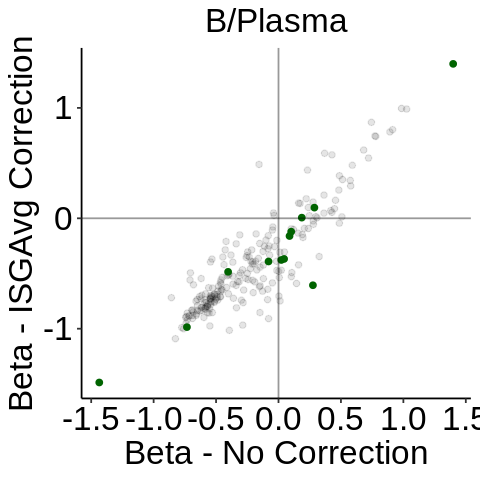

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


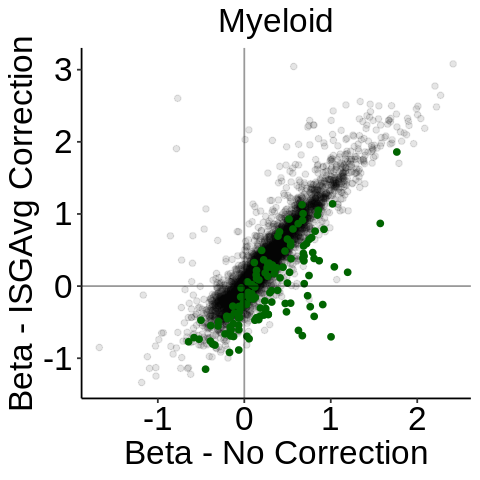

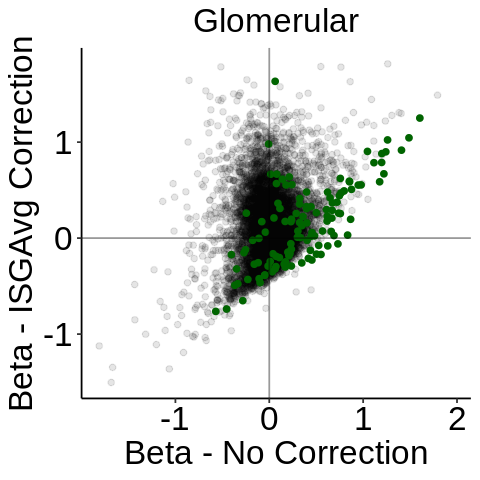

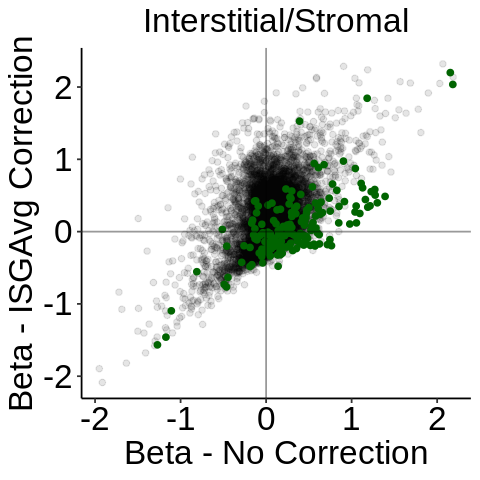

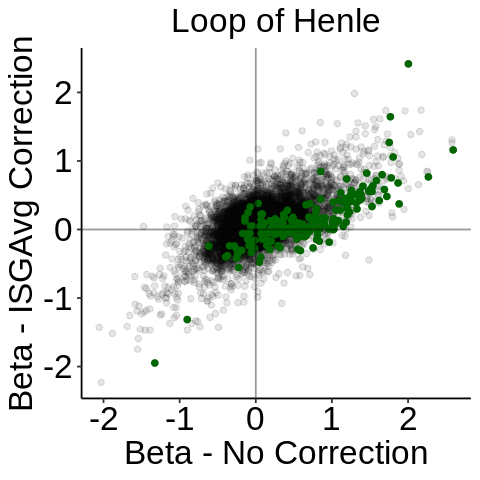

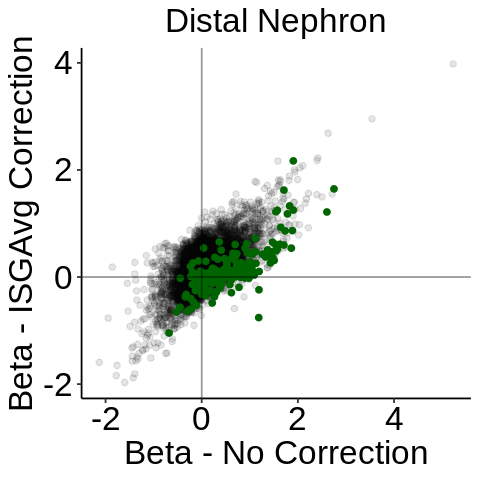

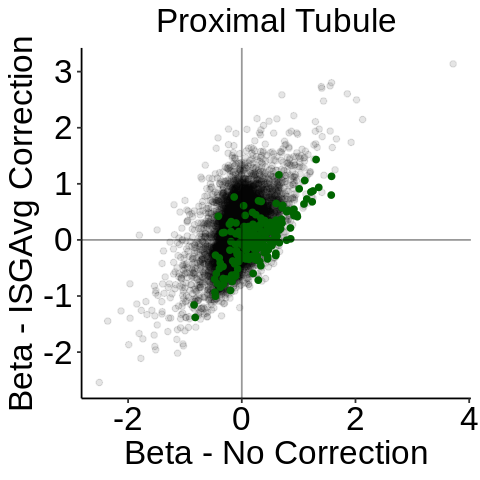

In [170]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isgavg_hall[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISGAvgHall-Correction'
    res = rbind(res, res_isg)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = beta)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISGAvgHall-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISGAvgHall-Correction`), color = 'darkgreen',
               data = res %>% filter(gene %in% isg_genes_hall))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = 'Beta - No Correction', y = 'Beta - ISGAvg Correction')
    print(p)
    
}

Warning message:
“Removed 16 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


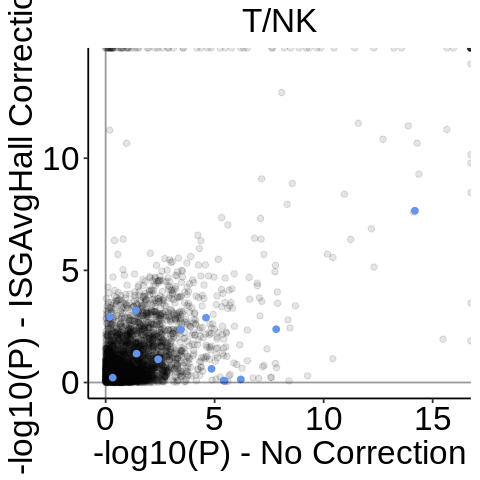

Warning message:
“Removed 14 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 2 rows containing missing values or values outside the scale range
(`geom_point()`).”


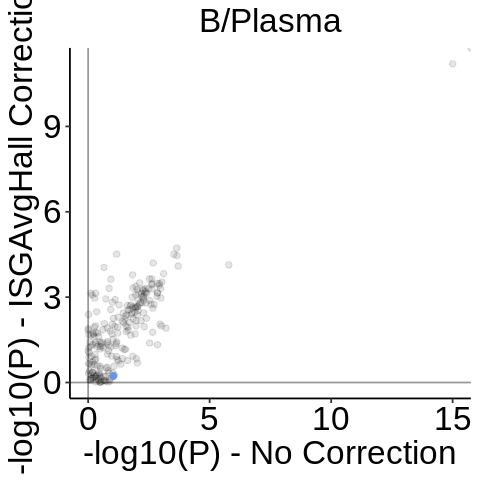

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


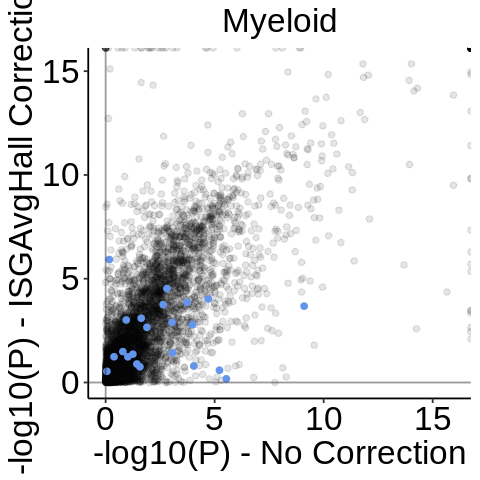

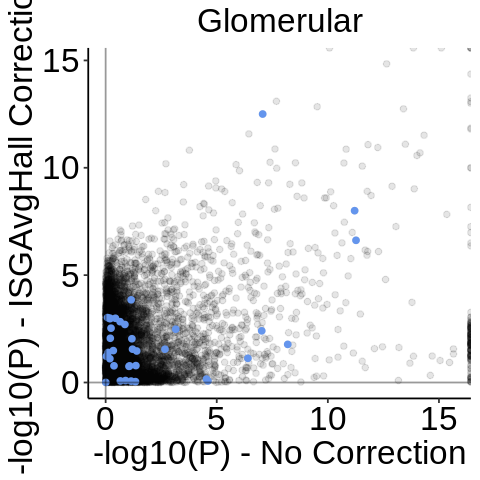

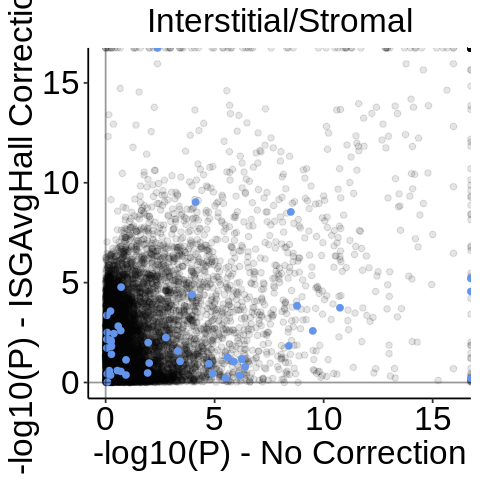

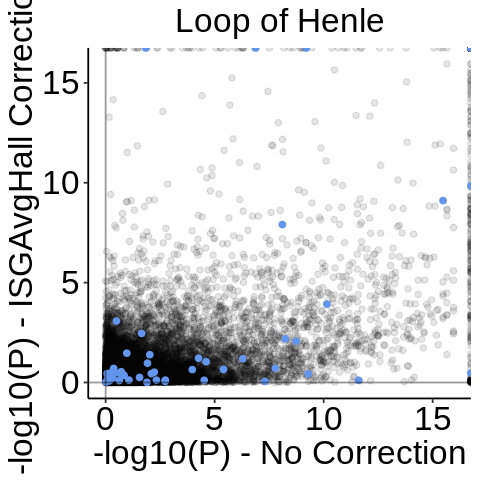

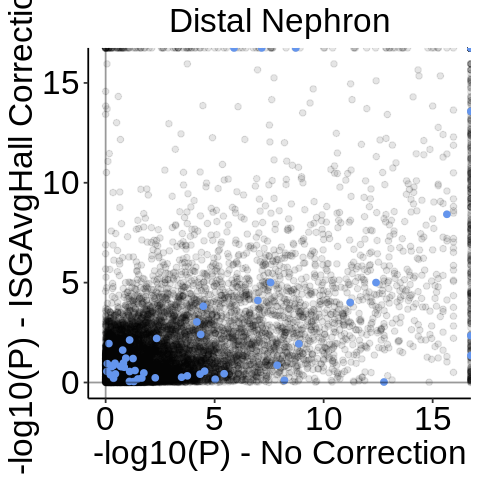

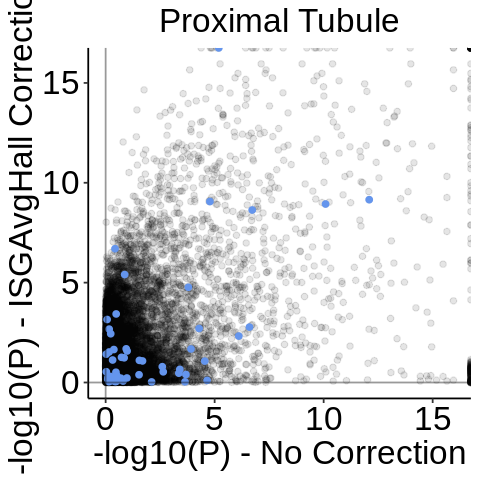

In [171]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isgavg_hall[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISGAvgHall-Correction'
    res = rbind(res, res_isg)
    res$p = -log10(res$p)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = p)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISGAvgHall-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISGAvgHall-Correction`), color = 'cornflowerblue',
               data = res %>% filter(gene %in% isg_genes_regex))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = '-log10(P) - No Correction', y = '-log10(P) - ISGAvgHall Correction')
    print(p)
    
}

Warning message:
“Removed 16 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 3 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


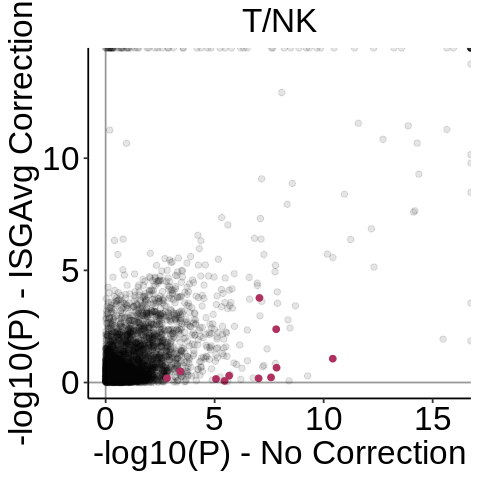

Warning message:
“Removed 14 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 3 rows containing missing values or values outside the scale range
(`geom_point()`).”


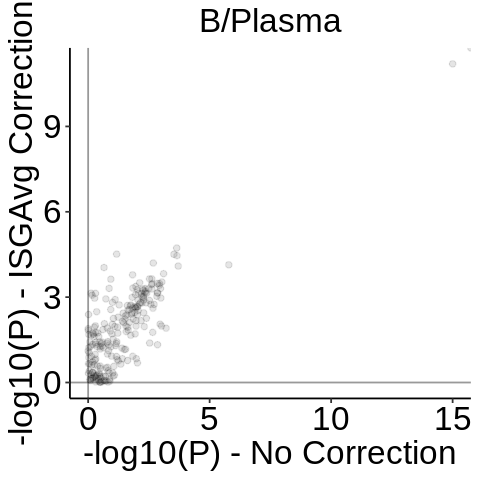

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


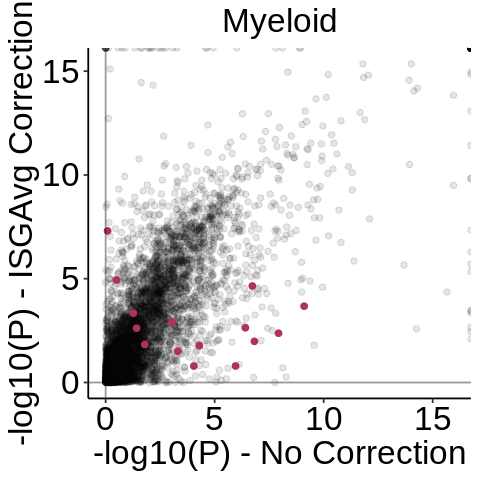

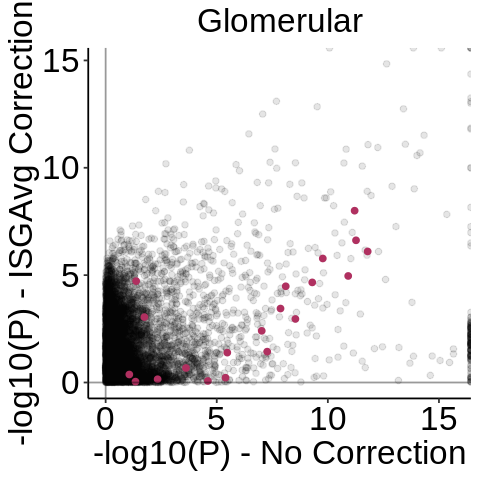

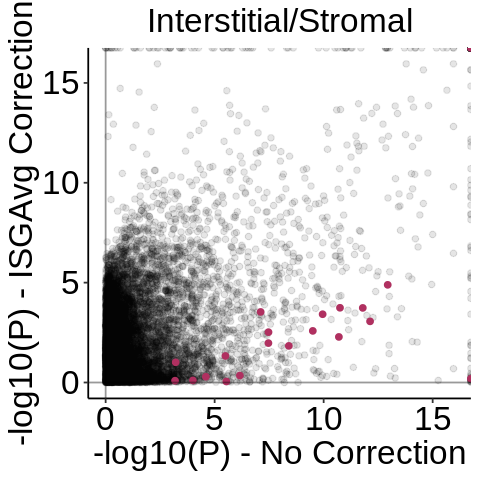

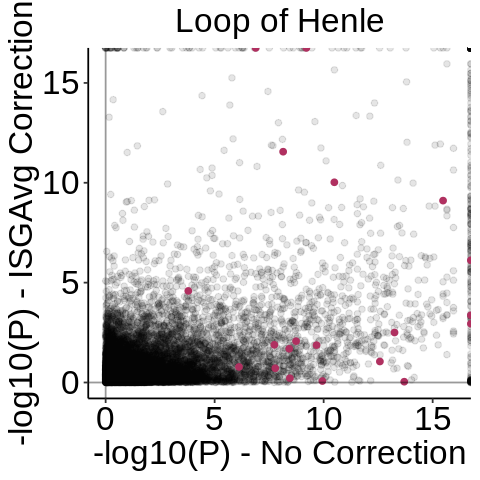

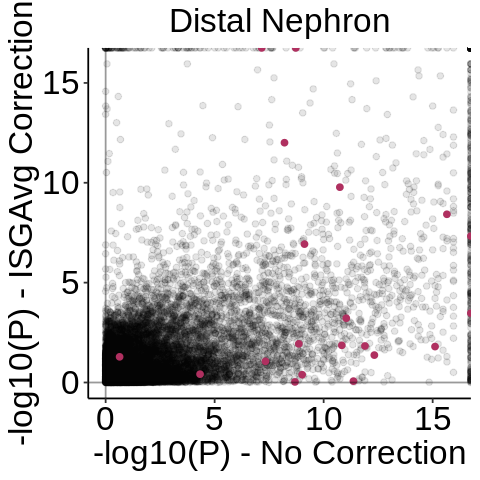

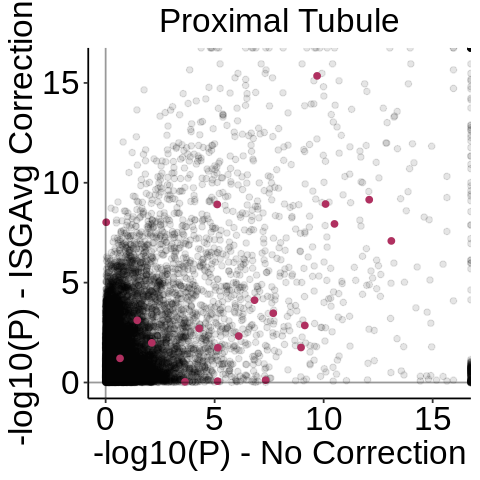

In [172]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isgavg_hall[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISGAvgHall-Correction'
    res = rbind(res, res_isg)
    res$p = -log10(res$p)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = p)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISGAvgHall-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISGAvgHall-Correction`), color = 'maroon',
               data = res %>% filter(gene %in% isg_genes))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = '-log10(P) - No Correction', y = '-log10(P) - ISGAvg Correction')
    print(p)
    
}

Warning message:
“Removed 16 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 6 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


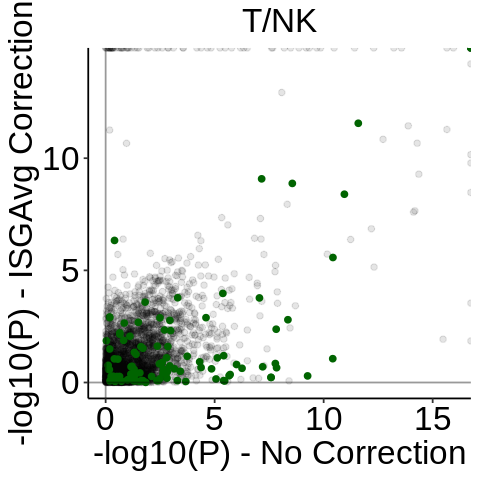

Warning message:
“Removed 14 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 11 rows containing missing values or values outside the scale range
(`geom_point()`).”


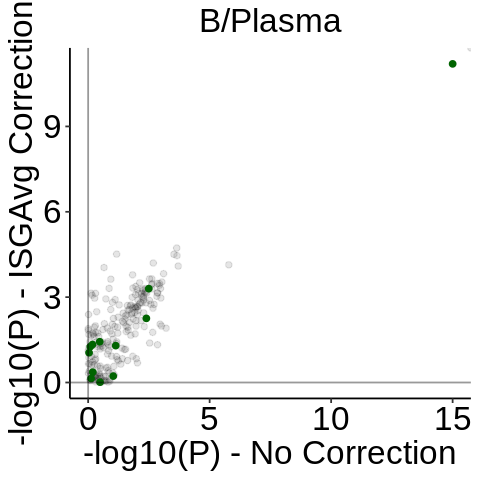

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


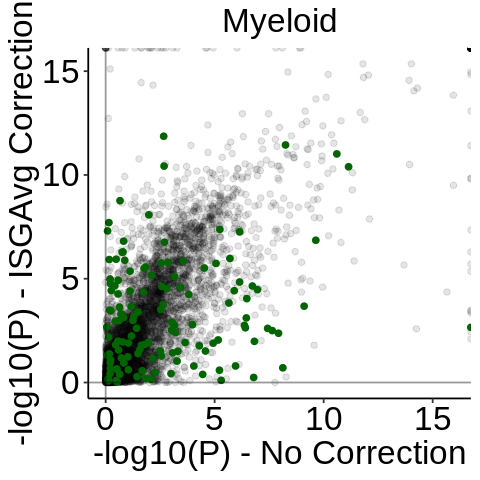

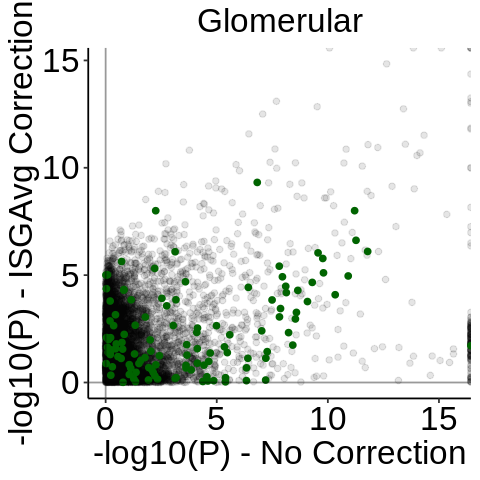

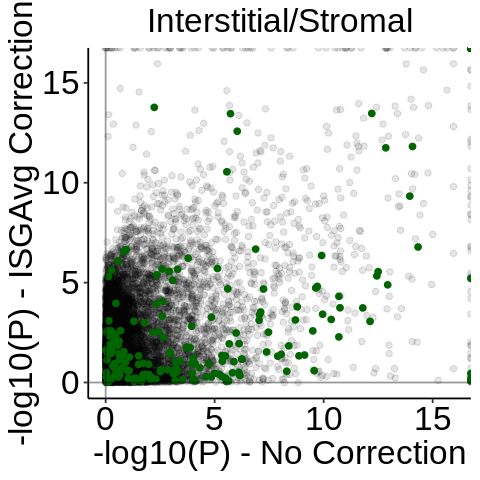

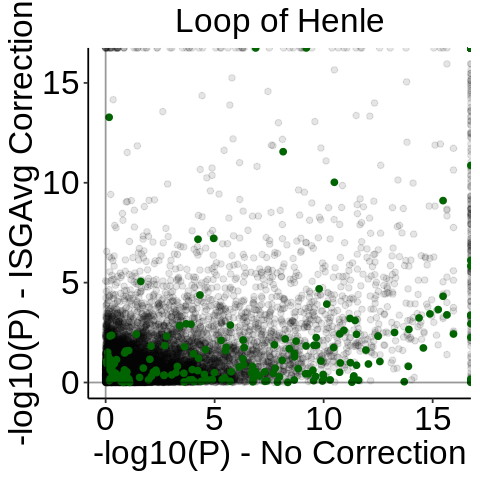

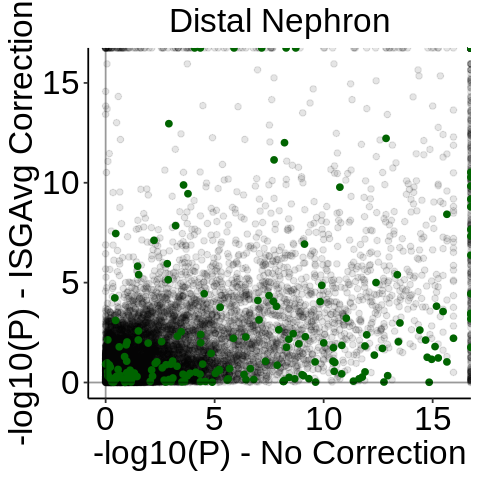

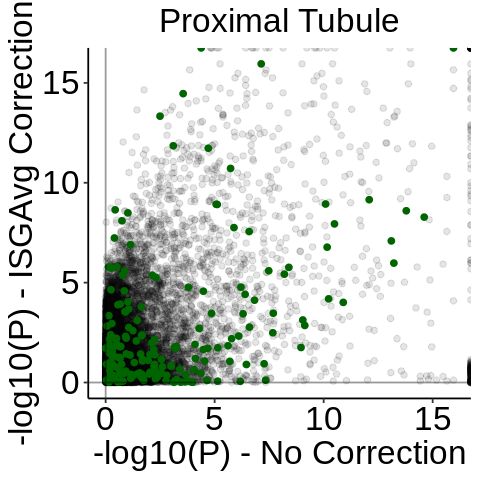

In [173]:
for (ctype in celltypes){

    res = res_list[[ctype]]
    res_isg = res_list_isgavg_hall[[ctype]]

    res['type'] = 'None'
    res_isg['type'] = 'ISGAvgHall-Correction'
    res = rbind(res, res_isg)
    res$p = -log10(res$p)
    res = res %>% pivot_wider(names_from = type, id_cols = gene, values_from = p)
    
    p = ggplot(res)+
    geom_point(aes(x = None, y = `ISGAvgHall-Correction`), alpha = 0.1)+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
    geom_point(aes(x = None, y = `ISGAvgHall-Correction`), color = 'darkgreen',
               data = res %>% filter(gene %in% isg_genes_hall))+
    geom_hline(yintercept = 0, alpha = 0.4)+
    geom_vline(xintercept = 0, alpha = 0.4)+
    ggtitle(ctype)+
    labs(x = '-log10(P) - No Correction', y = '-log10(P) - ISGAvg Correction')
    print(p)
    
}

In [113]:
res

gene,None,ISGAvg-Correction
<chr>,<dbl>,<dbl>
AL627309.5,0.5558120,1.00651247
LINC01409,2.2099496,1.02648784
LINC01128,6.4720427,7.36931379
LINC00115,0.6772813,0.36846780
FAM41C,0.1251498,1.37811464
NOC2L,0.2350232,2.75915434
KLHL17,0.5588063,0.41074511
HES4,4.8414931,12.41853662
ISG15,3.7953969,0.08078264


# Chronicity, by cell type

## Run differential expression

In [13]:
qcd_meta['Final_Site'] %>% table

Final_Site
Cincinnati   Einstein        JHU   Michigan       MUSC  Northwell        NYU 
       776        746      10030         12       3176         24      14178 
 Rochester Texas Tech       UCLA       UCSD       UCSF 
      1738        115         91         69        606 

In [15]:
qcd_meta['Responder_Status'] %>% table

Responder_Status
    0     1     2 
15696  4743  4658 

In [16]:
qcd_meta['Responder.Status'] %>% table

Responder.Status
   CR  LTFU    MD    ND    NR    NS    PR 
 4658  1295   102   569 15696  4498  4743 

In [17]:
qcd_meta['First_biop'] %>% table

First_biop
    0     1 
25983  5578 

In [26]:
celltypes[2:length(celltypes)]

[1] "B/Plasma"             "Myeloid"              "Glomerular"          
[4] "Interstitial/Stromal" "Loop of Henle"        "Distal Nephron"      
[7] "Proximal Tubule"

In [14]:
parallel::detectCores()
plan(multisession, workers = 20)

[1] 80

Warning message in checkNumberOfLocalWorkers(workers):
“Careful, you are setting up 20 localhost parallel workers with only 8 CPU cores available for this R process (per ‘cgroups.cpuset’), which could result in a 250% load. The soft limit is set to 100%. Overusing the CPUs has negative impact on the current R process, but also on all other processes of yours and others running on the same machine. See help("parallelly.options", package = "parallelly") for how to override the soft and hard limits”


In [15]:
for (ctype in celltypes[8:length(celltypes)]){
    print(ctype)
    qcd_meta = read_delim(ctype_list[[ctype]][4]) %>% as.data.frame
    colnames(qcd_meta) = qcd_meta %>% colnames() %>% str_replace_all(' ', '_')
    site_dummies = qcd_meta %>% dplyr::select(starts_with('Final_Site_')) %>% colnames
    
    if (ctype %in% immune_ctypes){
        qcd_raw = readRDS(ctype_list[[ctype]][2])
        qcd_raw <- qcd_raw[, qcd_meta$cell]
    } else {
        qcd_raw = qcd_raw_tissue[, qcd_meta$cell]
    }
    
    pseudo_raw = pseudobulk(qcd_raw, qcd_meta$sample)
    rm(qcd_raw)
    gc()
    
    ncounts = colSums(pseudo_raw)
    sample_meta = qcd_meta[!duplicated(qcd_meta$sample), ]
    rownames(sample_meta) = sample_meta$sample
    sample_meta$ncounts = ncounts
    
    ndonor_thresh = round(nrow(sample_meta)*.9)
    print(ndonor_thresh)
    genes = rownames(pseudo_raw)[rowSums(pseudo_raw >= genecount_thresh) > ndonor_thresh]
    print(length(genes))
    
    pseudo_raw = pseudo_raw[genes, rownames(sample_meta)]
    gc()
    pseudo_raw = pseudo_raw + pseudocount

    system.time(
    suppressMessages({
    suppressWarnings({
        res_list = future_lapply(genes, future.seed = TRUE, function(gene){
            
            tryCatch({
        res = data.frame()

        gene_expr = pseudo_raw[gene, ]
            
        null_fm = as.formula(paste0(c('gene_expr ~ First_biop + ', paste0(site_dummies, collapse = ' + '), 
                              ' + offset(log(ncounts))'), collapse = '') )
        full_fm = as.formula(paste0(c('gene_expr ~ First_biop + Final_Chronicity + ', paste0(site_dummies, collapse = ' + '), 
                              ' + offset(log(ncounts))'), collapse = '') )
        # print(full_fm)

        null = glm.nb(null_fm, data = sample_meta)
        full = glm.nb(full_fm, data = sample_meta)
        z =summary(full)$coefficients['Final_Chronicity', "z value"]
        se = summary(full)$coefficients['Final_Chronicity', "Std. Error"]
        b = summary(full)$coefficients['Final_Chronicity', "Estimate"] #full$coefficients[['TypeLN']]
        pval = anova(full, null)[2, 'Pr(Chi)']
        res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se, 'z-score' = z, 'p' = pval))       
        return(res)
                
        }, error = function(e) {
            message(paste("Error for gene:", gene))
            message("Error message:", e$message)
            return(NULL)  # Return NULL if there's an error to avoid stopping the loop
          })
                
        })})})
    )

    res = do.call("rbind", res_list)
    res['celltype'] = ctype
    res$padj = p.adjust(res$p, method = "bonferroni")

    name = ctype_list[[ctype]][3]
    saveRDS(res, paste0(outdir, name, '_chronicity_differential_expression_20250529_sitenoTR.rds'))
    flush.console()
}

[1] "Proximal Tubule"


Rows: 140034 Columns: 39
── Column specification ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: ","
chr  (8): cell, sample, final_annotation, Responder.Status, Race, Final_ISN,...
dbl (31): Sex, Age, Final_Chronicity, Final_Activity, First_biop, Pred_use, ...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


[1] 127
[1] 14761


## Load results

In [19]:
res_list = list()
res_all = data.frame()

for (ctype in celltypes){
    
    name = ctype_list[[ctype]][3]
    de_fn = paste0(outdir, name, '_chronicity_differential_expression_20250529_sitenoTR.rds')
    res = readRDS(de_fn)
    print(res$gene %>% unique %>% length)
    
    res_all = rbind(res_all, res)
    res_list[[ctype]] = res
    rownames(res_list[[ctype]]) = res$gene
}

[1] 7729
[1] 1284
[1] 9376
[1] 8575
[1] 11792
[1] 14965
[1] 15902
[1] 14760


In [20]:
name = 'Chronicity in Tissue'
export_res[[name]] = res_all %>% mutate(variable = 'chronicity tissue')

In [ ]:
# write_delim(res_all %>% mutate(variable = 'Chronicity_Index'), 
#             '../../tables/Supplementary Table 5.tsv', delim = "\t", col_names = TRUE)

In [117]:
res_all_wide = res_all %>% pivot_wider(id_cols = gene, names_from = celltype, values_from = c(beta,stderr, z.score, p, padj)) %>% as.data.frame
rownames(res_all_wide) = res_all_wide$gene

In [ ]:
for (ctype in celltypes){
   print(res_list[[ctype]] %>% filter(padj < 0.05) %>% arrange(desc(beta)))
}

In [213]:
isg_genes_large

[1] "IFI44L"   "IFITM3"   "BST2"     "LY6E"     "IFIT1"    "MX1"     
 [7] "STAT1"    "XAF1"     "RNF213"   "TNFSF10"  "IFIT3"    "IFI44"   
[13] "PARP14"   "OAS1"     "EIF2AK2"  "PSMB9"    "TYMP"     "IRF9"    
[19] "SERPING1" "GADD45B"

## Run GSEA

In [121]:
library(msigdbr)
library(fgsea)

In [122]:
category = 'H'
hsig_df = msigdbr(species = "human", category = category)

category = 'C5'
gosig_df = msigdbr(species = "human", category = category)

genesig_df = rbind(hsig_df, gosig_df)
pathways = split(x = genesig_df$gene_symbol, f = genesig_df$gs_name)

In [123]:
parallel::detectCores()
plan(multicore, workers = 30)

[1] 96

In [124]:
pathways %>% length

[1] 15523

In [125]:
betas = res_all_wide %>% dplyr::select(starts_with('beta'))
ses = res_all_wide %>% dplyr::select(starts_with('stderr'))
vars = ses^2
weights = 1/ vars
weighted_average <- rowSums(weights * betas, na.rm = TRUE) / rowSums(weights, na.rm = TRUE) 
weighted_se <- sqrt(1 / rowSums(weights, na.rm = TRUE))
z_scores <- weighted_average / weighted_se

z_scores = z_scores %>% sort
z_scores_all = z_scores

z_scores_all = z_scores

In [127]:
ranks = sort(z_scores_all)
ranks %>% length

[1] 17765

In [128]:
(z_scores_all > 0 )%>% sum
(z_scores_all < 0 )%>% sum

[1] 9399

[1] 8366

In [129]:
system.time(
suppressMessages({
suppressWarnings({
    gsea_list = future_lapply(names(pathways), future.seed = TRUE, function(pathname){
    gsea_res = fgsea(pathways = pathways[pathname],
                  stats    = ranks,
                  minSize  = 15,
                  maxSize  = 500) %>% as.data.frame
    return(gsea_res)
    })})})
)

gsea_res = do.call("rbind", gsea_list)
gsea_res['celltype'] = 'all'
gsea_res$padj = p.adjust(gsea_res$pval, method = "bonferroni")

saveRDS(gsea_res, paste0(outdir, 'allctype', '_chronicity_gsea_20250529.rds'))

    user   system  elapsed 
1767.795  593.972  123.073 

In [130]:
for (ctype in celltypes){
    print(ctype)
    name = ctype_list[[ctype]][3]
    
    z_scores = setNames((res_list[[ctype]])[['z.score']], 
                rownames((res_list[[ctype]])))
    z_scores = sort(z_scores)
    ranks = z_scores
    print(length(ranks))
    
    system.time(
    suppressMessages({
    suppressWarnings({
        gsea_list = future_lapply(names(pathways), future.seed = TRUE, function(pathname){
        gsea_res = fgsea(pathways = pathways[pathname],
                      stats    = ranks,
                      minSize  = 15,
                      maxSize  = 500) %>% as.data.frame
        return(gsea_res)
        })})})
    )
    gsea_res = do.call("rbind", gsea_list)
    if (nrow(gsea_res)==0){print('next')
                       next}

    gsea_res['celltype'] = name
    gsea_res$padj = p.adjust(gsea_res$pval, method = "bonferroni")

    saveRDS(gsea_res, paste0(outdir, name, '_chronicity_gsea_20250529.rds'))
    flush.console()
}

[1] "T/NK"
[1] 7729
[1] "B/Plasma"
[1] 1284
[1] "Myeloid"
[1] 9376
[1] "Glomerular"
[1] 8575
[1] "Interstitial/Stromal"
[1] 11792
[1] "Loop of Henle"
[1] 14965
[1] "Distal Nephron"
[1] 15902
[1] "Proximal Tubule"
[1] 14760


In [131]:
for (ctype in celltypes){
    print(ctype)
    name = ctype_list[[ctype]][3]
    
    z_scores = setNames((res_list[[ctype]])[['z.score']], 
                rownames((res_list[[ctype]])))
    z_scores = sort(z_scores)

    
    overlap = intersect(names(z_scores_all), names(z_scores))
    model = lm(z_scores[overlap] ~ z_scores_all[overlap])
    resid = residuals(model)
    ranks = sort(resid)
    print(length(ranks))
    
    system.time(
    suppressMessages({
    suppressWarnings({
        gsea_list = future_lapply(names(pathways), future.seed = TRUE, function(pathname){
        gsea_res = fgsea(pathways = pathways[pathname],
                      stats    = ranks,
                      minSize  = 15,
                      maxSize  = 500) %>% as.data.frame
        return(gsea_res)
        })})})
    )

    gsea_res = do.call("rbind", gsea_list)
     if (nrow(gsea_res)==0){print('next')
                       next}
    gsea_res['celltype'] = paste0('resid_', name)
    gsea_res$padj = p.adjust(gsea_res$pval, method = "bonferroni")

    saveRDS(gsea_res, paste0(outdir, 'resid_', name, '_chronicity_gsea_20250529.rds'))
    flush.console()
}

[1] "T/NK"
[1] 7729
[1] "B/Plasma"
[1] 1284
[1] "Myeloid"
[1] 9376
[1] "Glomerular"
[1] 8575
[1] "Interstitial/Stromal"
[1] 11792
[1] "Loop of Henle"
[1] 14965
[1] "Distal Nephron"
[1] 15902
[1] "Proximal Tubule"
[1] 14760


### Load GSEA

In [40]:
gsea_list = list()
gsea_all = data.frame()
for (ctype in celltypes){
    # if (ctype == 'B/Plasma') {next}
    name = ctype_list[[ctype]][3]
    fn = paste0(outdir, name, '_chronicity_gsea_20250529.rds')
    if (!file.exists(fn)) {print(ctype)
                      next}
    gsea_res = readRDS(fn)
    gsea_res['celltype_rename'] = ctype
    gsea_list[[ctype]] = gsea_res
    gsea_all = rbind(gsea_all, gsea_res)
    
    print(ctype)
    gsea_res_filt = gsea_res %>% filter(padj < 0.05) %>% dplyr::select(pathway, pval, padj, log2err, ES, NES, celltype)
    View(gsea_res_filt %>% arrange(desc(NES)))
}
gsea_res = readRDS(paste0(outdir, 'allctype', '_chronicity_gsea_20250529.rds'))
gsea_res['celltype_rename'] = 'All'
gsea_list[['all']] = gsea_res
gsea_all = rbind(gsea_all, gsea_res)

gsea_res_filt = gsea_res %>% filter(padj < 0.05) %>% dplyr::select(pathway, pval, padj, log2err, ES, NES, celltype)
View(gsea_res_filt %>% arrange(desc(NES)))


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOCC_CYTOSOLIC_RIBOSOME,1.157866e-41,6.430787e-38,1.6781779,0.8218500,4.029389,tnk
GOBP_CYTOPLASMIC_TRANSLATION,5.230938e-44,2.905263e-40,1.7268308,0.7595417,3.929123,tnk
GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT,2.171097e-27,1.205827e-23,1.3575741,0.8408306,3.681633,tnk
GOCC_CYTOSOLIC_SMALL_RIBOSOMAL_SUBUNIT,2.846413e-15,1.580898e-11,1.0073180,0.7907840,3.272512,tnk
GOCC_POLYSOMAL_RIBOSOME,8.810420e-16,4.893307e-12,1.0276699,0.8549372,3.196039,tnk
GOMF_STRUCTURAL_CONSTITUENT_OF_RIBOSOME,3.627389e-25,2.014652e-21,1.3030932,0.6032756,3.187557,tnk
HP_ADENOCARCINOMA_OF_THE_COLON,1.087364e-12,6.039219e-09,0.9101197,0.8383280,3.155630,tnk
GOCC_RIBOSOMAL_SUBUNIT,3.196331e-25,1.775242e-21,1.3030932,0.5867495,3.135108,tnk
HP_ERYTHROID_HYPOPLASIA,2.865986e-13,1.591768e-09,0.9325952,0.8630640,3.124607,tnk


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOCC_CYTOSOLIC_RIBOSOME,1.670681e-28,1.028638e-24,1.3877461,0.7481606,3.595388,myeloid
GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT,2.453745e-21,1.510771e-17,1.1953445,0.7981722,3.381313,myeloid
GOBP_CYTOPLASMIC_TRANSLATION,2.931502e-24,1.804926e-20,1.2790340,0.6230489,3.186123,myeloid
GOCC_CYTOSOLIC_SMALL_RIBOSOMAL_SUBUNIT,3.389578e-10,2.086963e-06,0.8140358,0.7050978,2.796784,myeloid
HP_RETICULOCYTOPENIA,6.597637e-08,4.062165e-04,0.7049757,0.7294314,2.671523,myeloid
GOMF_STRUCTURAL_CONSTITUENT_OF_RIBOSOME,2.590179e-15,1.594773e-11,1.0073180,0.5069908,2.611197,myeloid
GOCC_POLYSOMAL_RIBOSOME,4.391409e-08,2.703791e-04,0.7195128,0.7053866,2.607621,myeloid
HP_OSTEOSARCOMA,6.540952e-08,4.027264e-04,0.7049757,0.6881096,2.598012,myeloid
HP_ABNORMALITY_OF_THE_THENAR_EMINENCE,8.670408e-07,5.338370e-03,0.6594444,0.7164927,2.577560,myeloid


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOCC_CYTOSOLIC_RIBOSOME,8.385404e-17,5.024534e-13,1.0574636,0.6431859,2.810502,glom
GOMF_STRUCTURAL_CONSTITUENT_OF_RIBOSOME,5.567034e-20,3.335767e-16,1.1512205,0.5910020,2.799013,glom
GOBP_CYTOPLASMIC_TRANSLATION,1.223580e-18,7.331690e-15,1.1146645,0.5963563,2.779360,glom
GOCC_RIBOSOMAL_SUBUNIT,2.145944e-19,1.285850e-15,1.1421912,0.5678875,2.717177,glom
GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT,2.314876e-11,1.387074e-07,0.8634154,0.6742359,2.651658,glom
GOCC_RIBOSOME,4.236475e-18,2.538496e-14,1.0959293,0.5347531,2.599318,glom
GOCC_LARGE_RIBOSOMAL_SUBUNIT,2.837462e-13,1.700207e-09,0.9325952,0.5805189,2.590836,glom
GOMF_STRUCTURAL_MOLECULE_ACTIVITY,1.456426e-18,8.726904e-15,1.1146645,0.4502602,2.350725,glom
GOCC_SMALL_RIBOSOMAL_SUBUNIT,4.510270e-07,2.702554e-03,0.6749629,0.5476769,2.269660,glom


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOCC_CYTOSOLIC_RIBOSOME,8.172293e-39,5.550622e-35,1.6216996,0.8198922,3.562233,intl
GOBP_CYTOPLASMIC_TRANSLATION,8.236517e-39,5.594242e-35,1.6216996,0.7385408,3.431759,intl
GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT,1.278081e-26,8.680728e-23,1.3422338,0.8430177,3.317861,intl
GOMF_STRUCTURAL_CONSTITUENT_OF_RIBOSOME,5.721754e-32,3.886215e-28,1.4675240,0.6767833,3.205142,intl
GOCC_RIBOSOME,3.321544e-28,2.255992e-24,1.3802649,0.6118331,3.010976,intl
GOCC_RIBOSOMAL_SUBUNIT,7.794931e-29,5.294317e-25,1.3951871,0.6394432,3.006169,intl
GOCC_CYTOSOLIC_SMALL_RIBOSOMAL_SUBUNIT,3.325908e-16,2.258957e-12,1.0376962,0.8097088,2.920518,intl
GOCC_POLYSOMAL_RIBOSOME,5.144105e-15,3.493876e-11,0.9969862,0.8536439,2.913659,intl
GOCC_LARGE_RIBOSOMAL_SUBUNIT,1.337151e-18,9.081929e-15,1.1146645,0.6390685,2.838126,intl


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOCC_FICOLIN_1_RICH_GRANULE,2.012651e-14,1.426768e-10,0.9759947,0.5167938,2.593312,loh
GOCC_PROTEASOME_COMPLEX,8.301144e-10,5.884681e-06,0.8012156,0.6164936,2.568098,loh
GOCC_FICOLIN_1_RICH_GRANULE_MEMBRANE,3.780271e-08,2.679834e-04,0.7195128,0.6666452,2.534536,loh
HALLMARK_ALLOGRAFT_REJECTION,8.995967e-10,6.377241e-06,0.8012156,0.5209422,2.439199,loh
HALLMARK_TNFA_SIGNALING_VIA_NFKB,9.425076e-12,6.681436e-08,0.8753251,0.4816336,2.420808,loh
GOCC_PRECATALYTIC_SPLICEOSOME,6.260663e-08,4.438184e-04,0.7049757,0.5910866,2.414786,loh
GOCC_SNO_S_RNA_CONTAINING_RIBONUCLEOPROTEIN_COMPLEX,5.184685e-07,3.675423e-03,0.6594444,0.7094940,2.406992,loh
GOMF_G_PROTEIN_ACTIVITY,4.402941e-07,3.121245e-03,0.6749629,0.6627858,2.401669,loh
GOCC_PROTEASOME_ACCESSORY_COMPLEX,1.332823e-06,9.448385e-03,0.6435518,0.7136046,2.395966,loh


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOBP_REGULATION_OF_WATER_LOSS_VIA_SKIN,1.875999e-06,1.362538e-02,0.6435518,0.8162370,2.191585,dn
HALLMARK_ALLOGRAFT_REJECTION,7.787746e-09,5.656240e-05,0.7477397,0.5519660,2.156971,dn
GOCC_BASEMENT_MEMBRANE,5.550046e-08,4.030998e-04,0.7195128,0.5991108,2.149409,dn
HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION,3.526633e-11,2.561394e-07,0.8513391,0.5444014,2.148493,dn
GOBP_AXONEME_ASSEMBLY,2.382863e-06,1.730673e-02,0.6272567,0.5841072,2.070878,dn
GOCC_ACTIN_FILAMENT,5.158008e-07,3.746262e-03,0.6594444,0.5453598,2.063517,dn
GOCC_CILIARY_PLASM,3.595719e-07,2.611571e-03,0.6749629,0.5390073,2.047296,dn
HALLMARK_COAGULATION,4.319443e-07,3.137211e-03,0.6749629,0.5305519,2.024412,dn
GOBP_REGULATION_OF_EPITHELIAL_CELL_DIFFERENTIATION,5.691982e-07,4.134087e-03,0.6594444,0.5261639,2.022317,dn


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOMF_CALCIUM_DEPENDENT_PROTEIN_BINDING,1.357428e-07,9.730044e-04,0.6901325,0.5854266,2.244565,pt
GOCC_CELL_SUBSTRATE_JUNCTION,7.783838e-20,5.579455e-16,1.1512205,0.4412202,2.178413,pt
HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION,1.149310e-10,8.238254e-07,0.8390889,0.4761311,2.172569,pt
GOCC_BASEMENT_MEMBRANE,3.361044e-07,2.409196e-03,0.6749629,0.5388607,2.134912,pt
HP_ABNORMAL_PUPIL_MORPHOLOGY,3.050384e-06,2.186515e-02,0.6272567,0.5684146,2.132290,pt
HP_PREAXIAL_POLYDACTYLY,7.724758e-07,5.537107e-03,0.6594444,0.5297292,2.114204,pt
HALLMARK_E2F_TARGETS,1.178892e-10,8.450300e-07,0.8266573,0.4598067,2.111443,pt
HALLMARK_ALLOGRAFT_REJECTION,6.509500e-08,4.666009e-04,0.7049757,0.4806614,2.098627,pt
GOCC_CYTOSOLIC_RIBOSOME,1.301913e-07,9.332116e-04,0.6901325,0.4854862,2.072222,pt


[1] "T/NK"
[1] "B/Plasma"
[1] "Myeloid"
[1] "Glomerular"
[1] "Interstitial/Stromal"
[1] "Loop of Henle"
[1] "Distal Nephron"
[1] "Proximal Tubule"


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOCC_CYTOSOLIC_RIBOSOME,1.010979e-19,7.835085e-16,1.1512205,0.7174766,2.998832,all
GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT,2.515417e-13,1.949448e-09,0.9325952,0.7545871,2.842891,all
GOBP_CYTOPLASMIC_TRANSLATION,9.705375e-19,7.521666e-15,1.1146645,0.6313263,2.800384,all
HP_OSTEOSARCOMA,2.187149e-11,1.695040e-07,0.8634154,0.7691631,2.639167,all
GOMF_STRUCTURAL_CONSTITUENT_OF_RIBOSOME,4.997526e-16,3.873083e-12,1.0276699,0.5852311,2.636733,all
HP_PERSISTENCE_OF_HEMOGLOBIN_F,8.450627e-07,6.549236e-03,0.6594444,0.7817058,2.536700,all
GOCC_RIBOSOMAL_SUBUNIT,1.218754e-14,9.445345e-11,0.9865463,0.5491540,2.521907,all
GOBP_RIBOSOME_BIOGENESIS,1.101590e-18,8.537325e-15,1.1146645,0.5058373,2.453046,all
GOBP_RIBOSOMAL_LARGE_SUBUNIT_BIOGENESIS,2.769957e-07,2.146717e-03,0.6749629,0.6079195,2.441825,all


In [380]:
gsea_res_filt=gsea_res_filt %>% arrange(desc(NES))

In [381]:
gsea_res_filt[gsea_res_filt$pathway=='HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION', ]

,pathway,pval,padj,log2err,ES,NES,celltype
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
27,HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION,9.624934e-09,7.459324e-05,0.7477397,0.4768349,2.21235,all


In [143]:
(gsea_res_filt %>% filter(NES > 0))$pathway

[1] "GOCC_CYTOSOLIC_RIBOSOME"                            
 [2] "GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT"             
 [3] "GOBP_CYTOPLASMIC_TRANSLATION"                       
 [4] "HP_OSTEOSARCOMA"                                    
 [5] "GOMF_STRUCTURAL_CONSTITUENT_OF_RIBOSOME"            
 [6] "HP_PERSISTENCE_OF_HEMOGLOBIN_F"                     
 [7] "GOCC_RIBOSOMAL_SUBUNIT"                             
 [8] "GOBP_RIBOSOME_BIOGENESIS"                           
 [9] "GOBP_RIBOSOMAL_LARGE_SUBUNIT_BIOGENESIS"            
[10] "GOCC_CYTOSOLIC_SMALL_RIBOSOMAL_SUBUNIT"             
[11] "GOCC_POLYSOMAL_RIBOSOME"                            
[12] "GOCC_LARGE_RIBOSOMAL_SUBUNIT"                       
[13] "GOBP_RIBONUCLEOPROTEIN_COMPLEX_BIOGENESIS"          
[14] "GOCC_RIBOSOME"                                      
[15] "HP_PURE_RED_CELL_APLASIA"                           
[16] "GOBP_RRNA_METABOLIC_PROCESS"                        
[17] "GOCC_CILIARY_PLASM"                                 
[18] "GOBP_AXONEME_ASSEMBLY"                              
[19] "HP_ADENOCARCINOMA_OF_THE_COLON"                     
[20] "GOCC_POLYSOME"                                      
[21] "GOBP_MICROTUBULE_BUNDLE_FORMATION"                  
[22] "HP_ABNORMAL_NUMBER_OF_ERYTHROID_PRECURSORS"         
[23] "HP_FEMALE_INFERTILITY"                              
[24] "HP_ABNORMAL_ANATOMIC_LOCATION_OF_THE_HEART"         
[25] "HP_NAIL_DYSTROPHY"                                  
[26] "HP_CHRONIC_RHINITIS"                                
[27] "HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION"         
[28] "GOBP_CILIUM_ORGANIZATION"                           
[29] "GOBP_NCRNA_PROCESSING"                              
[30] "GOBP_RIBONUCLEOPROTEIN_COMPLEX_SUBUNIT_ORGANIZATION"
[31] "GOCC_SPLICEOSOMAL_COMPLEX"                          
[32] "HALLMARK_MYC_TARGETS_V1"                            
[33] "GOMF_CADHERIN_BINDING"                              
[34] "GOBP_RIBOSOMAL_SMALL_SUBUNIT_BIOGENESIS"            
[35] "GOCC_CELL_SUBSTRATE_JUNCTION"                       
[36] "GOCC_CILIARY_BASAL_BODY"                            
[37] "HALLMARK_E2F_TARGETS"                               
[38] "GOBP_RNA_SPLICING"                                  
[39] "GOMF_CELL_ADHESION_MOLECULE_BINDING"                
[40] "GOBP_RNA_SPLICING_VIA_TRANSESTERIFICATION_REACTIONS"
[41] "GOBP_NCRNA_METABOLIC_PROCESS"                       
[42] "HP_ABNORMALITY_OF_THE_PULMONARY_VASCULATURE"        
[43] "GOBP_MITOTIC_SPINDLE_ORGANIZATION"                  
[44] "GOCC_CYTOPLASMIC_REGION"                            
[45] "HP_SPARSE_HAIR"                                     
[46] "GOCC_COLLAGEN_CONTAINING_EXTRACELLULAR_MATRIX"      
[47] "GOCC_MICROTUBULE"                                   
[48] "GOBP_DNA_REPAIR"                                    
[49] "GOBP_MICROTUBULE_BASED_MOVEMENT"                    
[50] "GOBP_INTRINSIC_APOPTOTIC_SIGNALING_PATHWAY"         
[51] "GOBP_MRNA_PROCESSING"                               
[52] "HP_ABNORMAL_SCALP_MORPHOLOGY"                       
[53] "GOCC_ACTIN_CYTOSKELETON"                            
[54] "GOCC_EXTERNAL_ENCAPSULATING_STRUCTURE"              
[55] "HP_ABNORMAL_CARDIAC_ATRIUM_MORPHOLOGY"              
[56] "GOMF_TUBULIN_BINDING"

In [382]:
gsea_all$celltype %>% table

.
    all      bp      dn    glom    intl     loh myeloid      pt     tnk 
   7750    1816    7263    5992    6792    7089    6157    7179    5554 

In [41]:
gsea_list_resid = list()
gsea_all_resid = data.frame()
for (ctype in celltypes){
    name = ctype_list[[ctype]][3]
    
    fn = paste0(outdir, 'resid_', name, '_chronicity_gsea_20250529.rds')
    if (!file.exists(fn)) {print(ctype)
                      next}
    gsea_res = readRDS(fn)
    gsea_res['celltype_rename'] = ctype
    gsea_list_resid[[ctype]] = gsea_res
    gsea_all_resid = rbind(gsea_all_resid, gsea_res)
    
    print(ctype)
    gsea_res_filt = gsea_res %>% filter(padj < 0.05) %>% dplyr::select(pathway, pval, padj, log2err, ES, NES, celltype)
    View(gsea_res_filt %>% arrange(desc(NES)))
}

pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOCC_CYTOSOLIC_RIBOSOME,1.019498e-29,5.662290e-26,1.4172759,0.7622771,3.398675,resid_tnk
GOBP_CYTOPLASMIC_TRANSLATION,6.251237e-33,3.471937e-29,1.4885397,0.7063443,3.346494,resid_tnk
GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT,2.694912e-18,1.496754e-14,1.1053366,0.7695218,3.143535,resid_tnk
GOMF_STRUCTURAL_CONSTITUENT_OF_RIBOSOME,2.440321e-20,1.355354e-16,1.1690700,0.5843175,2.866239,resid_tnk
GOCC_CYTOSOLIC_SMALL_RIBOSOMAL_SUBUNIT,5.478020e-13,3.042493e-09,0.9214260,0.7633196,2.857016,resid_tnk
GOCC_POLYSOMAL_RIBOSOME,3.084909e-12,1.713358e-08,0.8986712,0.8037967,2.829237,resid_tnk
GOCC_RIBOSOMAL_SUBUNIT,4.747103e-19,2.636541e-15,1.1239150,0.5582411,2.759532,resid_tnk
HP_ERYTHROID_HYPOPLASIA,1.631201e-09,9.059689e-06,0.7881868,0.7947462,2.684588,resid_tnk
HP_ADENOCARCINOMA_OF_THE_COLON,3.314233e-09,1.840725e-05,0.7749390,0.7829887,2.655401,resid_tnk


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOBP_AEROBIC_RESPIRATION,8.285548e-18,1.504655e-14,1.0864405,0.7070285,2.979497,resid_bp
GOBP_CELLULAR_RESPIRATION,6.612351e-18,1.200803e-14,1.0959293,0.7033384,2.976372,resid_bp
GOBP_OXIDATIVE_PHOSPHORYLATION,2.940619e-17,5.340164e-14,1.0672100,0.7077847,2.935939,resid_bp
GOCC_INNER_MITOCHONDRIAL_MEMBRANE_PROTEIN_COMPLEX,2.042682e-17,3.709511e-14,1.0768682,0.6972398,2.931740,resid_bp
GOMF_ACTIVE_TRANSMEMBRANE_TRANSPORTER_ACTIVITY,3.301807e-16,5.996082e-13,1.0376962,0.7230762,2.913487,resid_bp
GOCC_ORGANELLE_INNER_MEMBRANE,1.169803e-19,2.124362e-16,1.1421912,0.6402173,2.885028,resid_bp
GOMF_PRIMARY_ACTIVE_TRANSMEMBRANE_TRANSPORTER_ACTIVITY,5.510452e-15,1.000698e-11,0.9969862,0.7159062,2.879953,resid_bp
GOMF_OXIDOREDUCTION_DRIVEN_ACTIVE_TRANSMEMBRANE_TRANSPORTER_ACTIVITY,2.600492e-14,4.722493e-11,0.9759947,0.7419993,2.875673,resid_bp
GOMF_ELECTRON_TRANSFER_ACTIVITY,2.066729e-15,3.753181e-12,1.0073180,0.7343836,2.858699,resid_bp


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOCC_CYTOSOLIC_RIBOSOME,1.106809e-17,6.814626e-14,1.0864405,0.6781005,2.899455,resid_myeloid
GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT,2.660220e-12,1.637897e-08,0.8986712,0.7028564,2.726624,resid_myeloid
GOBP_CYTOPLASMIC_TRANSLATION,6.239763e-14,3.841822e-10,0.9545416,0.5544254,2.554930,resid_myeloid
GOBP_CELLULAR_ALDEHYDE_METABOLIC_PROCESS,1.171656e-07,7.213886e-04,0.7049757,0.6939465,2.418311,resid_myeloid
GOCC_CYTOSOLIC_SMALL_RIBOSOMAL_SUBUNIT,4.986489e-07,3.070182e-03,0.6594444,0.6460592,2.327449,resid_myeloid
GOCC_LYSOSOMAL_LUMEN,2.414853e-07,1.486825e-03,0.6749629,0.5789101,2.300014,resid_myeloid
GOBP_ETHER_METABOLIC_PROCESS,6.866484e-06,4.227694e-02,0.6105269,0.7629523,2.237014,resid_myeloid
GOCC_POLYSOMAL_RIBOSOME,3.283513e-06,2.021659e-02,0.6272567,0.6680472,2.235825,resid_myeloid
GOMF_STRUCTURAL_CONSTITUENT_OF_RIBOSOME,2.430676e-09,1.496567e-05,0.7749390,0.4711419,2.190834,resid_myeloid


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
HALLMARK_OXIDATIVE_PHOSPHORYLATION,4.816122e-23,2.885820e-19,1.2462328,0.5758913,2.814335,resid_glom
GOCC_MITOCHONDRIAL_PROTEIN_CONTAINING_COMPLEX,1.776844e-24,1.064685e-20,1.2790340,0.5392764,2.721723,resid_glom
GOCC_INNER_MITOCHONDRIAL_MEMBRANE_PROTEIN_COMPLEX,2.377028e-15,1.424315e-11,1.0073180,0.5608176,2.623836,resid_glom
GOCC_MITOCHONDRIAL_MATRIX,2.636322e-25,1.579684e-21,1.3030932,0.4879913,2.607379,resid_glom
GOCC_ORGANELLE_INNER_MEMBRANE,1.149715e-25,6.889093e-22,1.3110148,0.4707353,2.514228,resid_glom
GOBP_AEROBIC_RESPIRATION,6.770372e-14,4.056807e-10,0.9545416,0.5235559,2.497125,resid_glom
GOBP_MITOCHONDRIAL_TRANSMEMBRANE_TRANSPORT,7.064052e-10,4.232780e-06,0.8012156,0.5931990,2.485636,resid_glom
GOCC_PROTON_TRANSPORTING_ATP_SYNTHASE_COMPLEX,1.159990e-07,6.950657e-04,0.7049757,0.8090659,2.449565,resid_glom
GOMF_STRUCTURAL_CONSTITUENT_OF_RIBOSOME,1.921814e-12,1.151551e-08,0.8986712,0.4995553,2.400830,resid_glom


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOCC_CYTOSOLIC_RIBOSOME,2.287208e-28,1.553472e-24,1.3802649,0.7522689,3.331803,resid_intl
GOBP_CYTOPLASMIC_TRANSLATION,2.333762e-27,1.585091e-23,1.3575741,0.6633551,3.175579,resid_intl
GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT,2.655973e-18,1.803937e-14,1.1053366,0.7659045,3.070232,resid_intl
GOMF_STRUCTURAL_CONSTITUENT_OF_RIBOSOME,1.974261e-24,1.340918e-20,1.2790340,0.6184115,2.976165,resid_intl
GOCC_RIBOSOMAL_SUBUNIT,1.464895e-23,9.949568e-20,1.2545135,0.5921346,2.901677,resid_intl
GOCC_RIBOSOME,3.186771e-22,2.164455e-18,1.2210538,0.5577788,2.821644,resid_intl
GOCC_CYTOSOLIC_SMALL_RIBOSOMAL_SUBUNIT,1.696362e-11,1.152169e-07,0.8634154,0.7411525,2.760025,resid_intl
GOBP_RIBOSOMAL_LARGE_SUBUNIT_BIOGENESIS,2.732852e-11,1.856153e-07,0.8634154,0.6275089,2.660857,resid_intl
GOCC_POLYSOMAL_RIBOSOME,7.109953e-09,4.829080e-05,0.7614608,0.7444615,2.643911,resid_intl


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
HALLMARK_INTERFERON_ALPHA_RESPONSE,5.820546e-30,4.126185e-26,1.4245627,0.7755522,3.327776,resid_loh
HALLMARK_INTERFERON_GAMMA_RESPONSE,2.362681e-29,1.674905e-25,1.4099514,0.6550229,3.054444,resid_loh
GOCC_PROTEASOME_COMPLEX,3.863447e-15,2.738797e-11,0.9969862,0.7279554,2.818734,resid_loh
GOCC_ENDOPEPTIDASE_COMPLEX,7.638904e-14,5.415219e-10,0.9545416,0.6647409,2.711118,resid_loh
GOCC_PROTEASOME_ACCESSORY_COMPLEX,5.485941e-11,3.888983e-07,0.8513391,0.8351439,2.651122,resid_loh
GOCC_PROTEASOME_REGULATORY_PARTICLE,5.004642e-09,3.547790e-05,0.7614608,0.8452185,2.513894,resid_loh
GOCC_PROTEASOME_CORE_COMPLEX,2.220723e-08,1.574271e-04,0.7337620,0.8373637,2.510558,resid_loh
GOBP_ANTIGEN_PROCESSING_AND_PRESENTATION_OF_PEPTIDE_ANTIGEN,4.159098e-09,2.948385e-05,0.7614608,0.6636210,2.484449,resid_loh
GOCC_PEPTIDASE_COMPLEX,2.856662e-11,2.025088e-07,0.8634154,0.5660449,2.430302,resid_loh


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOBP_RESPONSE_TO_INTERLEUKIN_1,6.168694e-07,4.480322e-03,0.6594444,0.5273098,2.131117,resid_dn
GOBP_CELLULAR_RESPONSE_TO_INTERLEUKIN_1,3.814571e-06,2.770523e-02,0.6272567,0.5516181,2.115802,resid_dn
GOBP_POSITIVE_REGULATION_OF_LEUKOCYTE_CELL_CELL_ADHESION,7.165759e-08,5.204490e-04,0.7049757,0.4574534,2.061006,resid_dn
HP_HYPOGONADOTROPIC_HYPOGONADISM,1.233967e-06,8.962305e-03,0.6435518,0.4767700,2.043401,resid_dn
GOBP_CELLULAR_MODIFIED_AMINO_ACID_METABOLIC_PROCESS,9.296171e-07,6.751809e-03,0.6594444,0.4489382,1.989950,resid_dn
HP_PERIPHERAL_AXONAL_NEUROPATHY,9.912092e-07,7.199153e-03,0.6435518,0.4522338,1.967779,resid_dn
HP_NEOPLASM_OF_THE_LIVER,6.607866e-06,4.799293e-02,0.6105269,0.4696862,1.967418,resid_dn
GOMF_ENDOPEPTIDASE_ACTIVITY,1.217280e-08,8.841106e-05,0.7477397,0.4127733,1.956435,resid_dn
HP_ABNORMAL_URINE_CYTOLOGY,4.247715e-06,3.085116e-02,0.6105269,0.4439624,1.929103,resid_dn


pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
HALLMARK_INTERFERON_GAMMA_RESPONSE,4.544143e-06,3.262240e-02,0.6105269,0.4614569,2.258218,resid_pt
GOMF_INORGANIC_MOLECULAR_ENTITY_TRANSMEMBRANE_TRANSPORTER_ACTIVITY,5.574528e-06,4.001954e-02,0.6105269,-0.3362861,-1.703680,resid_pt
GOCC_ORGANELLE_INNER_MEMBRANE,5.596956e-07,4.018055e-03,0.6594444,-0.3319429,-1.715357,resid_pt
GOMF_ION_TRANSMEMBRANE_TRANSPORTER_ACTIVITY,6.602206e-07,4.739724e-03,0.6594444,-0.3364854,-1.743376,resid_pt
HP_REDUCED_CONSCIOUSNESS_CONFUSION,6.133224e-06,4.403042e-02,0.6105269,-0.3646897,-1.806001,resid_pt
GOBP_GENERATION_OF_PRECURSOR_METABOLITES_AND_ENERGY,4.563978e-08,3.276480e-04,0.7195128,-0.3592511,-1.816869,resid_pt
HP_ABNORMAL_URINE_METABOLITE_LEVEL,1.228516e-08,8.819515e-05,0.7477397,-0.3680165,-1.850548,resid_pt
GOBP_ANION_TRANSPORT,1.712613e-07,1.229485e-03,0.6901325,-0.3778879,-1.879813,resid_pt
HALLMARK_HEME_METABOLISM,6.152095e-06,4.416589e-02,0.6105269,-0.4223331,-1.906690,resid_pt


[1] "T/NK"
[1] "B/Plasma"
[1] "Myeloid"
[1] "Glomerular"
[1] "Interstitial/Stromal"
[1] "Loop of Henle"
[1] "Distal Nephron"
[1] "Proximal Tubule"


In [384]:
gsea_all_resid$celltype %>% table

.
     resid_bp      resid_dn    resid_glom    resid_intl     resid_loh 
         1816          7263          5992          6792          7089 
resid_myeloid      resid_pt     resid_tnk 
         6157          7179          5554 

In [147]:
gsea_list[['all']] %>% filter(padj < 0.05) %>% arrange(desc(NES)) %>% dplyr::select(-leadingEdge)

pathway,pval,padj,log2err,ES,NES,size,celltype,celltype_rename
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>,<chr>
GOCC_CYTOSOLIC_RIBOSOME,1.010979e-19,7.835085e-16,1.1512205,0.7174766,2.998832,92,all,All
GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT,2.515417e-13,1.949448e-09,0.9325952,0.7545871,2.842891,54,all,All
GOBP_CYTOPLASMIC_TRANSLATION,9.705375e-19,7.521666e-15,1.1146645,0.6313263,2.800384,141,all,All
HP_OSTEOSARCOMA,2.187149e-11,1.695040e-07,0.8634154,0.7691631,2.639167,33,all,All
GOMF_STRUCTURAL_CONSTITUENT_OF_RIBOSOME,4.997526e-16,3.873083e-12,1.0276699,0.5852311,2.636733,155,all,All
HP_PERSISTENCE_OF_HEMOGLOBIN_F,8.450627e-07,6.549236e-03,0.6594444,0.7817058,2.536700,26,all,All
GOCC_RIBOSOMAL_SUBUNIT,1.218754e-14,9.445345e-11,0.9865463,0.5491540,2.521907,169,all,All
GOBP_RIBOSOME_BIOGENESIS,1.101590e-18,8.537325e-15,1.1146645,0.5058373,2.453046,289,all,All
GOBP_RIBOSOMAL_LARGE_SUBUNIT_BIOGENESIS,2.769957e-07,2.146717e-03,0.6749629,0.6079195,2.441825,69,all,All


In [148]:
gsea_all %>% filter(pathway %in% c('HALLMARK_INTERFERON_ALPHA_RESPONSE',
                                            'HALLMARK_INTERFERON_GAMMA_RESPONSE'))%>% dplyr::select(-leadingEdge) %>%
        arrange(desc(NES))

pathway,pval,padj,log2err,ES,NES,size,celltype,celltype_rename
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>,<chr>
HALLMARK_INTERFERON_GAMMA_RESPONSE,1.023764e-09,7.257462e-06,0.78818681,0.4365893,2.2306541,164,loh,Loop of Henle
HALLMARK_INTERFERON_ALPHA_RESPONSE,4.102980e-04,1.000000e+00,0.49849311,0.3785194,1.7131703,91,loh,Loop of Henle
HALLMARK_INTERFERON_GAMMA_RESPONSE,1.053462e-02,1.000000e+00,0.38073040,0.3156428,1.4443419,166,pt,Proximal Tubule
HALLMARK_INTERFERON_GAMMA_RESPONSE,1.544359e-01,1.000000e+00,0.11284336,0.2911837,1.1805750,168,dn,Distal Nephron
HALLMARK_INTERFERON_ALPHA_RESPONSE,5.678161e-01,1.000000e+00,0.04623025,0.2228498,0.9464041,91,pt,Proximal Tubule
HALLMARK_INTERFERON_ALPHA_RESPONSE,2.875817e-01,1.000000e+00,0.21392786,-0.2263194,-1.0660809,93,dn,Distal Nephron
HALLMARK_INTERFERON_GAMMA_RESPONSE,1.585137e-03,1.000000e+00,0.45505987,-0.3408126,-1.6681662,190,all,All
HALLMARK_INTERFERON_GAMMA_RESPONSE,2.620690e-01,1.000000e+00,0.23112671,-0.6635156,-1.7533716,47,bp,B/Plasma
HALLMARK_INTERFERON_GAMMA_RESPONSE,1.440843e-06,8.633529e-03,0.64355184,-0.4347398,-2.0209765,127,glom,Glomerular


In [149]:
gsea_all_resid %>% filter(pathway %in% c('HALLMARK_INTERFERON_ALPHA_RESPONSE',
                                            'HALLMARK_INTERFERON_GAMMA_RESPONSE'))

pathway,pval,padj,log2err,ES,NES,size,leadingEdge,celltype,celltype_rename
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>,<chr>,<chr>
HALLMARK_INTERFERON_ALPHA_RESPONSE,8.175647e-13,4.540754e-09,0.9214260,-0.6142998,-2.694932,83,"PSME2 , IFITM2 , CD74 , PARP9 , TENT5A , LY6E , GBP2 , PSME1 , PSMB8 , IFI35 , PSMB9 , LAP3 , USP18 , IRF7 , CNP , IFI27 , GBP4 , TRIM5 , EPSTI1 , UBE2L6 , CASP1 , RNF31 , SAMD9L , HELZ2 , DDX60 , EIF2AK2 , BST2 , OASL , TAP1 , OAS1 , PLSCR1 , PARP14 , MX1 , ISG15 , CMPK2 , MVB12A , TRIM25 , MOV10 , IFI30 , NMI , IFITM3 , CD47 , RSAD2 , IRF1 , LGALS3BP, RTP4 , PARP12 , IFI44L , SAMD9 , IFIH1 , ADAR , B2M , TRIM26 , ISG20 , HERC6 , IRF9 , IFITM1 , SP110 , PSMA3 , TMEM140",resid_tnk,T/NK
HALLMARK_INTERFERON_GAMMA_RESPONSE,4.926480e-14,2.736167e-10,0.9653278,-0.5212828,-2.500550,150,"PSME2 , IFITM2 , CD74 , PSMA2 , LY6E , PSMB10 , BPGM , PSME1 , PSMB8 , CD38 , GZMA , IFI35 , OAS2 , PSMB9 , LAP3 , PSMB2 , MTHFD2 , SLAMF7 , CASP3 , HLA-DQA1, CASP4 , PFKP , USP18 , HLA-A , IRF7 , IFI27 , GBP4 , EPSTI1 , OAS3 , ITGB7 , MYD88 , UBE2L6 , CASP1 , UPP1 , RNF31 , CCL5 , TAPBP , RNF213 , SAMD9L , HELZ2 , DDX60 , EIF2AK2 , RBCK1 , BST2 , OASL , TAP1 , VAMP8 , PTPN6 , VAMP5 , XAF1 , PLSCR1 , MX2 , PARP14 , HLA-DMA , MX1 , ISG15 , CMPK2 , TNFSF10 , SPPL2A , TRIM25 , HLA-DRB1, IFI30 , NMI , IFITM3 , MT2A , RSAD2 , IRF1 , MVP , LGALS3BP, RTP4 , PARP12 , APOL6 , IFI44L , HLA-B , FGL2 , STAT1 , IFIH1 , ADAR , ST3GAL5 , JAK2 , B2M , TRIM26 , ISG20 , HERC6 , EIF4E3 , CASP7 , DDX58 , IRF9 , SP110 , RIPK1 , PSMA3 , NAMPT , NUP93 , ZBP1 , PNPT1 , GCH1 , TRIM21 , PNP , PML , IFIT1",resid_tnk,T/NK
HALLMARK_INTERFERON_ALPHA_RESPONSE,3.085401e-05,5.603089e-02,0.5573322,0.6404654,2.213776,30,"SP110 , ADAR , IRF9 , OAS1 , MX1 , BST2 , LY6E , EIF2AK2, PARP14 , PSMB8 , ISG15 , SAMD9 , PSMB9 , B2M , LAP3 , TAP1 , PSME1 , CD74 , HLA-C , PSME2",resid_bp,B/Plasma
HALLMARK_INTERFERON_GAMMA_RESPONSE,3.172899e-03,1.000000e+00,0.4317077,0.4627732,1.773854,47,"SP110 , ADAR , IRF9 , MX1 , BST2 , LY6E , EIF2AK2, PARP14 , PSMB8 , ISG15 , PSMB9 , B2M , LAP3 , TAP1 , PSME1 , HLA-B , HLA-A , BTG1 , CD74 , PSME2 , IRF7 , CD38 , TXNIP",resid_bp,B/Plasma
HALLMARK_INTERFERON_ALPHA_RESPONSE,3.713986e-20,2.286701e-16,1.1601796,-0.6968655,-3.048363,87,"TENT5A , TRIM14 , IFITM2 , CD47 , OASL , NMI , GBP2 , IRF9 , CASP1 , IFIT2 , CMPK2 , IFIT3 , PSMA3 , RTP4 , IRF2 , ELF1 , PLSCR1 , IFI35 , TRIM5 , PSMB8 , TAP1 , IFITM3 , LY6E , STAT2 , RSAD2 , SP110 , DHX58 , PARP14 , CMTR1 , LAP3 , TRAFD1 , ISG15 , PARP9 , ADAR , BST2 , IFIH1 , IFI30 , MOV10 , HELZ2 , EPSTI1 , SAMD9L , PSME2 , PSMB9 , LGALS3BP, UBE2L6 , SAMD9 , EIF2AK2 , B2M , DDX60 , TRIM21 , LPAR6 , OAS1 , IFITM1 , UBA7 , MX1 , TDRD7 , TRIM25 , TRIM26 , USP18 , GMPR , CNP , PSME1 , IFI44 , PARP12",resid_myeloid,Myeloid
HALLMARK_INTERFERON_GAMMA_RESPONSE,1.050124e-22,6.465614e-19,1.2378967,-0.5932674,-2.895118,166,"PML , PTPN6 , NAMPT , IFNAR2 , TRIM14 , LYSMD2 , ZNFX1 , IFITM2 , ARID5B , OASL , TOR1B , NMI , SECTM1 , MYD88 , ST3GAL5 , IRF9 , CASP1 , MX2 , APOL6 , IFIT2 , TNFSF10 , RNF213 , CMPK2 , SOD2 , IFIT3 , PSMA3 , RTP4 , IRF2 , PLSCR1 , FAS , IFI35 , NFKB1 , IL18BP , LCP2 , OAS3 , PSMB8 , TAP1 , IFITM3 , PSMA2 , LY6E , STAT2 , RSAD2 , SP110 , NLRC5 , PSMB10 , CASP7 , DHX58 , PARP14 , CMTR1 , LAP3 , TRAFD1 , GCH1 , ISG15 , DDX58 , IFIT1 , ADAR , ST8SIA4 , BST2 , CDKN1A , STAT1 , IFIH1 , IFI30 , CD86 , CASP4 , PSMB2 , HELZ2 , EPSTI1 , XAF1 , SAMD9L , MTHFD2 , PSME2 , PSMB9 , LGALS3BP, UBE2L6 , EIF2AK2 , B2M , PTPN1 , SERPING1, DDX60 , MVP , TRIM21 , OAS2 , MX1 , EIF4E3 , IL15RA , TDRD7 , CASP3 , FGL2 , TRIM25 , BPGM , TRIM26 , USP18 , HLA-B , STAT3 , PSME1 , IFI44 , PARP12 , IL10RA , SRI , RBCK1",resid_myeloid,Myeloid
HALLMARK_INTERFERON_ALPHA_RESPONSE,1.333471e-04,7.990156e-01,0.5188481,-0.4666939,-1.915583,80,"CD47 , TMEM140 , SAMD9L , B2M , LY6E , TXNIP , TDRD7 , PARP12 , HLA-C , SAMD9 , C1S , OAS1 , NUB1 , SP110 , LGALS3BP, ELF1 , TENT5A , BST2 , USP18 , PARP9 , DHX58 , MVB12A , IFIT3 , IFI44 

In [150]:
gsea_res %>% head(2)

,pathway,pval,padj,log2err,ES,NES,size,leadingEdge,celltype,celltype_rename
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<list>,<chr>,<chr>
1,GOBP_2_OXOGLUTARATE_METABOLIC_PROCESS,0.001418665,1,0.4550599,-0.6867268,-1.995846,16,"PHYH , IDH1 , GPT2 , L2HGDH, DLST , MRPS36, D2HGDH, AADAT , OGDHL , IDH3B , OGDH",resid_pt,Proximal Tubule
2,GOBP_3_PHOSPHOADENOSINE_5_PHOSPHOSULFATE_METABOLIC_PROCESS,0.299115044,1,0.1013507,-0.3880856,-1.136247,16,"ABHD14B, SLC26A1, SULT1B1",resid_pt,Proximal Tubule


In [151]:
rownames(gsea_res) = gsea_res$pathway

In [152]:
gsea_res_filt = gsea_all %>% filter(padj < 0.05) %>% dplyr::select(pathway, pval, padj, log2err, ES, NES, celltype)

In [153]:
gsea_res_filt %>% arrange(desc(NES))

pathway,pval,padj,log2err,ES,NES,celltype
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
GOCC_CYTOSOLIC_RIBOSOME,1.157866e-41,6.430787e-38,1.6781779,0.8218500,4.029389,tnk
GOBP_CYTOPLASMIC_TRANSLATION,5.230938e-44,2.905263e-40,1.7268308,0.7595417,3.929123,tnk
GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT,2.171097e-27,1.205827e-23,1.3575741,0.8408306,3.681633,tnk
GOCC_CYTOSOLIC_RIBOSOME,1.670681e-28,1.028638e-24,1.3877461,0.7481606,3.595388,myeloid
GOCC_CYTOSOLIC_RIBOSOME,8.172293e-39,5.550622e-35,1.6216996,0.8198922,3.562233,intl
GOBP_CYTOPLASMIC_TRANSLATION,8.236517e-39,5.594242e-35,1.6216996,0.7385408,3.431759,intl
GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT,2.453745e-21,1.510771e-17,1.1953445,0.7981722,3.381313,myeloid
GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT,1.278081e-26,8.680728e-23,1.3422338,0.8430177,3.317861,intl
GOCC_CYTOSOLIC_SMALL_RIBOSOMAL_SUBUNIT,2.846413e-15,1.580898e-11,1.0073180,0.7907840,3.272512,tnk


In [51]:
name = 'Chronicity in Tissue'
export_res_gsea[[name]] = gsea_all %>% dplyr::select(-leadingEdge) %>% mutate(variable = 'chronicity tissue')

## Visualize results

[1] "T/NK"

FALSE  TRUE 
 7719    10 

      FALSE        TRUE 
0.998706172 0.001293828 
[1] "B/Plasma"

FALSE  TRUE 
 1282     2 

      FALSE        TRUE 
0.998442368 0.001557632 


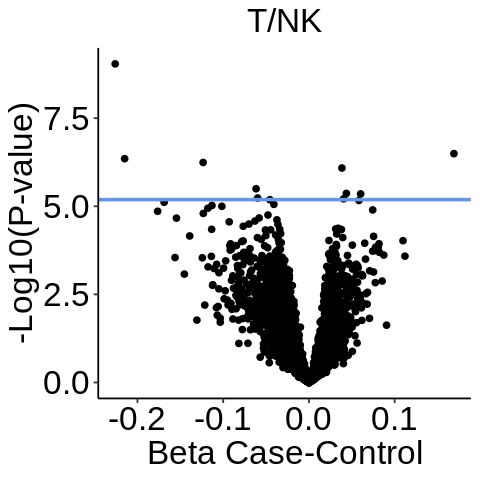

[1] "Myeloid"

FALSE  TRUE 
 9330    46 

      FALSE        TRUE 
0.995093857 0.004906143 


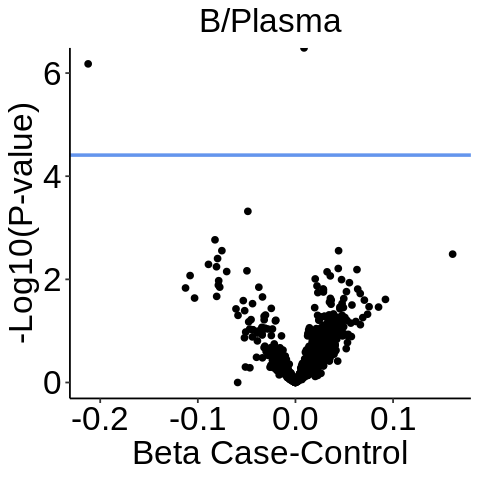

[1] "Glomerular"

FALSE  TRUE 
 8458   117 

     FALSE       TRUE 
0.98635569 0.01364431 


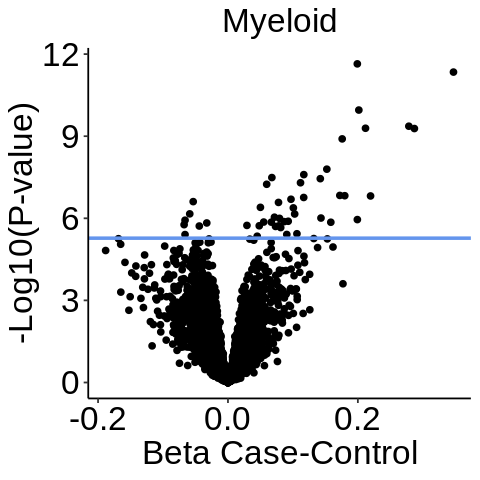

[1] "Interstitial/Stromal"

FALSE  TRUE 
11764    28 

      FALSE        TRUE 
0.997625509 0.002374491 


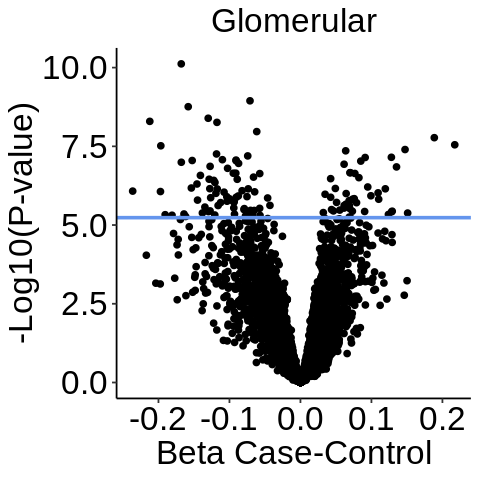

[1] "Loop of Henle"

FALSE  TRUE 
12467  2498 

    FALSE      TRUE 
0.8330772 0.1669228 


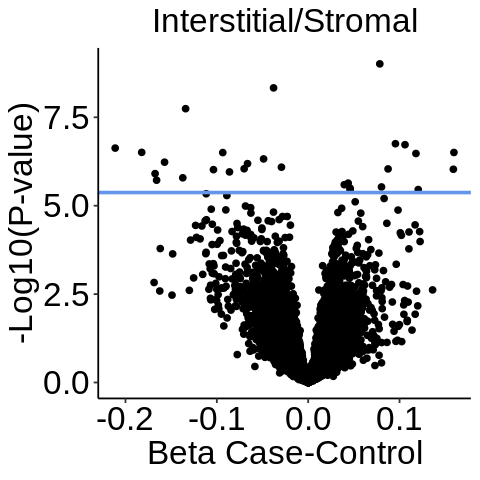

[1] "Distal Nephron"

FALSE  TRUE 
15593   309 

     FALSE       TRUE 
0.98056848 0.01943152 


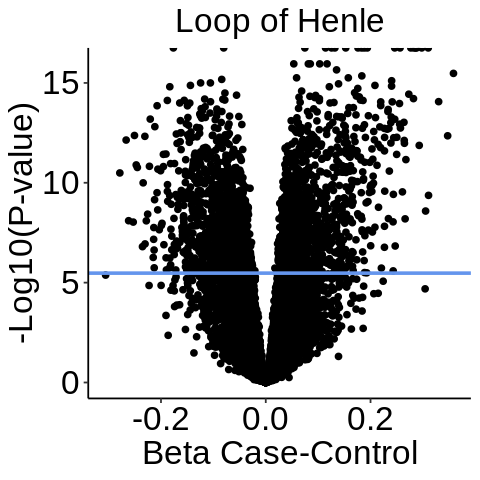

[1] "Proximal Tubule"

FALSE  TRUE 
12129  2631 

   FALSE     TRUE 
0.821748 0.178252 


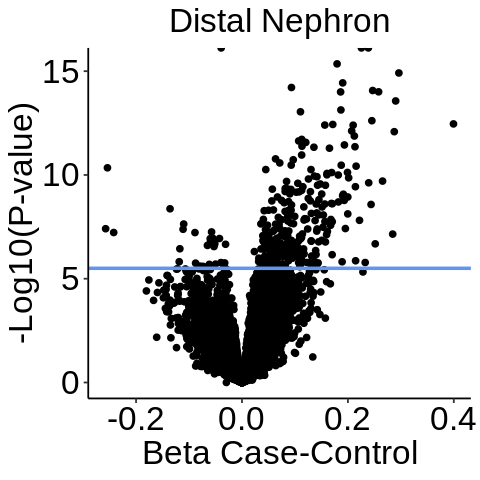

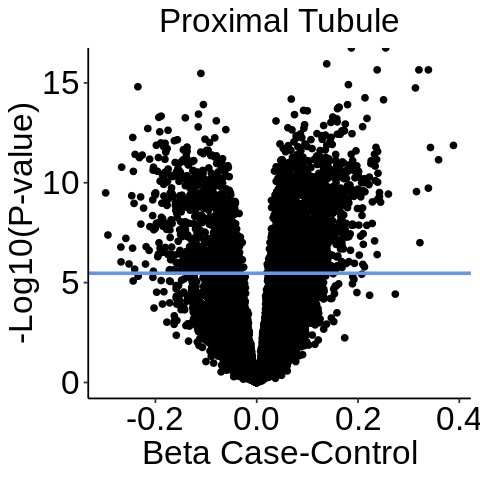

In [74]:
for (ctype in celltypes){
    res = res_list[[ctype]]
    
    print(ctype)
    print(table(res[['padj']]<0.05))
    print(prop.table(table(res[['padj']]<0.05)))
        
    fig.size(4, 4)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'cornflowerblue', linewidth = 1)+
        labs(x = 'Beta Case-Control', y = '-Log10(P-value)', title = ctype)
    print(p)
}

In [20]:
isg_genes_large = readRDS('/data/srlab/ssg34/SLE_kidney_v2/data/pseudobulk_de/isg_genes.rds')

In [112]:
isg_genes_large

[1] "IFI44L"   "IFITM3"   "BST2"     "LY6E"     "IFIT1"    "MX1"     
 [7] "STAT1"    "XAF1"     "RNF213"   "TNFSF10"  "IFIT3"    "IFI44"   
[13] "PARP14"   "OAS1"     "EIF2AK2"  "PSMB9"    "TYMP"     "IRF9"    
[19] "SERPING1" "GADD45B"

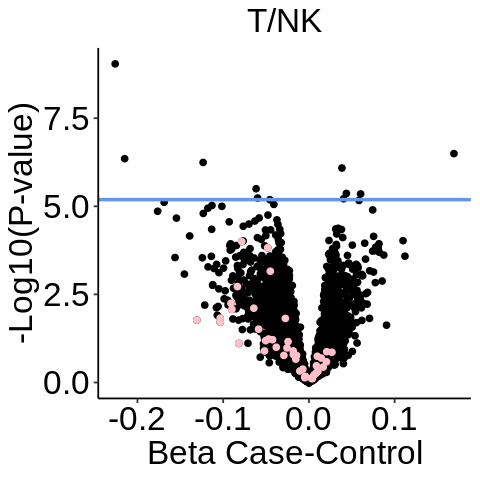

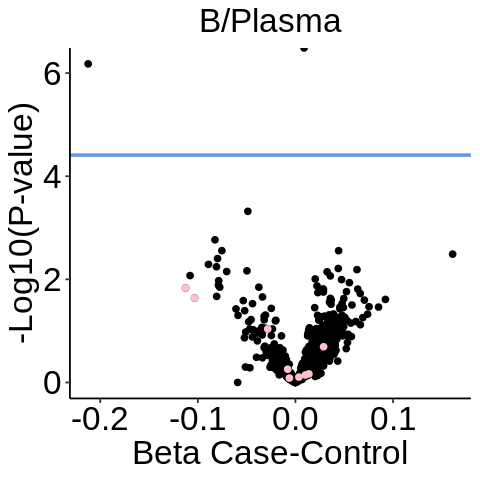

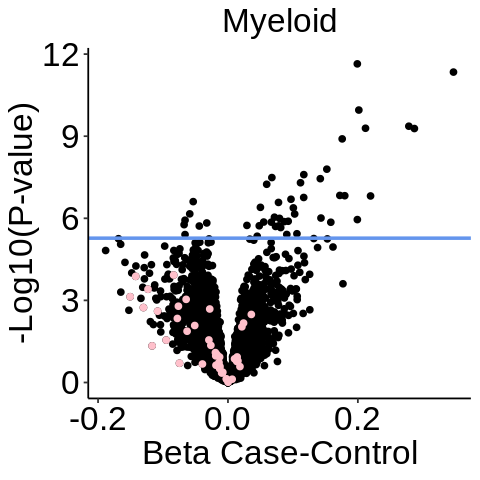

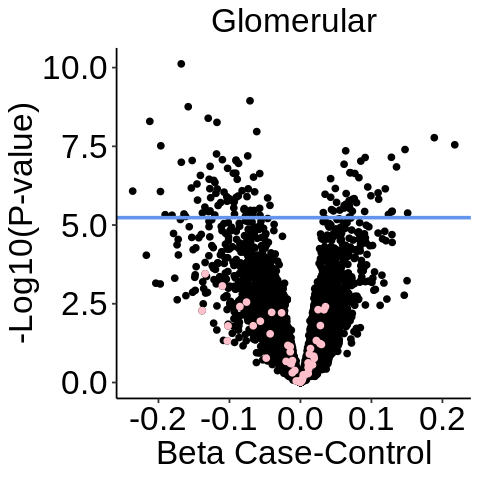

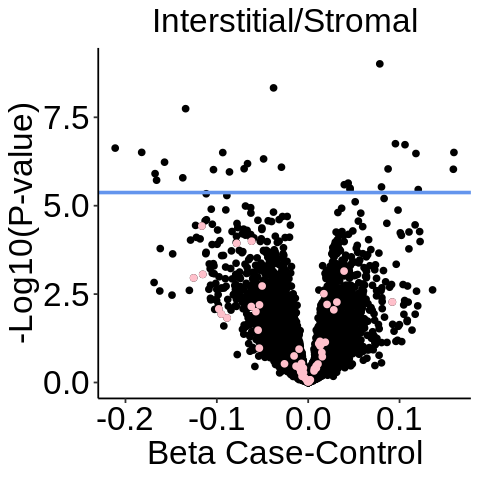

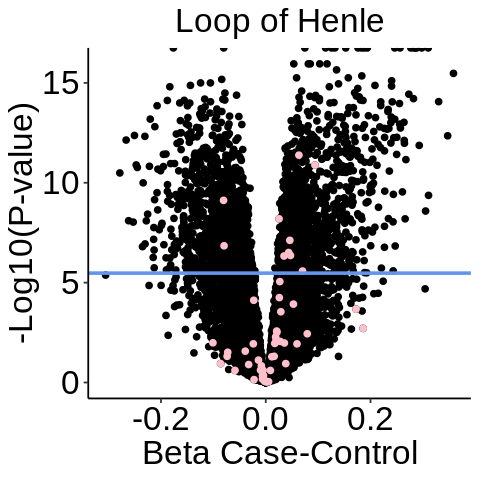

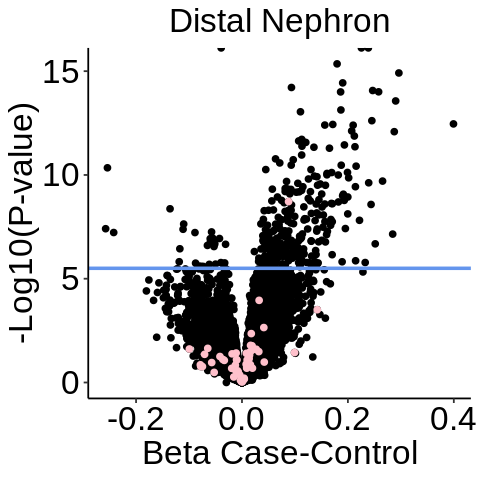

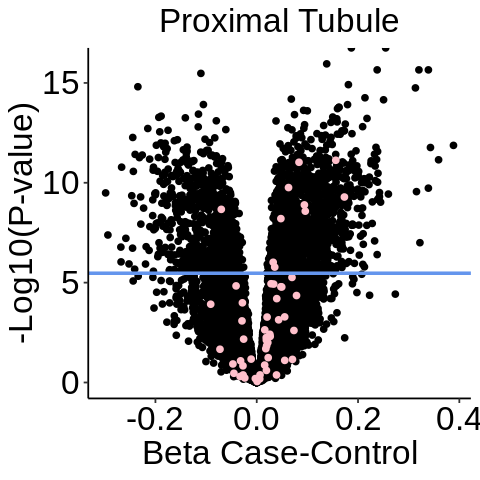

In [21]:
isg_genes = res_all[grep("^IF|^IS", res_all$gene), 'gene'] %>% unique %>% sort

for (ctype in celltypes){
    res = res_list[[ctype]]
        
    fig.size(4, 4)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        geom_point(data = res %>% filter(gene %in% isg_genes), 
                        aes(x = beta, y = -log10(p)), color = 'pink')+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'cornflowerblue', linewidth = 1)+
        labs(x = 'Beta Case-Control', y = '-Log10(P-value)', title = ctype)
    print(p)
}

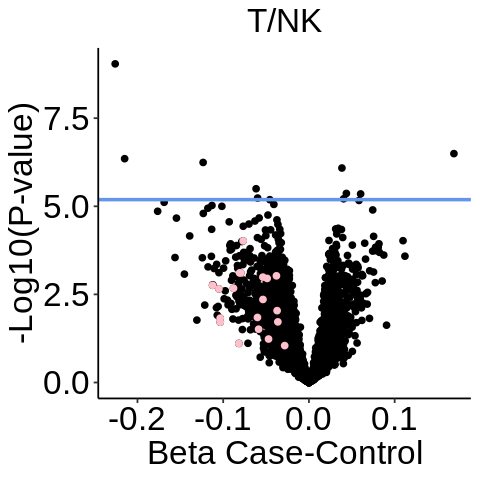

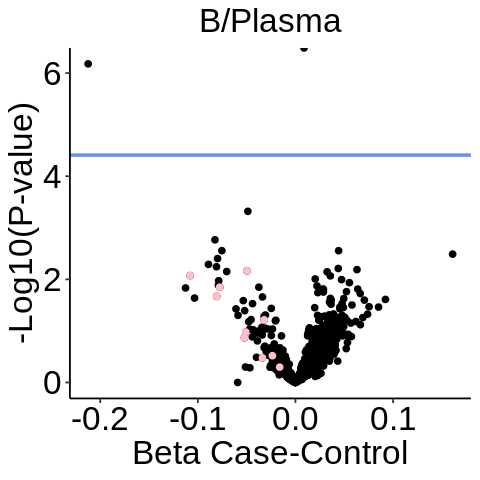

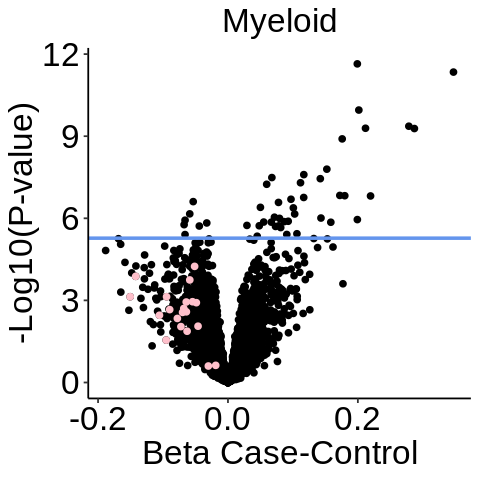

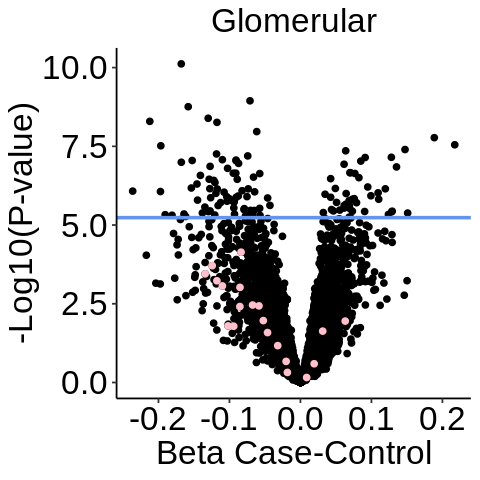

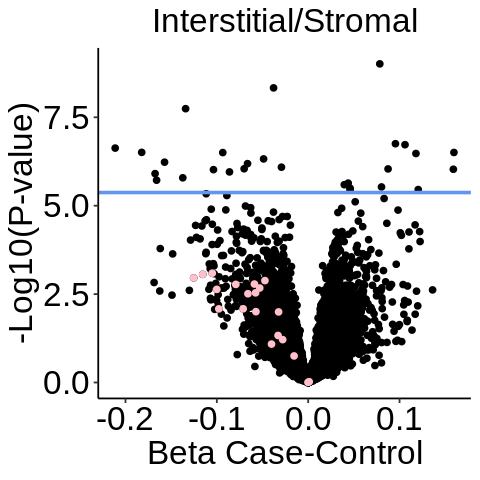

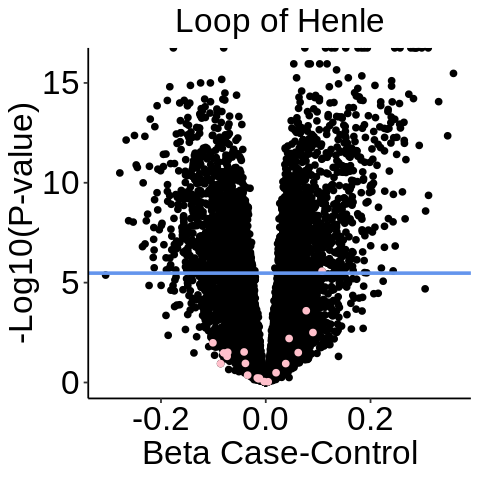

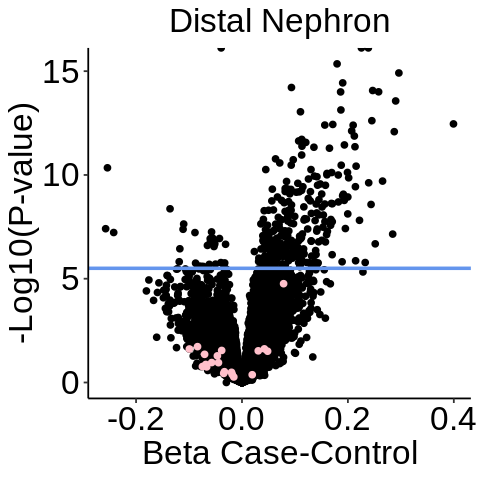

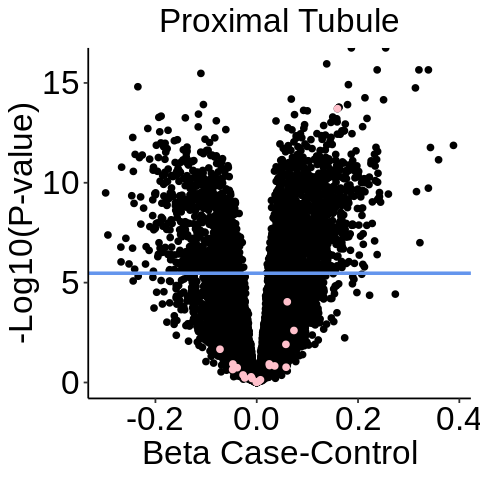

In [22]:
for (ctype in celltypes){
    res = res_list[[ctype]]
        
    fig.size(4, 4)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        geom_point(data = res %>% filter(gene %in% isg_genes_large), 
                        aes(x = beta, y = -log10(p)), color = 'pink')+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'cornflowerblue', linewidth = 1)+
        labs(x = 'Beta Case-Control', y = '-Log10(P-value)', title = ctype)
    print(p)
}

In [23]:
isg_genes_large

[1] "IFI44L"   "IFITM3"   "BST2"     "LY6E"     "IFIT1"    "MX1"     
 [7] "STAT1"    "XAF1"     "RNF213"   "TNFSF10"  "IFIT3"    "IFI44"   
[13] "PARP14"   "OAS1"     "EIF2AK2"  "PSMB9"    "TYMP"     "IRF9"    
[19] "SERPING1" "GADD45B"

In [24]:
res_all$celltype %>% table

.
            B/Plasma       Distal Nephron           Glomerular 
                1284                15902                 8575 
Interstitial/Stromal        Loop of Henle              Myeloid 
               11792                14965                 9376 
     Proximal Tubule                 T/NK 
               14760                 7729 

In [632]:
for (ctype in celltypes){
    print(ctype)
    print('Enriched')
   print(res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('Depleted')
    print(res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('')

}

[1] "T/NK"
[1] "Enriched"
[1] "WFDC2"  "A1BG"   "SNHG29" "RPS3A"  "RPS27A"
[1] "Depleted"
[1] "MIOX"    "ALDOB"   "SELENOP" "GNG2"    "PSME2"  
[1] ""
[1] "B/Plasma"
[1] "Enriched"
[1] "IGKC"
[1] "Depleted"
[1] "GPX3"
[1] ""
[1] "Myeloid"
[1] "Enriched"
 [1] "NUPR1"      "MARCO"      "FABP3"      "CYP27A1"    "COLEC12"   
 [6] "FBP1"       "GPNMB"      "TREM1"      "GCHFR"      "PMP22"     
[11] "SLC26A11"   "SCD"        "ALDH1A1"    "VAT1"       "CHCHD6"    
[16] "CSTB"       "CD59"       "FCHO2"      "FAH"        "QPCT"      
[21] "CAPG"       "SOAT1"      "A1BG"       "FDX1"       "TMEM255B"  
[26] "SNCA"       "AC244090.1" "HEXB"       "CD99"       "TXN"       
[31] "HSD17B4"    "MPC2"       "RALGDS"     "ORAI3"      "KDSR"      
[36] "C9orf16"    "S100A10"    "NENF"       "UBB"       
[1] "Depleted"
[1] "MS4A7"   "LYN"     "TRIM14"  "ABI3"    "PSMC4"   "CSF1R"   "ARHGDIB"
[1] ""
[1] "Glomerular"
[1] "Enriched"
 [1] "S100A2"    "KRT7"      "ARL4C"     "PLAU"      "FBLIM1"    "C19or

In [118]:
for (ctype in celltypes){
    print(ctype)
    print('Enriched')
   print(res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(100) %>% rownames)
    print('Depleted')
    print(res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(100) %>% rownames)
    print('')

}

[1] "T/NK"
[1] "Enriched"
[1] "WFDC2"  "A1BG"   "SNHG29" "RPS3A"  "RPS27A"
[1] "Depleted"
[1] "MIOX"    "ALDOB"   "SELENOP" "GNG2"    "PSME2"  
[1] ""
[1] "B/Plasma"
[1] "Enriched"
[1] "IGKC"
[1] "Depleted"
[1] "GPX3"
[1] ""
[1] "Myeloid"
[1] "Enriched"
 [1] "NUPR1"      "MARCO"      "FABP3"      "CYP27A1"    "COLEC12"   
 [6] "FBP1"       "GPNMB"      "TREM1"      "GCHFR"      "PMP22"     
[11] "SLC26A11"   "SCD"        "ALDH1A1"    "VAT1"       "CHCHD6"    
[16] "CSTB"       "CD59"       "FCHO2"      "FAH"        "QPCT"      
[21] "CAPG"       "SOAT1"      "A1BG"       "FDX1"       "TMEM255B"  
[26] "SNCA"       "AC244090.1" "HEXB"       "CD99"       "TXN"       
[31] "HSD17B4"    "MPC2"       "RALGDS"     "ORAI3"      "KDSR"      
[36] "C9orf16"    "S100A10"    "NENF"       "UBB"       
[1] "Depleted"
[1] "MS4A7"   "LYN"     "TRIM14"  "ABI3"    "PSMC4"   "CSF1R"   "ARHGDIB"
[1] ""
[1] "Glomerular"
[1] "Enriched"
 [1] "S100A2"    "KRT7"      "ARL4C"     "PLAU"      "FBLIM1"    "C19or

In [153]:
genes_show = c('NNMT', 'S100A9', 'AHNAK2','ALDOB','MIOX',
               'ANXA1', 'LCN2', 'SLPI',
               
                'COL4A4','CASP3','PYCARD', 'TUBB3', 'SPARCL1', 
               
               'RPS3A', 'RPS27A','IGKC','GPNMB', 'FABP3', 'VCAN',
               
               'HPD', 'GATM', 'SLC6A18', 'ALB',
               'VIM-AS1', 'MMP7', 'LAMA3', 'C3')

In [154]:
dat = res_all_wide %>% dplyr::select(starts_with('beta'))
dat = dat[genes_show, ]
genes_show = dat %>% rowMeans(na.rm =TRUE) %>% sort %>% rev %>% names
clus_order = (!is.na(dat[genes_show, ])) %>% colSums %>% sort %>% names %>% str_replace('beta_','')
# clus_order = dat[genes_show, ] %>% colMeans(na.rm= TRUE) %>% sort %>% names %>% str_replace('beta_','')
dat = dat %>% rownames_to_column('feature') %>% pivot_longer(cols = -(feature), 
                                                names_to = 'cluster', values_to = 'beta')

dat$feature = factor(dat$feature, levels = genes_show)

dat = dat %>% mutate(cluster = str_replace(cluster, 'beta_', ''))
dat$cluster = factor(dat$cluster, levels = clus_order)

vmax = (abs(dat$beta) %>% quantile(.99, na.rm = TRUE))[[1]] %>% round(2)
vmin = -vmax

In [155]:
genes_show

[1] "NNMT"    "LCN2"    "S100A9"  "AHNAK2"  "SLPI"    "C3"      "MMP7"   
 [8] "LAMA3"   "VCAN"    "TUBB3"   "ANXA1"   "GPNMB"   "VIM-AS1" "IGKC"   
[15] "PYCARD"  "CASP3"   "RPS3A"   "RPS27A"  "FABP3"   "COL4A4"  "SPARCL1"
[22] "GATM"    "HPD"     "MIOX"    "ALDOB"   "SLC6A18" "ALB"

In [156]:
dat['label'] = ''

dat = merge(dat, res_all %>% dplyr::select(gene, celltype, padj), 
      by.x = c('feature', 'cluster'), 
      by.y = c('gene', 'celltype'), 
      all.x = TRUE)

dat = dat %>% mutate(label = if_else(padj < 0.05, '∗', label, missing = ''))

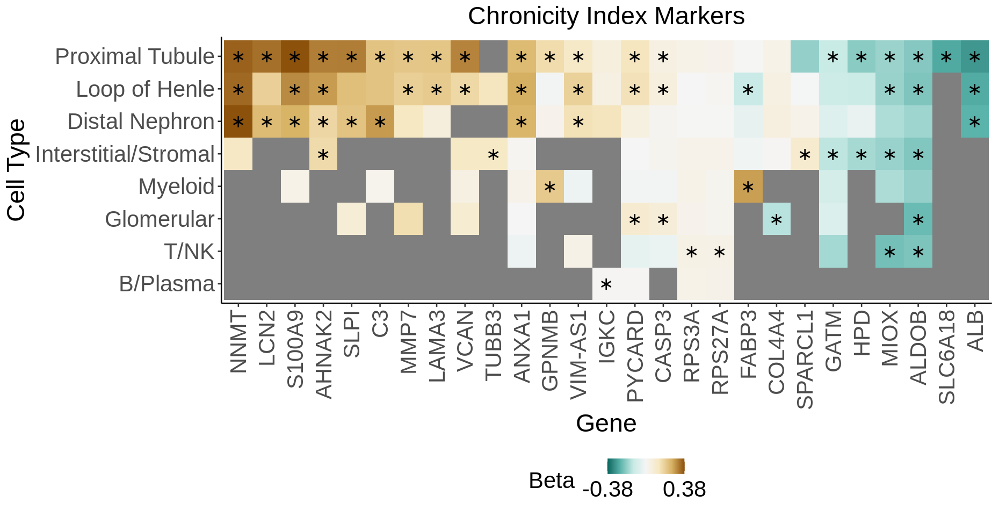

In [158]:
beta_heatmap = ggplot(dat, 
               aes(x = feature, y = cluster, 
                   fill = beta)) + 
    geom_tile() + 
    geom_text(aes(label = label), size = 7) +  # Add labels here
    theme_classic(base_size = tickfontsize) + 
    scale_fill_gradientn(colours=rev(brewer.pal(7,"BrBG")), limits=c(vmin, vmax), 
                             oob = scales::squish, breaks = c(vmin, vmax))+
    theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = .5),
          axis.text = element_text( size = labelfontsize+5),
          axis.title = element_text(size = labelfontsize+8), 
          plot.title = element_text(size = labelfontsize+8, hjust = 0.5), 
          legend.text = element_text(size = labelfontsize+5),
          legend.title = element_text(size = labelfontsize+5),
          legend.position = 'bottom'

         ) + 
    # geom_vline(xintercept = n + 0.5, linetype = 'dashed')+
    # geom_vline(xintercept = 2*n + 0.5, linetype = 'dashed')+
    labs(x = "Gene", y = "Cell Type", fill = 'Beta    ', title = 'Chronicity Index Markers')

height = 8
width = 15.5
fig.size(height, width)

outplot = beta_heatmap
outplot

ggsave(paste0(figdir, 'de_gene_heatmap_chronicity.png'), plot = outplot,  
       height = height, width = width, dpi = 500)
ggsave(paste0(figdir, 'de_gene_heatmap_chronicity.pdf'), plot = outplot,  
       height = height, width = width, dpi = 500, device = cairo_pdf)

In [41]:
gsea_list[['all']] %>% filter(padj < 0.05) %>% dplyr::select(-leadingEdge) %>% arrange(desc(NES)) %>% head(50)

,pathway,pval,padj,log2err,ES,NES,size,celltype
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
1,GOCC_CYTOSOLIC_RIBOSOME,1.921261e-19,1.488977e-15,1.1421912,0.7179632,2.964882,92,all
2,GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT,4.024619e-14,3.119080e-10,0.9653278,0.7540425,2.885590,54,all
3,GOBP_CYTOPLASMIC_TRANSLATION,4.161843e-19,3.225428e-15,1.1330899,0.6314222,2.836265,141,all
4,HP_OSTEOSARCOMA,4.735761e-08,3.670215e-04,0.7195128,0.7675737,2.635642,33,all
5,GOMF_STRUCTURAL_CONSTITUENT_OF_RIBOSOME,1.255328e-16,9.728793e-13,1.0476265,0.5850459,2.627247,155,all
6,GOCC_RIBOSOMAL_SUBUNIT,6.914806e-14,5.358974e-10,0.9545416,0.5479308,2.516004,169,all
7,HP_PERSISTENCE_OF_HEMOGLOBIN_F,8.898453e-08,6.896301e-04,0.7049757,0.7809256,2.515296,26,all
8,GOCC_POLYSOMAL_RIBOSOME,4.326294e-07,3.352878e-03,0.6749629,0.7418840,2.506826,29,all
9,HP_PURE_RED_CELL_APLASIA,7.542752e-07,5.845633e-03,0.6594444,0.7584683,2.463442,24,all


In [42]:
gsea_list[['all']] %>% filter(padj < 0.05) %>% dplyr::select(-leadingEdge) %>% arrange(desc(NES)) %>% tail(50)

,pathway,pval,padj,log2err,ES,NES,size,celltype
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
229,HP_APLASIA_HYPOPLASIA_OF_THE_CEREBRAL_WHITE_MATTER,3.439316e-08,2.665470e-04,0.7195128,-0.8437067,-2.529849,16,all
230,HP_HYPOKALEMIA,1.431311e-09,1.109266e-05,0.7881868,-0.6268596,-2.533941,53,all
231,GOBP_FATTY_ACID_CATABOLIC_PROCESS,4.132435e-12,3.202637e-08,0.8870750,-0.5692509,-2.534604,95,all
232,GOMF_ELECTRON_TRANSFER_ACTIVITY,1.601617e-12,1.241253e-08,0.9101197,-0.5467457,-2.536751,114,all
233,HP_ABNORMAL_CIRCULATING_FATTY_ACID_CONCENTRATION,1.047760e-09,8.120141e-06,0.7881868,-0.6376753,-2.537013,53,all
234,HP_ABNORMAL_CIRCULATING_PROTEINOGENIC_AMINO_ACID_DERIVATIVE_CONCENTRATION,1.722788e-09,1.335160e-05,0.7881868,-0.6281273,-2.537074,52,all
235,HP_ABNORMAL_CIRCULATING_NON_PROTEINOGENIC_AMINO_ACID_CONCENTRATION,8.122939e-08,6.295278e-04,0.7049757,-0.7829201,-2.552064,21,all
236,HP_ABNORMALITY_OF_THE_MITOCHONDRION,1.684122e-16,1.305195e-12,1.0476265,-0.5264867,-2.574797,172,all
237,HP_ABNORMAL_CSF_METABOLITE_LEVEL,4.238568e-13,3.284890e-09,0.9325952,-0.5601971,-2.575304,110,all


In [633]:
paths_plot = rbind(gsea_list[['all']] %>% filter(padj < 0.05) %>% 
                   arrange(desc(NES)) %>% dplyr::select(pathway, NES) %>% head(4), 
                   gsea_list[['all']] %>% filter(padj < 0.05) %>% 
                   arrange(desc(NES)) %>% dplyr::select(pathway, NES) %>% tail(4))
paths_plot = paths_plot$pathway

In [634]:
nctypes = 3

pathlist = ((gsea_all %>% filter(padj < 0.05, NES > 0))$pathway %>% table)
pathlist = pathlist[pathlist > nctypes] %>% names

sig_paths_up = pathlist

sig_paths_up

pathlist = ((gsea_all %>% filter(padj < 0.05, NES < 0))$pathway %>% table)
pathlist = pathlist[pathlist > nctypes] %>% names

sig_paths_down = pathlist

sig_paths_down

[1] "GOBP_CYTOPLASMIC_TRANSLATION"                       
 [2] "GOBP_NCRNA_METABOLIC_PROCESS"                       
 [3] "GOBP_NCRNA_PROCESSING"                              
 [4] "GOBP_RIBONUCLEOPROTEIN_COMPLEX_BIOGENESIS"          
 [5] "GOBP_RIBONUCLEOPROTEIN_COMPLEX_SUBUNIT_ORGANIZATION"
 [6] "GOBP_RIBOSOMAL_LARGE_SUBUNIT_BIOGENESIS"            
 [7] "GOBP_RIBOSOME_BIOGENESIS"                           
 [8] "GOBP_RRNA_METABOLIC_PROCESS"                        
 [9] "GOCC_ACTIN_CYTOSKELETON"                            
[10] "GOCC_CELL_SUBSTRATE_JUNCTION"                       
[11] "GOCC_COLLAGEN_CONTAINING_EXTRACELLULAR_MATRIX"      
[12] "GOCC_CYTOSOLIC_LARGE_RIBOSOMAL_SUBUNIT"             
[13] "GOCC_CYTOSOLIC_RIBOSOME"                            
[14] "GOCC_CYTOSOLIC_SMALL_RIBOSOMAL_SUBUNIT"             
[15] "GOCC_EXTERNAL_ENCAPSULATING_STRUCTURE"              
[16] "GOCC_LARGE_RIBOSOMAL_SUBUNIT"                       
[17] "GOCC_MICROTUBULE"                                   
[18] "GOCC_POLYSOMAL_RIBOSOME"                            
[19] "GOCC_POLYSOME"                                      
[20] "GOCC_RIBOSOMAL_SUBUNIT"                             
[21] "GOCC_RIBOSOME"                                      
[22] "GOCC_SMALL_RIBOSOMAL_SUBUNIT"                       
[23] "GOMF_ACTIN_BINDING"                                 
[24] "GOMF_CADHERIN_BINDING"                              
[25] "GOMF_CELL_ADHESION_MOLECULE_BINDING"                
[26] "GOMF_STRUCTURAL_CONSTITUENT_OF_RIBOSOME"            
[27] "GOMF_STRUCTURAL_MOLECULE_ACTIVITY"                  
[28] "HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION"         
[29] "HALLMARK_MYC_TARGETS_V1"                            
[30] "HP_ADENOCARCINOMA_OF_THE_COLON"                     
[31] "HP_OSTEOSARCOMA"                                    
[32] "HP_PERSISTENCE_OF_HEMOGLOBIN_F"                     
[33] "HP_PURE_RED_CELL_APLASIA"

[1] "GOBP_AEROBIC_RESPIRATION"                                            
 [2] "GOBP_ATP_METABOLIC_PROCESS"                                          
 [3] "GOBP_ATP_SYNTHESIS_COUPLED_ELECTRON_TRANSPORT"                       
 [4] "GOBP_CARBOHYDRATE_METABOLIC_PROCESS"                                 
 [5] "GOBP_CELLULAR_AMINO_ACID_CATABOLIC_PROCESS"                          
 [6] "GOBP_CELLULAR_AMINO_ACID_METABOLIC_PROCESS"                          
 [7] "GOBP_CELLULAR_RESPIRATION"                                           
 [8] "GOBP_ENERGY_DERIVATION_BY_OXIDATION_OF_ORGANIC_COMPOUNDS"            
 [9] "GOBP_FATTY_ACID_METABOLIC_PROCESS"                                   
[10] "GOBP_GENERATION_OF_PRECURSOR_METABOLITES_AND_ENERGY"                 
[11] "GOBP_MONOCARBOXYLIC_ACID_METABOLIC_PROCESS"                          
[12] "GOBP_ORGANIC_ACID_CATABOLIC_PROCESS"                                 
[13] "GOBP_ORGANIC_HYDROXY_COMPOUND_METABOLIC_PROCESS"                     
[14] "GOBP_OXIDATIVE_PHOSPHORYLATION"                                      
[15] "GOBP_PROTON_TRANSMEMBRANE_TRANSPORT"                                 
[16] "GOBP_SMALL_MOLECULE_BIOSYNTHETIC_PROCESS"                            
[17] "GOBP_SMALL_MOLECULE_CATABOLIC_PROCESS"                               
[18] "GOCC_INNER_MITOCHONDRIAL_MEMBRANE_PROTEIN_COMPLEX"                   
[19] "GOCC_MITOCHONDRIAL_MATRIX"                                           
[20] "GOCC_MITOCHONDRIAL_PROTEIN_CONTAINING_COMPLEX"                       
[21] "GOCC_OXIDOREDUCTASE_COMPLEX"                                         
[22] "GOCC_RESPIRASOME"                                                    
[23] "GOMF_ACTIVE_ION_TRANSMEMBRANE_TRANSPORTER_ACTIVITY"                  
[24] "GOMF_ACTIVE_TRANSMEMBRANE_TRANSPORTER_ACTIVITY"                      
[25] "GOMF_CATION_TRANSMEMBRANE_TRANSPORTER_ACTIVITY"                      
[26] "GOMF_ELECTRON_TRANSFER_ACTIVITY"                                     
[27] "GOMF_INORGANIC_MOLECULAR_ENTITY_TRANSMEMBRANE_TRANSPORTER_ACTIVITY"  
[28] "GOMF_OXIDOREDUCTION_DRIVEN_ACTIVE_TRANSMEMBRANE_TRANSPORTER_ACTIVITY"
[29] "GOMF_PRIMARY_ACTIVE_TRANSMEMBRANE_TRANSPORTER_ACTIVITY"              
[30] "GOMF_PROTON_TRANSMEMBRANE_TRANSPORTER_ACTIVITY"                      
[31] "HALLMARK_INTERFERON_ALPHA_RESPONSE"                                  
[32] "HALLMARK_INTERFERON_GAMMA_RESPONSE"                                  
[33] "HALLMARK_OXIDATIVE_PHOSPHORYLATION"                                  
[34] "HP_ABNORMAL_BLOOD_GLUCOSE_CONCENTRATION"                             
[35] "HP_ABNORMAL_CIRCULATING_AMINO_ACID_CONCENTRATION"                    
[36] "HP_ABNORMAL_CIRCULATING_CARBOXYLIC_ACID_CONCENTRATION"               
[37] "HP_ABNORMAL_CSF_METABOLITE_LEVEL"                                    
[38] "HP_ABNORMAL_URINE_METABOLITE_LEVEL"                                  
[39] "HP_ABNORMAL_URINE_PH"                                                
[40] "HP_ABNORMALITY_OF_ACID_BASE_HOMEOSTASIS"                             
[41] "HP_ABNORMALITY_OF_THE_MITOCHONDRION"                                 
[42] "HP_ENCEPHALOPATHY"                                                   
[43] "HP_INCREASED_CSF_LACTATE"                                            
[44] "HP_INCREASED_SERUM_LACTATE"                                          
[45] "HP_LACTIC_ACIDOSIS"                                                  
[46] "HP_LETHARGY"                                                         
[47] "HP_METABOLIC_ACIDOSIS"                                               
[48] "HP_NAUSEA_AND_VOMITING"                                              
[49] "HP_PROXIMAL_TUBULOPATHY"                                             
[50] "HP_REDUCED_CONSCIOUSNESS_CONFUSION"                                  
[51] "HP_RENAL_TUBULAR_DYSFUNCTION"                                        
[52] "HP_VOMITING"

In [635]:
paths_plot = c(sig_paths_up, sig_paths_down)

In [636]:
dat = gsea_all %>% filter(pathway %in% paths_plot)# %>% pivot_wider(names_from = celltype, values_from = NES, id_cols = pathway)%>% as.data.frame
# rownames(dat) = dat$pathway
dat$pathway = factor(dat$pathway, levels = rev(paths_plot))


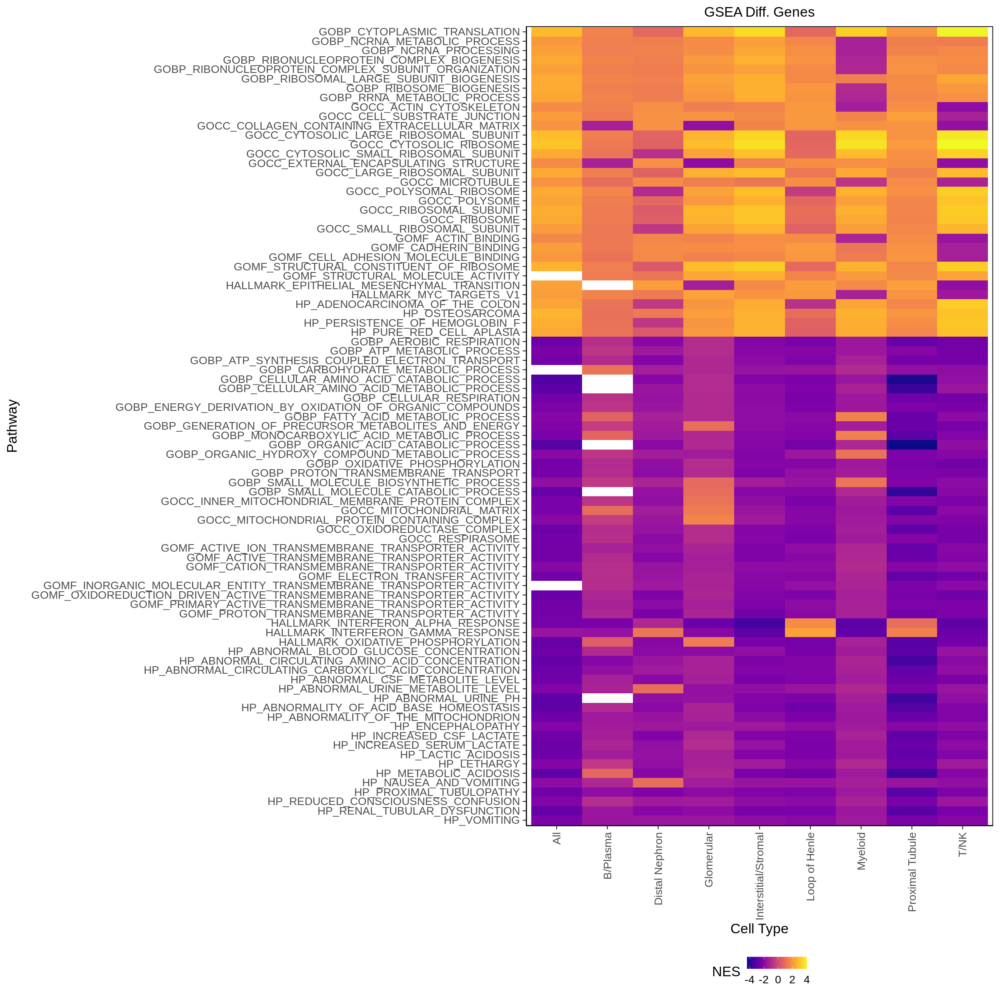

In [638]:
hmap = ggplot(dat)+
    geom_tile(aes(x = celltype_rename, y =pathway, fill = NES))+
    scale_fill_viridis(option = 'plasma', na.value = 'white')+
    theme_classic(base_size = labelfontsize)+
    theme(text = element_text(family = "Arial"), 
          plot.title = element_text(hjust = 0.5, size = labelfontsize),
          axis.text.x = element_text(angle = 90, hjust = 1,  vjust = 0.5),
          axis.text = element_text(size = tickfontsize),
          axis.line = element_line(color = "black", size = 0.5),  # Ensuring axis lines are black and visible
          axis.ticks = element_line(color = "black", size = 0.5),  # Adding ticks to the axes
          panel.border = element_rect(color = "black", fill = NA, size = 1),
         legend.position = 'bottom') + 
    # scale_y_discrete(labels = rev(paths_plot_short))+# Border around the panel
    labs(x = 'Cell Type', y = 'Pathway', fill = 'NES', title = 'GSEA Diff. Genes')
    # scale_fill_gradient2(low = 'blue', mid = 'lightgray', high = 'red', na.value = 'white')

height = 20
width = 20
fig.size(height, width)
outplot = hmap
outplot

# ggsave(paste0(figdir, 'gsea_heatmap_casectrl.png'), plot = outplot,  
#        height = height, width = width, dpi = 500)
# ggsave(paste0(figdir, 'gsea_heatmap_casectrl.pdf'), plot = outplot,  
#        height = height, width = width, dpi = 500, device = cairo_pdf)


In [211]:
pathways['HP_RENAL_TUBULAR_DYSFUNCTION']
pathways[['HP_RENAL_TUBULAR_DYSFUNCTION']] %>% length

pathways['HP_ABNORMAL_URINE_PH']
pathways[['HP_ABNORMAL_URINE_PH']] %>% length

intersect(pathways[['HP_RENAL_TUBULAR_DYSFUNCTION']], pathways[['HP_ABNORMAL_URINE_PH']])
intersect(pathways[['HP_RENAL_TUBULAR_DYSFUNCTION']], pathways[['HP_ABNORMAL_URINE_PH']]) %>% length

$HP_RENAL_TUBULAR_DYSFUNCTION
  [1] "ABCC8"    "ALDOB"    "ATP6V0A4" "ATP6V1B1" "ATP7B"    "BCS1L"   
  [7] "CA2"      "CAD"      "CLCN5"    "CLCNKB"   "CLDN16"   "COA8"    
 [13] "COG6"     "COQ2"     "CPT1A"    "CTNS"     "CYP11B2"  "EHHADH"  
 [19] "EPG5"     "ETFA"     "ETFB"     "ETFDH"    "FAH"      "FBXL4"   
 [25] "FN1"      "FOXRED1"  "GATA3"    "GATM"     "GCK"      "GNAS"    
 [31] "HBB"      "HNF1B"    "HNF1B"    "HNF4A"    "INS"      "JAG1"    
 [37] "KCNJ11"   "KCNJ2"    "KCNJ5"    "KYNU"     "LRP2"     "MMUT"    
 [43] "MT-CO1"   "MT-CO2"   "MT-CO3"   "MT-ND1"   "MT-ND2"   "MT-ND3"  
 [49] "MT-ND4"   "MT-ND5"   "MT-ND6"   "MT-TF"    "MT-TH"    "MT-TL1"  
 [55] "MT-TN"    "MT-TQ"    "MT-TS1"   "MT-TS2"   "MT-TW"    "NADK2"   
 [61] "NDUFA1"   "NDUFA11"  "NDUFA6"   "NDUFA6"   "NDUFA6"   "NDUFA6"  
 [67] "NDUFA6"   "NDUFAF1"  "NDUFAF2"  "NDUFAF3"  "NDUFAF4"  "NDUFAF5" 
 [73] "NDUFAF6"  "NDUFAF8"  "NDUFB10"  "NDUFB11"  "NDUFB3"   "NDUFB8"  
 [79] "NDUFB9"   "NDUFS1"   "NDUFS1"   "NDUFS2"   "NDUFS3"   "NDUFS3"  
 [85] "NDUFS4"   "NDUFS6"   "NDUFS7"   "NDUFS8"   "NDUFV1"   "NDUFV2"  
 [91] "NOTCH2"   "NUBPL"    "OCRL"     "PC"       "PDSS2"    "PDX1"    
 [97] "PEX19"    "PHEX"     "PHKA2"    "PHKG2"    "PIGA"     "PMM2"    
[103] "RMND1"    "RRM2B"    "SCO2"     "SLC12A3"  "SLC2A2"   "SLC34A1" 
[109] "SLC34A3"  "SLC4A1"   "SLC4A4"   "SLC5A2"   "STAT3"    "SURF1"   
[115] "SURF1"    "TIMMDC1"  "TMEM126B" "UQCC2"    "VIPAS39"  "VPS33B"

[1] 120

$HP_ABNORMAL_URINE_PH
 [1] "ABCD4"    "ACAD8"    "ACAD9"    "ACADM"    "ACADS"    "ACADVL"  
 [7] "ACSF3"    "AGXT"     "ALAD"     "ALDH5A1"  "BTD"      "CD320"   
[13] "COX16"    "CPOX"     "CPT2"     "D2HGDH"   "DHTKD1"   "DNAJC19" 
[19] "ETFA"     "ETFB"     "ETFDH"    "ETHE1"    "FLAD1"    "GATA1"   
[25] "GATM"     "GCDH"     "GRHPR"    "HADH"     "HCFC1"    "HGD"     
[31] "HLCS"     "HMBS"     "HMGCL"    "HOGA1"    "HPD"      "IDH2"    
[37] "KIF1B"    "L2HGDH"   "LDHD"     "LMBRD1"   "MCCC1"    "MCCC2"   
[43] "MCCC2"    "MCCC2"    "MCEE"     "MLYCD"    "MMAA"     "MMAB"    
[49] "MMACHC"   "MMADHC"   "MMUT"     "MPC1"     "MRPS2"    "MT-ATP6" 
[55] "MT-ND1"   "MT-ND2"   "MT-ND3"   "MT-ND4"   "MT-ND5"   "MT-ND6"  
[61] "MT-TK"    "MT-TL1"   "MT-TV"    "MT-TW"    "MVK"      "NADK2"   
[67] "NDUFB10"  "NDUFS4"   "NFS1"     "OXCT1"    "PCCA"     "PCCB"    
[73] "PDP1"     "PET117"   "PEX1"     "POLG"     "PPOX"     "PRDX1"   
[79] "RET"      "SCO1"     "SDHD"     "SLC25A1"  "SLC25A19" "SLC25A20"
[85] "SLC25A21" "SLC25A4"  "SLC26A1"  "SLC52A1"  "SLC52A2"  "SLC52A2" 
[91] "SUCLA2"   "SUCLG1"   "SUGCT"    "TAFAZZIN" "TAT"      "TCN2"    
[97] "UROC1"    "UROS"

[1] 98

[1] "ETFA"    "ETFB"    "ETFDH"   "GATM"    "MMUT"    "MT-ND1"  "MT-ND2" 
 [8] "MT-ND3"  "MT-ND4"  "MT-ND5"  "MT-ND6"  "MT-TL1"  "MT-TW"   "NADK2"  
[15] "NDUFB10" "NDUFS4"

[1] 16

In [641]:
paths_plot = intersect(paths_plot, c('GOCC_COLLAGEN_CONTAINING_EXTRACELLULAR_MATRIX', 
                        'GOBP_CYTOPLASMIC_TRANSLATION',
                        'GOCC_RIBOSOMAL_SUBUNIT', 'HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION',
                       
                        'GOCC_ACTIN_CYTOSKELETON','GOCC_MICROTUBULE',
                        'HALLMARK_INTERFERON_ALPHA_RESPONSE', 'HALLMARK_INTERFERON_GAMMA_RESPONSE'
                       ))

In [642]:
paths_plot

[1] "GOBP_CYTOPLASMIC_TRANSLATION"                 
[2] "GOCC_ACTIN_CYTOSKELETON"                      
[3] "GOCC_COLLAGEN_CONTAINING_EXTRACELLULAR_MATRIX"
[4] "GOCC_MICROTUBULE"                             
[5] "GOCC_RIBOSOMAL_SUBUNIT"                       
[6] "HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION"   
[7] "HALLMARK_INTERFERON_ALPHA_RESPONSE"           
[8] "HALLMARK_INTERFERON_GAMMA_RESPONSE"

In [644]:
paths_plot_short = c('GOBP_CYTO_TRANS',
                     'GOCC_ACT_CYTOSK',
                     'GOCC_COLL_ECM',
                     'GOCC_MICROTUB',
                     'GOCC_RIBO_SUB',
                     'HALLMARK_EMT',
                     'HALLMARK_IFN_A',
                     'HALLMARK_IFN_G'
)

In [645]:
dat = dat %>%filter(pathway %in% paths_plot)
dat = dat %>% mutate(label = ifelse(padj < 0.05, '﹡', ''))

dat$pathway = dat$pathway %>% droplevels

dat = dat %>% dplyr::select(-leadingEdge) %>% complete(pathway, celltype_rename, )

dat$pathway = factor(dat$pathway, levels = rev(paths_plot))


Warning message in geom_text(aes(x = celltype_rename, y = pathway, label = label), :
“Ignoring unknown parameters: `fill`”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_text()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_text()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_text()`).”


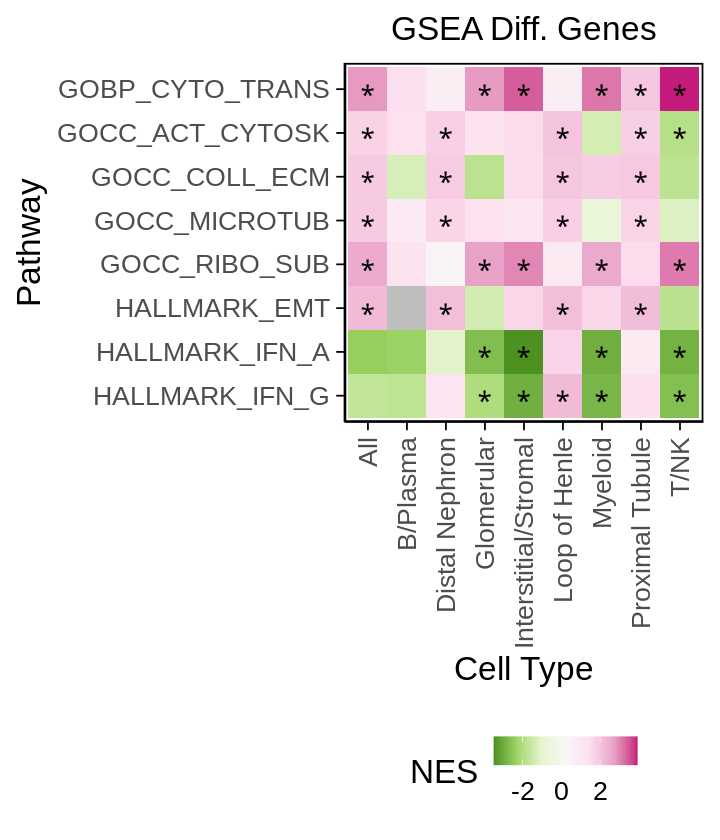

In [668]:
hmap = ggplot(dat)+
    geom_tile(aes(x = celltype_rename, y =pathway, fill = NES))+
    geom_text(aes(x = celltype_rename, y =pathway, label = label), fill = 'black', color = "black", size = 9) +
    scale_fill_gradientn(colours=rev(brewer.pal(7,"PiYG")), 
                         # breaks = c(-vmax, 0, vmax),limits = c(-vmax, vmax), oob=scales::squish, 
                         na.value = 'grey')+
    theme_classic(base_size = labelfontsize)+
    theme(text = element_text(family = "Arial"), 
          plot.title = element_text(hjust = 0.5, size = labelfontsize),
          axis.text.x = element_text(angle = 90, hjust = 1,  vjust = 0.5),
          axis.text = element_text(size = tickfontsize),
          axis.line = element_line(color = "black", size = 0.5),  # Ensuring axis lines are black and visible
          axis.ticks = element_line(color = "black", size = 0.5),  # Adding ticks to the axes
          panel.border = element_rect(color = "black", fill = NA, size = 1),
         legend.position = 'bottom') + 
    scale_y_discrete(labels = rev(paths_plot_short))+
    labs(x = 'Cell Type', y = 'Pathway', fill = 'NES', title = 'GSEA Diff. Genes')
    # scale_fill_gradient2(low = 'blue', mid = 'lightgray', high = 'red', na.value = 'white')

height = 7
width = 6
fig.size(height, width)
outplot = hmap
outplot

ggsave(paste0(figdir, 'gsea_heatmap_chronicity.png'), plot = outplot,  
       height = height, width = width, dpi = 500)
ggsave(paste0(figdir, 'gsea_heatmap_chronicity.pdf'), plot = outplot,  
       height = height, width = width, dpi = 500, device = cairo_pdf)


# Activity, by cell type

## Run differential expression

In [107]:
for (ctype in celltypes[2:length(celltypes)]){
    print(ctype)
    qcd_meta = read_delim(ctype_list[[ctype]][4]) %>% as.data.frame
    colnames(qcd_meta) = qcd_meta %>% colnames() %>% str_replace_all(' ', '_')
    site_dummies = qcd_meta %>% dplyr::select(starts_with('Final_Site_')) %>% colnames
    
    if (ctype %in% immune_ctypes){
        qcd_raw = readRDS(ctype_list[[ctype]][2])
        qcd_raw <- qcd_raw[, qcd_meta$cell]
    } else {
        qcd_raw = qcd_raw_tissue[, qcd_meta$cell]
    }
    
    pseudo_raw = pseudobulk(qcd_raw, qcd_meta$sample)
    rm(qcd_raw)
    gc()
    
    ncounts = colSums(pseudo_raw)
    sample_meta = qcd_meta[!duplicated(qcd_meta$sample), ]
    rownames(sample_meta) = sample_meta$sample
    sample_meta$ncounts = ncounts
    
    ndonor_thresh = round(nrow(sample_meta)*.9)
    print(ndonor_thresh)
    genes = rownames(pseudo_raw)[rowSums(pseudo_raw >= genecount_thresh) > ndonor_thresh]
    print(length(genes))
    
    pseudo_raw = pseudo_raw[genes, rownames(sample_meta)]
    gc()
    # pseudo_raw = pseudo_raw + pseudocount

    system.time(
    suppressMessages({
    suppressWarnings({
        res_list = future_lapply(genes, future.seed = TRUE, function(gene){
            
            tryCatch({
        res = data.frame()

        gene_expr = pseudo_raw[gene, ]
            
        null_fm = as.formula(paste0(c('gene_expr ~ First_biop + Final_Chronicity +', paste0(site_dummies, collapse = ' + '), 
                              ' + offset(log(ncounts))'), collapse = '') )
        full_fm = as.formula(paste0(c('gene_expr ~ First_biop + Final_Chronicity + Final_Activity +', paste0(site_dummies, collapse = ' + '), 
                              ' + offset(log(ncounts))'), collapse = '') )
        # print(full_fm)

        null = glm.nb(null_fm, data = sample_meta)
        full = glm.nb(full_fm, data = sample_meta)
        z =summary(full)$coefficients['Final_Activity', "z value"]
        se = summary(full)$coefficients['Final_Activity', "Std. Error"]
        b = summary(full)$coefficients['Final_Activity', "Estimate"] #full$coefficients[['TypeLN']]
        pval = anova(full, null)[2, 'Pr(Chi)']
        res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se, 'z-score' = z, 'p' = pval))       
        return(res)
                
        }, error = function(e) {
            message(paste("Error for gene:", gene))
            message("Error message:", e$message)
            return(NULL)  # Return NULL if there's an error to avoid stopping the loop
          })
                
        })})})
    )

    res = do.call("rbind", res_list)
    res['celltype'] = ctype
    res$padj = p.adjust(res$p, method = "bonferroni")

    name = ctype_list[[ctype]][3]
    saveRDS(res, paste0(outdir, name, '_activity_differential_expression_20250529_sitenoTR.rds'))
    flush.console()
}

[1] "B/Plasma"


Rows: 11729 Columns: 39
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (8): cell, sample, final_annotation, Responder.Status, Race, Final_ISN,...
dbl (31): Sex, Age, Final_Chronicity, Final_Activity, First_biop, Pred_use, ...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


[1] 122
[1] 1284
[1] "Myeloid"


Rows: 21479 Columns: 40
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (8): cell, sample, final_annotation, Responder.Status, Race, Final_ISN,...
dbl (32): Sex, new_cluster_number, Age, Final_Chronicity, Final_Activity, Fi...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


[1] 127
[1] 9376
[1] "Glomerular"


Rows: 7399 Columns: 39
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (8): cell, sample, final_annotation, Responder.Status, Race, Final_ISN,...
dbl (31): Sex, Age, Final_Chronicity, Final_Activity, First_biop, Pred_use, ...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


[1] 126
[1] 8575
[1] "Interstitial/Stromal"


Rows: 40656 Columns: 39
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (8): cell, sample, final_annotation, Responder.Status, Race, Final_ISN,...
dbl (31): Sex, Age, Final_Chronicity, Final_Activity, First_biop, Pred_use, ...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


[1] 127
[1] 11792
[1] "Loop of Henle"


Rows: 108462 Columns: 39
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (8): cell, sample, final_annotation, Responder.Status, Race, Final_ISN,...
dbl (31): Sex, Age, Final_Chronicity, Final_Activity, First_biop, Pred_use, ...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


[1] 128
[1] 14965
[1] "Distal Nephron"


Rows: 84832 Columns: 39
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (8): cell, sample, final_annotation, Responder.Status, Race, Final_ISN,...
dbl (31): Sex, Age, Final_Chronicity, Final_Activity, First_biop, Pred_use, ...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


[1] 128
[1] 15902
[1] "Proximal Tubule"


Rows: 140034 Columns: 39
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (8): cell, sample, final_annotation, Responder.Status, Race, Final_ISN,...
dbl (31): Sex, Age, Final_Chronicity, Final_Activity, First_biop, Pred_use, ...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


[1] 127
[1] 14761


## Load results

In [21]:
res_list = list()
res_all = data.frame()

for (ctype in celltypes){
    
    name = ctype_list[[ctype]][3]
    de_fn = paste0(outdir, name, '_activity_differential_expression_20250529_sitenoTR.rds')
    res = readRDS(de_fn)
    print(res$gene %>% unique %>% length)
    
    res_all = rbind(res_all, res)
    res_list[[ctype]] = res
    rownames(res_list[[ctype]]) = res$gene
}

[1] 7729
[1] 1283
[1] 9376
[1] 8575
[1] 11792
[1] 14965
[1] 15902
[1] 14760


In [22]:
name = 'Activity in Tissue'
export_res[[name]] = res_all %>% mutate(variable = 'activity tissue')

In [76]:
res_all_wide = res_all %>% pivot_wider(id_cols = gene, names_from = celltype, values_from = c(beta,stderr, z.score, p, padj)) %>% as.data.frame
rownames(res_all_wide) = res_all_wide$gene

In [ ]:
for (ctype in celltypes){
   print(res_list[[ctype]] %>% filter(padj < 0.05) %>% arrange(desc(beta)))
}

## Visualize results

[1] "T/NK"

FALSE  TRUE 
 7720     9 

      FALSE        TRUE 
0.998835554 0.001164446 
[1] "B/Plasma"

FALSE  TRUE 
 1281     2 

      FALSE        TRUE 
0.998441154 0.001558846 


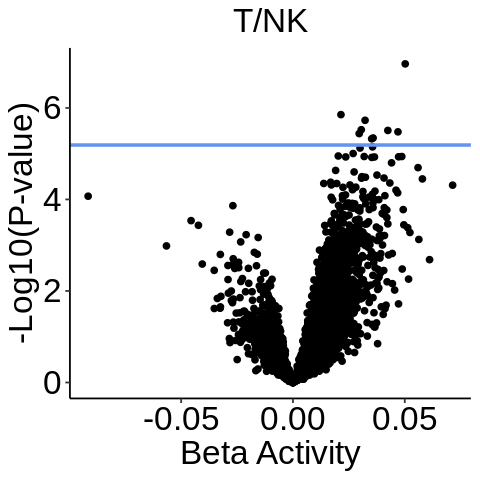

[1] "Myeloid"

FALSE  TRUE 
 8941   435 

     FALSE       TRUE 
0.95360495 0.04639505 


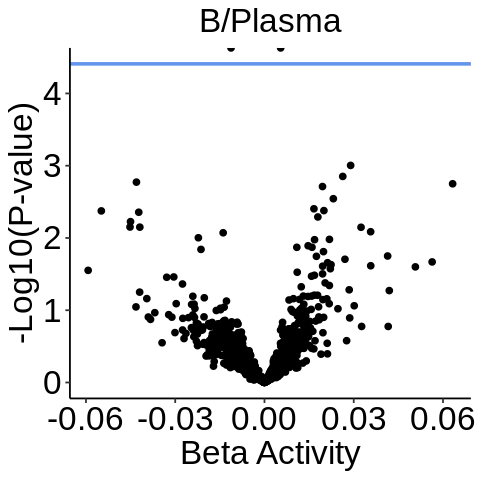

[1] "Glomerular"

FALSE  TRUE 
 8374   201 

     FALSE       TRUE 
0.97655977 0.02344023 


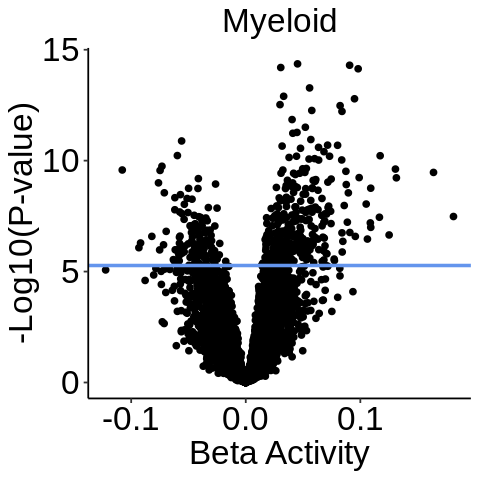

[1] "Interstitial/Stromal"

FALSE  TRUE 
11781    11 

       FALSE         TRUE 
0.9990671642 0.0009328358 


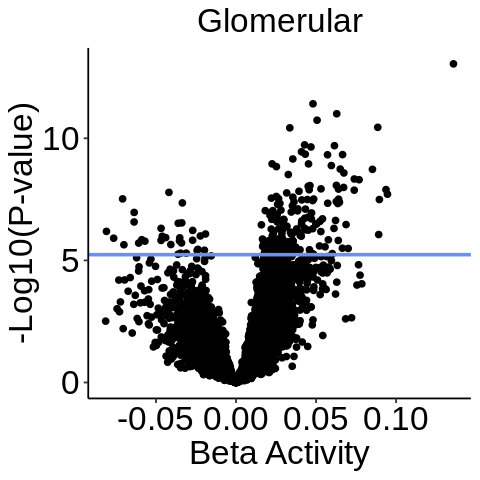

[1] "Loop of Henle"

FALSE  TRUE 
14838   127 

      FALSE        TRUE 
0.991513532 0.008486468 


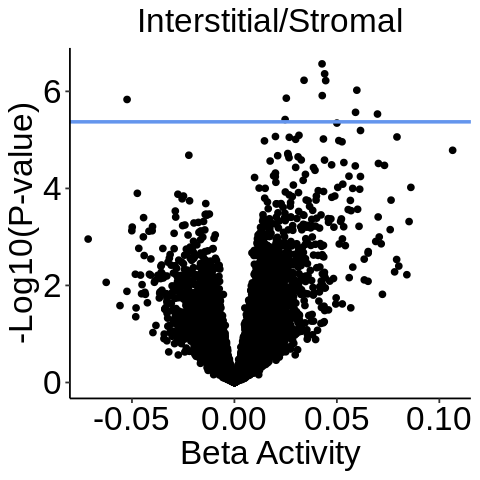

[1] "Distal Nephron"

FALSE  TRUE 
15804    98 

      FALSE        TRUE 
0.993837253 0.006162747 


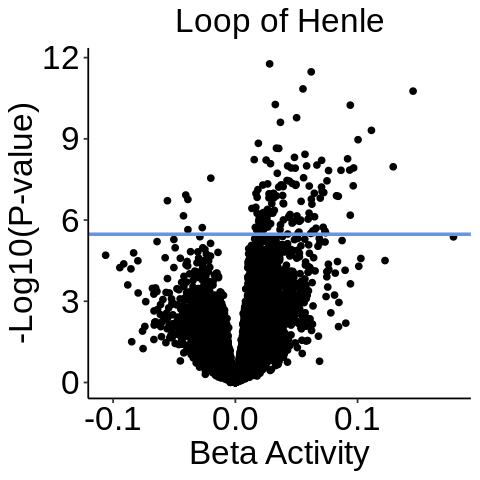

[1] "Proximal Tubule"

FALSE  TRUE 
14738    22 

      FALSE        TRUE 
0.998509485 0.001490515 


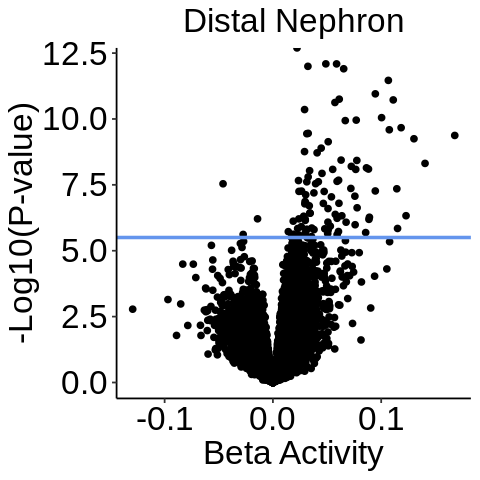

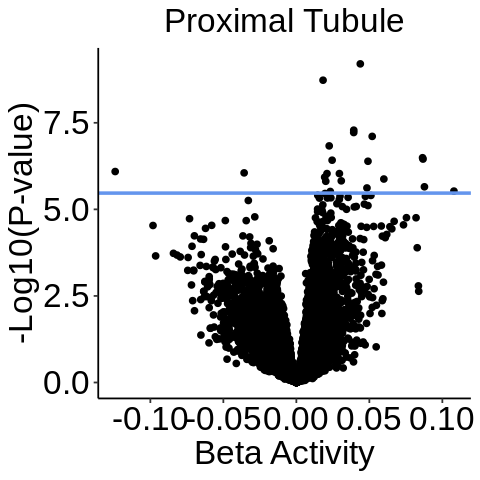

In [77]:
for (ctype in celltypes){
    res = res_list[[ctype]]
    
    print(ctype)
    print(table(res[['padj']]<0.05))
    print(prop.table(table(res[['padj']]<0.05)))

    fig.size(4, 4)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'cornflowerblue', linewidth = 1)+
        labs(x = 'Beta Activity', y = '-Log10(P-value)', title = ctype)
    print(p)
}

In [672]:
for (ctype in celltypes){
    print(ctype)
    print('Enriched')
   print(res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('Depleted')
    print(res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('')

}

[1] "T/NK"
[1] "Enriched"
[1] "SMC4"     "YPEL1"    "RRM1"     "SAE1"     "NEAT1"    "RAP1GDS1" "CARHSP1" 
[8] "HPS1"     "HMGB1"   
[1] "Depleted"
character(0)
[1] ""
[1] "B/Plasma"
[1] "Enriched"
[1] "IGKC"
[1] "Depleted"
[1] "IGHG1"
[1] ""
[1] "Myeloid"
[1] "Enriched"
 [1] "FN1"      "SPP1"     "SDC2"     "CYP27A1"  "APOC1"    "PHLDA1"  
 [7] "SLC39A8"  "GPNMB"    "ACP5"     "SDS"      "APOE"     "FABP5"   
[13] "OLR1"     "RAB13"    "EMP1"     "PLIN2"    "HTRA1"    "ELL2"    
[19] "VAT1"     "TREM2"    "AVPI1"    "LHFPL2"   "PPARG"    "CPM"     
[25] "OTOA"     "SLC26A11" "FAH"      "FAM20C"   "ST14"     "CTSD"    
[31] "PLA2G7"   "GCHFR"    "BCAT1"    "CD9"      "SDC4"     "TUBA1C"  
[37] "ALCAM"    "GPR183"   "MYO1E"    "TUBB6"    "IL1R1"    "NR1H3"   
[43] "CADM1"    "NCEH1"    "HAGHL"    "GM2A"     "TNS1"     "TEX2"    
[49] "CD276"    "SNTB1"   
[1] "Depleted"
 [1] "TPPP3"      "GNG11"      "HES1"       "AC064805.1" "LINC00877" 
 [6] "SYTL1"      "TSPAN32"    "TMEM154"    "TNF

In [34]:
genes_show = c('GPNMB', 'FABP5', 'APOC1', 'BATF3', 'SPP1', 'MMP14', 'CDH1',
               'FN1', 'TIMP1', 'C1QC', 'C1QB', 'TREM2', 'MFGE8', 'EPAS1', 
                'CD68'
               )

In [57]:
dat = res_all_wide %>% dplyr::select(starts_with('beta'))
dat = dat[genes_show, ]
genes_show = dat %>% rowMeans(na.rm =TRUE) %>% sort %>% rev %>% names
clus_order = (!is.na(dat[genes_show, ])) %>% colSums %>% sort %>% names %>% str_replace('beta_','')
dat = dat %>% rownames_to_column('feature') %>% pivot_longer(cols = -(feature), 
                                                names_to = 'cluster', values_to = 'beta')

dat$feature = factor(dat$feature, levels = genes_show)

dat = dat %>% mutate(cluster = str_replace(cluster, 'beta_', ''))
dat$cluster = factor(dat$cluster, levels = clus_order)

vmax = (abs(dat$beta) %>% quantile(.99, na.rm = TRUE))[[1]] %>% round(2)
vmin = -vmax

In [58]:
dat['label'] = ''

dat = merge(dat, res_all %>% dplyr::select(gene, celltype, padj), 
      by.x = c('feature', 'cluster'), 
      by.y = c('gene', 'celltype'), 
      all.x = TRUE)

dat = dat %>% mutate(label = if_else(padj < 0.05, '∗', label, missing = ''))

In [ ]:
dat %>% head(2)

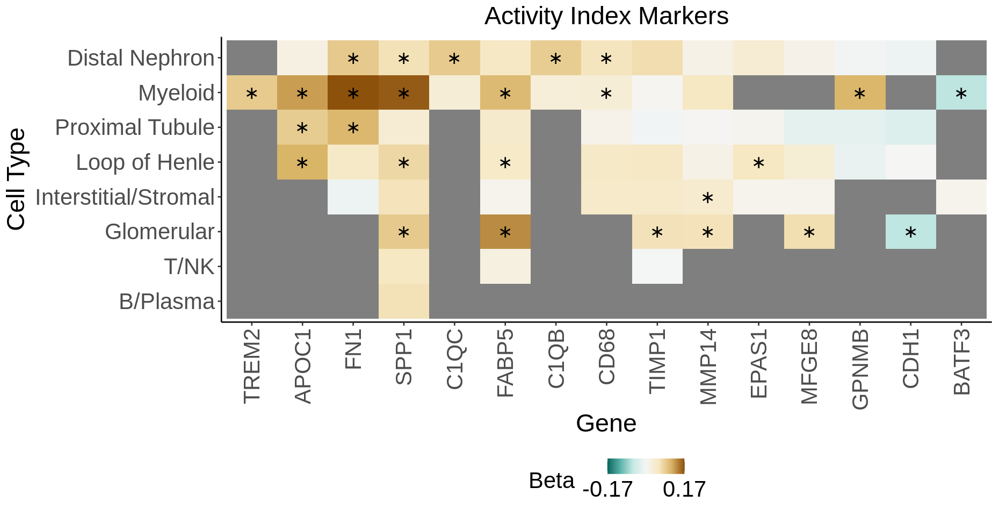

In [59]:
beta_heatmap = ggplot(dat, 
               aes(x = feature, y = cluster, 
                   fill = beta)) + 
    geom_tile() + 
    geom_text(aes(label = label), size = 7) +  # Add labels here
    theme_classic(base_size = tickfontsize) + 
    scale_fill_gradientn(colours=rev(brewer.pal(7,"BrBG")), limits=c(vmin, vmax), 
                             oob = scales::squish, breaks = c(vmin, vmax))+
    theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = .5),
          axis.text = element_text( size = labelfontsize+5),
          axis.title = element_text(size = labelfontsize+8), 
          plot.title = element_text(size = labelfontsize+8, hjust = 0.5), 
          legend.text = element_text(size = labelfontsize+5),
          legend.title = element_text(size = labelfontsize+5),
          legend.position = 'bottom'

         ) + 
    # geom_vline(xintercept = n + 0.5, linetype = 'dashed')+
    # geom_vline(xintercept = 2*n + 0.5, linetype = 'dashed')+
    labs(x = "Gene", y = "Cell Type", fill = 'Beta    ', title = 'Activity Index Markers')

height = 8
width = 15.5
fig.size(height, width)

outplot = beta_heatmap
outplot

# ggsave(paste0(figdir, 'de_gene_heatmap_activity.png'), plot = outplot,  
#        height = height, width = width, dpi = 500)
# ggsave(paste0(figdir, 'de_gene_heatmap_activity.pdf'), plot = outplot,  
#        height = height, width = width, dpi = 500, device = cairo_pdf)

In [79]:
for (ctype in c('Myeloid', 'Glomerular')){
    print(ctype)
    print('Enriched')
   print(res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(100) %>% rownames)
    print('Depleted')
    print(res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(100) %>% rownames)
    print('')

}

[1] "Myeloid"
[1] "Enriched"
  [1] "FN1"      "SPP1"     "SDC2"     "CYP27A1"  "APOC1"    "PHLDA1"  
  [7] "SLC39A8"  "GPNMB"    "ACP5"     "SDS"      "APOE"     "FABP5"   
 [13] "OLR1"     "RAB13"    "EMP1"     "PLIN2"    "HTRA1"    "ELL2"    
 [19] "VAT1"     "TREM2"    "AVPI1"    "LHFPL2"   "PPARG"    "CPM"     
 [25] "OTOA"     "SLC26A11" "FAH"      "FAM20C"   "ST14"     "CTSD"    
 [31] "PLA2G7"   "GCHFR"    "BCAT1"    "CD9"      "SDC4"     "TUBA1C"  
 [37] "ALCAM"    "GPR183"   "MYO1E"    "TUBB6"    "IL1R1"    "NR1H3"   
 [43] "CADM1"    "NCEH1"    "HAGHL"    "GM2A"     "TNS1"     "TEX2"    
 [49] "CD276"    "SNTB1"    "RPS6KA2"  "HMGB3"    "AQP9"     "RASGRP3" 
 [55] "EEPD1"    "ANKRD28"  "LDLRAD3"  "TMEM38B"  "LRFN4"    "MITF"    
 [61] "P2RY11"   "LMNA"     "CAPG"     "PLD3"     "ATP13A3"  "SLAMF8"  
 [67] "SMIM3"    "ENG"      "ANPEP"    "ANG"      "SOAT1"    "ANKRD9"  
 [73] "NRP2"     "MGST1"    "DGKH"     "PFKP"     "CD81"     "PDE4DIP" 
 [79] "TBC1D2"   "IFT122"   "VIM"  

In [81]:
genes_label = list()

In [109]:
genes_label[['Myeloid']] = c('FABP5', 'GPNMB', "FN1","SPP1", 'CD9', 'CD276', 
                            'APOC1', 'PLIN2', 'TREM2',
                            'CTSD', 'CTSB',
                             'TUBB6', 'VIM',
                             
                             
                             'CASP1', 'TNFRSF8', 'CLEC12A', 'ITGA4', 'TPPP3', 'CFP'
                            )

genes_label[['Glomerular']] = c('FABP5', 'FBN1', 'MFGE8', 'SPP1', 'STAT2', 'PLOD2', 'CD276', 'CTSB',
                               
                               
                                "FOLR1" ,     "TNNI1"  ,    "NPR3"   ,    "ITM2A" ,     "MMP28")


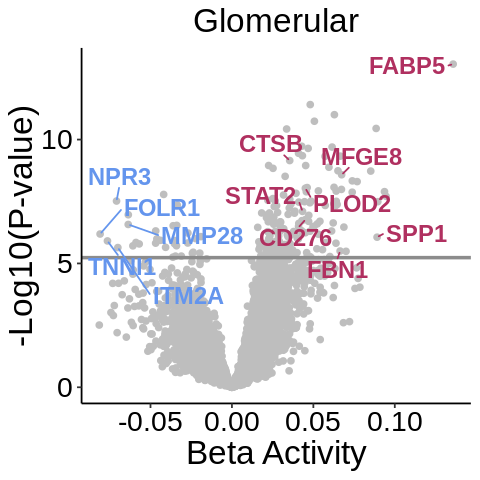

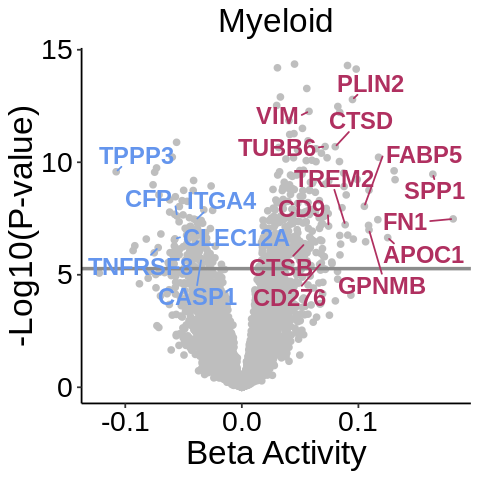

In [112]:
ps = list()
for (ctype in c('Glomerular', 'Myeloid')){
    res = res_list[[ctype]]
    res = res %>% mutate(label = NA)
    res[genes_label[[ctype]], 'label'] = genes_label[[ctype]]
    res =res %>% mutate(label_color = ifelse(!is.na(label), ifelse(beta > 0, 'maroon', 'cornflowerblue'), NA))
    
    min_p = res[res['p']!= 0, 'p'] %>% min # Replace zeros for visualization
    res = res %>% mutate(p = ifelse(p==0, min_p, p))
    
    set.seed(1)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)), color = 'grey')+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize-3, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize-3, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'gray55', linewidth = 1)+
        labs(x = 'Beta Activity', y = '-Log10(P-value)', title = ctype)+
        geom_text_repel(data = res %>% filter(label != 'NA'), 
                    aes(x = beta, y = -log10(p), label = label, color = label_color),
                   size = 5, fontface = "bold",
                   max.overlaps = Inf, force = 80, min.segment.length = 0)+
        scale_color_identity()  
        # geom_text_repel(data = res %>% filter(label != 'NA', beta < 0), aes(x = beta, y = -log10(p), label = label),
        #            color = 'cornflowerblue', size = 6, fontface = "bold",
        #            max.overlaps = Inf, force = 100, min.segment.length = 0)

    height = 4
    width = 4
    fig.size(height, width)
    outplot = p
    ps[[ctype]] = p
    
    print(outplot)

}


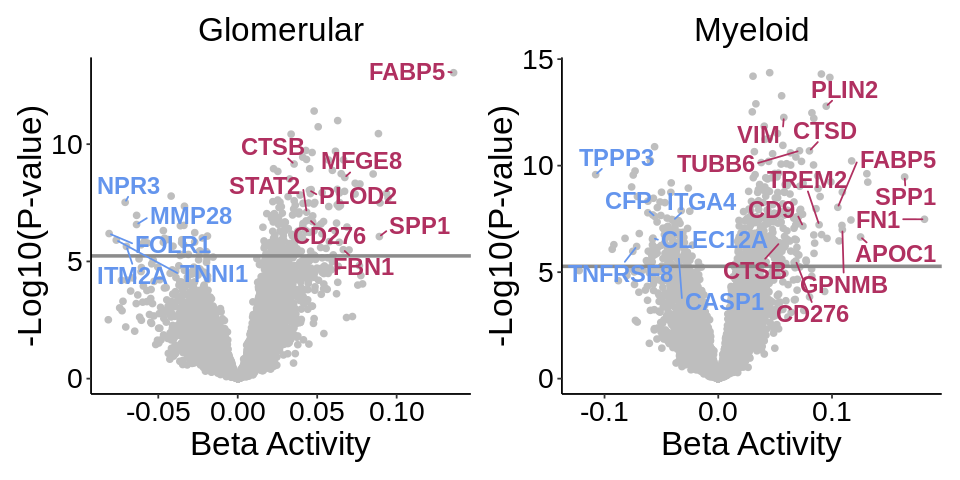

In [114]:
height = 4
width = 8
fig.size(height, width)
outplot = ps[['Glomerular']] + ps[['Myeloid']] + plot_layout(nrow = 1)
print(outplot)

ggsave(paste0(figdir, 'de_gene_volcano_activity.png'), plot = outplot,  
       height = height, width = width, dpi = 500, limitsize = FALSE)
ggsave(paste0(figdir, 'de_gene_volcano_activity.pdf'), plot = outplot,  
       height = height, width = width, dpi = 500, device = cairo_pdf, limitsize = FALSE)


# Blood vs tissue, by cell type

## Run differential expression

In [9]:
clinical = readRDS('/data/srlab/ssg34/SLE_kidney_v2/data/cna_new/clinical_data_05042023.rds') %>% 
                        rename(Final_Site = Site) %>% dplyr::select(-sample)

first_biop_pred <- readRDS("/data/srlab2/qxiao/AMP-SLE/data/clinical/df_pred_biop.rds")

clinical = merge(clinical, first_biop_pred, by.x = 'AMP.Subject_ID', by.y = 'Subject_ID')

### glm.nb

[1] 123

[1] 246  54

[1] 36601   246

[1] 6669

$breaks
 [1] 0.0 0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1.0

$counts
 [1] 228   2   6   3   0   0   2   3   1   1

$density
 [1] 9.26829268 0.08130081 0.24390244 0.12195122 0.00000000 0.00000000
 [7] 0.08130081 0.12195122 0.04065041 0.04065041

$mids
 [1] 0.05 0.15 0.25 0.35 0.45 0.55 0.65 0.75 0.85 0.95

$xname
[1] "colSums(pseudo_raw == 0)/length(genes)"

$equidist
[1] TRUE

attr(,"class")
[1] "histogram"
[1] 98


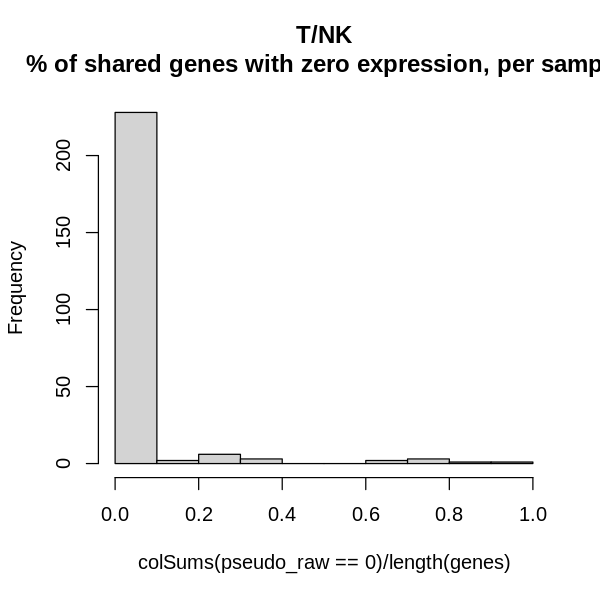

In [253]:

qcd_meta = readRDS(ctype_list[[ctype]][1])
qcd_raw = readRDS(ctype_list[[ctype]][2])
qcd_raw = qcd_raw[, qcd_meta$cell]
qcd_meta = qcd_meta %>% mutate(individual = str_replace(sample, 'AMPSLEkid_cells_', ''))
pseudo_raw = pseudobulk(qcd_raw, qcd_meta$individual)

qcd_pbmc = readRDS(ctype_list[[ctype]][5])
qcd_raw_pbmc = qcd_pbmc@assays$RNA@counts
qcd_meta_pbmc = readRDS(ctype_list[[ctype]][6])
qcd_raw_pbmc = qcd_raw_pbmc[, qcd_meta_pbmc$Cell]
pseudo_raw_pbmc = pseudobulk(qcd_raw_pbmc, qcd_meta_pbmc$individual)

sample_overlap = intersect(qcd_meta$individual, qcd_meta_pbmc$individual)
pseudo_raw = pseudo_raw[, sample_overlap]
pseudo_raw_pbmc = pseudo_raw_pbmc[, sample_overlap]

colnames(pseudo_raw) = paste0(colnames(pseudo_raw), '_tissue')
colnames(pseudo_raw_pbmc) = paste0(colnames(pseudo_raw_pbmc), '_blood')

sample_meta = clinical
sample_meta = sample_meta[sample_meta$individual %in% sample_overlap, ]

sample_meta = rbind(sample_meta %>% mutate(tissue = 'tissue', individual_tissue = paste0(individual, '_tissue')),
                    sample_meta %>% mutate(tissue = 'blood', individual_tissue = paste0(individual, '_blood')))

sample_meta = sample_meta %>% as.data.frame
rownames(sample_meta) = sample_meta$individual_tissue
sample_meta$individual = as.factor(sample_meta$individual)

joint_counts = cbind(pseudo_raw, pseudo_raw_pbmc)
sample_meta = sample_meta[colnames(joint_counts), ]

sample_overlap %>% length
sample_meta %>% dim
joint_counts %>% dim

pseudo_raw = joint_counts

site_dummies = sample_meta %>% dplyr::select(starts_with('Final_Site_')) %>% colnames

ncounts = colSums(pseudo_raw)
sample_meta$ncounts = ncounts

sample_meta_tissue = sample_meta[sample_meta$tissue=='tissue',]
sample_meta_blood = sample_meta[sample_meta$tissue=='blood',]

ndonor_thresh = round(nrow(sample_meta_tissue)*.9)
genes_tissue = rownames(pseudo_raw[, rownames(sample_meta_tissue)])[rowSums(
    pseudo_raw[, rownames(sample_meta_tissue)] >= genecount_thresh) > ndonor_thresh]

ndonor_thresh = round(nrow(sample_meta_blood)*.9)
genes_blood = rownames(pseudo_raw[, rownames(sample_meta_blood)])[rowSums(
    pseudo_raw[, rownames(sample_meta_blood)] >= genecount_thresh) > ndonor_thresh]

genes = intersect(genes_blood, genes_tissue)
genes %>% length

pseudo_raw = pseudo_raw[genes, ]


print(hist(colSums(pseudo_raw==0)/length(genes), main = paste0(ctype, '\n% of shared genes with zero expression, per sample')))

samples_filt = sample_meta[colSums(pseudo_raw==0)/length(genes) > 0, ]$individual
print(length(samples_filt))
sample_meta = sample_meta[!(sample_meta$individual %in% samples_filt), ]
pseudo_raw = pseudo_raw[, rownames(sample_meta)]

# pseudo_raw = pseudo_raw + pseudocount


In [60]:
gene = genes[[3]]

In [62]:
gene_expr = pseudo_raw[gene, ]

null_fm = as.formula(paste0(c('gene_expr ~ individual', 
                      ' + offset(log(ncounts))'), collapse = '') )
full_fm = as.formula(paste0(c('gene_expr ~ individual + tissue', 
                      ' + offset(log(ncounts))'), collapse = '') )


In [63]:
null = glm.nb(null_fm, data = sample_meta)
full = glm.nb(full_fm, data = sample_meta)

z =summary(full)$coefficients['tissuetissue', "z value"]
se = summary(full)$coefficients['tissuetissue', "Std. Error"]
b = summary(full)$coefficients['tissuetissue', "Estimate"] #full$coefficients[['TypeLN']]
pval = anova(full, null)[2, 'Pr(Chi)']
res = data.frame('gene' = gene, 'beta' = b, 'stderr' = se, 'z-score' = z, 'p' = pval)


In [68]:
sample_meta %>% head(2)

,AMP.Subject_ID,AMP.ID,Final_Site,Clinical.Response.at.12.weeks,Clinical.Response.at.26.weeks,Clinical.Response.at.52.weeks,Responder.Status,Type,Sex,Age,⋯,Final_ISN,Final_Chronicity,Final_Activity,Pred_freq,Pred_dose,Pred_use,First_biop,tissue,individual_tissue,ncounts
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,⋯,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<int>,<chr>,<chr>,<dbl>
0134_tissue,200-0134,200-0134-V0,Rochester,ND,NR,NR,NR,LN,Female,46,⋯,[III],6,4,1,1,0,0,tissue,0134_tissue,959711
0137_tissue,200-0137,200-0137-V0,Rochester,ND,NR,CR,CR,LN,Female,35,⋯,[III],3,5,1,1,1,0,tissue,0137_tissue,1257701


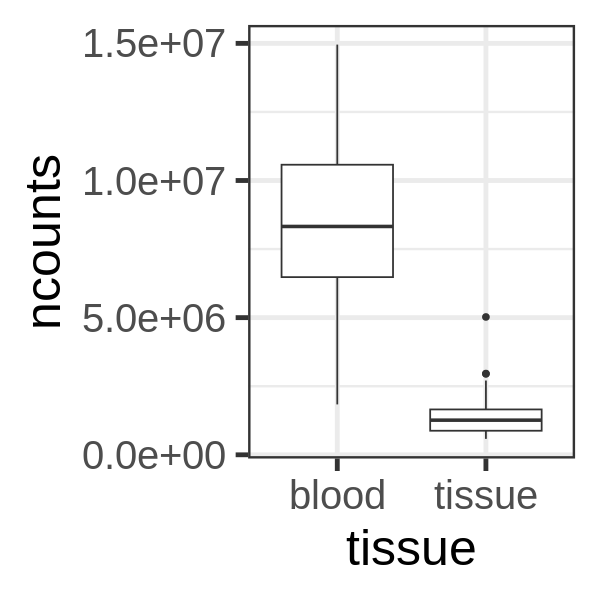

In [72]:
ggplot(sample_meta)+
    geom_boxplot(aes(x = tissue, y = ncounts))+
    theme_bw(base_size = 30)

In [255]:
qcd_meta_pbmc %>% dim
qcd_meta %>% dim

[1] 167507     28

[1] 37510    53

In [265]:
ncells = merge(data.frame(qcd_meta$individual %>% table), 
      data.frame(qcd_meta_pbmc$individual %>% table), by = '.')

colnames(ncells) = c('sample', 'tissue', 'pbmc')

ncells = ncells %>% pivot_longer(cols = c('tissue', 'pbmc'))

In [272]:
ncells

sample,name,value
<fct>,<chr>,<int>
0134,tissue,342
0134,pbmc,902
0137,tissue,322
0137,pbmc,1381
0138,tissue,40
0138,pbmc,3
0139,tissue,166
0139,pbmc,866
0140,tissue,20


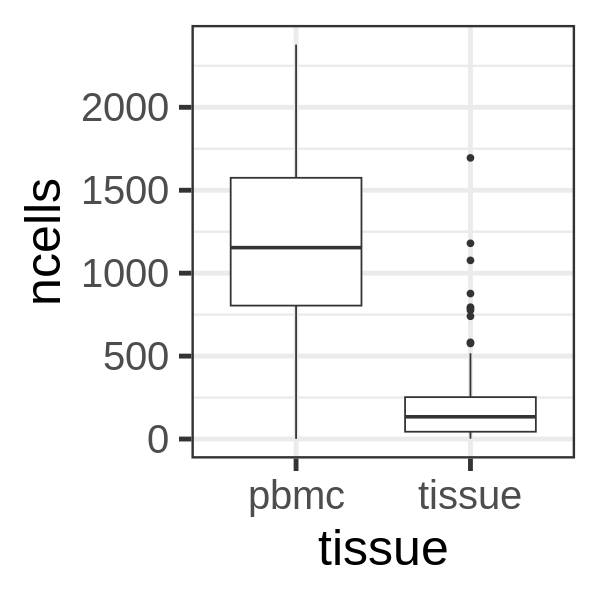

In [275]:
ggplot(ncells)+
    geom_boxplot(aes(x = name, y = value))+
    theme_bw(base_size = 30)+
    xlab('tissue')+
    ylab('ncells')

In [64]:
res

gene,beta,stderr,z.score,p
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
TNFRSF18,0.8825907,0.05652282,15.61477,0


In [53]:
res

gene,beta,stderr,z.score,p
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
TNFRSF18,0.8834641,0.05649871,15.63689,0


In [48]:
for (ctype in immune_ctypes) {
    print(ctype)

    qcd_meta = readRDS(ctype_list[[ctype]][1])
    qcd_raw = readRDS(ctype_list[[ctype]][2])
    qcd_raw = qcd_raw[, qcd_meta$cell]
    qcd_meta = qcd_meta %>% mutate(individual = str_replace(sample, 'AMPSLEkid_cells_', ''))
    pseudo_raw = pseudobulk(qcd_raw, qcd_meta$individual)

    qcd_pbmc = readRDS(ctype_list[[ctype]][5])
    qcd_raw_pbmc = qcd_pbmc@assays$RNA@counts
    qcd_meta_pbmc = readRDS(ctype_list[[ctype]][6])
    qcd_raw_pbmc = qcd_raw_pbmc[, qcd_meta_pbmc$Cell]
    pseudo_raw_pbmc = pseudobulk(qcd_raw_pbmc, qcd_meta_pbmc$individual)

    sample_overlap = intersect(qcd_meta$individual, qcd_meta_pbmc$individual)
    pseudo_raw = pseudo_raw[, sample_overlap]
    pseudo_raw_pbmc = pseudo_raw_pbmc[, sample_overlap]

    colnames(pseudo_raw) = paste0(colnames(pseudo_raw), '_tissue')
    colnames(pseudo_raw_pbmc) = paste0(colnames(pseudo_raw_pbmc), '_blood')

    sample_meta = clinical
    sample_meta = sample_meta[sample_meta$individual %in% sample_overlap, ]

    sample_meta = rbind(sample_meta %>% mutate(tissue = 'tissue', individual_tissue = paste0(individual, '_tissue')),
                        sample_meta %>% mutate(tissue = 'blood', individual_tissue = paste0(individual, '_blood')))

    sample_meta = sample_meta %>% as.data.frame
    rownames(sample_meta) = sample_meta$individual_tissue
    sample_meta$individual = as.factor(sample_meta$individual)

    joint_counts = cbind(pseudo_raw, pseudo_raw_pbmc)
    sample_meta = sample_meta[colnames(joint_counts), ]

    sample_overlap %>% length
    sample_meta %>% dim
    joint_counts %>% dim

    pseudo_raw = joint_counts

    site_dummies = sample_meta %>% dplyr::select(starts_with('Final_Site_')) %>% colnames

    ncounts = colSums(pseudo_raw)
    sample_meta$ncounts = ncounts

    sample_meta_tissue = sample_meta[sample_meta$tissue=='tissue',]
    sample_meta_blood = sample_meta[sample_meta$tissue=='blood',]

    ndonor_thresh = round(nrow(sample_meta_tissue)*.9)
    genes_tissue = rownames(pseudo_raw[, rownames(sample_meta_tissue)])[rowSums(
        pseudo_raw[, rownames(sample_meta_tissue)] >= genecount_thresh) > ndonor_thresh]

    ndonor_thresh = round(nrow(sample_meta_blood)*.9)
    genes_blood = rownames(pseudo_raw[, rownames(sample_meta_blood)])[rowSums(
        pseudo_raw[, rownames(sample_meta_blood)] >= genecount_thresh) > ndonor_thresh]

    genes = intersect(genes_blood, genes_tissue)
    genes %>% length

    pseudo_raw = pseudo_raw[genes, ]


    print(hist(colSums(pseudo_raw==0)/length(genes), main = paste0(ctype, '\n% of shared genes with zero expression, per sample')))

    samples_filt = sample_meta[colSums(pseudo_raw==0)/length(genes) > 0, ]$individual
    print(length(samples_filt))
    sample_meta = sample_meta[!(sample_meta$individual %in% samples_filt), ]
    pseudo_raw = pseudo_raw[, rownames(sample_meta)]

    pseudo_raw = pseudo_raw + pseudocount

    plan(multisession, workers = 20)

    system.time(
    suppressMessages({
    suppressWarnings({
        res_list = future_lapply(genes, future.seed = TRUE, function(gene){

            tryCatch({
        res = data.frame()

        gene_expr = pseudo_raw[gene, ]

        null_fm = as.formula(paste0(c('gene_expr ~ individual', 
                              ' + offset(log(ncounts))'), collapse = '') )
        full_fm = as.formula(paste0(c('gene_expr ~ individual + tissue', 
                              ' + offset(log(ncounts))'), collapse = '') )

        null = glm.nb(null_fm, data = sample_meta)
        full = glm.nb(full_fm, data = sample_meta)

        z =summary(full)$coefficients['tissuetissue', "z value"]
        se = summary(full)$coefficients['tissuetissue', "Std. Error"]
        b = summary(full)$coefficients['tissuetissue', "Estimate"] #full$coefficients[['TypeLN']]
        pval = anova(full, null)[2, 'Pr(Chi)']
        res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se, 'z-score' = z, 'p' = pval))       
        return(res)

        }, error = function(e) {
            message(paste("Error for gene:", gene))
            message("Error message:", e$message)
            return(NULL)  # Return NULL if there's an error to avoid stopping the loop
          })

        })})})
    )

    res = do.call("rbind", res_list)
    res['celltype'] = ctype
    res$padj = p.adjust(res$p, method = "bonferroni")

    name = ctype_list[[ctype]][3]
    saveRDS(res, paste0(outdir, name, '_tissue_differential_expression_20250421_pseudo_sitebio.rds'))
    flush.console()
    gc()

}

In [14]:
print('done')

[1] "done"


In [ ]:
# Run permutations

In [113]:
n_permutations = 10

[1] "T/NK"
$breaks
 [1] 0.0 0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1.0

$counts
 [1] 228   2   6   3   0   0   2   3   1   1

$density
 [1] 9.26829268 0.08130081 0.24390244 0.12195122 0.00000000 0.00000000
 [7] 0.08130081 0.12195122 0.04065041 0.04065041

$mids
 [1] 0.05 0.15 0.25 0.35 0.45 0.55 0.65 0.75 0.85 0.95

$xname
[1] "colSums(pseudo_raw == 0)/length(genes)"

$equidist
[1] TRUE

attr(,"class")
[1] "histogram"
[1] 98
[1] "B/Plasma"
$breaks
 [1] 0.00 0.05 0.10 0.15 0.20 0.25 0.30 0.35 0.40 0.45 0.50 0.55 0.60

$counts
 [1] 201   8   6   2   3   2   1   2   0   4   0   1

$density
 [1] 17.47826087  0.69565217  0.52173913  0.17391304  0.26086957  0.17391304
 [7]  0.08695652  0.17391304  0.00000000  0.34782609  0.00000000  0.08695652

$mids
 [1] 0.025 0.075 0.125 0.175 0.225 0.275 0.325 0.375 0.425 0.475 0.525 0.575

$xname
[1] "colSums(pseudo_raw == 0)/length(genes)"

$equidist
[1] TRUE

attr(,"class")
[1] "histogram"
[1] 51


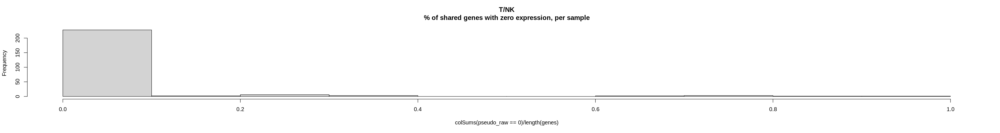

[1] "Myeloid"
$breaks
 [1] 0.0 0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1.0

$counts
 [1] 235   4   3   0   3   0   0   0   3   2

$density
 [1] 9.40 0.16 0.12 0.00 0.12 0.00 0.00 0.00 0.12 0.08

$mids
 [1] 0.05 0.15 0.25 0.35 0.45 0.55 0.65 0.75 0.85 0.95

$xname
[1] "colSums(pseudo_raw == 0)/length(genes)"

$equidist
[1] TRUE

attr(,"class")
[1] "histogram"
[1] 141


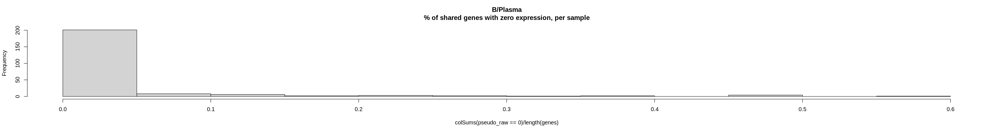

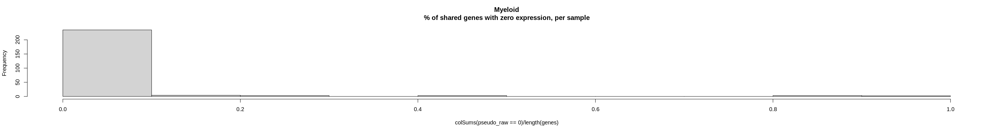

In [114]:
for (ctype in immune_ctypes) {
    print(ctype)

    qcd_meta = readRDS(ctype_list[[ctype]][1])
    qcd_raw = readRDS(ctype_list[[ctype]][2])
    qcd_raw = qcd_raw[, qcd_meta$cell]
    qcd_meta = qcd_meta %>% mutate(individual = str_replace(sample, 'AMPSLEkid_cells_', ''))
    pseudo_raw = pseudobulk(qcd_raw, qcd_meta$individual)

    qcd_pbmc = readRDS(ctype_list[[ctype]][5])
    qcd_raw_pbmc = qcd_pbmc@assays$RNA@counts
    qcd_meta_pbmc = readRDS(ctype_list[[ctype]][6])
    qcd_raw_pbmc = qcd_raw_pbmc[, qcd_meta_pbmc$Cell]
    pseudo_raw_pbmc = pseudobulk(qcd_raw_pbmc, qcd_meta_pbmc$individual)

    sample_overlap = intersect(qcd_meta$individual, qcd_meta_pbmc$individual)
    pseudo_raw = pseudo_raw[, sample_overlap]
    pseudo_raw_pbmc = pseudo_raw_pbmc[, sample_overlap]

    colnames(pseudo_raw) = paste0(colnames(pseudo_raw), '_tissue')
    colnames(pseudo_raw_pbmc) = paste0(colnames(pseudo_raw_pbmc), '_blood')

    sample_meta = clinical
    sample_meta = sample_meta[sample_meta$individual %in% sample_overlap, ]

    sample_meta = rbind(sample_meta %>% mutate(tissue = 'tissue', individual_tissue = paste0(individual, '_tissue')),
                        sample_meta %>% mutate(tissue = 'blood', individual_tissue = paste0(individual, '_blood')))

    sample_meta = sample_meta %>% as.data.frame
    rownames(sample_meta) = sample_meta$individual_tissue
    sample_meta$individual = as.factor(sample_meta$individual)

    joint_counts = cbind(pseudo_raw, pseudo_raw_pbmc)
    sample_meta = sample_meta[colnames(joint_counts), ]

    sample_overlap %>% length
    sample_meta %>% dim
    joint_counts %>% dim

    pseudo_raw = joint_counts

    site_dummies = sample_meta %>% dplyr::select(starts_with('Final_Site_')) %>% colnames

    ncounts = colSums(pseudo_raw)
    sample_meta$ncounts = ncounts

    sample_meta_tissue = sample_meta[sample_meta$tissue=='tissue',]
    sample_meta_blood = sample_meta[sample_meta$tissue=='blood',]

    ndonor_thresh = round(nrow(sample_meta_tissue)*.9)
    genes_tissue = rownames(pseudo_raw[, rownames(sample_meta_tissue)])[rowSums(
        pseudo_raw[, rownames(sample_meta_tissue)] >= genecount_thresh) > ndonor_thresh]

    ndonor_thresh = round(nrow(sample_meta_blood)*.9)
    genes_blood = rownames(pseudo_raw[, rownames(sample_meta_blood)])[rowSums(
        pseudo_raw[, rownames(sample_meta_blood)] >= genecount_thresh) > ndonor_thresh]

    genes = intersect(genes_blood, genes_tissue)
    genes %>% length

    pseudo_raw = pseudo_raw[genes, ]


    print(hist(colSums(pseudo_raw==0)/length(genes), main = paste0(ctype, '\n% of shared genes with zero expression, per sample')))

    samples_filt = sample_meta[colSums(pseudo_raw==0)/length(genes) > 0, ]$individual
    print(length(samples_filt))
    sample_meta = sample_meta[!(sample_meta$individual %in% samples_filt), ]
    pseudo_raw = pseudo_raw[, rownames(sample_meta)]

    pseudo_raw = pseudo_raw + pseudocount

    plan(multisession, workers = 20)

    system.time(
    suppressMessages({
    suppressWarnings({
        res_list = future_lapply(genes, future.seed = TRUE, function(gene){

            tryCatch({
        res = data.frame()

        gene_expr = pseudo_raw[gene, ]

        null_fm = as.formula(paste0(c('gene_expr ~ individual', 
                              ' + offset(log(ncounts))'), collapse = '') )
        full_fm = as.formula(paste0(c('gene_expr ~ individual + tissue', 
                              ' + offset(log(ncounts))'), collapse = '') )
        null = glm.nb(null_fm, data = sample_meta)
                
        
        for (i in range(1, n_permutations)){
            sample_meta_permuted = sample_meta
            sample_meta_permuted$tissue = sample_meta_permuted$tissue %>% sample
            full = glm.nb(full_fm, data = sample_meta_permuted)
            z =summary(full)$coefficients['tissuetissue', "z value"]
            se = summary(full)$coefficients['tissuetissue', "Std. Error"]
            b = summary(full)$coefficients['tissuetissue', "Estimate"] #full$coefficients[['TypeLN']]
            pval = anova(full, null)[2, 'Pr(Chi)']
            res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se, 'z-score' = z, 'p' = pval,
                                       'i' = i))       
       }
        return(res)

        }, error = function(e) {
            message(paste("Error for gene:", gene))
            message("Error message:", e$message)
            return(NULL)  # Return NULL if there's an error to avoid stopping the loop
          })

        })})})
    )

    res = do.call("rbind", res_list)
    res['celltype'] = ctype
    res$padj = p.adjust(res$p, method = "bonferroni")

    name = ctype_list[[ctype]][3]
    saveRDS(res, paste0(outdir, name, '_permuted_tissue_differential_expression_20250421_pseudo_sitebio.rds'))
    flush.console()
    gc()

}

In [111]:
res_list

gene,beta,stderr,z.score,p,i
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
NOC2L,0.04195804,0.03201242,1.310680,0.1900501,1
NOC2L,-0.02060383,0.03153190,-0.653428,0.5134646,2
gene,beta,stderr,z.score,p,i
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ISG15,0.2856135,0.09392684,3.040808,0.005296665,1
ISG15,-0.1503306,0.09761720,-1.540002,0.131742944,2


In [112]:
res

gene,beta,stderr,z.score,p,i,celltype,padj
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>
NOC2L,0.04195804,0.03201242,1.310680,0.190050139,1,T/NK,0.76020056
NOC2L,-0.02060383,0.03153190,-0.653428,0.513464608,2,T/NK,1.00000000
ISG15,0.28561345,0.09392684,3.040808,0.005296665,1,T/NK,0.02118666
ISG15,-0.15033065,0.09761720,-1.540002,0.131742944,2,T/NK,0.52697178


### lm

$breaks
 [1] 0.00 0.05 0.10 0.15 0.20 0.25 0.30 0.35 0.40 0.45 0.50 0.55 0.60

$counts
 [1] 201   8   6   2   3   2   1   2   0   4   0   1

$density
 [1] 17.47826087  0.69565217  0.52173913  0.17391304  0.26086957  0.17391304
 [7]  0.08695652  0.17391304  0.00000000  0.34782609  0.00000000  0.08695652

$mids
 [1] 0.025 0.075 0.125 0.175 0.225 0.275 0.325 0.375 0.425 0.475 0.525 0.575

$xname
[1] "colSums(pseudo_raw == 0)/length(genes)"

$equidist
[1] TRUE

attr(,"class")
[1] "histogram"
[1] 51
$breaks
 [1] 0.0 0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1.0

$counts
 [1] 235   4   3   0   3   0   0   0   3   2

$density
 [1] 9.40 0.16 0.12 0.00 0.12 0.00 0.00 0.00 0.12 0.08

$mids
 [1] 0.05 0.15 0.25 0.35 0.45 0.55 0.65 0.75 0.85 0.95

$xname
[1] "colSums(pseudo_raw == 0)/length(genes)"

$equidist
[1] TRUE

attr(,"class")
[1] "histogram"
[1] 141


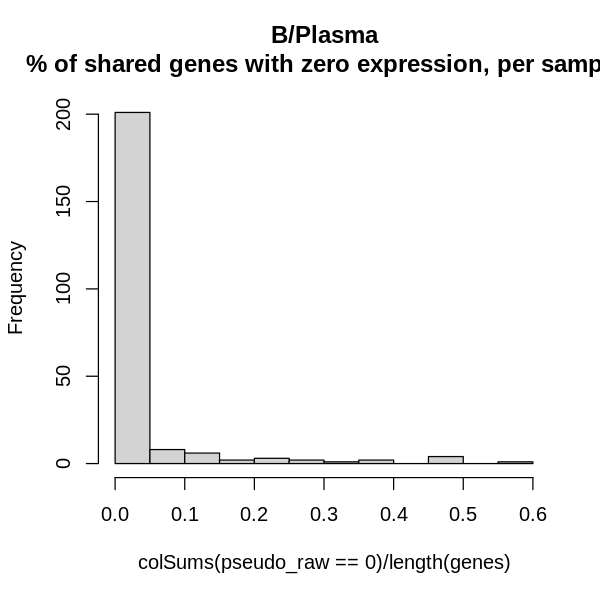

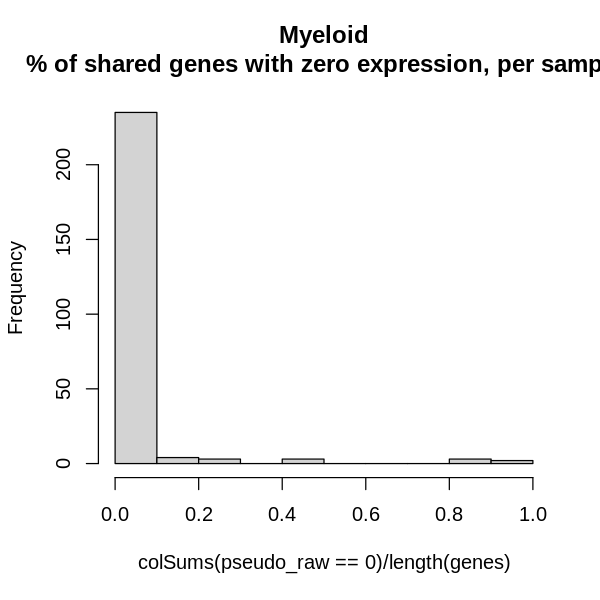

In [245]:
for (ctype in immune_ctypes) {
    
    qcd_meta = readRDS(ctype_list[[ctype]][1])
    qcd_raw = readRDS(ctype_list[[ctype]][2])
    qcd_raw = qcd_raw[, qcd_meta$cell]
    qcd_meta = qcd_meta %>% mutate(individual = str_replace(sample, 'AMPSLEkid_cells_', ''))
    pseudo_raw = pseudobulk(qcd_raw, qcd_meta$individual)

    qcd_pbmc = readRDS(ctype_list[[ctype]][5])
    qcd_raw_pbmc = qcd_pbmc@assays$RNA@counts
    qcd_meta_pbmc = readRDS(ctype_list[[ctype]][6])
    qcd_raw_pbmc = qcd_raw_pbmc[, qcd_meta_pbmc$Cell]
    pseudo_raw_pbmc = pseudobulk(qcd_raw_pbmc, qcd_meta_pbmc$individual)

    sample_overlap = intersect(qcd_meta$individual, qcd_meta_pbmc$individual)
    pseudo_raw = pseudo_raw[, sample_overlap]
    pseudo_raw_pbmc = pseudo_raw_pbmc[, sample_overlap]

    colnames(pseudo_raw) = paste0(colnames(pseudo_raw), '_tissue')
    colnames(pseudo_raw_pbmc) = paste0(colnames(pseudo_raw_pbmc), '_blood')

    genes_overlap = sort(intersect(rownames(pseudo_raw), rownames(pseudo_raw_pbmc)))
    pseudo_raw = cbind(pseudo_raw[genes_overlap, ], pseudo_raw_pbmc[genes_overlap, ])                

    sample_meta = clinical
    sample_meta = sample_meta[sample_meta$individual %in% sample_overlap, ]

    sample_meta = rbind(sample_meta %>% mutate(tissue = 'tissue', individual_tissue = paste0(individual, '_tissue')),
                        sample_meta %>% mutate(tissue = 'blood', individual_tissue = paste0(individual, '_blood')))

    sample_meta = sample_meta %>% as.data.frame
    rownames(sample_meta) = sample_meta$individual_tissue
    sample_meta$individual = as.factor(sample_meta$individual)
    sample_meta = sample_meta[colnames(pseudo_raw), ]

    sample_overlap %>% length
    sample_meta %>% dim
    joint_counts %>% dim

    # log TPM norm         
    a = 1e6
    pseudo_tpm = t(t(pseudo_raw) / colSums(pseudo_raw)) * a
    pseudo_log = log10(pseudo_tpm + 1)

    sample_meta_tissue = sample_meta[sample_meta$tissue=='tissue',]
    sample_meta_blood = sample_meta[sample_meta$tissue=='blood',]

    ndonor_thresh = round(nrow(sample_meta_tissue)*.9)
    genes_tissue = rownames(pseudo_raw[, rownames(sample_meta_tissue)])[rowSums(
        pseudo_raw[, rownames(sample_meta_tissue)] >= genecount_thresh) > ndonor_thresh]

    ndonor_thresh = round(nrow(sample_meta_blood)*.9)
    genes_blood = rownames(pseudo_raw[, rownames(sample_meta_blood)])[rowSums(
        pseudo_raw[, rownames(sample_meta_blood)] >= genecount_thresh) > ndonor_thresh]

    genes = intersect(genes_blood, genes_tissue)
    genes %>% length

    pseudo_raw = pseudo_raw[genes, ]
    pseudo_log = pseudo_log[genes, ]


    print(hist(colSums(pseudo_raw==0)/length(genes), main = paste0(ctype, '\n% of shared genes with zero expression, per sample')))

    samples_filt = sample_meta[colSums(pseudo_raw==0)/length(genes) > 0, ]$individual
    print(length(samples_filt))
    sample_meta = sample_meta[!(sample_meta$individual %in% samples_filt), ]
    pseudo_log = pseudo_log[, rownames(sample_meta)]


    plan(multisession, workers = 20)

    system.time(
    suppressMessages({
    suppressWarnings({
        res_list = future_lapply(genes, future.seed = TRUE, function(gene){

            tryCatch({
            res = data.frame()

            gene_expr = pseudo_log[gene, ]

            null_fm = as.formula(paste0(c('gene_expr ~ individual'), collapse = '') )
            full_fm = as.formula(paste0(c('gene_expr ~ individual + tissue'), collapse = '') )

            null = lm(null_fm, data = sample_meta)
            full = lm(full_fm, data = sample_meta)

            t =summary(full)$coefficients['tissuetissue', "t value"]
            se = summary(full)$coefficients['tissuetissue', "Std. Error"]
            b = summary(full)$coefficients['tissuetissue', "Estimate"] #full$coefficients[['TypeLN']]
            pval = anova(full, null)[2, 'Pr(>F)']
            res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se,  't'= t, 'p' = pval))
        return(res)

        }, error = function(e) {
            message(paste("Error for gene:", gene))
            message("Error message:", e$message)
            return(NULL)  # Return NULL if there's an error to avoid stopping the loop
          })

        })})})
    )

    res = do.call("rbind", res_list)
    res['celltype'] = ctype
    res$padj = p.adjust(res$p, method = "bonferroni")

    name = ctype_list[[ctype]][3]
    saveRDS(res, paste0(outdir, name, '_tissue_differential_expression_lm_20250430_pseudo_sitebio.rds'))
    flush.console()
    gc()
}


In [236]:
n_permutations = 5

$breaks
 [1] 0.00 0.05 0.10 0.15 0.20 0.25 0.30 0.35 0.40 0.45 0.50 0.55 0.60

$counts
 [1] 201   8   6   2   3   2   1   2   0   4   0   1

$density
 [1] 17.47826087  0.69565217  0.52173913  0.17391304  0.26086957  0.17391304
 [7]  0.08695652  0.17391304  0.00000000  0.34782609  0.00000000  0.08695652

$mids
 [1] 0.025 0.075 0.125 0.175 0.225 0.275 0.325 0.375 0.425 0.475 0.525 0.575

$xname
[1] "colSums(pseudo_raw == 0)/length(genes)"

$equidist
[1] TRUE

attr(,"class")
[1] "histogram"
[1] 51
$breaks
 [1] 0.0 0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1.0

$counts
 [1] 235   4   3   0   3   0   0   0   3   2

$density
 [1] 9.40 0.16 0.12 0.00 0.12 0.00 0.00 0.00 0.12 0.08

$mids
 [1] 0.05 0.15 0.25 0.35 0.45 0.55 0.65 0.75 0.85 0.95

$xname
[1] "colSums(pseudo_raw == 0)/length(genes)"

$equidist
[1] TRUE

attr(,"class")
[1] "histogram"
[1] 141


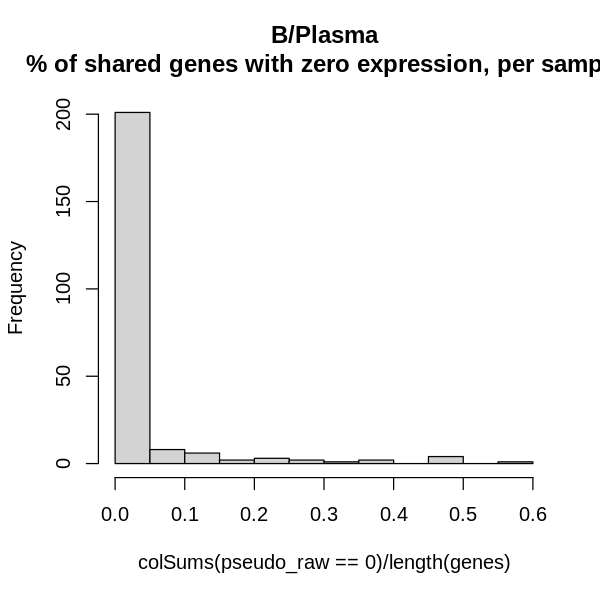

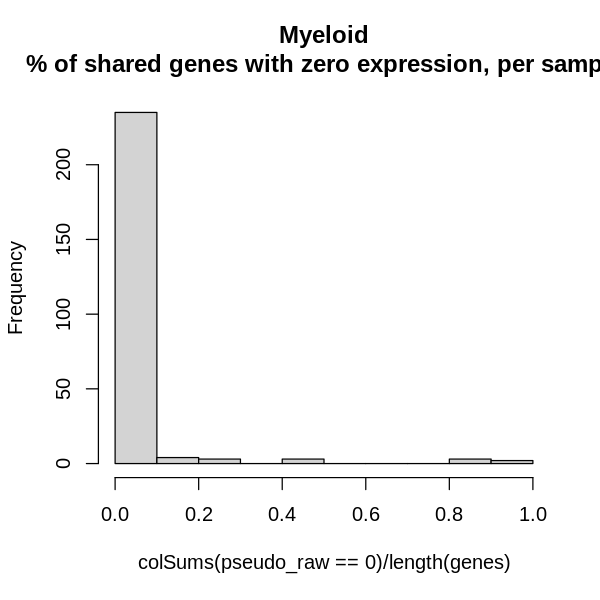

In [246]:
for (ctype in immune_ctypes[2:3]) {

    qcd_meta = readRDS(ctype_list[[ctype]][1])
    qcd_raw = readRDS(ctype_list[[ctype]][2])
    qcd_raw = qcd_raw[, qcd_meta$cell]
    qcd_meta = qcd_meta %>% mutate(individual = str_replace(sample, 'AMPSLEkid_cells_', ''))
    pseudo_raw = pseudobulk(qcd_raw, qcd_meta$individual)

    qcd_pbmc = readRDS(ctype_list[[ctype]][5])
    qcd_raw_pbmc = qcd_pbmc@assays$RNA@counts
    qcd_meta_pbmc = readRDS(ctype_list[[ctype]][6])
    qcd_raw_pbmc = qcd_raw_pbmc[, qcd_meta_pbmc$Cell]
    pseudo_raw_pbmc = pseudobulk(qcd_raw_pbmc, qcd_meta_pbmc$individual)

    sample_overlap = intersect(qcd_meta$individual, qcd_meta_pbmc$individual)
    pseudo_raw = pseudo_raw[, sample_overlap]
    pseudo_raw_pbmc = pseudo_raw_pbmc[, sample_overlap]

    colnames(pseudo_raw) = paste0(colnames(pseudo_raw), '_tissue')
    colnames(pseudo_raw_pbmc) = paste0(colnames(pseudo_raw_pbmc), '_blood')

    genes_overlap = sort(intersect(rownames(pseudo_raw), rownames(pseudo_raw_pbmc)))
    pseudo_raw = cbind(pseudo_raw[genes_overlap, ], pseudo_raw_pbmc[genes_overlap, ])                

    sample_meta = clinical
    sample_meta = sample_meta[sample_meta$individual %in% sample_overlap, ]

    sample_meta = rbind(sample_meta %>% mutate(tissue = 'tissue', individual_tissue = paste0(individual, '_tissue')),
                        sample_meta %>% mutate(tissue = 'blood', individual_tissue = paste0(individual, '_blood')))

    sample_meta = sample_meta %>% as.data.frame
    rownames(sample_meta) = sample_meta$individual_tissue
    sample_meta$individual = as.factor(sample_meta$individual)
    sample_meta = sample_meta[colnames(pseudo_raw), ]

    sample_overlap %>% length
    sample_meta %>% dim
    joint_counts %>% dim


    # log TPM norm         
    a = 1e6
    pseudo_tpm = t(t(pseudo_raw) / colSums(pseudo_raw)) * a
    pseudo_log = log10(pseudo_tpm + 1)

    sample_meta_tissue = sample_meta[sample_meta$tissue=='tissue',]
    sample_meta_blood = sample_meta[sample_meta$tissue=='blood',]

    ndonor_thresh = round(nrow(sample_meta_tissue)*.9)
    genes_tissue = rownames(pseudo_raw[, rownames(sample_meta_tissue)])[rowSums(
        pseudo_raw[, rownames(sample_meta_tissue)] >= genecount_thresh) > ndonor_thresh]

    ndonor_thresh = round(nrow(sample_meta_blood)*.9)
    genes_blood = rownames(pseudo_raw[, rownames(sample_meta_blood)])[rowSums(
        pseudo_raw[, rownames(sample_meta_blood)] >= genecount_thresh) > ndonor_thresh]

    genes = intersect(genes_blood, genes_tissue)
    genes %>% length

    pseudo_raw = pseudo_raw[genes, ]
    pseudo_log = pseudo_log[genes, ]


    print(hist(colSums(pseudo_raw==0)/length(genes), main = paste0(ctype, '\n% of shared genes with zero expression, per sample')))

    samples_filt = sample_meta[colSums(pseudo_raw==0)/length(genes) > 0, ]$individual
    print(length(samples_filt))
    sample_meta = sample_meta[!(sample_meta$individual %in% samples_filt), ]
    pseudo_log = pseudo_log[, rownames(sample_meta)]


    plan(multisession, workers = 20)

    system.time(
    suppressMessages({
    suppressWarnings({
        res_list = future_lapply(genes, future.seed = TRUE, function(gene){

            tryCatch({
            res = data.frame()

            gene_expr = pseudo_log[gene, ]

            null_fm = as.formula(paste0(c('gene_expr ~ individual'), collapse = '') )
            full_fm = as.formula(paste0(c('gene_expr ~ individual + tissue'), collapse = '') )

            null = lm(null_fm, data = sample_meta)


            for (i in seq(1, n_permutations)){
                sample_meta_permuted = sample_meta
                sample_meta_permuted$tissue = sample_meta_permuted$tissue %>% sample
                full = lm(full_fm, data = sample_meta_permuted)
                t =summary(full)$coefficients['tissuetissue', "t value"]
                se = summary(full)$coefficients['tissuetissue', "Std. Error"]
                b = summary(full)$coefficients['tissuetissue', "Estimate"] #full$coefficients[['TypeLN']]
                pval = anova(full, null)[2, 'Pr(>F)']
                res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se,  't'= t, 'p' = pval))
               }
        return(res)

        }, error = function(e) {
            message(paste("Error for gene:", gene))
            message("Error message:", e$message)
            return(NULL)  # Return NULL if there's an error to avoid stopping the loop
          })

        })})})
    )

    res = do.call("rbind", res_list)
    res['celltype'] = ctype
    res$padj = p.adjust(res$p, method = "bonferroni")

    name = ctype_list[[ctype]][3]
    saveRDS(res, paste0(outdir, name, '_permuted_tissue_differential_expression_lm_20250430_pseudo_sitebio.rds'))
    flush.console()
    gc()
}

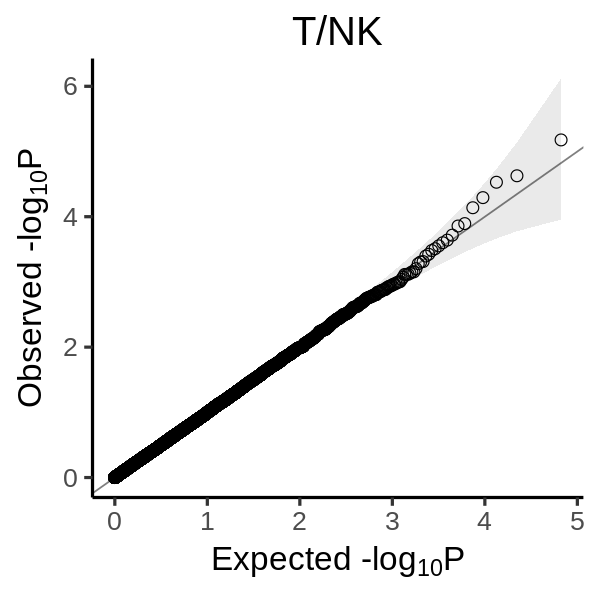

In [243]:
ps = res$p
gg_qqplot(ps)+
    theme_classic(base_size = 20)+
    theme(plot.title = element_text(hjust = 0.5))+
    ggtitle(paste0(ctype))


## Load results

### glm.nb

In [37]:
res_list = list()
res_all = data.frame()

for (ctype in immune_ctypes){
    
    name = ctype_list[[ctype]][3]
    de_fn = paste0(outdir, name, '_tissue_differential_expression_20250421_pseudo_sitebio.rds')
    res = readRDS(de_fn)
    print(res$gene %>% unique %>% length)
    
    res_all = rbind(res_all, res)
    res_list[[ctype]] = res
    rownames(res_list[[ctype]]) = res$gene
}

[1] 6669
[1] 797
[1] 8822


In [13]:
res_list_permuted = list()
res_all_permuted = data.frame()

for (ctype in immune_ctypes){
    
    name = ctype_list[[ctype]][3]
    de_fn = paste0(outdir, name, '_permuted_tissue_differential_expression_20250421_pseudo_sitebio.rds')
    res = readRDS(de_fn)
    print(res$gene %>% unique %>% length)
    
    res_all_permuted = rbind(res_all_permuted, res)
    res_list_permuted[[ctype]] = res
    # rownames(res_list_permuted[[ctype]]) = res$gene
}

[1] 6665
[1] 794
[1] 8814


In [242]:
immune_ctypes

[1] "T/NK"     "B/Plasma" "Myeloid"

In [18]:
ctype = 'T/NK'
print(ctype)
res_list[[ctype]] %>% filter(padj < 0.05) %>% arrange(desc(beta))

[1] "T/NK"


,gene,beta,stderr,z.score,p,celltype,padj
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>
FOSB,FOSB,3.911211,0.08913664,43.87883,0,T/NK,0
FXYD2,FXYD2,3.590688,0.12361488,29.04738,0,T/NK,0
ATP1B1,ATP1B1,3.132861,0.08691628,36.04459,0,T/NK,0
TNF,TNF,2.937478,0.07567455,38.81725,0,T/NK,0
MT-ATP8,MT-ATP8,2.884837,0.08277013,34.85361,0,T/NK,0
JUN,JUN,2.724379,0.11422600,23.85078,0,T/NK,0
MZF1-AS1,MZF1-AS1,2.690215,0.05805007,46.34300,0,T/NK,0
CLU,CLU,2.545682,0.09031025,28.18818,0,T/NK,0
CKB,CKB,2.543876,0.07226785,35.20065,0,T/NK,0


In [19]:
ctype = 'B/Plasma'
print(ctype)
res_list[[ctype]] %>% filter(padj < 0.05) %>% arrange(desc(beta))

[1] "B/Plasma"


,gene,beta,stderr,z.score,p,celltype,padj
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>
IGHG1,IGHG1,4.6934053,0.08870341,52.91121,0,B/Plasma,0
IGHG3,IGHG3,4.5476402,0.10781304,42.18080,0,B/Plasma,0
IGKC,IGKC,3.4208127,0.06697846,51.07332,0,B/Plasma,0
XBP1,XBP1,3.3159506,0.05140393,64.50772,0,B/Plasma,0
IGLC2,IGLC2,3.2081189,0.10067099,31.86736,0,B/Plasma,0
MZB1,MZB1,2.7677042,0.05315479,52.06877,0,B/Plasma,0
FOSB,FOSB,2.7244441,0.09028575,30.17579,0,B/Plasma,0
SSR4,SSR4,2.1371626,0.04430602,48.23639,0,B/Plasma,0
MT-ATP8,MT-ATP8,1.9472080,0.06464719,30.12053,0,B/Plasma,0


In [20]:
ctype = 'Myeloid'
print(ctype)
res_list[[ctype]] %>% filter(padj < 0.05) %>% arrange(desc(beta))

[1] "Myeloid"


,gene,beta,stderr,z.score,p,celltype,padj
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>
APOC1,APOC1,7.329722,0.17472699,41.94957,0,Myeloid,0
GPNMB,GPNMB,5.007932,0.15311505,32.70698,0,Myeloid,0
GPX3,GPX3,4.591730,0.14723924,31.18550,0,Myeloid,0
PLTP,PLTP,4.560961,0.06808157,66.99259,0,Myeloid,0
FXYD2,FXYD2,4.460085,0.10601838,42.06897,0,Myeloid,0
FN1,FN1,4.307216,0.23550728,18.28910,0,Myeloid,0
C1QC,C1QC,4.186210,0.10889449,38.44281,0,Myeloid,0
OLR1,OLR1,3.965738,0.17515663,22.64110,0,Myeloid,0
FCGBP,FCGBP,3.705531,0.20199274,18.34487,0,Myeloid,0


In [21]:
for (ctype in immune_ctypes){
   print(res_list[[ctype]] %>% filter(padj < 0.05) %>% arrange(desc(beta)))
}

                     gene        beta      stderr    z.score            p
FOSB                 FOSB  3.91121117 0.089136643  43.878825 0.000000e+00
FXYD2               FXYD2  3.59068801 0.123614878  29.047377 0.000000e+00
ATP1B1             ATP1B1  3.13286117 0.086916277  36.044585 0.000000e+00
TNF                   TNF  2.93747826 0.075674554  38.817252 0.000000e+00
MT-ATP8           MT-ATP8  2.88483741 0.082770126  34.853607 0.000000e+00
JUN                   JUN  2.72437930 0.114226003  23.850780 0.000000e+00
MZF1-AS1         MZF1-AS1  2.69021479 0.058050073  46.343005 0.000000e+00
CLU                   CLU  2.54568156 0.090310249  28.188180 0.000000e+00
CKB                   CKB  2.54387553 0.072267850  35.200653 0.000000e+00
HSPA1B             HSPA1B  2.44904523 0.070469654  34.753190 0.000000e+00
MT-ND4L           MT-ND4L  2.24289450 0.073344119  30.580427 0.000000e+00
SRGAP3             SRGAP3  2.19715920 0.103866096  21.153767 0.000000e+00
FOS                   FOS  2.09840183 

### lm

In [23]:
res_list = list()
res_all = data.frame()

for (ctype in immune_ctypes){
    
    name = ctype_list[[ctype]][3]
    de_fn = paste0(outdir, name, '_tissue_differential_expression_lm_20250430_pseudo_sitebio.rds')
    res = readRDS(de_fn)
    print(res$gene %>% unique %>% length)
    
    res_all = rbind(res_all, res)
    res_list[[ctype]] = res
    rownames(res_list[[ctype]]) = res$gene
}

[1] 6669
[1] 797
[1] 8822


In [24]:
name = 'Tissue vs Blood'
export_res[[name]] = res_all %>% mutate(variable = 'tissue vs blood')

In [12]:
res_list_permuted = list()
res_all_permuted = data.frame()

for (ctype in immune_ctypes){
    
    name = ctype_list[[ctype]][3]
    de_fn = paste0(outdir, name, '_permuted_tissue_differential_expression_lm_20250430_pseudo_sitebio.rds')
    res = readRDS(de_fn)
    print(res$gene %>% unique %>% length)
    
    res_all_permuted = rbind(res_all_permuted, res)
    res_list_permuted[[ctype]] = res
    # rownames(res_list_permuted[[ctype]]) = res$gene
}

[1] 6669
[1] 797
[1] 8822


In [10]:
res_all_wide = res_all %>% pivot_wider(id_cols = gene, names_from = celltype, values_from = c(beta,stderr, t, p, padj)) %>% as.data.frame
rownames(res_all_wide) = res_all_wide$gene

In [ ]:
for (ctype in immune_ctypes){
    print(ctype)
   print(res_list[[ctype]] %>% filter(padj < 0.05) %>% arrange(desc(beta)))
}

## Visualize results

### glm.nb

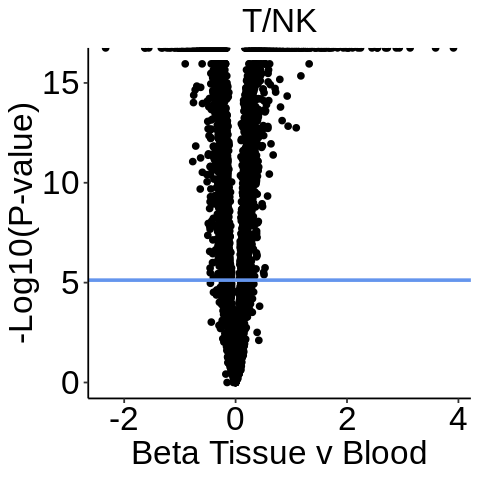

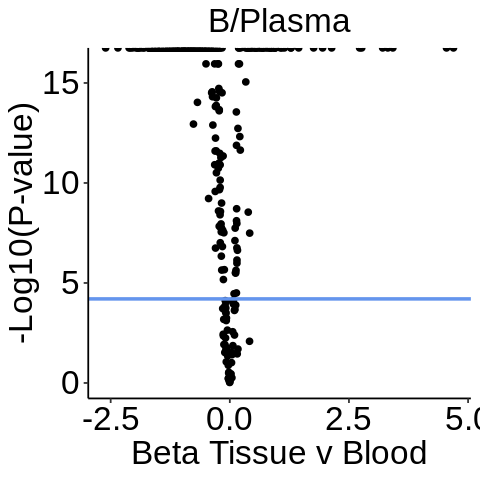

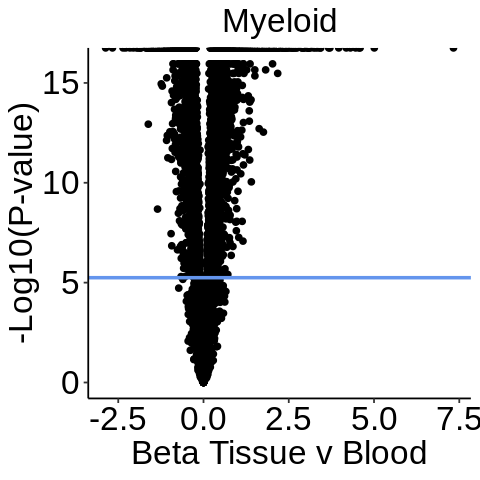

In [22]:
for (ctype in immune_ctypes){
    res = res_list[[ctype]]
        
    fig.size(4, 4)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'cornflowerblue', linewidth = 1)+
        labs(x = 'Beta Tissue v Blood', y = '-Log10(P-value)', title = ctype)
    print(p)
}

In [25]:
dat = res_all %>% filter(padj < 0.05)

In [42]:
genes_up = (dat %>% filter(beta > 0))$gene %>% table
genes_up = genes_up[genes_up == length(immune_ctypes)]  %>% names

In [43]:
genes_down = (dat %>% filter(beta < 0))$gene %>% table
genes_down = genes_down[genes_down == length(immune_ctypes)]  %>% names

In [ ]:
genes_up

genes_down

In [45]:
genes_up = (res_all %>% filter(beta > 0))$gene %>% table
genes_up = genes_up[genes_up == length(immune_ctypes)]  %>% names

genes_up = (res_all %>% filter(gene %in% genes_up, padj < 0.05))$gene %>% unique

In [55]:
genes_down = (res_all %>% filter(beta < 0))$gene %>% table
genes_down = genes_down[genes_down == length(immune_ctypes)]  %>% names

genes_down = (res_all %>% filter(gene %in% genes_down, padj < 0.05))$gene %>% unique

In [56]:
genes_up %>% length
genes_down  %>% length

[1] 67

[1] 274

In [57]:
genes_show = c(genes_up, genes_down)

In [59]:
dat = res_all %>% filter(gene %in% genes_show)

In [69]:
dat$gene = factor(dat$gene, levels = genes_show)

In [87]:
vmax = (abs(dat$beta) %>% quantile(.99))[[1]] %>% round(1)

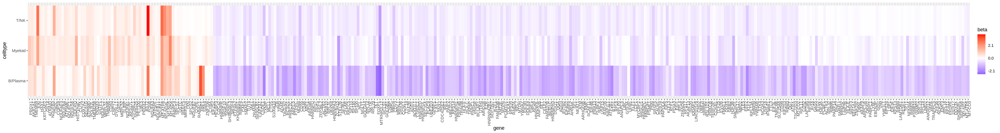

In [89]:
fig.size(4, 30)
ggplot(dat) + 
    geom_tile(aes(x = gene, y = celltype, fill = beta))+
    scale_fill_gradient2(low = 'blue', mid = 'white', high = 'red', na.value = 'lightgray',
                        breaks = c(-vmax, 0, vmax), oob = scales::squish)+
    theme(axis.text.x = element_text(angle = 90, hjust = 1))

    # scale_fill_viridis(option = 'plasma', na.value = 'white')

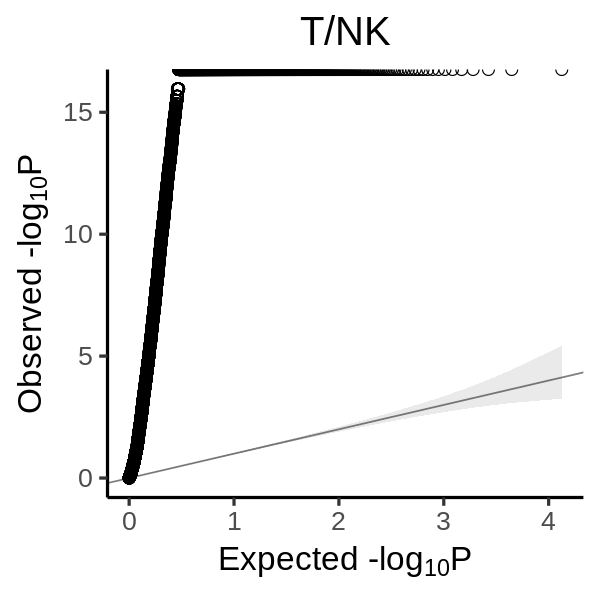

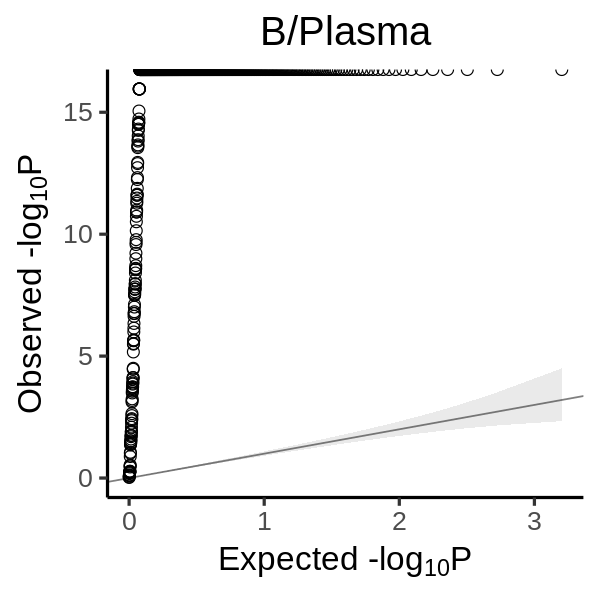

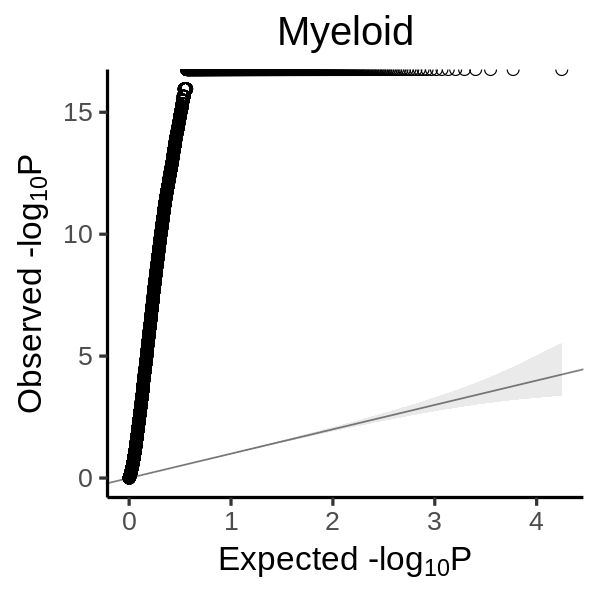

In [38]:
for (ctype in immune_ctypes) {
    res = res_all %>% filter(celltype == ctype)
    
    ps = res$p

    fig.size (5, 5)
    p = gg_qqplot(ps)+
        theme_classic(base_size = 20)+
        theme(plot.title = element_text(hjust = 0.5))+
        ggtitle(paste0(ctype))
    print(p)
}

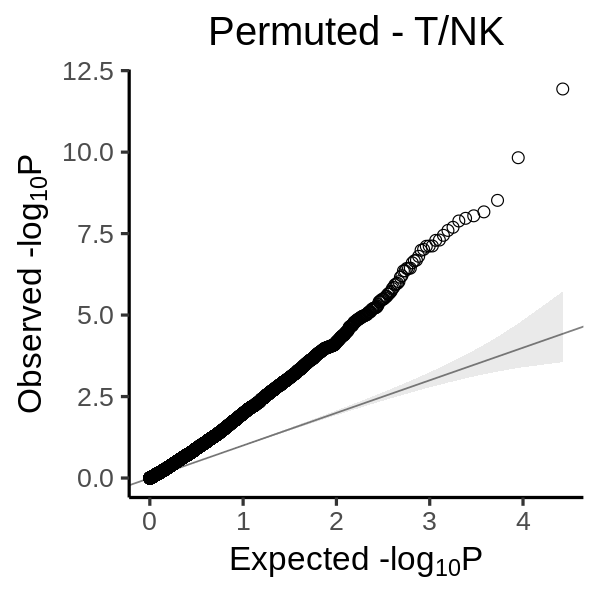

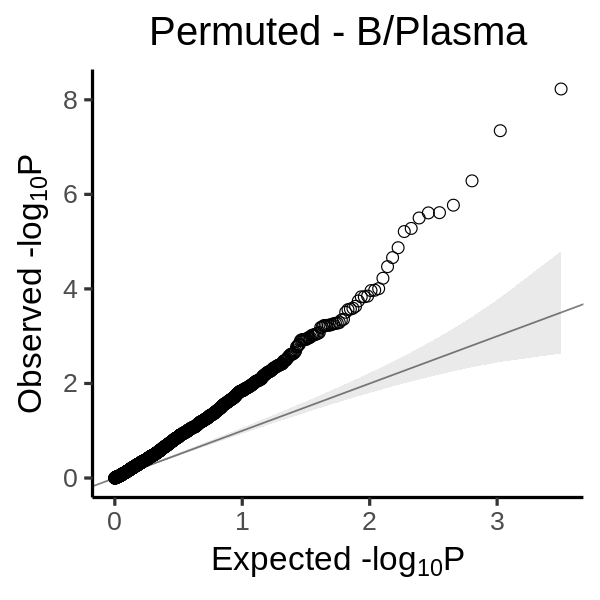

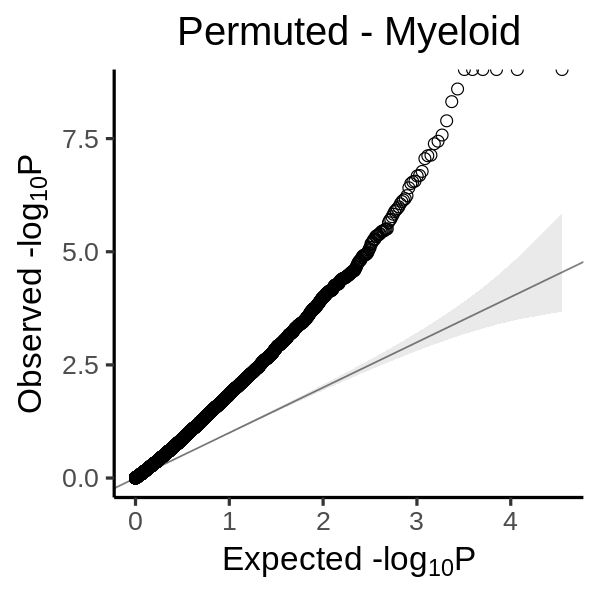

In [36]:
for (ctype in immune_ctypes) {
    res = res_all_permuted %>% filter(celltype == ctype)
    
    ps = res$p

    fig.size (5, 5)
    p = gg_qqplot(ps)+
        theme_classic(base_size = 20)+
        theme(plot.title = element_text(hjust = 0.5))+
        ggtitle(paste0('Permuted - ', ctype))
    print(p)
}

### lm

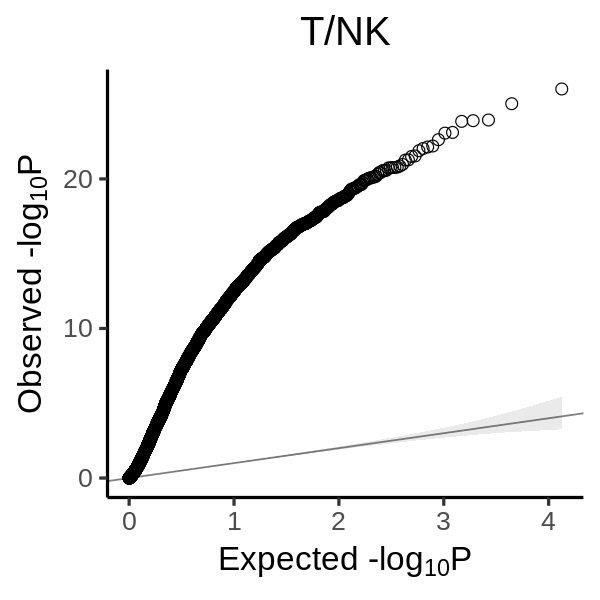

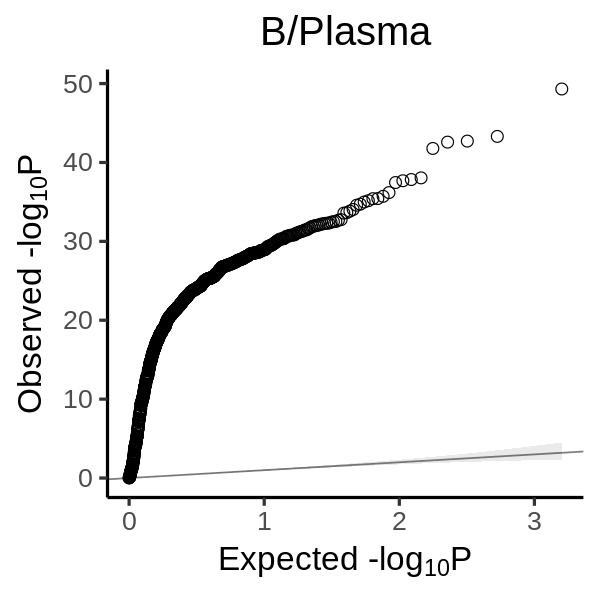

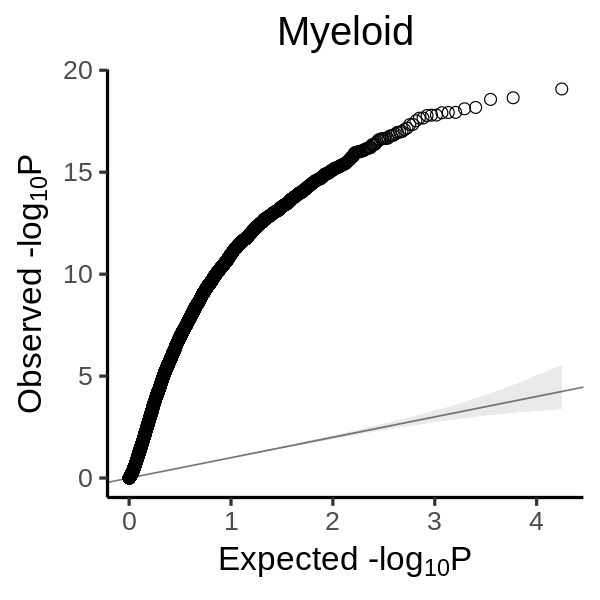

In [249]:
for (ctype in immune_ctypes) {
    res = res_all %>% filter(celltype == ctype)
    
    ps = res$p

    fig.size (5, 5)
    p = gg_qqplot(ps)+
        theme_classic(base_size = 20)+
        theme(plot.title = element_text(hjust = 0.5))+
        ggtitle(paste0(ctype))
    print(p)
}

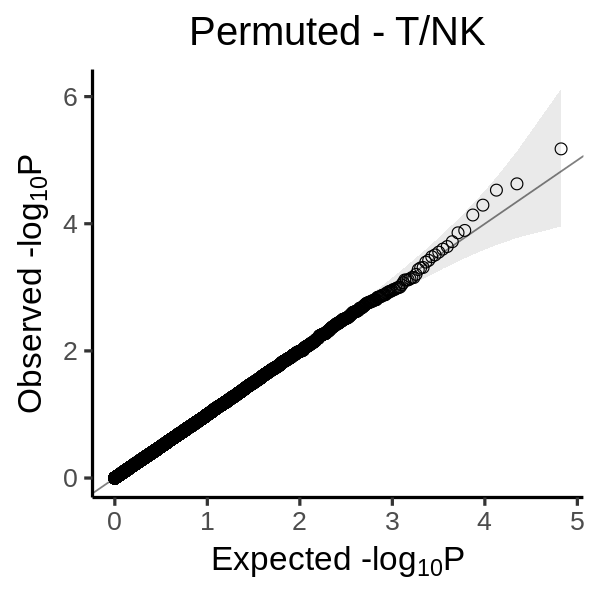

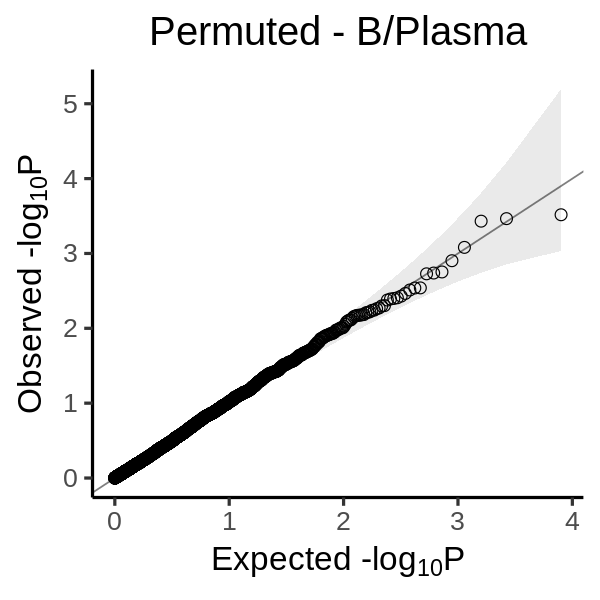

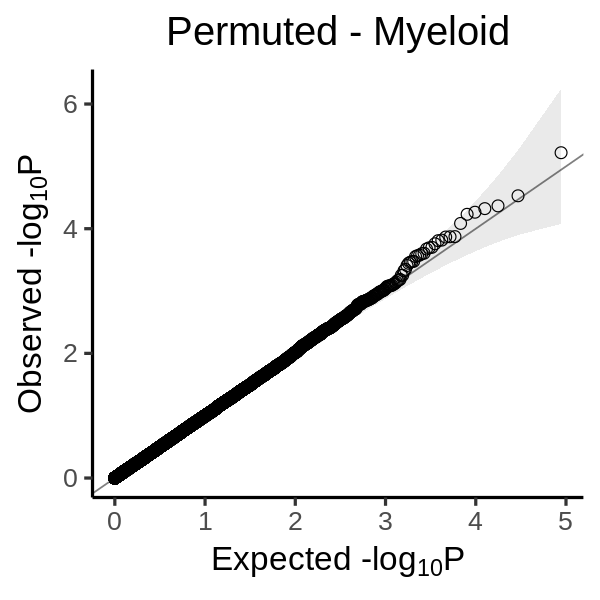

In [250]:
for (ctype in immune_ctypes) {
    res = res_all_permuted %>% filter(celltype == ctype)
    
    ps = res$p

    fig.size (5, 5)
    p = gg_qqplot(ps)+
        theme_classic(base_size = 20)+
        theme(plot.title = element_text(hjust = 0.5))+
        ggtitle(paste0('Permuted - ', ctype))
    print(p)
}

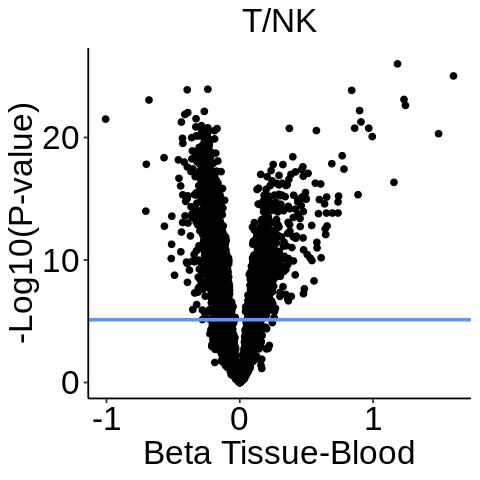

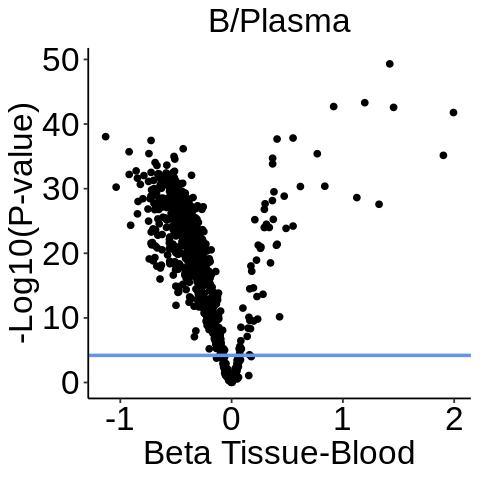

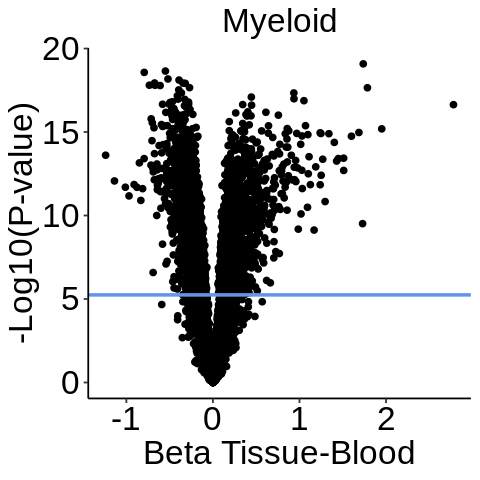

In [291]:
for (ctype in immune_ctypes){
    res = res_list[[ctype]]
        
    fig.size(4, 4)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'cornflowerblue', linewidth = 1)+
        labs(x = 'Beta Tissue-Blood', y = '-Log10(P-value)', title = ctype)
    print(p)
}

In [290]:
for (ctype in immune_ctypes){
    print(ctype)
   print(res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('')
    print(res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('')
    print('')

}

[1] "T/NK"
 [1] "FOSB"       "FXYD2"      "MT-ATP8"    "ATP1B1"     "TNF"       
 [6] "JUN"        "CLU"        "MT-ND4L"    "MZF1-AS1"   "HSPA1B"    
[11] "FOS"        "CKB"        "AC020916.1" "MT-ND6"     "COL18A1"   
[16] "SRGAP3"     "AL360012.1" "CD9"        "CXCR6"      "MT-ND5"    
[21] "IFNG"       "NR4A1"      "EGR1"       "ITM2C"      "XCL1"      
[26] "MIR155HG"   "AC253572.2" "APP"        "CD40LG"     "PTCH2"     
[31] "AC245014.3" "AL021155.5" "CYSTM1"     "TNFSF14"    "CCL4L2"    
[36] "AC007952.4" "TNFRSF4"    "ITGA1"      "ZNRF1"      "IGFBP7"    
[41] "PHLDA1"     "PDCD1"      "NDFIP2"     "CCL3"       "SPINT2"    
[46] "CISH"       "SERTAD1"    "LINC00685"  "IER5L"      "CETN3"     
[1] ""
 [1] "HIST1H1E"   "MTRNR2L12"  "HIST1H1D"   "KLF3"       "HIST1H1C"  
 [6] "MAP3K8"     "TNFAIP3"    "TENT5C"     "ZEB2"       "MTRNR2L8"  
[11] "TIPARP"     "TRIM73"     "TGFBR3"     "LINC02446"  "RNF125"    
[16] "CEMIP2"     "VPS37B"     "CD55"       "PIK3R1"     "TXNIP"     
[2

In [12]:
genes_label = list()

In [13]:
genes_label[['T/NK']] = c('TNF', 'JUN', 'FOSB', 'IFNG', 'CXCR6', 'CCL3', 'CD40LG',
                       'ITGA1', 'ZNF683', 'PDCD1', 
                          'HIST1H1E', 'KLF2', 'PRDM1', 'KLF3', 'TXNIP', 'TNFAIP3')
genes_label[['B/Plasma']] = c('IGHG1', 'IGHG3', 'IGKC', 'MZB1', 'SEC61G', 'HSP90B1',
                             'HLA-DPB1', 'HLA-DRA', 'HLA-DQB1', 'BCL11A', 'CXCR4')
genes_label[['Myeloid']] = c('C1QA', 'C1QB', 'C1QC', 'GPNMB', 'FABP5', 'MT-ND6', 'HSPA1B',
                            'KLF10', 'MXD1', 'LYZ', 'SELL', 'S100A8')

In [14]:
ctype = 'T/NK'

In [395]:
res_list[[ctype]] %>% filter(gene %in% c('ZNF683'))

,gene,beta,stderr,t,p,celltype,padj
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>
ZNF683,ZNF683,0.1993398,0.05916584,3.369171,0.001809126,T/NK,1


In [388]:
genes_label

$`B/Plasma`
[1] "test"

In [361]:
immune_ctypes

[1] "T/NK"     "B/Plasma" "Myeloid"

In [19]:
library("RColorBrewer")

In [161]:
rev(brewer.pal(7,"BrBG"))[1]

[1] "#01665E"

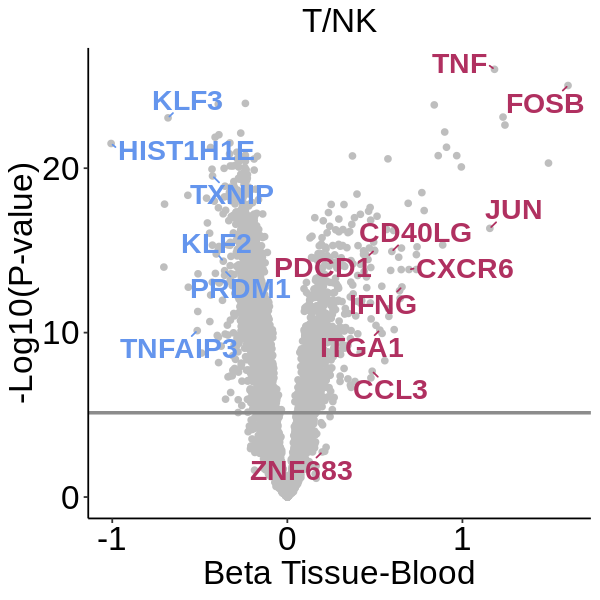

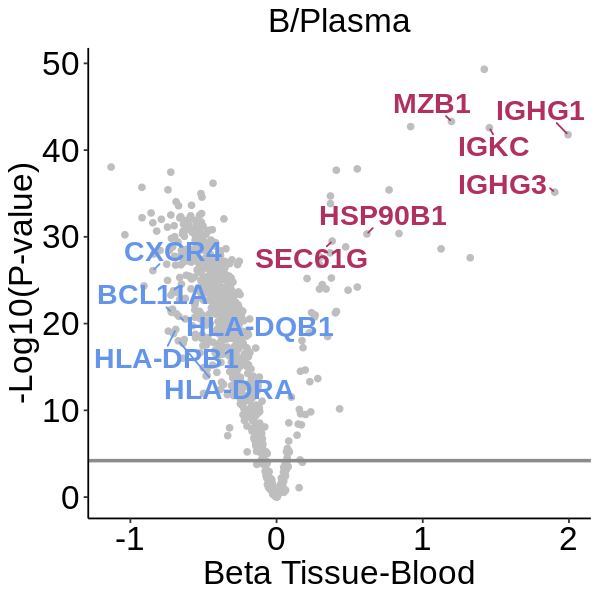

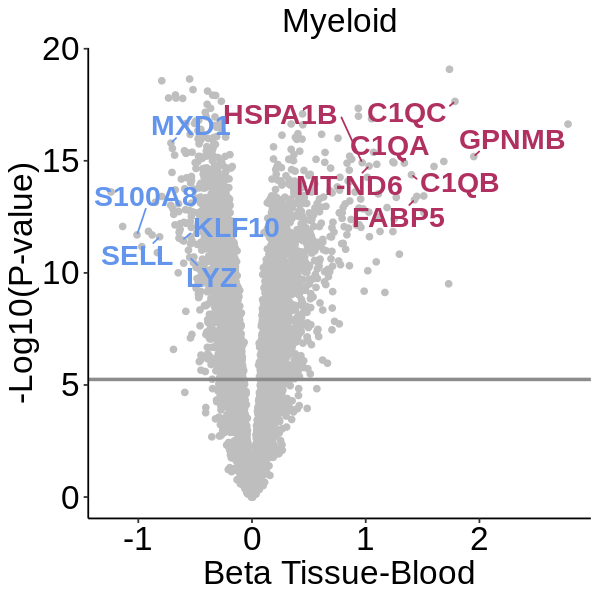

In [163]:
for (ctype in immune_ctypes){
    res = res_list[[ctype]]
    res = res %>% mutate(label = NA)
    res[genes_label[[ctype]], 'label'] = genes_label[[ctype]]

    set.seed(50)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)), color = 'grey')+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'gray55', linewidth = 1)+
        labs(x = 'Beta Tissue-Blood', y = '-Log10(P-value)', title = ctype)+
        geom_text_repel(data = res %>% filter(label != 'NA', beta > 0), aes(x = beta, y = -log10(p), label = label),
                   color = 'maroon', size = 6, fontface = "bold",
                   max.overlaps = Inf, force = 20, min.segment.length = 0)+
        geom_text_repel(data = res %>% filter(label != 'NA', beta < 0), aes(x = beta, y = -log10(p), label = label),
                   color = 'cornflowerblue', size = 6, fontface = "bold",
                   max.overlaps = Inf, force = 20, min.segment.length = 0)

    height = 5
    width = 5
    fig.size(height, width)
    outplot = p
    
    name = ctype_list[[ctype]][3]
    ggsave(paste0(figdir, name, '_de_gene_volcano_tissuevblood.png'), plot = outplot,  
           height = height, width = width, dpi = 500, limitsize = FALSE)
    ggsave(paste0(figdir, name, '_de_gene_volcano_tissuevblood.pdf'), plot = outplot,  
           height = height, width = width, dpi = 500, device = cairo_pdf, limitsize = FALSE)
    print(outplot)

}


In [16]:
top_genes = c()
bot_genes = c()
for (ctype in c('T/NK', 'Myeloid', 'B/Plasma')){
    print(ctype)
    
    top_genes = c(top_genes,
        res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(20) %>% rownames)
    bot_genes = c(bot_genes,
        res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(20) %>% rownames)
    
}

[1] "T/NK"
[1] "Myeloid"
[1] "B/Plasma"


In [17]:
top_genes = c(setdiff(top_genes, top_genes[top_genes %>% duplicated]), top_genes[top_genes %>% duplicated])

bot_genes = c(setdiff(bot_genes, bot_genes[bot_genes %>% duplicated]), bot_genes[bot_genes %>% duplicated])

genelist = c(top_genes, bot_genes)

genelist = genelist[!(genelist %>% duplicated)]

In [18]:
dat = res_all_wide %>% dplyr::select(starts_with('beta'))
dat = dat[genelist, ]
dat$gene = rownames(dat)
dat = dat %>% pivot_longer(cols = -gene, names_to = 'celltype', values_to = 'beta') %>% 
    mutate(celltype = str_replace(celltype, 'beta_', ''))

dat$gene = factor(dat$gene, levels = genelist)

In [334]:
dat %>% head(2)

,beta_T/NK,beta_B/Plasma,beta_Myeloid,gene
,<dbl>,<dbl>,<dbl>,<fct>
ATP1B1,1.231927,NA,0.9772325,ATP1B1
TNF,1.183160,NA,0.3073626,TNF


In [20]:
vmax = (abs(dat$beta) %>% quantile(.99, na.rm = TRUE))[[1]] %>% round(2)

In [383]:
vmax

[1] 1.95

Warning message:
“The `size` argument of `element_line()` is deprecated as of ggplot2 3.4.0.
ℹ Please use the `linewidth` argument instead.”
Warning message:
“The `size` argument of `element_rect()` is deprecated as of ggplot2 3.4.0.
ℹ Please use the `linewidth` argument instead.”


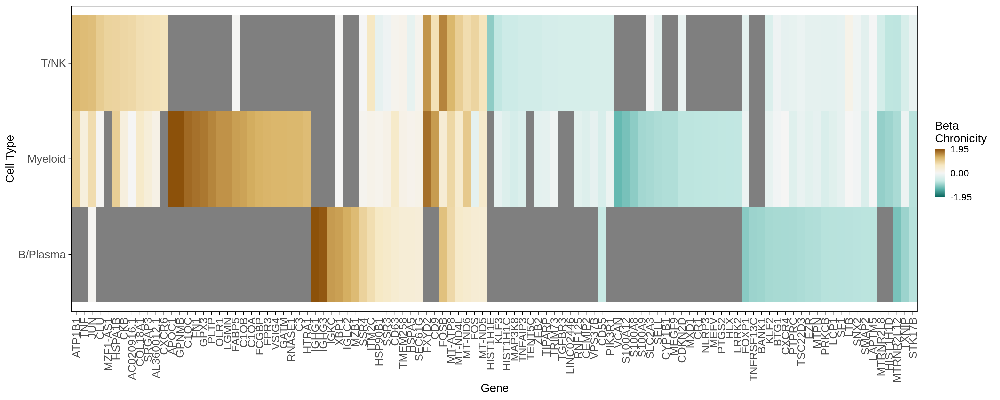

In [20]:
de_plot = ggplot(dat)+
    geom_tile(aes(x = gene, y = celltype, fill = beta))+
    # scale_fill_cividis()+
    scale_fill_gradientn(colours=rev(brewer.pal(7,"BrBG")), breaks = c(-vmax, 0, vmax),
                        limits = c(-vmax, vmax), oob=scales::squish)+
    # scale_fill_brewer(palette = 'BrBG')+
    theme_classic(base_size = tickfontsize)+
    theme_classic(base_size = tickfontsize+5)+
    theme(text = element_text(family = "Arial"),
          axis.text.x = element_text(angle = 90, hjust = 1,  vjust = 0.5),
          axis.text = element_text(size = labelfontsize),
          axis.line = element_line(color = "black", size = 0.5),  # Ensuring axis lines are black and visible
          axis.ticks = element_line(color = "black", size = 0.5),  # Adding ticks to the axes
          panel.border = element_rect(color = "black", fill = NA, size = 1)) +  # Border around the panel
    labs(x = 'Gene', y = 'Cell Type', fill = 'Beta\nChronicity')
    # geom_vline(xintercept = 5.5, linetype = 'dashed')

height = 10
width = 25

fig.size(height, width)
outplot = de_plot
outplot

# ggsave(paste0(figdir, 'de_gene_heatmap_chronicity.png'), plot = outplot,  
#        height = height, width = width, dpi = 500)
# ggsave(paste0(figdir, 'de_gene_heatmap_chronicity.pdf'), plot = outplot,  
#        height = height, width = width, dpi = 500, device = cairo_pdf)



In [25]:
tissue_names = read_sheet("https://docs.google.com/spreadsheets/d/1f94hwyuDMvSUQyelWM89xfhDos7izNQw9bQ4amml2OQ/edit?usp=sharing", 
                 sheet = "Tissue")
tissue_names = setNames(tissue_names$Annotation_latest, tissue_names$Annotation_v1)


✔ Reading from UpdatedClusterNames.

✔ Range ''Tissue''.



In [26]:
pbmc_names = read_sheet("https://docs.google.com/spreadsheets/d/1f94hwyuDMvSUQyelWM89xfhDos7izNQw9bQ4amml2OQ/edit?usp=sharing", 
                 sheet = "PBMC")
pbmc_names = setNames(pbmc_names$Annotation_latest, pbmc_names$Annotation_v1)


✔ Reading from UpdatedClusterNames.

✔ Range ''PBMC''.



In [30]:
library(presto)

Loading required package: Rcpp



In [28]:
ngenes = 20
wilcox_all = list()

tissue_labels = list('Tissue|tissue', 'blood|PBMC|Blood|pbmc')
names(tissue_labels) = list('Tissue', 'PBMC')

In [ ]:
# Load cluster means for DE genes acros ctypes

In [31]:
for (ctype in immune_ctypes){
    print(ctype)
    qcd_meta = readRDS(ctype_list[[ctype]][1])
    qcd_meta = qcd_meta %>% mutate(final_annotation = recode(final_annotation, !!!tissue_names))

    qcd_raw = readRDS(ctype_list[[ctype]][2])
    qcd_raw = qcd_raw[, qcd_meta$cell]
    qcd_meta = qcd_meta %>% mutate(individual = str_replace(sample, 'AMPSLEkid_cells_', ''))

    qcd_pbmc = readRDS(ctype_list[[ctype]][5])
    qcd_raw_pbmc = qcd_pbmc@assays$RNA@counts
    qcd_meta_pbmc = readRDS(ctype_list[[ctype]][6])
    qcd_meta_pbmc = qcd_meta_pbmc %>% mutate(final_annotation = recode(annotation, !!!pbmc_names))
    qcd_raw_pbmc = qcd_raw_pbmc[, qcd_meta_pbmc$Cell]

    tsm_fn = ctype_list[[ctype]][[7]]
    tsm = fread(tsm_fn)
    tsm_tissue = tsm %>% filter(origin == 'Tissue')
    tsm_pbmc = tsm %>% filter(origin == 'PBMC')

    top_genes = res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(100) %>% rownames
    bot_genes = res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(100) %>% rownames

    marker_genes = c(top_genes, bot_genes)
    qcd_norm = qcd_raw %>% normalizeData(scaling_factor=1e6, method='log')
    qcd_norm_pbmc = qcd_raw_pbmc %>% normalizeData(scaling_factor=1e6, method='log')

    wilcox_tissue = wilcoxauc(qcd_norm[marker_genes, qcd_meta %>% pull(cell)], 
                           qcd_meta %>% pull(final_annotation))
    wilcox_pbmc = wilcoxauc(qcd_norm_pbmc[marker_genes, qcd_meta_pbmc %>% pull(Cell)], 
                           qcd_meta_pbmc %>% pull(final_annotation))
    plot_tissue_df <- wilcox_tissue %>%  filter(feature %in% marker_genes) %>% 
                        dplyr::select(group, feature, 
                               logFC, avgExpr, pct_in) %>% ungroup() %>% group_by(feature)
    plot_blood_df <- wilcox_pbmc %>%  filter(feature %in% marker_genes) %>% 
                        dplyr::select(group, feature, 
                               logFC, avgExpr, pct_in) %>% ungroup() %>% group_by(feature)

    plot_tissue_df= plot_tissue_df %>% ungroup() %>% as.data.frame 
    plot_tissue_df['tissue'] = 'tissue'
    plot_blood_df= plot_blood_df %>% ungroup() %>% as.data.frame 
    plot_blood_df['tissue'] = 'blood'

    wilcox_all[[ctype]] = rbind(plot_tissue_df, plot_blood_df)
}

[1] "T/NK"
[1] "B/Plasma"
[1] "Myeloid"


In [169]:
tsm_de_heatmap = function(dat, tsm_grouped, tissue, vmax, ngenes = ngenes) {
    de_plot = ggplot(dat)+
        geom_tile(aes(x = feature, y = name, fill = value))+
        scale_y_discrete(expand = c(0, 0))+
        scale_fill_gradientn(colours=rev(brewer.pal(7,"BrBG")), breaks = c(-vmax, vmax),
                            limits = c(-vmax, vmax), oob=scales::squish)+
        geom_vline(xintercept = ngenes +0.5, linetype = 'dashed')+
        theme_classic(base_size = labelfontsize+15)+
        theme(text = element_text(family = "Arial"),
              # axis.text.x = element_blank(),
              legend.position = 'bottom',     
              axis.text.x = element_text(angle = 90, hjust = 1,  vjust = 0.5),
              plot.title = element_text(hjust = 0.5),
              axis.text = element_text(size = labelfontsize+15),
              axis.line = element_line(color = "black", size = 0.5),  # Ensuring axis lines are black and visible
              axis.ticks = element_line(color = "black", size = 0.5),  # Adding ticks to the axes
              panel.border = element_rect(color = "black", fill = NA, size = 1)) +  # Border around the panel
        labs(x = 'Gene', y = 'Cell Type', fill = 'Average Expr    ', title = paste0(tissue, ' - ', ctype))
        # geom_vline(xintercept = 5.5, linetype = 'dashed')

    
    side_colorbar <- ggplot(tsm_grouped) +
        geom_tile(aes(x = 1, y = annotation, fill = meanTSM), width = 1) +
        # scale_fill_gradient(low = "#fcf5f7", high = "indianred3", breaks = c(0, 0.5, 1), limits = c(0, 1),
        #                    oob=scales::squish) +
        scale_fill_distiller(palette='RdBu',breaks = c(0, 1), limits = c(0, 1),
                           )+
        # scale_y_discrete(limits = col_order)+
        scale_x_continuous(expand = c(0, 0))+
        scale_y_discrete(expand = c(0, 0))+
        theme_classic(base_size = labelfontsize+15)+
        theme(text = element_text(family = "Arial"),
              axis.text.x = element_blank(),
              axis.text = element_text(size = labelfontsize+15),
              # axis.text = element_text(size = labelfontsize),
              axis.line = element_blank(),  # Ensuring axis lines are black and visible
              axis.ticks.y = element_line(color = "black", size = 0.5),  # Adding ticks to the axes
              axis.ticks.x = element_blank(),  # Adding ticks to the axes
              panel.border = element_rect(color = "black", fill = NA, size = 1),  # Border around the panel
             plot.title = element_text(hjust = 0.5),
              legend.position = 'bottom',     
              legend.margin = margin(t = -20, r = 70, b = 0, l = 0),  # increase right margin
            legend.box.margin = margin(t = -350)
             ) +  
        labs(title = 'TSM ', fill = '', y = 'Cluster', x= '')

    outplot <- side_colorbar + plot_spacer() + de_plot + theme(axis.text.y = element_blank(),
                    axis.ticks.y= element_blank(),  
                    axis.title.y = element_blank(),
                    ) + plot_layout(nrow =1, widths = c(1, -0.55, 20)) & coord_cartesian(clip = "off") &
       theme(plot.margin = margin(0, 17, 0, 5),  # t, r, b, l (adjust as needed)
        plot.background = element_rect(color = NA))  # in case background causes clipping
    
    return(outplot)

}

[1] "T/NK"


Warning message:
“The `size` argument of `element_line()` is deprecated as of ggplot2 3.4.0.
ℹ Please use the `linewidth` argument instead.”
Warning message:
“The `size` argument of `element_rect()` is deprecated as of ggplot2 3.4.0.
ℹ Please use the `linewidth` argument instead.”


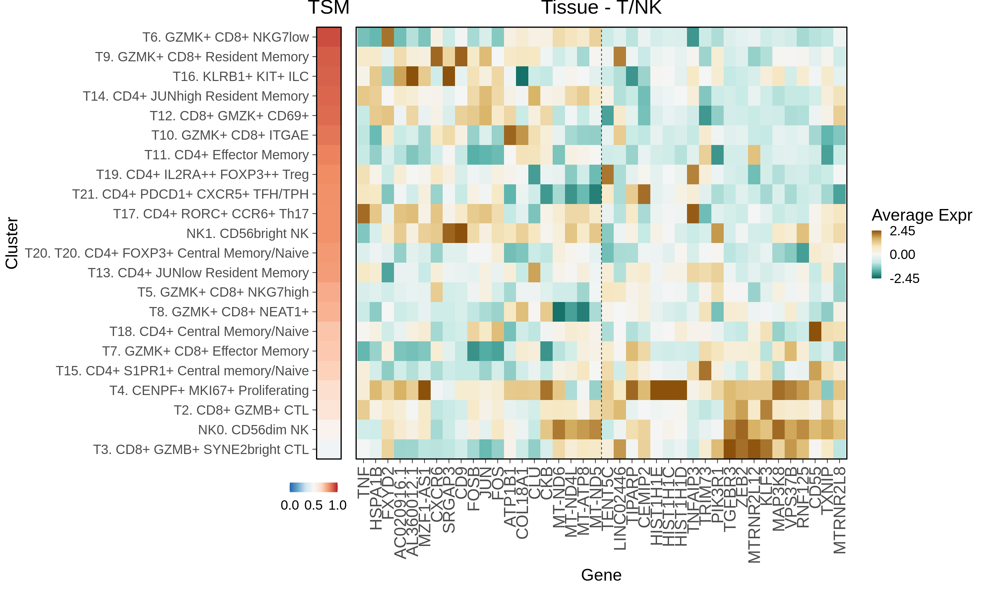

[1] "B/Plasma"


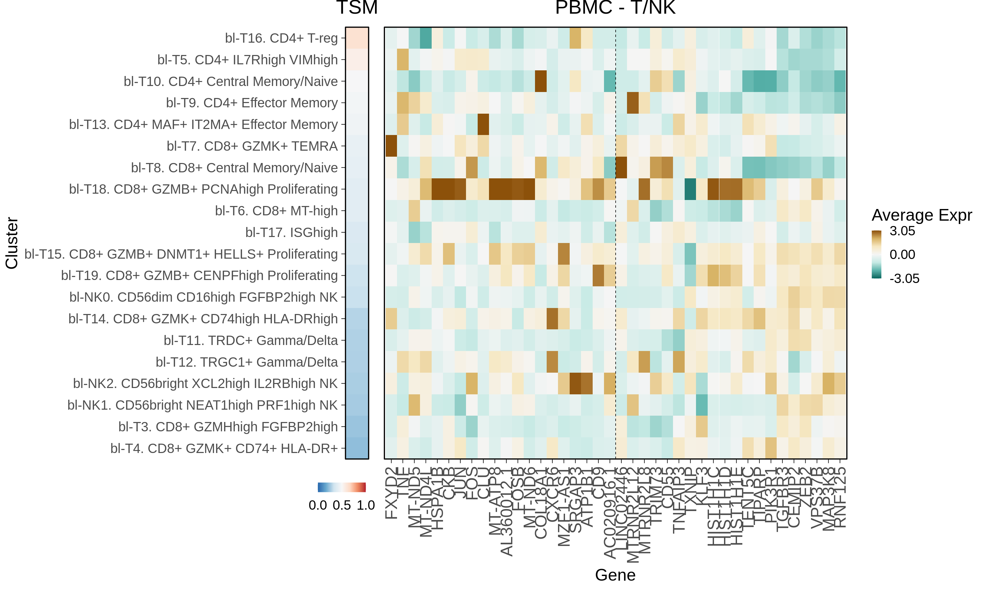

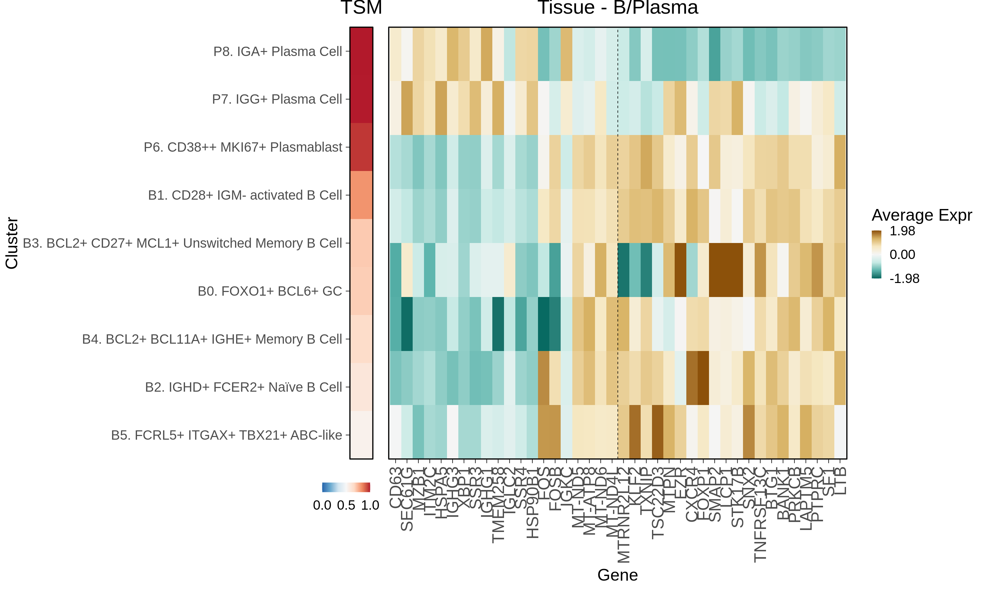

[1] "Myeloid"


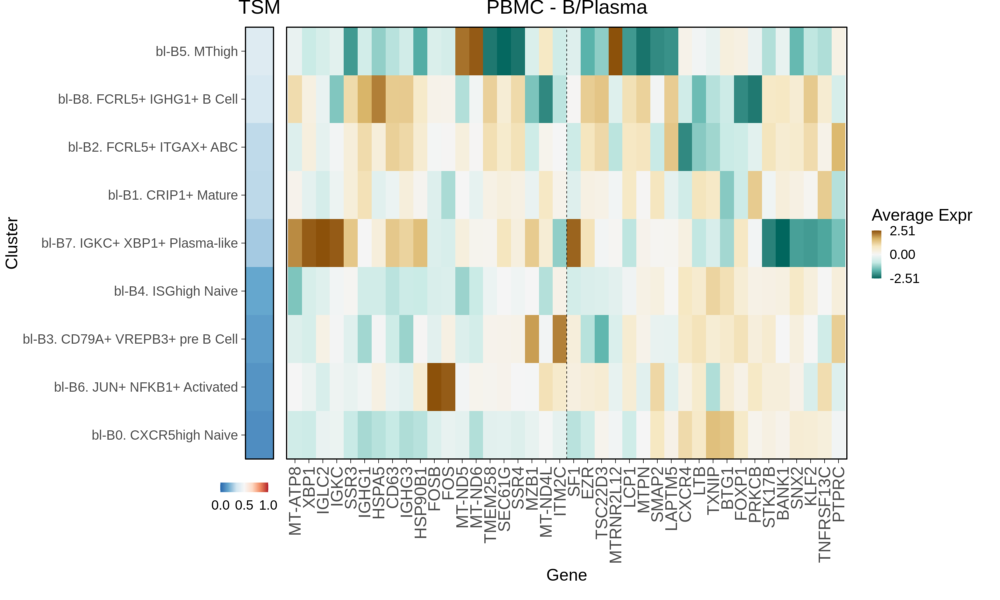

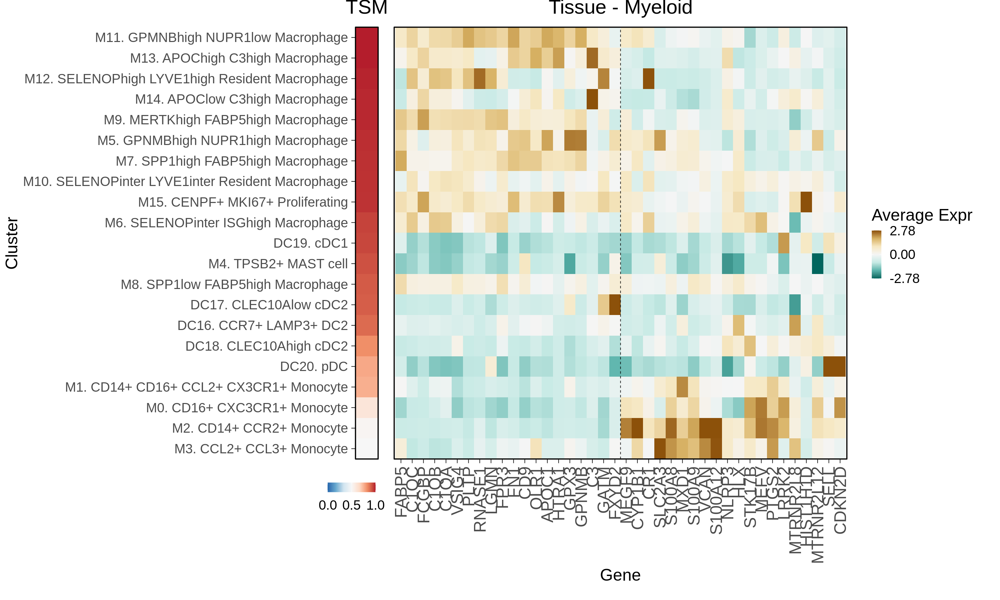

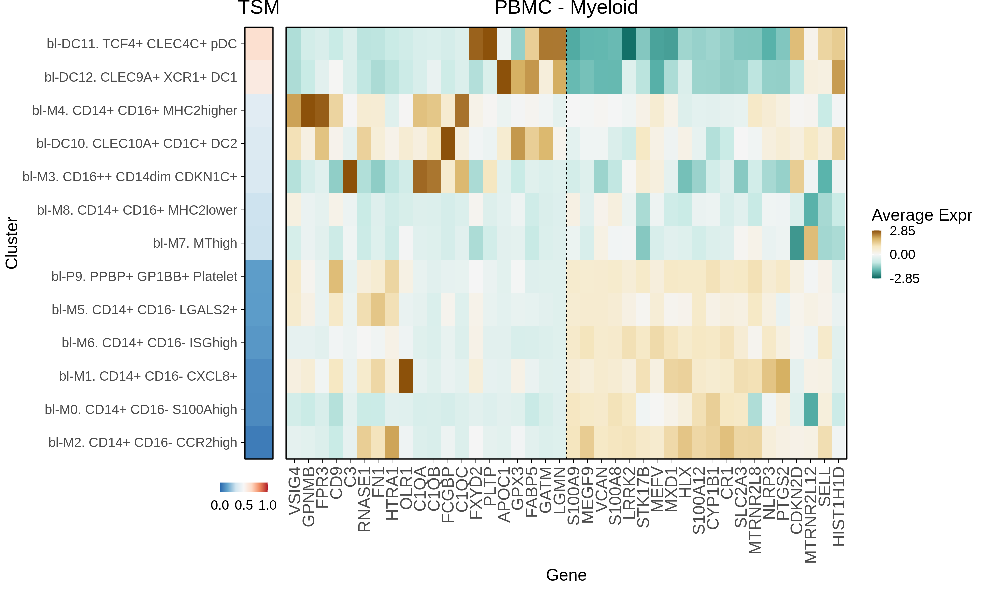

In [33]:
for (ctype in immune_ctypes){
    print(ctype)
    top_genes = res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(ngenes) %>% rownames
    bot_genes = res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(ngenes) %>% rownames
    tsm_fn = ctype_list[[ctype]][[7]]
    tsm = fread(tsm_fn)
    for (tissue in c('Tissue', 'PBMC')){
        tissue_label = tissue_labels[[tissue]]

        dat = wilcox_all[[ctype]]
        dat = dat %>% filter(grepl(tissue_label, tissue), feature %in% c(top_genes, bot_genes)) 
        # dat = dat %>% mutate(avgExpr_scaled = scale(avgExpr)) 
        dat = dat %>% mutate(group_tissue = group)#paste0(tissue, '_', group))
        dat = dat %>% pivot_wider(id_cols = group_tissue, names_from = feature, values_from = avgExpr) %>% t %>% as.data.frame
        colnames(dat) = dat[1, ]
        dat = dat[-1, ]

        dat= dat %>% mutate_all(as.numeric)
        dat = dat %>% t %>% scale %>% t %>% as.data.frame


        tsm_grouped = tsm %>% filter(grepl(tissue_label, origin)) %>% group_by(annotation) %>% 
                    summarise(meanTSM = mean(tissueScore)) %>% arrange(desc(meanTSM)) %>% as.data.frame
        col_order = tsm_grouped$annotation %>% rev
        tsm_grouped$annotation = factor(tsm_grouped$annotation, levels = col_order)
        tsm_corrs = cor(tsm_grouped['meanTSM'], dat[, tsm_grouped$annotation] %>% t) %>% t

        set.seed(123)  # for reproducibility
        k <- length(col_order)  # or however many trends you're expecting
        km_res <- kmeans(dat, centers = k)
        gene_clusters <- km_res$cluster
        cluster_order = (aggregate(x = as.data.frame(tsm_corrs), by = gene_clusters[rownames(tsm_corrs)] %>% as.data.frame, mean) %>% 
                arrange(desc(meanTSM)))[, 1]
        cluster_rank <- setNames(seq_along(cluster_order), cluster_order)
        gene_cluster_rank <- cluster_rank[as.character(gene_clusters)]
        gene_means <- rowMeans(dat)
        row_order <- rownames(dat)[order(gene_cluster_rank, -gene_means)]
        row_order = c(intersect(row_order, top_genes), intersect(row_order, bot_genes))

        dat['feature'] = rownames(dat)
        dat = dat %>% pivot_longer(cols = -feature)
        dat$feature = factor(dat$feature, levels = row_order)
        dat$name = factor(dat$name, levels = col_order)
        dat = dat %>% as.data.frame
        dat = dat %>% mutate(value = as.numeric(value))
        vmax = (abs(dat$value) %>% quantile(.99, na.rm = TRUE))[[1]] %>% round(2)

        height = 15
        width = 25
        fig.size(height, width)
        outplot = tsm_de_heatmap(dat, tsm_grouped, tissue, vmax)
        outplot
    }
}

In [170]:
ngenes = 15

[1] "T/NK"
[1] "B/Plasma"
[1] "Myeloid"


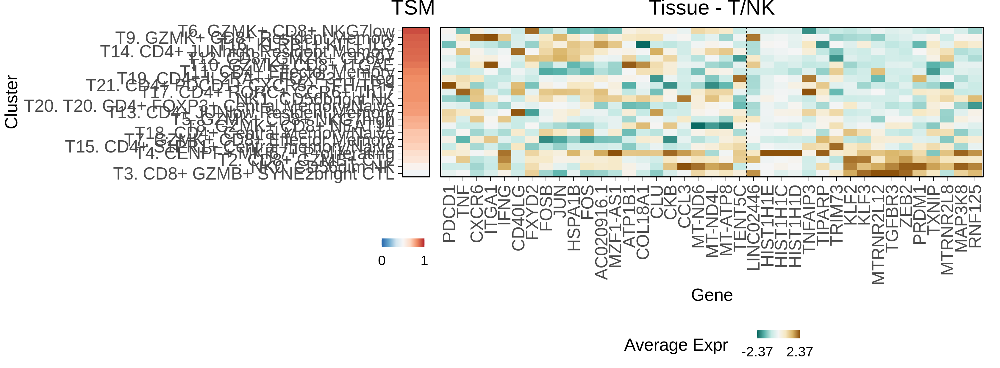

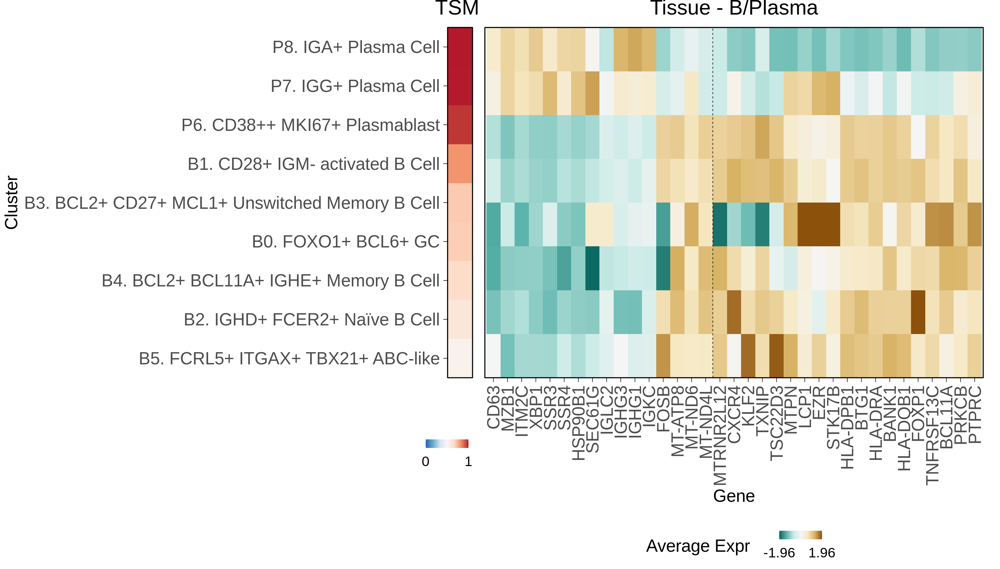

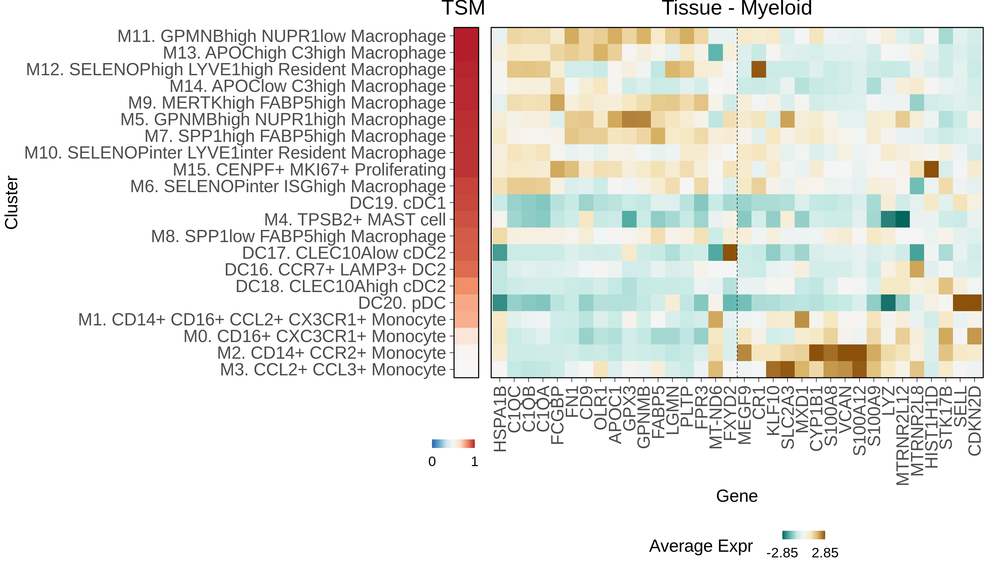

In [209]:
for (ctype in immune_ctypes){
    print(ctype)
    
    top_genes = rbind(res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% 
            arrange(desc(abs(beta))) %>% head(ngenes), 
          res_list[[ctype]] %>% filter(gene %in% genes_label[[ctype]], beta > 0))
    top_genes = top_genes %>% distinct() %>% arrange(desc(abs(beta))) %>% rownames

    bot_genes = rbind(res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% 
            arrange(desc(abs(beta))) %>% head(ngenes), 
          res_list[[ctype]] %>% filter(gene %in% genes_label[[ctype]], beta < 0))
    bot_genes = bot_genes %>% distinct() %>% arrange(desc(abs(beta)))  %>% rownames
    
    # top_genes = res_list[[ctype]] %>% filter(padj < 0.05 | gene %in% genes_label[[ctype]]) %>% filter(beta > 0)%>% 
    #         arrange(desc(abs(beta))) %>% head(ngenes) %>% rownames
    # bot_genes = res_list[[ctype]] %>% filter(padj < 0.05 | gene %in% genes_label[[ctype]]) %>% filter(beta < 0)%>% 
    #         arrange(desc(abs(beta))) %>% head(ngenes) %>% rownames
    tsm_fn = ctype_list[[ctype]][[7]]
    tsm = fread(tsm_fn)
    
    tissue = 'Tissue'
    tissue_label = tissue_labels[[tissue]]

    dat = wilcox_all[[ctype]]
    dat = dat %>% filter(grepl(tissue_label, tissue), feature %in% c(top_genes, bot_genes)) 
    # dat = dat %>% mutate(avgExpr_scaled = scale(avgExpr)) 
    dat = dat %>% mutate(group_tissue = group)#paste0(tissue, '_', group))
    dat = dat %>% pivot_wider(id_cols = group_tissue, names_from = feature, values_from = avgExpr) %>% t %>% as.data.frame
    colnames(dat) = dat[1, ]
    dat = dat[-1, ]

    dat= dat %>% mutate_all(as.numeric)
    dat = dat %>% t %>% scale %>% t %>% as.data.frame


    tsm_grouped = tsm %>% filter(grepl(tissue_label, origin)) %>% group_by(annotation) %>% 
                summarise(meanTSM = mean(tissueScore)) %>% arrange(desc(meanTSM)) %>% as.data.frame
    col_order = tsm_grouped$annotation %>% rev
    tsm_grouped$annotation = factor(tsm_grouped$annotation, levels = col_order)
    tsm_corrs = cor(tsm_grouped['meanTSM'], dat[, tsm_grouped$annotation] %>% t) %>% t

    set.seed(123)  # for reproducibility
    k <- min(length(top_genes), length(col_order))  # or however many trends you're expecting
    km_res <- kmeans(dat, centers = k)
    gene_clusters <- km_res$cluster
    cluster_order = (aggregate(x = as.data.frame(tsm_corrs), by = gene_clusters[rownames(tsm_corrs)] %>% as.data.frame, mean) %>% 
            arrange(desc(meanTSM)))[, 1]
    cluster_rank <- setNames(seq_along(cluster_order), cluster_order)
    gene_cluster_rank <- cluster_rank[as.character(gene_clusters)]
    gene_means <- rowMeans(dat)
    row_order <- rownames(dat)[order(gene_cluster_rank, -gene_means)]
    row_order = c(intersect(row_order, top_genes), intersect(row_order, bot_genes))

    dat['feature'] = rownames(dat)
    dat = dat %>% pivot_longer(cols = -feature)
    dat$feature = factor(dat$feature, levels = row_order)
    dat$name = factor(dat$name, levels = col_order)
    dat = dat %>% as.data.frame
    dat = dat %>% mutate(value = as.numeric(value))
    vmax = (abs(dat$value) %>% quantile(.99, na.rm = TRUE))[[1]] %>% round(2)

    height = 0.469*(length(col_order)+13)
    width = 28
    fig.size(height, width)
    outplot = tsm_de_heatmap(dat, tsm_grouped, tissue, vmax, length(top_genes))
    
    name = ctype_list[[ctype]][3]
    ggsave(paste0(figdir, name, '_de_gene_heatmap_tissuevblood_tissueclus.png'), plot = outplot,  
           height = height, width = width, dpi = 500, limitsize = FALSE)
    ggsave(paste0(figdir, name, '_de_gene_heatmap_tissuevblood_tissueclus.pdf'), plot = outplot,  
           height = height, width = width, dpi = 500, device = cairo_pdf, limitsize = FALSE)
    print(outplot)
}

# Blood: Case-control, by cell type

## Run differential expression

In [533]:
for (ctype in immune_ctypes){
    
    print(ctype)    
    qcd_pbmc = readRDS(ctype_list[[ctype]][5])
    qcd_raw_pbmc = qcd_pbmc@assays$RNA@counts
    qcd_meta_pbmc = readRDS(ctype_list[[ctype]][6])
    qcd_raw_pbmc = qcd_raw_pbmc[, qcd_meta_pbmc$Cell]
    pseudo_raw_pbmc = pseudobulk(qcd_raw_pbmc, qcd_meta_pbmc$individual)

    
    qcd_meta = readRDS(ctype_list[[ctype]][1])
    if (ctype %in% immune_ctypes){
        qcd_raw = readRDS(ctype_list[[ctype]][2])
        qcd_raw <- qcd_raw[, qcd_meta$cell]
    } else {
        qcd_raw = qcd_raw_tissue[, qcd_meta$cell]
    }
    
    pseudo_raw = pseudo_raw_pbmc
    qcd_meta = qcd_meta_pbmc
    rm(qcd_raw_pbmc)
    gc()
    
    ncounts = colSums(pseudo_raw)
    sample_meta = qcd_meta[!duplicated(qcd_meta$individual), ]
    sample_meta = merge(sample_meta, clinical[c('individual', 'Sex', 'Age')], by = 'individual')
    
    rownames(sample_meta) = sample_meta$individual
    sample_meta$ncounts = ncounts[rownames(sample_meta)]
    sample_meta$Sex = as.factor(sample_meta$Sex)
    
    ndonor_thresh = round(nrow(sample_meta)*.9)
    print(ndonor_thresh)
    genes = rownames(pseudo_raw)[rowSums(pseudo_raw >= genecount_thresh) > ndonor_thresh]
    print(length(genes))
    
    pseudo_raw = pseudo_raw[genes, rownames(sample_meta)]
    gc()
    # pseudo_raw = pseudo_raw + pseudocount

    system.time(
    suppressMessages({
    suppressWarnings({
        res_list = future_lapply(genes, future.seed = TRUE, function(gene){
        tryCatch({
        res = data.frame()

        gene_expr = pseudo_raw[gene, ]

        null = glm.nb(gene_expr ~ Sex + Age + offset(log(ncounts)), data = sample_meta)
        full = glm.nb(gene_expr ~ Sex + Age + Type + offset(log(ncounts)), data = sample_meta)
        z =summary(full)$coefficients['TypeSLE', "z value"]
        se = summary(full)$coefficients['TypeSLE', "Std. Error"]
        b = summary(full)$coefficients['TypeSLE', "Estimate"] #full$coefficients[['TypeLN']]
        pval = anova(full, null)[2, 'Pr(Chi)']
        res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se, 'z-score' = z, 'p' = pval))       
        return(res)
        }, error = function(e) {
            message(paste("Error for gene:", gene))
            message("Error message:", e$message)
            return(NULL)  # Return NULL if there's an error to avoid stopping the loop
          })
        })})})
    )

    res = do.call("rbind", res_list)
    res['celltype'] = ctype
    res$padj = p.adjust(res$p, method = "bonferroni")

    name = ctype_list[[ctype]][3]
    saveRDS(res, paste0(outdir, name, '_case_control_differential_expression_blood_20250502_pseudo.rds'))
    flush.console()
}

[1] "T/NK"
[1] 114
[1] 15127


## Load results

In [25]:
res_list = list()
res_all = data.frame()

for (ctype in immune_ctypes){
    
    name = ctype_list[[ctype]][3]
    de_fn = paste0(outdir, name, '_case_control_differential_expression_blood_20250502_pseudo.rds')
    res = readRDS(de_fn)
    print(res$gene %>% unique %>% length)
    
    res_all = rbind(res_all, res)
    res_list[[ctype]] = res
    rownames(res_list[[ctype]]) = res$gene
}

[1] 15126
[1] 11858
[1] 14213


In [26]:
name = 'Case-Control in Blood'
export_res[[name]] = res_all %>% mutate(variable = 'case-ctrl blood')

In [218]:
res_all_wide = res_all %>% pivot_wider(id_cols = gene, names_from = celltype, values_from = c(beta,stderr, z.score, p, padj)) %>% as.data.frame
rownames(res_all_wide) = res_all_wide$gene

In [537]:
for (ctype in celltypes){
   print(res_list[[ctype]] %>% filter(padj < 0.05) %>% arrange(desc(beta)))
}

                   gene       beta     stderr   z.score            p celltype
IFI27             IFI27  3.0628594 0.42049716  7.283900 9.824602e-07     T/NK
IFI44L           IFI44L  2.6247672 0.35952413  7.300670 3.406908e-07     T/NK
USP18             USP18  1.8238204 0.27105028  6.728716 2.680875e-07     T/NK
IFI44             IFI44  1.4177291 0.22501340  6.300643 5.395081e-07     T/NK
SPATS2L         SPATS2L  1.3149208 0.21001129  6.261191 4.066284e-07     T/NK
GPRIN1           GPRIN1  1.2616406 0.25595022  4.929242 1.895791e-07     T/NK
EPSTI1           EPSTI1  1.2354077 0.21736787  5.683488 3.094365e-06     T/NK
PALM2-AKAP2 PALM2-AKAP2  1.0780198 0.18072290  5.965042 6.912190e-07     T/NK
EIF2AK2         EIF2AK2  1.0714341 0.18968588  5.648465 2.529170e-06     T/NK
ODF3B             ODF3B  1.0461402 0.17878488  5.851391 8.040812e-07     T/NK
CHAF1B           CHAF1B  1.0019590 0.18688207  5.361450 2.316077e-06     T/NK
HOXB7             HOXB7  0.9755499 0.18664604  5.226738 3.157342

ERROR: Error in h(simpleError(msg, call)): error in evaluating the argument 'x' in selecting a method for function 'print': no applicable method for 'filter' applied to an object of class "NULL"


## Visualize results

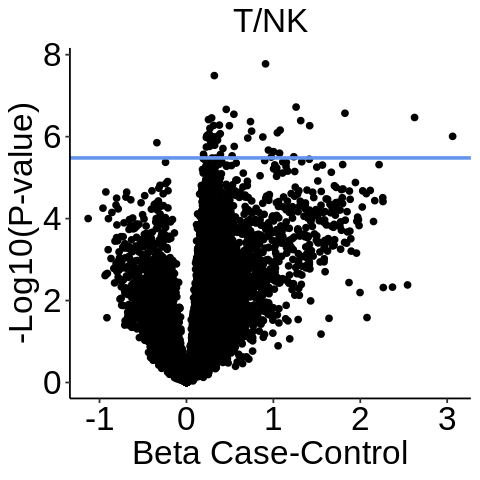

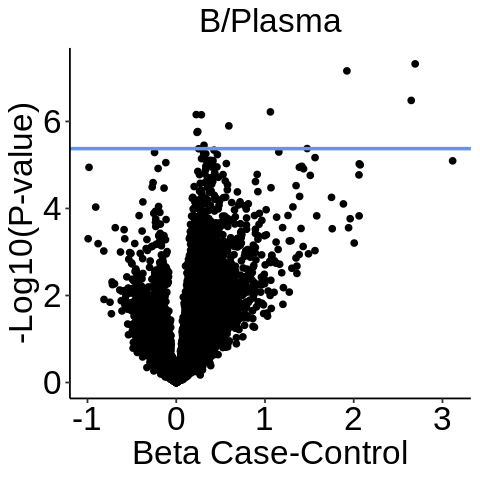

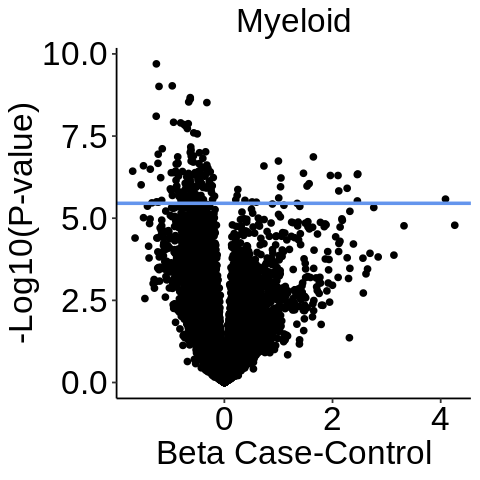

In [538]:
for (ctype in immune_ctypes){
    res = res_list[[ctype]]
        
    fig.size(4, 4)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'cornflowerblue', linewidth = 1)+
        labs(x = 'Beta Case-Control', y = '-Log10(P-value)', title = ctype)
    print(p)
}

In [542]:
for (ctype in immune_ctypes){
    print(paste0('Enriched in ', ctype))
    print(res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print(paste0('Depleted in ', ctype))
    print(res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('')
    print('')

}

[1] "Enriched in T/NK"
 [1] "IFI27"       "IFI44L"      "USP18"       "IFI44"       "SPATS2L"    
 [6] "GPRIN1"      "EPSTI1"      "PALM2-AKAP2" "EIF2AK2"     "ODF3B"      
[11] "CHAF1B"      "HOXB7"       "EZH2"        "REC8"        "LY6E"       
[16] "CDC7"        "AC135507.1"  "IFITM1"      "B3GNT2"      "DTX3"       
[21] "TCTEX1D2"    "GCH1"        "PHPT1"       "ITPK1"       "BAX"        
[26] "GMDS"        "DCAF11"      "KLHL2"       "RAD23B"      "CCNK"       
[31] "LLPH"        "PPTC7"       "AZIN1"       "C8orf76"     "KIF5B"      
[36] "MAPRE1"      "RBMXL1"      "PSME3"       "SZRD1"       "MOB1A"      
[41] "ARF3"        "ITFG1"       "ATXN7L3"     "TPM3"        "SMARCE1"    
[46] "TMEM199"     "BECN1"       "YTHDF1"      "PPHLN1"     
[1] "Depleted in T/NK"
[1] "RPS3"
[1] ""
[1] ""
[1] "Enriched in B/Plasma"
 [1] "SPATS2L"    "IFI44L"     "IFITM1"     "AC136475.1" "ODF3B"     
 [6] "IFITM2"     "ATP11B"     "FOXN3"      "CYTH1"      "PPHLN1"    
[11] "HNRNPC"    
[1] "Dep

In [564]:
ctype = 'Myeloid'

print(paste0('Enriched in ', ctype))
print(res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
# print(res_list[[ctype]] %>% filter(padj < 1, beta > 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
print(paste0('Depleted in ', ctype))
print(res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
# print(res_list[[ctype]] %>% filter(padj < 1, beta < 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)


[1] "Enriched in Myeloid"
 [1] "IFI27"    "SIGLEC1"  "USP18"    "IFI44L"   "LGALS3BP" "GMPR"    
 [7] "IFI6"     "OASL"     "IFI44"    "IFITM3"   "EPSTI1"   "EPHB2"   
[13] "MT1F"     "ACSL1"    "SAMSN1"   "ZCCHC2"   "FPR1"     "BCL6"    
[19] "SPATA13"  "H2AFJ"    "MFSD14A"  "MAPRE1"   "SH3GLB1" 
[1] "Depleted in Myeloid"
 [1] "DNASE1L3"   "TCL1A"      "GPM6B"      "DRD4"       "GZMB"      
 [6] "RBPMS"      "AC092068.3" "LAMP5"      "ZNF154"     "PMEPA1"    
[11] "MCC"        "LINC00665"  "EPS8L2"     "C12orf75"   "ZNF418"    
[16] "SERPINF1"   "MMP23B"     "ACSM3"      "AC025171.3" "AC008035.1"
[21] "MTERF2"     "LINC00954"  "FOXRED2"    "LINC02812"  "AC004846.1"
[26] "ZNF556"     "CACNA2D3"   "VEGFB"      "FNBP1L"     "ZNF439"    
[31] "AJM1"       "PAIP2B"     "ZNF606"     "ZNF66"      "PRXL2A"    
[36] "FMNL3"      "DANCR"      "CCDC50"     "STARD4-AS1" "NRSN2-AS1" 
[41] "ZFAT"       "LIME1"      "SRGAP3"     "ZNF710-AS1" "OFD1"      
[46] "GHRL"       "TBC1D4"     "DRC3"       "

In [482]:
genes_label = list()

In [565]:
genes_label[['T/NK']] = c("IFI27", "IFI44L", "USP18", "IFI44", "IFITM1", "ITFG1",
                          "HOXB7", "CCNK", "BAX",
                         "RPS3", "EEF1B2", "RPS14", "RPS3A", "TNK1")
genes_label[['B/Plasma']] = c("SPATS2L", "IFI44L", "IFITM1", "ODF3B", "PPHLN1", "FOXN3", "MX1",
                             "RPL3", "RPS3", "EEF1A1")
genes_label[['Myeloid']] = c("IFI27", "IFI44L", "IFI6", "BCL6", "IFI44", "IFITM3", "SIGLEC1", "MT1F", "ACSL1",
                            "GZMB", "LAMP5", "VEGFB", "GPM6B")

In [483]:
immune_ctypes

[1] "T/NK"     "B/Plasma" "Myeloid"

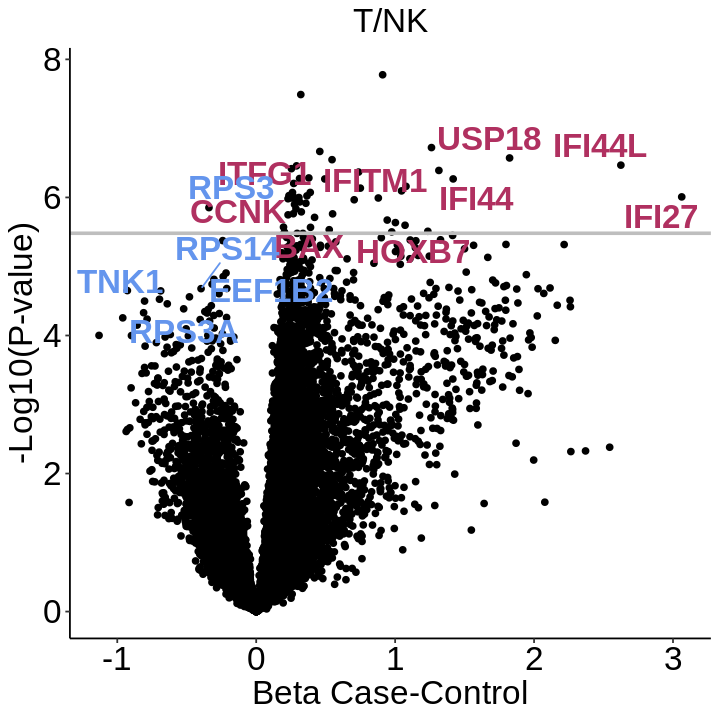

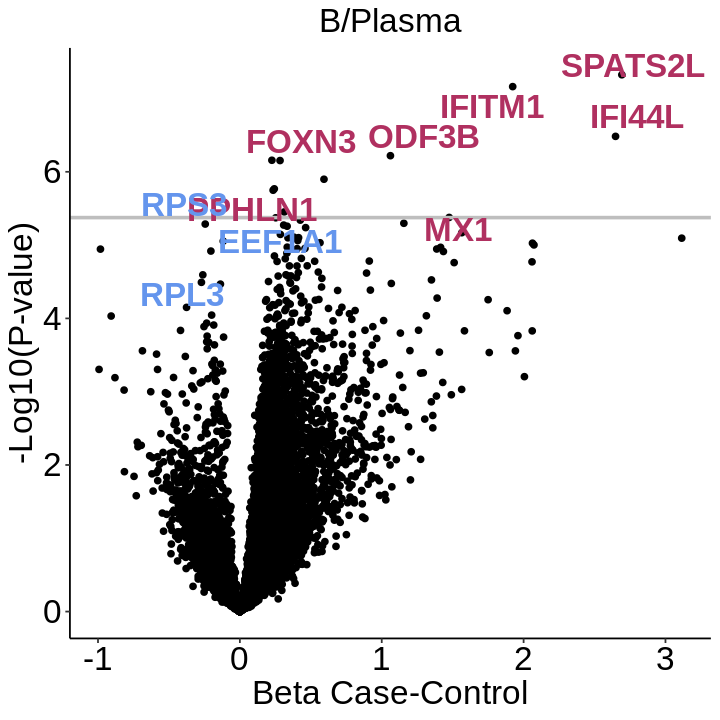

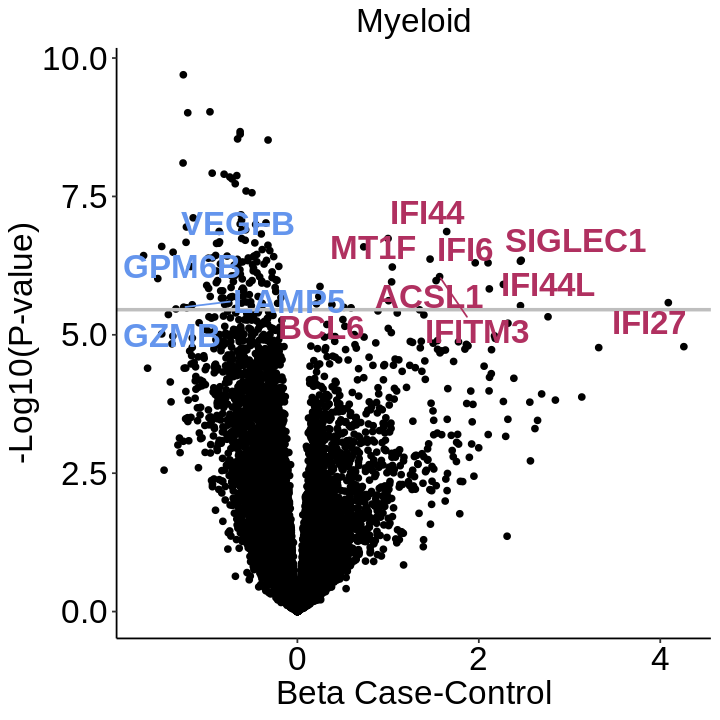

In [569]:
for (ctype in immune_ctypes){
    res = res_list[[ctype]]
    res = res %>% mutate(label = NA)
    res[genes_label[[ctype]], 'label'] = genes_label[[ctype]]

    fig.size(6, 6)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'grey', linewidth = 1)+
        labs(x = 'Beta Case-Control', y = '-Log10(P-value)', title = ctype)+
        geom_text_repel(data = res %>% filter(label != 'NA', beta > 0), aes(x = beta, y = -log10(p), label = label),
                   color = 'maroon', size = 7, fontface = "bold",
                   max.overlaps = Inf, force = 3)+
        geom_text_repel(data = res %>% filter(label != 'NA', beta < 0), aes(x = beta, y = -log10(p), label = label),
                   color = 'cornflowerblue', size = 7, fontface = "bold",
                   max.overlaps = Inf, force = 10)

    print(p)

}


In [220]:
genes_shared = (res_all$gene %>% table) ==3
genes_shared = genes_shared[genes_shared] %>% names

In [221]:
length(genes_shared)

[1] 11340

In [222]:
genes_shared = (res_all %>% filter(gene %in% genes_shared, padj < 0.05))$gene %>% unique

genes_show = res_all_wide[genes_shared, ] %>% 
    dplyr::select(starts_with('beta')) %>% rowMeans(na.rm = TRUE) %>% sort %>% rev %>% names

genes_show = abs(res_all_wide[genes_show, ] %>% 
    dplyr::select(starts_with('beta')) %>% rowMeans(na.rm = TRUE) %>% sort %>% rev) > .2
genes_show= genes_show[genes_show] %>% names

In [223]:
dat = res_all %>% filter(gene %in% genes_show)
dat %>% dim

dat$gene = factor(dat$gene, levels = genes_show)

[1] 306   7

In [224]:
vmax = (abs(dat$beta) %>% quantile(.99, na.rm = TRUE))[[1]] %>% round(2)

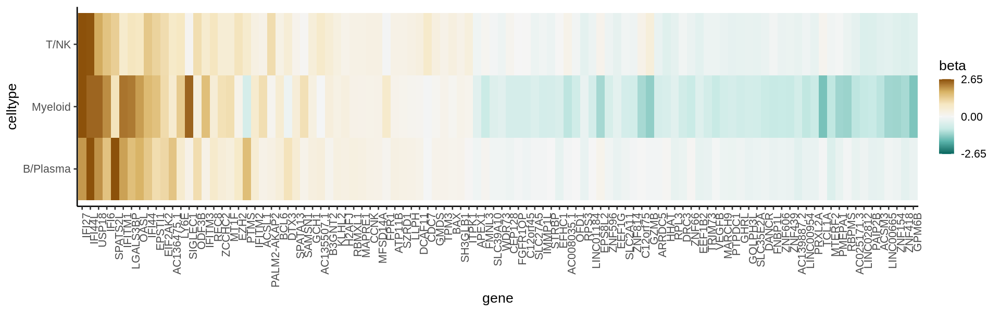

In [225]:
fig.size(5, 16)
ggplot(dat)+
    geom_tile(aes(x = gene, y = celltype, fill = beta))+
    scale_fill_gradientn(colours=rev(brewer.pal(7,"BrBG")), breaks = c(-vmax, 0, vmax),
                        limits = c(-vmax, vmax), oob=scales::squish)+
    theme_classic(base_size = tickfontsize)+
    theme(axis.text.x = element_text(angle = 90, hjust = 1))

In [231]:
genes_show_filt = c(genes_show[1:10], 
                   c('RPS3', 'RPL3'),
                   genes_show[(length(genes_show)-8):length(genes_show)])

In [232]:
dat = res_all %>% filter(gene %in% genes_show_filt)
dat %>% dim

dat$gene = factor(dat$gene, levels = genes_show_filt)

vmax = (abs(dat$beta) %>% quantile(.99, na.rm = TRUE))[[1]] %>% round(2)

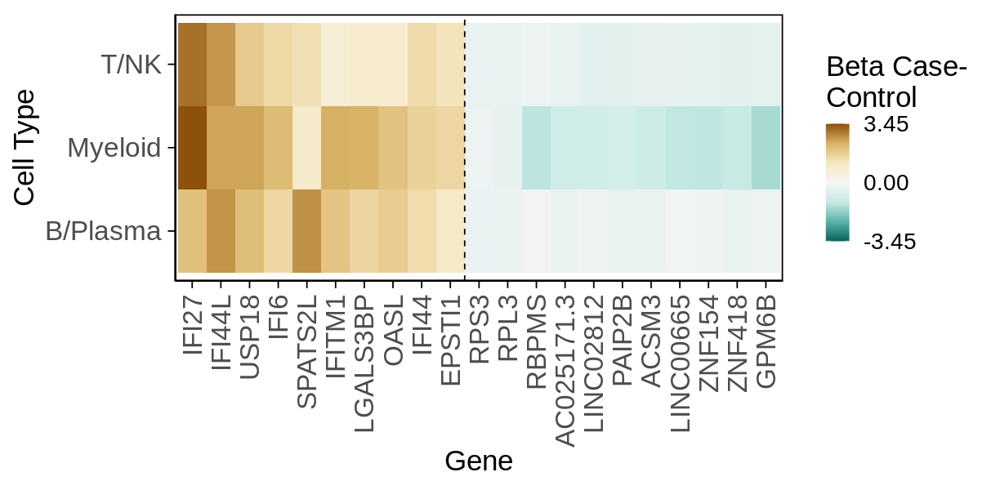

In [237]:
fig.size(5, 16)
de_plot = ggplot(dat)+
    geom_tile(aes(x = gene, y = celltype, fill = beta))+
    scale_fill_gradientn(colours=rev(brewer.pal(7,"BrBG")), breaks = c(-vmax, 0, vmax),
                        limits = c(-vmax, vmax), oob=scales::squish)+
    theme_classic(base_size = tickfontsize+5)+
    theme(text = element_text(family = "Arial"),
          axis.text.x = element_text(angle = 90, hjust = 1,  vjust = 0.5),
          axis.text = element_text(size = labelfontsize),
          axis.line = element_line(color = "black", size = 0.5),  # Ensuring axis lines are black and visible
          axis.ticks = element_line(color = "black", size = 0.5),  # Adding ticks to the axes
          panel.border = element_rect(color = "black", fill = NA, size = 1)) +  # Border around the panel
    labs(x = 'Gene', y = 'Cell Type', fill = 'Beta Case-\nControl')+
    geom_vline(xintercept = 10.5, linetype = 'dashed')

height = 5
width = 10.2

fig.size(height, width)
outplot = de_plot
outplot


In [246]:
genes_show_filt = c(genes_show[1:10], 
                   c('RPS3', 'RPL3'),
                   genes_show[(length(genes_show)-8):length(genes_show)])

In [247]:
dat = res_all %>% filter(gene %in% genes_show_filt)
dat %>% dim

dat$gene = factor(dat$gene, levels = genes_show_filt %>% rev)

vmax = (abs(dat$beta) %>% quantile(.99, na.rm = TRUE))[[1]] %>% round(2)

[1] 63  7

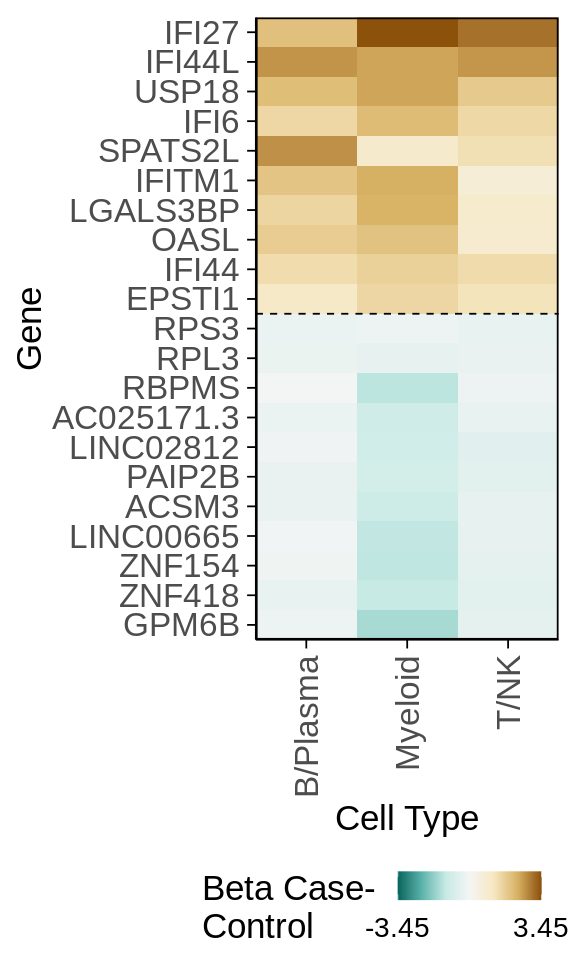

In [276]:
fig.size(5, 16)
de_plot = ggplot(dat)+
    geom_tile(aes(y = gene, x = celltype, fill = beta))+
    scale_fill_gradientn(colours=rev(brewer.pal(7,"BrBG")), breaks = c(-vmax, vmax),
                        limits = c(-vmax, vmax), oob=scales::squish)+
    theme_classic(base_size = tickfontsize+5)+
    theme(text = element_text(family = "Arial"),
          axis.text.x = element_text(angle = 90, hjust = 1,  vjust = 0.5),
          axis.text = element_text(size = labelfontsize),
          axis.line = element_line(color = "black", size = 0.5),  # Ensuring axis lines are black and visible
          axis.ticks = element_line(color = "black", size = 0.5),  # Adding ticks to the axes
          panel.border = element_rect(color = "black", fill = NA, size = 1), 
          legend.position='bottom', legend.margin = margin(l = -1.5, unit='cm')) +  # Border around the panel
    labs(y = 'Gene', x = 'Cell Type', fill = 'Beta Case-\nControl')+
    geom_hline(yintercept = 11.5, linetype = 'dashed')+
  scale_x_discrete(expand = c(0, 0)) +
  scale_y_discrete(expand = c(0, 0))


height = 8
width = 4.8

fig.size(height, width)
outplot = de_plot
outplot

ggsave(paste0(figdir, 'de_gene_heatmap_casectrl_blood.png'), plot = outplot,  
       height = height, width = width, dpi = 500)
ggsave(paste0(figdir, 'de_gene_heatmap_casectrl_blood.pdf'), plot = outplot,  
       height = height, width = width, dpi = 500, device = cairo_pdf)



# Blood: Chronicity, by cell type

## Run differential expression

In [ ]:
for (ctype in immune_ctypes[1:2]){
    print(ctype)
    
    qcd_pbmc = readRDS(ctype_list[[ctype]][5])
    qcd_raw_pbmc = qcd_pbmc@assays$RNA@counts
    qcd_meta_pbmc = readRDS(ctype_list[[ctype]][6])
    qcd_raw_pbmc = qcd_raw_pbmc[, qcd_meta_pbmc$Cell]
    pseudo_raw_pbmc = pseudobulk(qcd_raw_pbmc, qcd_meta_pbmc$individual)

    
    qcd_meta = readRDS(ctype_list[[ctype]][1])
    if (ctype %in% immune_ctypes){
        qcd_raw = readRDS(ctype_list[[ctype]][2])
        qcd_raw <- qcd_raw[, qcd_meta$cell]
    } else {
        qcd_raw = qcd_raw_tissue[, qcd_meta$cell]
    }
    
    pseudo_raw = pseudo_raw_pbmc
    qcd_meta = qcd_meta_pbmc
    rm(qcd_raw_pbmc)
    gc()
    
    ncounts = colSums(pseudo_raw)
    sample_meta = qcd_meta[!duplicated(qcd_meta$individual), ]
    sample_meta = merge(sample_meta, clinical[c('individual', 'Sex', 'Age', 'Final_Chronicity', 
                                                'First_biop', 'Final_Site')], by = 'individual')
    sample_meta = sample_meta %>% filter(Type == 'SLE')
    sample_meta = sample_meta[!is.na(sample_meta['Final_Chronicity']), ]
    
    rownames(sample_meta) = sample_meta$individual
    sample_meta$ncounts = ncounts[rownames(sample_meta)]
    sample_meta$Sex = as.factor(sample_meta$Sex)
    sample_meta$First_biop = as.factor(sample_meta$First_biop)
    sample_meta$Final_Site = as.factor(sample_meta$Final_Site)

    ndonor_thresh = round(nrow(sample_meta)*.9)
    print(ndonor_thresh)
    genes = rownames(pseudo_raw)[rowSums(pseudo_raw >= genecount_thresh) > ndonor_thresh]
    print(length(genes))
    
    pseudo_raw = pseudo_raw[genes, rownames(sample_meta)]
    gc()
    # pseudo_raw = pseudo_raw + pseudocount

    system.time(
    suppressMessages({
    suppressWarnings({
        res_list = future_lapply(genes, future.seed = TRUE, function(gene){
            
            tryCatch({
        res = data.frame()

        gene_expr = pseudo_raw[gene, ]
            
        null_fm = as.formula(paste0(c('gene_expr ~ Age + Sex + First_biop + Final_Site ',
                              ' + offset(log(ncounts))'), collapse = '') )
        full_fm = as.formula(paste0(c('gene_expr ~ Age + Sex + First_biop + Final_Site + Final_Chronicity + ', 
                              ' + offset(log(ncounts))'), collapse = '') )
        # print(full_fm)

        null = glm.nb(null_fm, data = sample_meta)
        full = glm.nb(full_fm, data = sample_meta)
        z =summary(full)$coefficients['Final_Chronicity', "z value"]
        se = summary(full)$coefficients['Final_Chronicity', "Std. Error"]
        b = summary(full)$coefficients['Final_Chronicity', "Estimate"] #full$coefficients[['TypeLN']]
        pval = anova(full, null)[2, 'Pr(Chi)']
        res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se, 'z-score' = z, 'p' = pval))       
        return(res)
                
        }, error = function(e) {
            message(paste("Error for gene:", gene))
            message("Error message:", e$message)
            return(NULL)  # Return NULL if there's an error to avoid stopping the loop
          })
                
        })})})
    )

    res = do.call("rbind", res_list)
    res['celltype'] = ctype
    res$padj = p.adjust(res$p, method = "bonferroni")

    name = ctype_list[[ctype]][3]
    saveRDS(res, paste0(outdir, name, '_chronicity_differential_expression_blood_20250502_pseudo_sitenoTR.rds'))
    flush.console()
}

[1] "T/NK"
[1] 95
[1] 16873


In [726]:
system.time(
suppressMessages({
suppressWarnings({
    res_list = future_lapply(genes, future.seed = TRUE, function(gene){

        tryCatch({
    res = data.frame()

    gene_expr = pseudo_raw[gene, ]

    null_fm = as.formula(paste0(c('gene_expr ~ Age + Sex + First_biop + Final_Site ',
                          ' + offset(log(ncounts))'), collapse = '') )
    full_fm = as.formula(paste0(c('gene_expr ~ Age + Sex + First_biop + Final_Site + Final_Chronicity + ', 
                          ' + offset(log(ncounts))'), collapse = '') )
    # print(full_fm)

    null = glm.nb(null_fm, data = sample_meta)
    full = glm.nb(full_fm, data = sample_meta)
    z =summary(full)$coefficients['Final_Chronicity', "z value"]
    se = summary(full)$coefficients['Final_Chronicity', "Std. Error"]
    b = summary(full)$coefficients['Final_Chronicity', "Estimate"] #full$coefficients[['TypeLN']]
    pval = anova(full, null)[2, 'Pr(Chi)']
    res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se, 'z-score' = z, 'p' = pval))       
    return(res)

    }, error = function(e) {
        message(paste("Error for gene:", gene))
        message("Error message:", e$message)
        return(NULL)  # Return NULL if there's an error to avoid stopping the loop
      })

    })})})
)

res = do.call("rbind", res_list)
res['celltype'] = ctype
res$padj = p.adjust(res$p, method = "bonferroni")

name = ctype_list[[ctype]][3]
saveRDS(res, paste0(outdir, name, '_chronicity_differential_expression_blood_20250502_pseudo_sitenoTR.rds'))


   user  system elapsed 
 14.235   0.734 133.161 

## Load results

In [27]:
res_list = list()
res_all = data.frame()

for (ctype in immune_ctypes){
    
    name = ctype_list[[ctype]][3]
    de_fn = paste0(outdir, name, '_chronicity_differential_expression_blood_20250502_pseudo_sitenoTR.rds')
    res = readRDS(de_fn)
    print(res$gene %>% unique %>% length)
    
    res_all = rbind(res_all, res)
    res_list[[ctype]] = res
    rownames(res_list[[ctype]]) = res$gene
}

[1] 16856
[1] 13418
[1] 15600


In [28]:
name = 'Chronicity in Blood'
export_res[[name]] = res_all %>% mutate(variable = 'chronicity blood')

In [123]:
res_all_wide = res_all %>% pivot_wider(id_cols = gene, names_from = celltype, values_from = c(beta,stderr, z.score, p, padj)) %>% as.data.frame
rownames(res_all_wide) = res_all_wide$gene

In [ ]:
for (ctype in celltypes){
   print(res_list[[ctype]] %>% filter(padj < 0.05) %>% arrange(desc(beta)))
}

## Visualize results

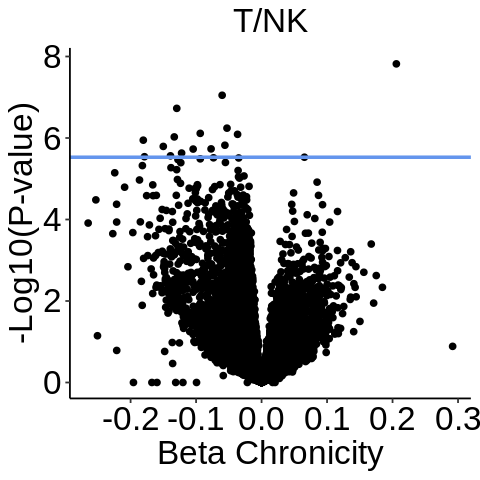

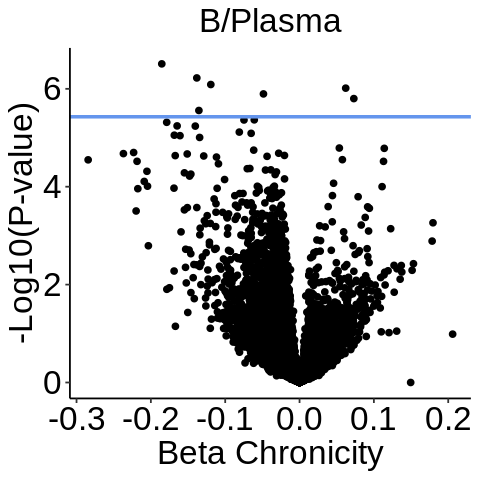

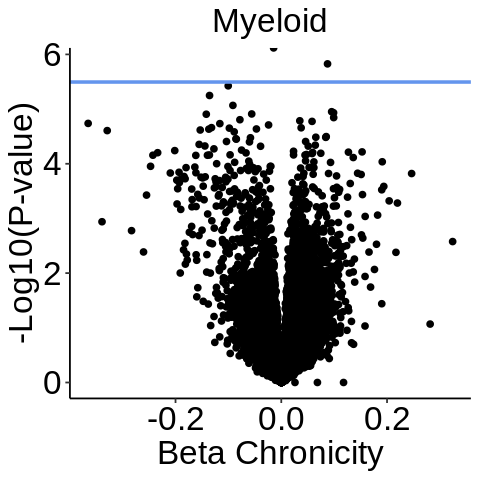

In [740]:
for (ctype in immune_ctypes){
    res = res_list[[ctype]]
        
    fig.size(4, 4)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'cornflowerblue', linewidth = 1)+
        labs(x = 'Beta Chronicity', y = '-Log10(P-value)', title = ctype)
    print(p)
}

In [742]:
for (ctype in immune_ctypes){
    print(paste0('Enriched in ', ctype))
    print(res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print(paste0('Depleted in ', ctype))
    print(res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('')
    print('')

}

[1] "Enriched in T/NK"
[1] "EBF4"   "MT-CYB"
[1] "Depleted in T/NK"
 [1] "USP18"   "ISG15"   "OAS3"    "EPSTI1"  "HERC5"   "EIF2AK2" "MTHFD1L"
 [8] "LAP3"    "DDX60L"  "PARP12"  "N4BP1"   "CMTR1"   "PHF11"   "IMPACT" 
[1] ""
[1] ""
[1] "Enriched in B/Plasma"
[1] "MT-CYB"  "MT-ATP6"
[1] "Depleted in B/Plasma"
[1] "IFITM1"  "EIF2AK2" "PLSCR1"  "LAP3"    "ANKRD39"
[1] ""
[1] ""
[1] "Enriched in Myeloid"
[1] "LINC02356"
[1] "Depleted in Myeloid"
[1] "Z95114.4"
[1] ""
[1] ""


In [ ]:
genes_label = list()

In [127]:
genes_label[['T/NK']] = c("EBF4",   "MT-CYB", "GZMK", "CD8A",
 "USP18",   "ISG15" ,  "OAS3" ,   "EPSTI1"  ,"HERC5"   ,"EIF2AK2", "MTHFD1L",
"LAP3"   
                         )
genes_label[['B/Plasma']] = c("MT-CYB" , "MT-ATP6", 
                             "IFITM1",  "EIF2AK2" ,"PLSCR1",  "LAP3" ,   "ANKRD39")
genes_label[['Myeloid']] = c("LINC02356"
, "Z95114.4")

In [756]:
immune_ctypes

[1] "T/NK"     "B/Plasma" "Myeloid"

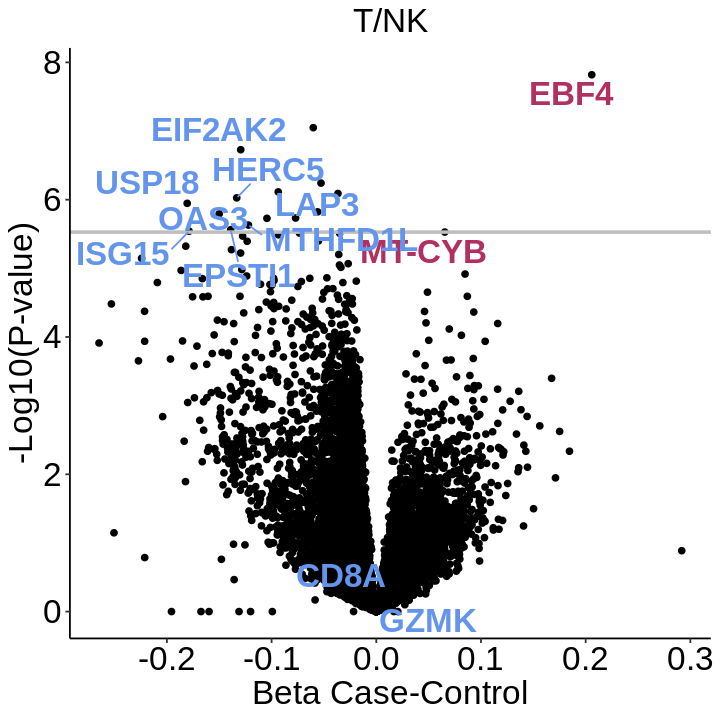

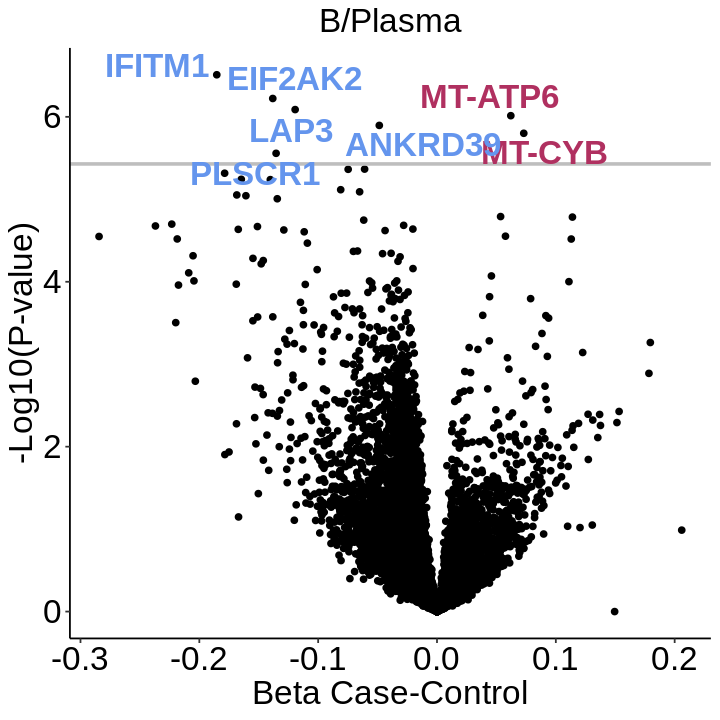

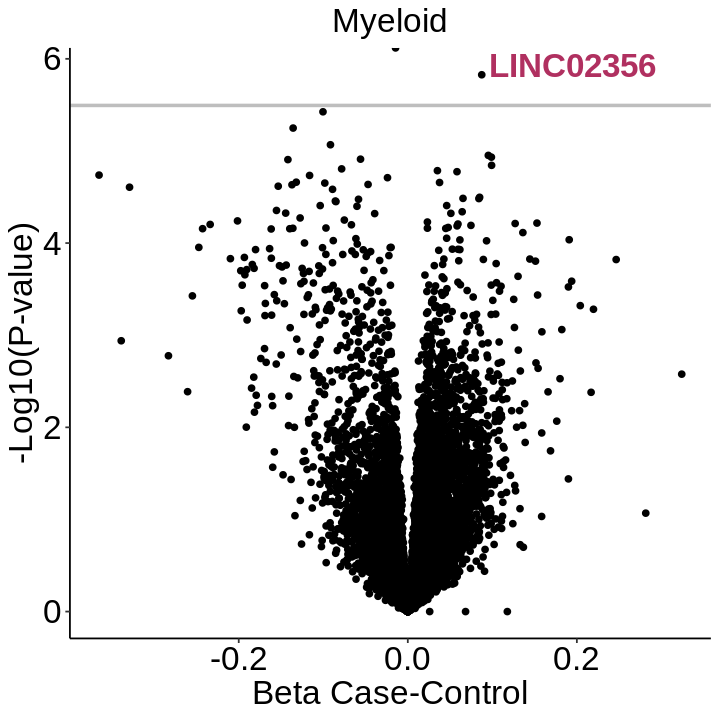

In [757]:
for (ctype in immune_ctypes){
    res = res_list[[ctype]]
    res = res %>% mutate(label = NA)
    res[genes_label[[ctype]], 'label'] = genes_label[[ctype]]

    fig.size(6, 6)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'grey', linewidth = 1)+
        labs(x = 'Beta Case-Control', y = '-Log10(P-value)', title = ctype)+
        geom_text_repel(data = res %>% filter(label != 'NA', beta > 0), aes(x = beta, y = -log10(p), label = label),
                   color = 'maroon', size = 7, fontface = "bold",
                   max.overlaps = Inf, force = 3)+
        geom_text_repel(data = res %>% filter(label != 'NA', beta < 0), aes(x = beta, y = -log10(p), label = label),
                   color = 'cornflowerblue', size = 7, fontface = "bold",
                   max.overlaps = Inf, force = 10)

    print(p)

}


In [143]:
for (ctype in immune_ctypes){
    print(paste0('Enriched in ', ctype))
    print(res_list[[ctype]] %>% filter(padj < 0.05, beta > 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print(paste0('Depleted in ', ctype))
    print(res_list[[ctype]] %>% filter(padj < 0.05, beta < 0) %>% arrange(desc(abs(beta))) %>% head(50) %>% rownames)
    print('')
    print('')

}

[1] "Enriched in T/NK"
[1] "EBF4"   "MT-CYB"
[1] "Depleted in T/NK"
 [1] "USP18"   "ISG15"   "OAS3"    "EPSTI1"  "HERC5"   "EIF2AK2" "MTHFD1L"
 [8] "LAP3"    "DDX60L"  "PARP12"  "N4BP1"   "CMTR1"   "PHF11"   "IMPACT" 
[1] ""
[1] ""
[1] "Enriched in B/Plasma"
[1] "MT-CYB"  "MT-ATP6"
[1] "Depleted in B/Plasma"
[1] "IFITM1"  "EIF2AK2" "PLSCR1"  "LAP3"    "ANKRD39"
[1] ""
[1] ""
[1] "Enriched in Myeloid"
[1] "LINC02356"
[1] "Depleted in Myeloid"
[1] "Z95114.4"
[1] ""
[1] ""


In [185]:
res %>% filter(padj < 0.05)

,gene,beta,stderr,z.score,p,celltype,padj,label,label_color
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<chr>,<chr>
LINC02356,LINC02356,0.08747817,0.01714702,5.1016554,1.490019e-06,Myeloid,0.0232443,LINC02356,maroon
Z95114.4,Z95114.4,-0.01447584,0.03648735,-0.3967359,0.000000e+00,Myeloid,0.0000000,Z95114.4,cornflowerblue


In [145]:
genes_label = list()

In [160]:
genes_label[['T/NK']] = c("EBF4",   "MT-CYB", 
 "USP18",   "ISG15" ,  "OAS3" ,   "EPSTI1"  ,"HERC5"   
                         )
genes_label[['B/Plasma']] = c("MT-CYB" , "MT-ATP6", 
                             "IFITM1",  "EIF2AK2" ,"PLSCR1",  "LAP3" ,   "ANKRD39")
genes_label[['Myeloid']] = c("LINC02356"
, "Z95114.4")

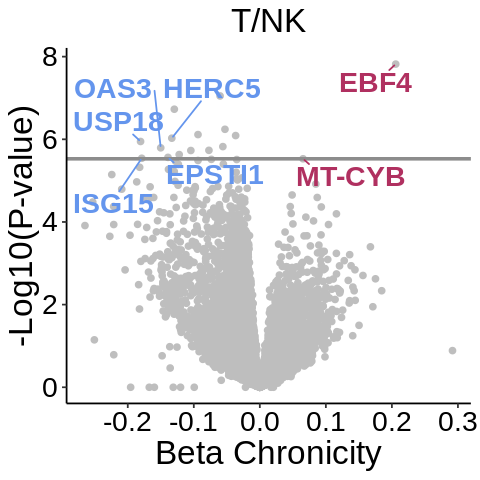

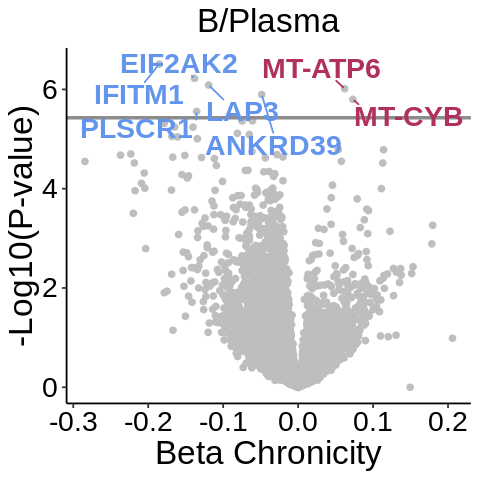

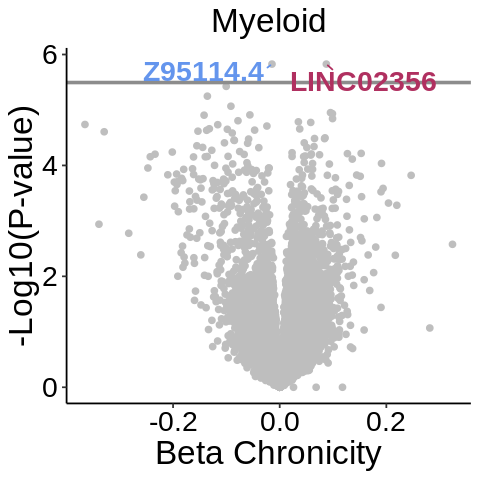

In [205]:
ps = list()
for (ctype in immune_ctypes){
    res = res_list[[ctype]]
    res = res %>% mutate(label = NA)
    res[genes_label[[ctype]], 'label'] = genes_label[[ctype]]
    res =res %>% mutate(label_color = ifelse(!is.na(label), ifelse(beta > 0, 'maroon', 'cornflowerblue'), NA))
    
    min_p = res[res['p']!= 0, 'p'] %>% min # Replace zeros for visualization
    res = res %>% mutate(p = ifelse(p==0, min_p, p))
    
    set.seed(182923)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)), color = 'grey')+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize-3, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize-3, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'gray55', linewidth = 1)+
        labs(x = 'Beta Chronicity', y = '-Log10(P-value)', title = ctype)+
        geom_text_repel(data = res %>% filter(label != 'NA'), 
                    aes(x = beta, y = -log10(p), label = label, color = label_color),
                   size = 6, fontface = "bold",
                   max.overlaps = Inf, force = 80, min.segment.length = 0)+
        scale_color_identity()  
        # geom_text_repel(data = res %>% filter(label != 'NA', beta < 0), aes(x = beta, y = -log10(p), label = label),
        #            color = 'cornflowerblue', size = 6, fontface = "bold",
        #            max.overlaps = Inf, force = 100, min.segment.length = 0)

    height = 4
    width = 4
    fig.size(height, width)
    outplot = p
    ps[[ctype]] = p
    
    print(outplot)

}


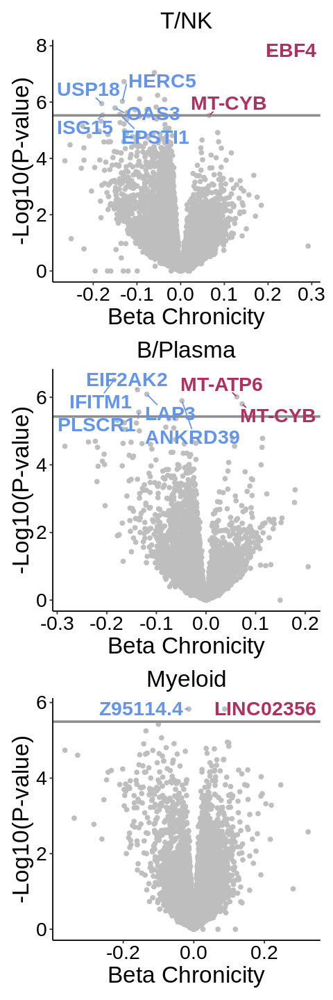

In [207]:
height = 12
width = 4
fig.size(height, width)
outplot = ps[['T/NK']] + ps[['B/Plasma']] + ps[['Myeloid']] + plot_layout(ncol = 1)
print(outplot)

ggsave(paste0(figdir, 'de_gene_volcano_chronicity_blood.png'), plot = outplot,  
       height = height, width = width, dpi = 500, limitsize = FALSE)
ggsave(paste0(figdir, 'de_gene_volcano_chronicity_blood.pdf'), plot = outplot,  
       height = height, width = width, dpi = 500, device = cairo_pdf, limitsize = FALSE)


# Blood: Activity, by cell type

## Run differential expression

In [760]:
clinical['Final_Activity']

Final_Activity
<int>
4
1
5
0
2
1
1
16
4


In [782]:
for (ctype in immune_ctypes){
    print(ctype)
    
    qcd_pbmc = readRDS(ctype_list[[ctype]][5])
    qcd_raw_pbmc = qcd_pbmc@assays$RNA@counts
    qcd_meta_pbmc = readRDS(ctype_list[[ctype]][6])
    qcd_raw_pbmc = qcd_raw_pbmc[, qcd_meta_pbmc$Cell]
    pseudo_raw_pbmc = pseudobulk(qcd_raw_pbmc, qcd_meta_pbmc$individual)

    
    qcd_meta = readRDS(ctype_list[[ctype]][1])
    if (ctype %in% immune_ctypes){
        qcd_raw = readRDS(ctype_list[[ctype]][2])
        qcd_raw <- qcd_raw[, qcd_meta$cell]
    } else {
        qcd_raw = qcd_raw_tissue[, qcd_meta$cell]
    }
    
    pseudo_raw = pseudo_raw_pbmc
    qcd_meta = qcd_meta_pbmc
    rm(qcd_raw_pbmc)
    gc()
    
    ncounts = colSums(pseudo_raw)
    sample_meta = qcd_meta[!duplicated(qcd_meta$individual), ]
    sample_meta = merge(sample_meta, clinical[c('individual', 'Sex', 'Age', 'Final_Chronicity', 'Final_Activity',
                                                'First_biop', 'Final_Site')], by = 'individual')
    sample_meta = sample_meta %>% filter(Type == 'SLE')
    sample_meta = sample_meta[!is.na(sample_meta['Final_Chronicity']), ]
     sample_meta = sample_meta[!is.na(sample_meta['Final_Activity']), ]
   
    rownames(sample_meta) = sample_meta$individual
    sample_meta$ncounts = ncounts[rownames(sample_meta)]
    sample_meta$Sex = as.factor(sample_meta$Sex)
    sample_meta$First_biop = as.factor(sample_meta$First_biop)
    sample_meta$Final_Site = as.factor(sample_meta$Final_Site)

    ndonor_thresh = round(nrow(sample_meta)*.9)
    print(ndonor_thresh)
    genes = rownames(pseudo_raw)[rowSums(pseudo_raw >= genecount_thresh) > ndonor_thresh]
    print(length(genes))
    
    pseudo_raw = pseudo_raw[genes, rownames(sample_meta)]
    gc()
    # pseudo_raw = pseudo_raw + pseudocount

    system.time(
    suppressMessages({
    suppressWarnings({
        res_list = future_lapply(genes, future.seed = TRUE, function(gene){
            
            tryCatch({
        res = data.frame()

        gene_expr = pseudo_raw[gene, ]
            
        null_fm = as.formula(paste0(
            c('gene_expr ~ Age + Sex + First_biop + Final_Site + Final_Chronicity',
                              ' + offset(log(ncounts))'), collapse = '') )
        full_fm = as.formula(paste0(
            c('gene_expr ~ Age + Sex + First_biop + Final_Site + Final_Chronicity + Final_Activity +', 
                              ' + offset(log(ncounts))'), collapse = '') )
        # print(full_fm)

        null = glm.nb(null_fm, data = sample_meta)
        full = glm.nb(full_fm, data = sample_meta)
        z =summary(full)$coefficients['Final_Activity', "z value"]
        se = summary(full)$coefficients['Final_Activity', "Std. Error"]
        b = summary(full)$coefficients['Final_Activity', "Estimate"] #full$coefficients[['TypeLN']]
        pval = anova(full, null)[2, 'Pr(Chi)']
        res = rbind(res, data.frame('gene' = gene, 'beta' = b, 'stderr' = se, 'z-score' = z, 'p' = pval))       
        return(res)
                
        }, error = function(e) {
            message(paste("Error for gene:", gene))
            message("Error message:", e$message)
            return(NULL)  # Return NULL if there's an error to avoid stopping the loop
          })
                
        })})})
    )

    res = do.call("rbind", res_list)
    res['celltype'] = ctype
    res$padj = p.adjust(res$p, method = "bonferroni")

    name = ctype_list[[ctype]][3]
    saveRDS(res, paste0(outdir, name, '_activity_differential_expression_blood_20250502_pseudo.rds'))
    flush.console()
}

[1] "B/Plasma"
[1] 92
[1] 13420
[1] "Myeloid"
[1] 94
[1] 15610


## Load results

In [29]:
res_list = list()
res_all = data.frame()

for (ctype in immune_ctypes){
    
    name = ctype_list[[ctype]][3]
    de_fn = paste0(outdir, name, '_activity_differential_expression_blood_20250502_pseudo.rds')
    res = readRDS(de_fn)
    print(res$gene %>% unique %>% length)
    
    res_all = rbind(res_all, res)
    res_list[[ctype]] = res
    rownames(res_list[[ctype]]) = res$gene
}

[1] 16851
[1] 13418
[1] 15600


In [30]:
name = 'Activity in Blood'
export_res[[name]] = res_all %>% mutate(variable = 'activity blood')

In [209]:
res_all_wide = res_all %>% pivot_wider(id_cols = gene, names_from = celltype, values_from = c(beta,stderr, z.score, p, padj)) %>% as.data.frame
rownames(res_all_wide) = res_all_wide$gene

In [ ]:
for (ctype in celltypes){
   print(res_list[[ctype]] %>% filter(padj < 0.05) %>% arrange(desc(beta)))
}

## Visualize results

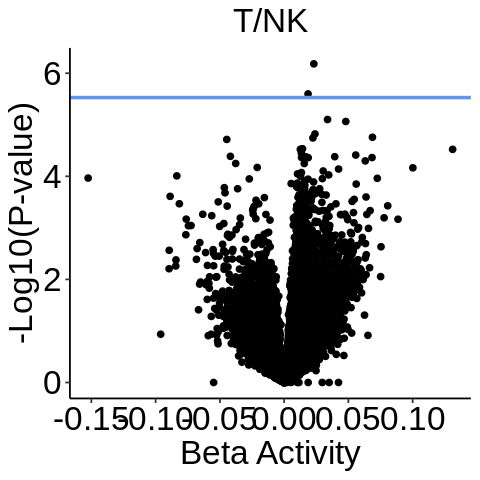

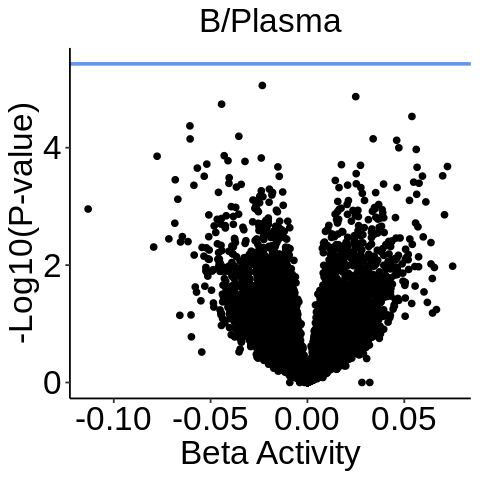

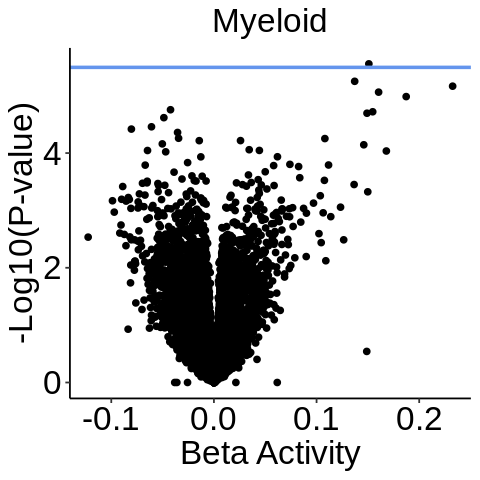

In [786]:
for (ctype in immune_ctypes){
    res = res_list[[ctype]]
        
    fig.size(4, 4)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'cornflowerblue', linewidth = 1)+
        labs(x = 'Beta Activity', y = '-Log10(P-value)', title = ctype)
    print(p)
}

In [210]:
genes_label = list()

In [211]:
genes_label[['T/NK']] = c("AL080276.2", "MIOS"
                         )
genes_label[['B/Plasma']] = c("")
genes_label[['Myeloid']] = c("VSIG4")

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”


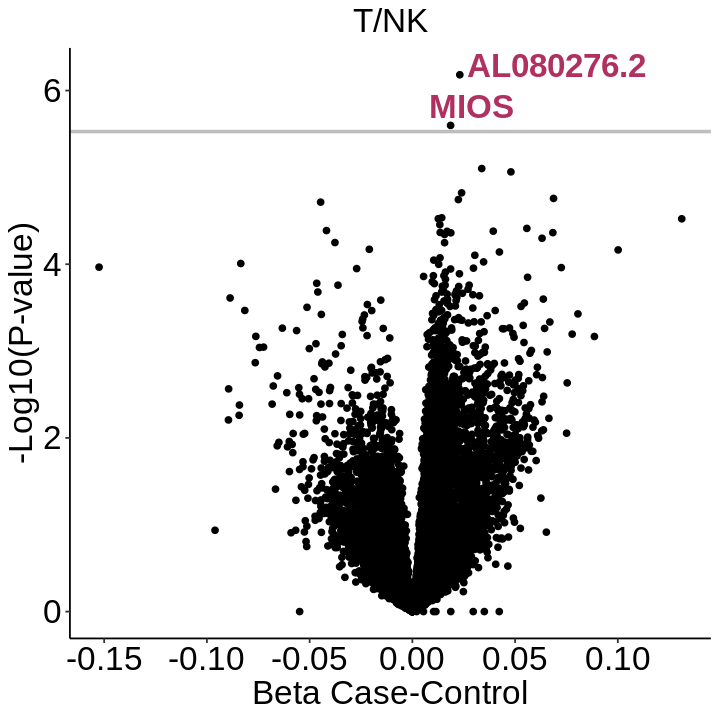

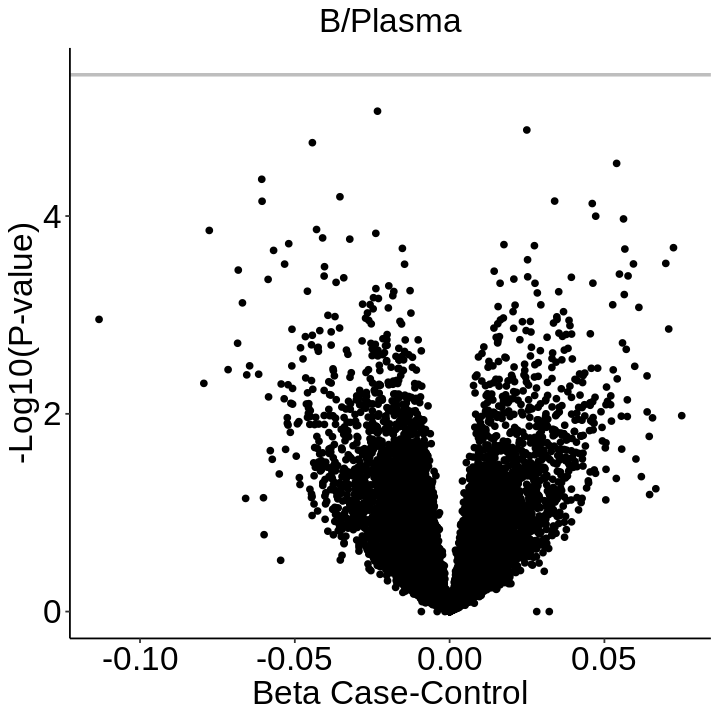

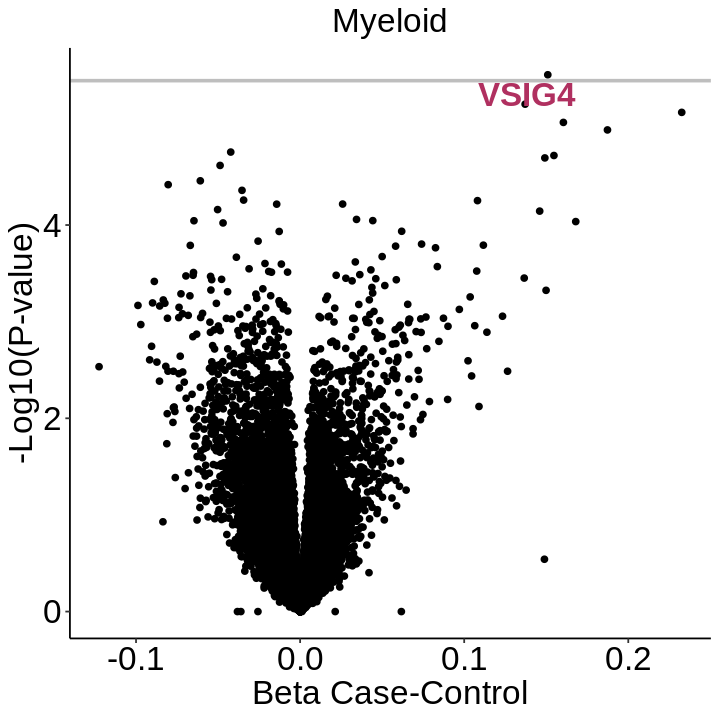

In [213]:
for (ctype in immune_ctypes){
    res = res_list[[ctype]]
    res = res %>% mutate(label = NA)
    res[genes_label[[ctype]], 'label'] = genes_label[[ctype]]

    fig.size(6, 6)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)))+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'grey', linewidth = 1)+
        labs(x = 'Beta Case-Control', y = '-Log10(P-value)', title = ctype)+
        geom_text_repel(data = res %>% filter(label != 'NA', beta > 0), aes(x = beta, y = -log10(p), label = label),
                   color = 'maroon', size = 7, fontface = "bold",
                   max.overlaps = Inf, force = 3)+
        geom_text_repel(data = res %>% filter(label != 'NA', beta < 0), aes(x = beta, y = -log10(p), label = label),
                   color = 'cornflowerblue', size = 7, fontface = "bold",
                   max.overlaps = Inf, force = 10)

    print(p)

}


In [214]:
genes_label = list()

genes_label[['T/NK']] = c("AL080276.2", "MIOS"
                         )
genes_label[['B/Plasma']] = c("")
genes_label[['Myeloid']] = c("VSIG4")

Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_text_repel()`).”


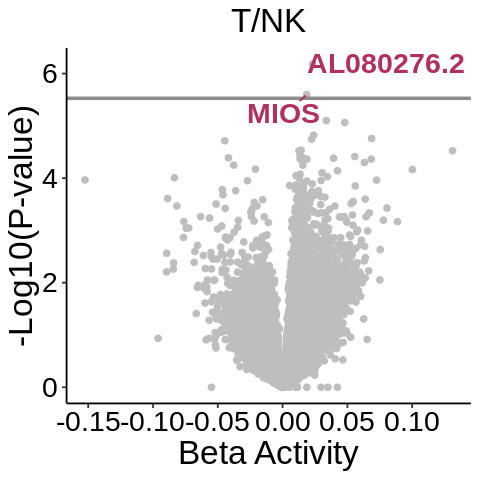

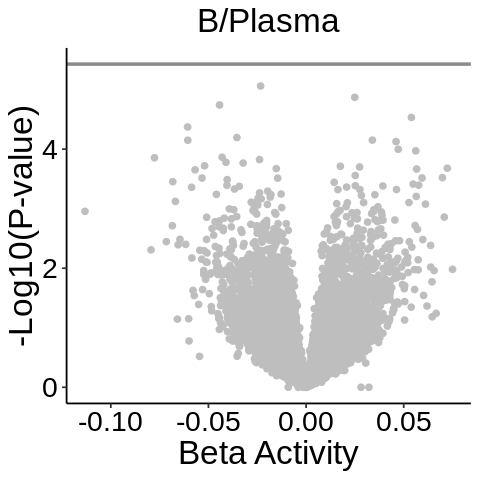

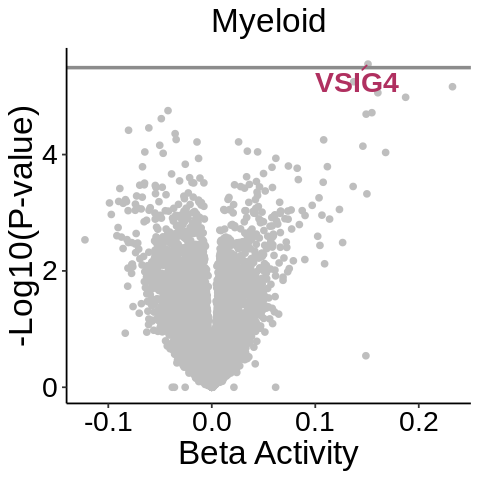

In [215]:
ps = list()
for (ctype in immune_ctypes){
    res = res_list[[ctype]]
    res = res %>% mutate(label = NA)
    res[genes_label[[ctype]], 'label'] = genes_label[[ctype]]
    res =res %>% mutate(label_color = ifelse(!is.na(label), ifelse(beta > 0, 'maroon', 'cornflowerblue'), NA))
    
    min_p = res[res['p']!= 0, 'p'] %>% min # Replace zeros for visualization
    res = res %>% mutate(p = ifelse(p==0, min_p, p))
    
    set.seed(182923)
    p = ggplot(res)+
        geom_point(aes(x = beta, y = -log10(p)), color = 'grey')+
        theme_classic()+
        theme(text=element_text(family="Arial"),
        legend.position = "none",
        panel.grid = element_blank(),
        axis.text.x = element_text(color = "black", size = labelfontsize-3, hjust=0.5),
        axis.text.y = element_text(color = "black", size = labelfontsize-3, hjust=1),
        axis.title = element_text(size=labelfontsize, hjust = 0.5),
        plot.title = element_text(size=labelfontsize, hjust = 0.5),
        )+
        geom_hline(yintercept = -log10(0.05/nrow(res)), color = 'gray55', linewidth = 1)+
        labs(x = 'Beta Activity', y = '-Log10(P-value)', title = ctype)+
        geom_text_repel(data = res %>% filter(label != 'NA'), 
                    aes(x = beta, y = -log10(p), label = label, color = label_color),
                   size = 6, fontface = "bold",
                   max.overlaps = Inf, force = 80, min.segment.length = 0)+
        scale_color_identity()  
        # geom_text_repel(data = res %>% filter(label != 'NA', beta < 0), aes(x = beta, y = -log10(p), label = label),
        #            color = 'cornflowerblue', size = 6, fontface = "bold",
        #            max.overlaps = Inf, force = 100, min.segment.length = 0)

    height = 4
    width = 4
    fig.size(height, width)
    outplot = p
    ps[[ctype]] = p
    
    print(outplot)

}


Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_text_repel()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_text_repel()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“Removed 1 row containing missing values or values outside the scale range
(`geom_text_repel()`).”


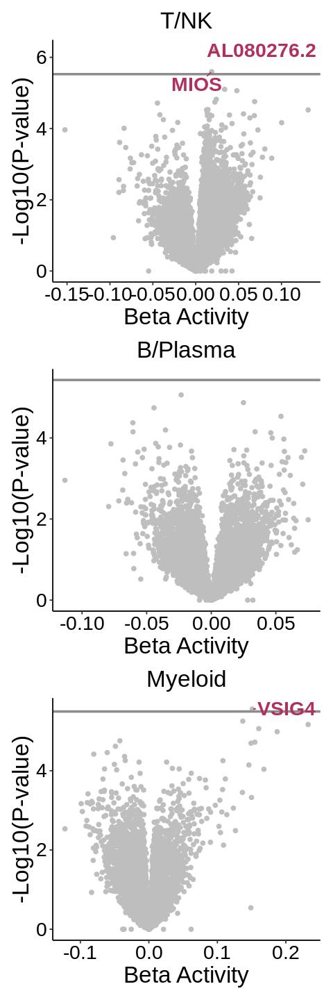

In [216]:
height = 12
width = 4
fig.size(height, width)
outplot = ps[['T/NK']] + ps[['B/Plasma']] + ps[['Myeloid']] + plot_layout(ncol = 1)
print(outplot)

ggsave(paste0(figdir, 'de_gene_volcano_activity_blood.png'), plot = outplot,  
       height = height, width = width, dpi = 500, limitsize = FALSE)
ggsave(paste0(figdir, 'de_gene_volcano_activity_blood.pdf'), plot = outplot,  
       height = height, width = width, dpi = 500, device = cairo_pdf, limitsize = FALSE)


# Write results

In [32]:
write_xlsx(export_res, '../../tables/SupplementaryTableDEG.xlsx')
write_xlsx(export_res_gsea,  '../../tables/SupplementaryTableGSEA.xlsx')